In [61]:
import numpy as np
import pandas as pd
def load(csv_path):
    return pd.read_csv(csv_path)

In [62]:
#load dataframe
df = load('20343.csv')
df

,Cell HMS LINCS ID,Cell Name,Small Molecule HMS LINCS ID,Small Molecule Name,Small Mol Concentration (uM),Primary Target,Pathway,Mean Normalized Growth Rate Inhibition Value,Increased Fraction Dead
0,50211-2,HCC1806,10390-103-1,Abemaciclib,0.001000,CDK4/6,Cell cycle,0.9779,0.00362
1,50211-2,HCC1806,10390-103-1,Abemaciclib,0.003162,CDK4/6,Cell cycle,0.9667,-0.00301
2,50211-2,HCC1806,10390-103-1,Abemaciclib,0.010000,CDK4/6,Cell cycle,0.9168,0.00484
3,50211-2,HCC1806,10390-103-1,Abemaciclib,0.031623,CDK4/6,Cell cycle,0.7658,0.01650
4,50211-2,HCC1806,10390-103-1,Abemaciclib,0.100000,CDK4/6,Cell cycle,0.7132,0.01025
...,...,...,...,...,...,...,...,...,...
10705,51083-2,SUM159PT,10194-106-1,Cabozantinib,0.100000,VEGFR2/MET,RTK,1.0115,-0.00152
10706,51083-2,SUM159PT,10194-106-1,Cabozantinib,0.316230,VEGFR2/MET,RTK,0.9965,0.00568
10707,51083-2,SUM159PT,10194-106-1,Cabozantinib,1.000000,VEGFR2/MET,RTK,0.9307,0.03130
10708,51083-2,SUM159PT,10194-106-1,Cabozantinib,3.162300,VEGFR2/MET,RTK,0.7480,0.08743


In [63]:
#find the # of unique cells and molecules
cells = df['Cell HMS LINCS ID'].unique()
moles = df['Small Molecule HMS LINCS ID'].unique()
n_cell = len(cells)
n_mole = len(moles)
n_exp = n_cell * n_mole

In [64]:
#find unique values of concentration
concs = df['Small Mol Concentration (uM)'].unique()

In [65]:
#redefine the problem space for retrospective active learning
#find the values of concentration that all possible combinations of cell and molecular are performed
df_concs = []
for i in range(len(concs)):
    df_conc = df[df['Small Mol Concentration (uM)'] == concs[i]]
    if len(df_conc) == n_exp:
        df_concs.append(df_conc)
n_conc = len(df_concs)

In [66]:
df_concs[0]

,Cell HMS LINCS ID,Cell Name,Small Molecule HMS LINCS ID,Small Molecule Name,Small Mol Concentration (uM),Primary Target,Pathway,Mean Normalized Growth Rate Inhibition Value,Increased Fraction Dead
2,50211-2,HCC1806,10390-103-1,Abemaciclib,0.01,CDK4/6,Cell cycle,0.9168,0.00484
12,50211-2,HCC1806,10071-101-1,Palbociclib,0.01,CDK4/6,Cell cycle,0.9497,0.00431
20,50211-2,HCC1806,10006-101-1,AZD7762,0.01,CHK1/2,Cell cycle,0.7268,0.06774
31,50211-2,HCC1806,10387-101-1,Volasertib,0.01,PLK,Cell cycle,-0.1860,0.51709
40,50211-2,HCC1806,10287-101-2,Dinaciclib,0.01,pan CDK,Cell cycle,0.7679,0.03547
...,...,...,...,...,...,...,...,...,...
10667,51083-2,SUM159PT,10394-101-1,Ceritinib,0.01,ALK,RTK,1.0080,-0.00023
10677,51083-2,SUM159PT,10018-101-1,Neratinib,0.01,EGFR/HER2,RTK,0.9898,-0.00141
10685,51083-2,SUM159PT,10131-101-1,Tivantinib,0.01,MET,RTK,1.0165,0.00077
10694,51083-2,SUM159PT,10444-101-1,Cediranib,0.01,VEGFR/cKIT,RTK,1.0195,0.00135


In [67]:
user_item_grs = []
user_item_ifds = []
for i in range(n_conc):
    gr = df_concs[i]['Mean Normalized Growth Rate Inhibition Value'].values
    ifd = df_concs[i]['Increased Fraction Dead'].values
    user_item_gr = np.zeros([n_cell, n_mole])
    user_item_ifd = np.zeros([n_cell, n_mole])
    for j in range(n_cell):
        user_item_gr[j] = gr[j * n_mole : (j + 1) * n_mole]
        user_item_ifd[j] = ifd[j * n_mole : (j + 1) * n_mole]
    user_item_grs.append(user_item_gr)
    user_item_ifds.append(user_item_ifd)

In [68]:
from sklearn.model_selection import KFold
def get_kfold_matrix(df, user, item, user_col_name, item_col_name, k=10):
    n_user = len(user)
    n_item = len(item)
    train_indexes = []
    test_indexes = []
    kfold = KFold(n_splits=k, shuffle=True, random_state=0)
    for train_index, _ in kfold.split(df):
        train_matrix = np.zeros([n_user, n_item])
        test_matrix = np.zeros([n_user, n_item])
        for index in train_index:
            record = df.iloc[index]
            train_matrix[np.where(user == record[user_col_name])[0][0], np.where(item == record[item_col_name])[0][0]] = 1
        test_matrix[np.where(train_matrix == 0)] = 1
        train_indexes.append(train_matrix)
        test_indexes.append(test_matrix)
    return train_indexes, test_indexes

In [69]:
#Alternating Least Square
import matplotlib.pyplot as plt
class ALS:
    def __init__(self, user_item, n_e, train_index, test_index, alpha, l_r, c_thred):
        self.user_item = user_item
        self.n_e = n_e
        self.n_user, self.n_item = self.user_item.shape
        self.user_embedding = np.random.uniform(-1, 1, (self.n_user, self.n_e))
        self.item_embedding = np.random.uniform(-1, 1, (self.n_item, self.n_e))
        self.train_index = train_index
        self.test_index = test_index
        self.n_train = np.sum(self.train_index).astype(np.int_)
        self.n_test = np.sum(self.test_index).astype(np.int_)
        self.alpha = alpha
        self.l_r = l_r
        self.train_user_item = np.multiply(self.user_item, self.train_index)
        self.test_user_item = np.multiply(self.user_item, self.test_index)
        self.hist = [[] for i in range(4)]
        self.best_test_loss = float('inf')
        self.best_test_acc = 0.0
        self.c_thred = c_thred
        
    def clear(self):
        self.user_embedding = np.random.uniform(-1, 1, (self.n_user, self.n_e))
        self.item_embedding = np.random.uniform(-1, 1, (self.n_item, self.n_e))
        self.hist = [[] for i in range(4)]
        self.best_test_loss = float('inf')
        self.best_test_acc = 0.0
        
    def predict(self):
        return np.dot(self.user_embedding, self.item_embedding.T)
    
    def loss(self):
        self.user_item_pred = self.predict()
        train_loss = np.sqrt(np.sum(np.square(np.multiply(self.user_item_pred, self.train_index) - self.train_user_item))/self.n_train)
        test_loss = np.sqrt(np.sum(np.square(np.multiply(self.user_item_pred, self.test_index) - self.test_user_item))/self.n_test)
        self.hist[0].append(train_loss)
        self.hist[1].append(test_loss)
        return train_loss, test_loss
    
    def acc(self):
        self.user_item_pred = self.predict()
        true_pred = np.where(((self.user_item>self.c_thred)&(self.user_item_pred>self.c_thred))|((self.user_item<self.c_thred)&(self.user_item_pred<self.c_thred))|((self.user_item==self.c_thred)&(self.user_item_pred==self.c_thred)), 1, 0)
        train_acc = np.sum(np.multiply(true_pred, self.train_index)) / self.n_train
        test_acc = np.sum(np.multiply(true_pred, self.test_index)) / self.n_test
        self.hist[2].append(train_acc)
        self.hist[3].append(test_acc)
        return train_acc, test_acc

    def train(self, n_epoch):
        for i in range(n_epoch):
            ui_pred = np.multiply(self.train_index, self.predict())
            error = ui_pred - self.train_user_item
            if i % 2 == 0:
                user_grads = np.dot(error, self.item_embedding)
                self.user_embedding = self.alpha * self.user_embedding - self.l_r * user_grads
            else:
                item_grads = np.dot(error.T, self.user_embedding)
                self.item_embedding = self.alpha * self.item_embedding - self.l_r * item_grads
            rmse_loss = self.loss()
            if rmse_loss[1] < self.best_test_loss:
                self.best_test_loss = rmse_loss[1]
            acc = self.acc()
            if acc[1] > self.best_test_acc:
                self.best_test_acc = acc[1]
            print('EPOCH %d: train_loss: %f, test_loss: %f, train_acc: %f, test_acc: %f' % (i + 1, rmse_loss[0], rmse_loss[1], acc[0], acc[1]))
        
    def plot(self):
        plt.figure()
        plt.subplot(1,2,1)
        plt.plot(self.hist[0], color='blue', label='train_loss')
        plt.plot(self.hist[1], color='red', label='test_loss')
        plt.legend()
        plt.subplot(1,2,2)
        plt.plot(self.hist[2], color='blue', label='train_acc')
        plt.plot(self.hist[3], color='red', label='test_acc')
        plt.legend()
        plt.show()
        return

In [70]:
train_indexes, test_indexes = get_kfold_matrix(df_concs[0], cells, moles, 'Cell HMS LINCS ID', 'Small Molecule HMS LINCS ID')

In [71]:
#call 10-fold cross validation
test_loss_grs = [[] for i in range(len(user_item_grs))]
test_loss_ifds = [[] for i in range(len(user_item_grs))]
test_acc_grs = [[] for i in range(len(user_item_grs))]
test_acc_ifds = [[] for i in range(len(user_item_grs))]
n_e = 5 #intuitively defined, can be tuned automatically
alpha = 1
l_r = 0.01
n_repeat = 10
n_epoch = 400
als_grs = [[] for i in range(n_repeat)]
als_ifds = [[] for i in range(n_repeat)]
for i in range(len(user_item_grs)):
    for j in range(len(train_indexes)):
        als_gr = ALS(user_item_grs[i], n_e, train_indexes[j], test_indexes[j], alpha, l_r, 1)
        als_ifd = ALS(user_item_ifds[i], n_e, train_indexes[j], test_indexes[j], alpha, l_r, 0)
        for k in range(n_repeat):
            als_gr.clear()
            als_ifd.clear()
            als_gr.train(n_epoch)
            als_ifd.train(n_epoch)
            test_loss_grs[i].append(als_gr.best_test_loss)
            test_loss_ifds[i].append(als_ifd.best_test_loss)
            test_acc_grs[i].append(als_gr.best_test_acc)
            test_acc_ifds[i].append(als_ifd.best_test_acc)
            als_grs[k].append(als_gr)
            als_ifds[k].append(als_ifd)
mean_test_loss_gr = np.mean(test_loss_grs, axis=1)
mean_test_loss_ifd = np.mean(test_loss_ifds, axis=1)
mean_test_acc_gr = np.mean(test_acc_grs, axis=1)
mean_test_acc_ifd = np.mean(test_acc_ifds, axis=1)
mean_mean_test_loss_gr = np.mean(mean_test_loss_gr)
mean_mean_test_loss_ifd = np.mean(mean_test_loss_ifd)
mean_mean_test_acc_gr = np.mean(mean_test_acc_gr)
mean_mean_test_acc_ifd = np.mean(mean_test_acc_ifd)

EPOCH 1: train_loss: 1.071281, test_loss: 1.183833, train_acc: 0.624650, test_acc: 0.605042
EPOCH 2: train_loss: 1.028405, test_loss: 1.156061, train_acc: 0.632120, test_acc: 0.613445
EPOCH 3: train_loss: 0.993903, test_loss: 1.136808, train_acc: 0.633053, test_acc: 0.605042
EPOCH 4: train_loss: 0.965564, test_loss: 1.118723, train_acc: 0.635854, test_acc: 0.605042
EPOCH 5: train_loss: 0.939611, test_loss: 1.104340, train_acc: 0.633987, test_acc: 0.605042
EPOCH 6: train_loss: 0.916606, test_loss: 1.089111, train_acc: 0.634921, test_acc: 0.605042
EPOCH 7: train_loss: 0.892799, test_loss: 1.074932, train_acc: 0.635854, test_acc: 0.613445
EPOCH 8: train_loss: 0.870228, test_loss: 1.058678, train_acc: 0.635854, test_acc: 0.613445
EPOCH 9: train_loss: 0.844603, test_loss: 1.041548, train_acc: 0.637722, test_acc: 0.621849
EPOCH 10: train_loss: 0.819210, test_loss: 1.021386, train_acc: 0.634921, test_acc: 0.621849
EPOCH 11: train_loss: 0.788944, test_loss: 0.998760, train_acc: 0.636788, test_

EPOCH 140: train_loss: 0.078802, test_loss: 0.088098, train_acc: 0.597572, test_acc: 0.596639
EPOCH 141: train_loss: 0.078417, test_loss: 0.087722, train_acc: 0.597572, test_acc: 0.596639
EPOCH 142: train_loss: 0.078213, test_loss: 0.087545, train_acc: 0.596639, test_acc: 0.605042
EPOCH 143: train_loss: 0.077829, test_loss: 0.087174, train_acc: 0.598506, test_acc: 0.613445
EPOCH 144: train_loss: 0.077629, test_loss: 0.087004, train_acc: 0.601307, test_acc: 0.613445
EPOCH 145: train_loss: 0.077247, test_loss: 0.086638, train_acc: 0.601307, test_acc: 0.613445
EPOCH 146: train_loss: 0.077052, test_loss: 0.086475, train_acc: 0.601307, test_acc: 0.613445
EPOCH 147: train_loss: 0.076672, test_loss: 0.086113, train_acc: 0.602241, test_acc: 0.613445
EPOCH 148: train_loss: 0.076481, test_loss: 0.085958, train_acc: 0.602241, test_acc: 0.621849
EPOCH 149: train_loss: 0.076103, test_loss: 0.085599, train_acc: 0.605042, test_acc: 0.621849
EPOCH 150: train_loss: 0.075916, test_loss: 0.085451, train_

EPOCH 299: train_loss: 0.144634, test_loss: 0.210609, train_acc: 0.761905, test_acc: 0.731092
EPOCH 300: train_loss: 0.144497, test_loss: 0.210588, train_acc: 0.761905, test_acc: 0.731092
EPOCH 301: train_loss: 0.144441, test_loss: 0.210527, train_acc: 0.760971, test_acc: 0.731092
EPOCH 302: train_loss: 0.144304, test_loss: 0.210506, train_acc: 0.760971, test_acc: 0.731092
EPOCH 303: train_loss: 0.144249, test_loss: 0.210445, train_acc: 0.760971, test_acc: 0.731092
EPOCH 304: train_loss: 0.144113, test_loss: 0.210424, train_acc: 0.760971, test_acc: 0.731092
EPOCH 305: train_loss: 0.144058, test_loss: 0.210364, train_acc: 0.760037, test_acc: 0.731092
EPOCH 306: train_loss: 0.143922, test_loss: 0.210342, train_acc: 0.760971, test_acc: 0.731092
EPOCH 307: train_loss: 0.143868, test_loss: 0.210282, train_acc: 0.759104, test_acc: 0.731092
EPOCH 308: train_loss: 0.143732, test_loss: 0.210261, train_acc: 0.760037, test_acc: 0.731092
EPOCH 309: train_loss: 0.143679, test_loss: 0.210201, train_

EPOCH 81: train_loss: 0.167666, test_loss: 0.241678, train_acc: 0.757236, test_acc: 0.647059
EPOCH 82: train_loss: 0.167381, test_loss: 0.241482, train_acc: 0.758170, test_acc: 0.647059
EPOCH 83: train_loss: 0.167034, test_loss: 0.241394, train_acc: 0.758170, test_acc: 0.647059
EPOCH 84: train_loss: 0.166750, test_loss: 0.241206, train_acc: 0.758170, test_acc: 0.647059
EPOCH 85: train_loss: 0.166421, test_loss: 0.241134, train_acc: 0.758170, test_acc: 0.647059
EPOCH 86: train_loss: 0.166138, test_loss: 0.240954, train_acc: 0.758170, test_acc: 0.647059
EPOCH 87: train_loss: 0.165826, test_loss: 0.240897, train_acc: 0.757236, test_acc: 0.647059
EPOCH 88: train_loss: 0.165544, test_loss: 0.240722, train_acc: 0.757236, test_acc: 0.655462
EPOCH 89: train_loss: 0.165246, test_loss: 0.240679, train_acc: 0.759104, test_acc: 0.655462
EPOCH 90: train_loss: 0.164964, test_loss: 0.240510, train_acc: 0.758170, test_acc: 0.655462
EPOCH 91: train_loss: 0.164680, test_loss: 0.240480, train_acc: 0.7581

EPOCH 260: train_loss: 0.049600, test_loss: 0.066915, train_acc: 0.668534, test_acc: 0.529412
EPOCH 261: train_loss: 0.049502, test_loss: 0.066793, train_acc: 0.668534, test_acc: 0.529412
EPOCH 262: train_loss: 0.049369, test_loss: 0.066531, train_acc: 0.668534, test_acc: 0.529412
EPOCH 263: train_loss: 0.049276, test_loss: 0.066413, train_acc: 0.668534, test_acc: 0.529412
EPOCH 264: train_loss: 0.049147, test_loss: 0.066157, train_acc: 0.668534, test_acc: 0.529412
EPOCH 265: train_loss: 0.049057, test_loss: 0.066043, train_acc: 0.667600, test_acc: 0.529412
EPOCH 266: train_loss: 0.048932, test_loss: 0.065794, train_acc: 0.668534, test_acc: 0.529412
EPOCH 267: train_loss: 0.048846, test_loss: 0.065683, train_acc: 0.666667, test_acc: 0.529412
EPOCH 268: train_loss: 0.048724, test_loss: 0.065440, train_acc: 0.669468, test_acc: 0.529412
EPOCH 269: train_loss: 0.048642, test_loss: 0.065333, train_acc: 0.666667, test_acc: 0.529412
EPOCH 270: train_loss: 0.048523, test_loss: 0.065095, train_

EPOCH 37: train_loss: 0.163770, test_loss: 0.188882, train_acc: 0.521008, test_acc: 0.445378
EPOCH 38: train_loss: 0.161209, test_loss: 0.186017, train_acc: 0.520075, test_acc: 0.428571
EPOCH 39: train_loss: 0.158958, test_loss: 0.183284, train_acc: 0.519141, test_acc: 0.436975
EPOCH 40: train_loss: 0.156653, test_loss: 0.180664, train_acc: 0.521008, test_acc: 0.436975
EPOCH 41: train_loss: 0.154619, test_loss: 0.178145, train_acc: 0.516340, test_acc: 0.436975
EPOCH 42: train_loss: 0.152539, test_loss: 0.175743, train_acc: 0.519141, test_acc: 0.436975
EPOCH 43: train_loss: 0.150696, test_loss: 0.173414, train_acc: 0.516340, test_acc: 0.436975
EPOCH 44: train_loss: 0.148816, test_loss: 0.171210, train_acc: 0.518207, test_acc: 0.436975
EPOCH 45: train_loss: 0.147141, test_loss: 0.169050, train_acc: 0.519141, test_acc: 0.436975
EPOCH 46: train_loss: 0.145438, test_loss: 0.167024, train_acc: 0.520075, test_acc: 0.436975
EPOCH 47: train_loss: 0.143910, test_loss: 0.165016, train_acc: 0.5163

EPOCH 174: train_loss: 0.149285, test_loss: 0.217698, train_acc: 0.766573, test_acc: 0.722689
EPOCH 175: train_loss: 0.149108, test_loss: 0.217705, train_acc: 0.766573, test_acc: 0.722689
EPOCH 176: train_loss: 0.148865, test_loss: 0.217680, train_acc: 0.766573, test_acc: 0.722689
EPOCH 177: train_loss: 0.148689, test_loss: 0.217688, train_acc: 0.766573, test_acc: 0.722689
EPOCH 178: train_loss: 0.148448, test_loss: 0.217663, train_acc: 0.766573, test_acc: 0.722689
EPOCH 179: train_loss: 0.148273, test_loss: 0.217670, train_acc: 0.766573, test_acc: 0.722689
EPOCH 180: train_loss: 0.148034, test_loss: 0.217646, train_acc: 0.764706, test_acc: 0.722689
EPOCH 181: train_loss: 0.147860, test_loss: 0.217654, train_acc: 0.764706, test_acc: 0.722689
EPOCH 182: train_loss: 0.147623, test_loss: 0.217630, train_acc: 0.764706, test_acc: 0.722689
EPOCH 183: train_loss: 0.147449, test_loss: 0.217637, train_acc: 0.765640, test_acc: 0.722689
EPOCH 184: train_loss: 0.147215, test_loss: 0.217614, train_

EPOCH 339: train_loss: 0.045194, test_loss: 0.058903, train_acc: 0.647993, test_acc: 0.663866
EPOCH 340: train_loss: 0.045108, test_loss: 0.058823, train_acc: 0.647993, test_acc: 0.663866
EPOCH 341: train_loss: 0.045087, test_loss: 0.058784, train_acc: 0.648926, test_acc: 0.663866
EPOCH 342: train_loss: 0.045004, test_loss: 0.058706, train_acc: 0.649860, test_acc: 0.663866
EPOCH 343: train_loss: 0.044983, test_loss: 0.058669, train_acc: 0.649860, test_acc: 0.663866
EPOCH 344: train_loss: 0.044902, test_loss: 0.058592, train_acc: 0.648926, test_acc: 0.663866
EPOCH 345: train_loss: 0.044881, test_loss: 0.058555, train_acc: 0.648926, test_acc: 0.663866
EPOCH 346: train_loss: 0.044802, test_loss: 0.058481, train_acc: 0.648926, test_acc: 0.663866
EPOCH 347: train_loss: 0.044782, test_loss: 0.058445, train_acc: 0.648926, test_acc: 0.663866
EPOCH 348: train_loss: 0.044704, test_loss: 0.058372, train_acc: 0.647059, test_acc: 0.663866
EPOCH 349: train_loss: 0.044684, test_loss: 0.058336, train_

EPOCH 107: train_loss: 0.105388, test_loss: 0.113242, train_acc: 0.518207, test_acc: 0.487395
EPOCH 108: train_loss: 0.104989, test_loss: 0.112674, train_acc: 0.519141, test_acc: 0.487395
EPOCH 109: train_loss: 0.104599, test_loss: 0.112273, train_acc: 0.519141, test_acc: 0.495798
EPOCH 110: train_loss: 0.104199, test_loss: 0.111715, train_acc: 0.520075, test_acc: 0.495798
EPOCH 111: train_loss: 0.103814, test_loss: 0.111332, train_acc: 0.521008, test_acc: 0.495798
EPOCH 112: train_loss: 0.103412, test_loss: 0.110782, train_acc: 0.522876, test_acc: 0.495798
EPOCH 113: train_loss: 0.103033, test_loss: 0.110416, train_acc: 0.521942, test_acc: 0.495798
EPOCH 114: train_loss: 0.102628, test_loss: 0.109875, train_acc: 0.521942, test_acc: 0.495798
EPOCH 115: train_loss: 0.102253, test_loss: 0.109526, train_acc: 0.521942, test_acc: 0.495798
EPOCH 116: train_loss: 0.101846, test_loss: 0.108991, train_acc: 0.521942, test_acc: 0.495798
EPOCH 117: train_loss: 0.101475, test_loss: 0.108657, train_

EPOCH 288: train_loss: 0.132218, test_loss: 0.241219, train_acc: 0.780579, test_acc: 0.731092
EPOCH 289: train_loss: 0.132145, test_loss: 0.241357, train_acc: 0.781513, test_acc: 0.731092
EPOCH 290: train_loss: 0.132009, test_loss: 0.241314, train_acc: 0.780579, test_acc: 0.731092
EPOCH 291: train_loss: 0.131937, test_loss: 0.241449, train_acc: 0.780579, test_acc: 0.731092
EPOCH 292: train_loss: 0.131803, test_loss: 0.241405, train_acc: 0.778711, test_acc: 0.731092
EPOCH 293: train_loss: 0.131732, test_loss: 0.241535, train_acc: 0.778711, test_acc: 0.731092
EPOCH 294: train_loss: 0.131600, test_loss: 0.241490, train_acc: 0.779645, test_acc: 0.731092
EPOCH 295: train_loss: 0.131530, test_loss: 0.241617, train_acc: 0.779645, test_acc: 0.731092
EPOCH 296: train_loss: 0.131401, test_loss: 0.241570, train_acc: 0.778711, test_acc: 0.731092
EPOCH 297: train_loss: 0.131332, test_loss: 0.241693, train_acc: 0.778711, test_acc: 0.731092
EPOCH 298: train_loss: 0.131205, test_loss: 0.241645, train_

EPOCH 52: train_loss: 0.188280, test_loss: 0.263595, train_acc: 0.744164, test_acc: 0.697479
EPOCH 53: train_loss: 0.187557, test_loss: 0.261860, train_acc: 0.740430, test_acc: 0.697479
EPOCH 54: train_loss: 0.186486, test_loss: 0.259771, train_acc: 0.742297, test_acc: 0.697479
EPOCH 55: train_loss: 0.185841, test_loss: 0.258228, train_acc: 0.740430, test_acc: 0.705882
EPOCH 56: train_loss: 0.184863, test_loss: 0.256331, train_acc: 0.741363, test_acc: 0.705882
EPOCH 57: train_loss: 0.184283, test_loss: 0.254951, train_acc: 0.740430, test_acc: 0.705882
EPOCH 58: train_loss: 0.183386, test_loss: 0.253216, train_acc: 0.739496, test_acc: 0.705882
EPOCH 59: train_loss: 0.182862, test_loss: 0.251975, train_acc: 0.739496, test_acc: 0.705882
EPOCH 60: train_loss: 0.182034, test_loss: 0.250380, train_acc: 0.739496, test_acc: 0.705882
EPOCH 61: train_loss: 0.181559, test_loss: 0.249260, train_acc: 0.741363, test_acc: 0.705882
EPOCH 62: train_loss: 0.180792, test_loss: 0.247786, train_acc: 0.7432

EPOCH 219: train_loss: 0.057233, test_loss: 0.074533, train_acc: 0.646125, test_acc: 0.554622
EPOCH 220: train_loss: 0.057001, test_loss: 0.074174, train_acc: 0.646125, test_acc: 0.554622
EPOCH 221: train_loss: 0.056771, test_loss: 0.073976, train_acc: 0.646125, test_acc: 0.554622
EPOCH 222: train_loss: 0.056546, test_loss: 0.073626, train_acc: 0.646125, test_acc: 0.563025
EPOCH 223: train_loss: 0.056321, test_loss: 0.073431, train_acc: 0.647993, test_acc: 0.563025
EPOCH 224: train_loss: 0.056104, test_loss: 0.073089, train_acc: 0.645191, test_acc: 0.563025
EPOCH 225: train_loss: 0.055883, test_loss: 0.072896, train_acc: 0.645191, test_acc: 0.563025
EPOCH 226: train_loss: 0.055673, test_loss: 0.072562, train_acc: 0.645191, test_acc: 0.563025
EPOCH 227: train_loss: 0.055457, test_loss: 0.072372, train_acc: 0.645191, test_acc: 0.563025
EPOCH 228: train_loss: 0.055254, test_loss: 0.072046, train_acc: 0.646125, test_acc: 0.563025
EPOCH 229: train_loss: 0.055044, test_loss: 0.071859, train_

EPOCH 3: train_loss: 0.522814, test_loss: 0.507418, train_acc: 0.509804, test_acc: 0.512605
EPOCH 4: train_loss: 0.489302, test_loss: 0.477774, train_acc: 0.507937, test_acc: 0.512605
EPOCH 5: train_loss: 0.449176, test_loss: 0.446436, train_acc: 0.513539, test_acc: 0.521008
EPOCH 6: train_loss: 0.425228, test_loss: 0.424593, train_acc: 0.513539, test_acc: 0.521008
EPOCH 7: train_loss: 0.394645, test_loss: 0.400383, train_acc: 0.517274, test_acc: 0.529412
EPOCH 8: train_loss: 0.376680, test_loss: 0.383522, train_acc: 0.517274, test_acc: 0.537815
EPOCH 9: train_loss: 0.352540, test_loss: 0.364134, train_acc: 0.515406, test_acc: 0.537815
EPOCH 10: train_loss: 0.338575, test_loss: 0.350671, train_acc: 0.517274, test_acc: 0.537815
EPOCH 11: train_loss: 0.319031, test_loss: 0.334733, train_acc: 0.515406, test_acc: 0.529412
EPOCH 12: train_loss: 0.307873, test_loss: 0.323699, train_acc: 0.513539, test_acc: 0.529412
EPOCH 13: train_loss: 0.291746, test_loss: 0.310336, train_acc: 0.519141, tes

EPOCH 210: train_loss: 0.151156, test_loss: 0.223343, train_acc: 0.784314, test_acc: 0.672269
EPOCH 211: train_loss: 0.151031, test_loss: 0.223224, train_acc: 0.784314, test_acc: 0.672269
EPOCH 212: train_loss: 0.150815, test_loss: 0.223109, train_acc: 0.784314, test_acc: 0.672269
EPOCH 213: train_loss: 0.150689, test_loss: 0.222989, train_acc: 0.784314, test_acc: 0.672269
EPOCH 214: train_loss: 0.150473, test_loss: 0.222874, train_acc: 0.784314, test_acc: 0.672269
EPOCH 215: train_loss: 0.150347, test_loss: 0.222753, train_acc: 0.784314, test_acc: 0.672269
EPOCH 216: train_loss: 0.150130, test_loss: 0.222638, train_acc: 0.784314, test_acc: 0.672269
EPOCH 217: train_loss: 0.150004, test_loss: 0.222516, train_acc: 0.784314, test_acc: 0.672269
EPOCH 218: train_loss: 0.149787, test_loss: 0.222400, train_acc: 0.786181, test_acc: 0.672269
EPOCH 219: train_loss: 0.149661, test_loss: 0.222278, train_acc: 0.785247, test_acc: 0.672269
EPOCH 220: train_loss: 0.149443, test_loss: 0.222161, train_

EPOCH 14: train_loss: 0.575229, test_loss: 0.720758, train_acc: 0.648926, test_acc: 0.638655
EPOCH 15: train_loss: 0.534102, test_loss: 0.682829, train_acc: 0.649860, test_acc: 0.630252
EPOCH 16: train_loss: 0.486557, test_loss: 0.634434, train_acc: 0.659197, test_acc: 0.647059
EPOCH 17: train_loss: 0.451187, test_loss: 0.598894, train_acc: 0.657330, test_acc: 0.655462
EPOCH 18: train_loss: 0.409492, test_loss: 0.553590, train_acc: 0.664799, test_acc: 0.672269
EPOCH 19: train_loss: 0.382516, test_loss: 0.523667, train_acc: 0.662932, test_acc: 0.697479
EPOCH 20: train_loss: 0.349601, test_loss: 0.485022, train_acc: 0.663866, test_acc: 0.689076
EPOCH 21: train_loss: 0.330898, test_loss: 0.461833, train_acc: 0.671335, test_acc: 0.705882
EPOCH 22: train_loss: 0.306860, test_loss: 0.431013, train_acc: 0.677871, test_acc: 0.705882
EPOCH 23: train_loss: 0.294491, test_loss: 0.413890, train_acc: 0.680672, test_acc: 0.697479
EPOCH 24: train_loss: 0.277672, test_loss: 0.390251, train_acc: 0.6862

EPOCH 203: train_loss: 0.069314, test_loss: 0.102619, train_acc: 0.601307, test_acc: 0.588235
EPOCH 204: train_loss: 0.068982, test_loss: 0.102591, train_acc: 0.604108, test_acc: 0.588235
EPOCH 205: train_loss: 0.068518, test_loss: 0.102111, train_acc: 0.605976, test_acc: 0.588235
EPOCH 206: train_loss: 0.068191, test_loss: 0.102080, train_acc: 0.606909, test_acc: 0.588235
EPOCH 207: train_loss: 0.067735, test_loss: 0.101603, train_acc: 0.604108, test_acc: 0.588235
EPOCH 208: train_loss: 0.067413, test_loss: 0.101568, train_acc: 0.606909, test_acc: 0.588235
EPOCH 209: train_loss: 0.066964, test_loss: 0.101092, train_acc: 0.605042, test_acc: 0.588235
EPOCH 210: train_loss: 0.066647, test_loss: 0.101055, train_acc: 0.606909, test_acc: 0.588235
EPOCH 211: train_loss: 0.066206, test_loss: 0.100581, train_acc: 0.605976, test_acc: 0.588235
EPOCH 212: train_loss: 0.065895, test_loss: 0.100541, train_acc: 0.605042, test_acc: 0.588235
EPOCH 213: train_loss: 0.065462, test_loss: 0.100069, train_

EPOCH 387: train_loss: 0.125566, test_loss: 0.225473, train_acc: 0.797386, test_acc: 0.773109
EPOCH 388: train_loss: 0.125507, test_loss: 0.225473, train_acc: 0.797386, test_acc: 0.773109
EPOCH 389: train_loss: 0.125453, test_loss: 0.225493, train_acc: 0.797386, test_acc: 0.773109
EPOCH 390: train_loss: 0.125394, test_loss: 0.225494, train_acc: 0.797386, test_acc: 0.773109
EPOCH 391: train_loss: 0.125340, test_loss: 0.225513, train_acc: 0.797386, test_acc: 0.773109
EPOCH 392: train_loss: 0.125282, test_loss: 0.225514, train_acc: 0.797386, test_acc: 0.773109
EPOCH 393: train_loss: 0.125229, test_loss: 0.225532, train_acc: 0.797386, test_acc: 0.773109
EPOCH 394: train_loss: 0.125171, test_loss: 0.225533, train_acc: 0.797386, test_acc: 0.773109
EPOCH 395: train_loss: 0.125118, test_loss: 0.225551, train_acc: 0.798319, test_acc: 0.773109
EPOCH 396: train_loss: 0.125061, test_loss: 0.225552, train_acc: 0.798319, test_acc: 0.773109
EPOCH 397: train_loss: 0.125008, test_loss: 0.225570, train_

EPOCH 190: train_loss: 0.162083, test_loss: 0.209005, train_acc: 0.762838, test_acc: 0.756303
EPOCH 191: train_loss: 0.161987, test_loss: 0.209032, train_acc: 0.760971, test_acc: 0.756303
EPOCH 192: train_loss: 0.161821, test_loss: 0.209122, train_acc: 0.763772, test_acc: 0.756303
EPOCH 193: train_loss: 0.161725, test_loss: 0.209149, train_acc: 0.760971, test_acc: 0.764706
EPOCH 194: train_loss: 0.161560, test_loss: 0.209239, train_acc: 0.764706, test_acc: 0.764706
EPOCH 195: train_loss: 0.161464, test_loss: 0.209266, train_acc: 0.761905, test_acc: 0.764706
EPOCH 196: train_loss: 0.161298, test_loss: 0.209356, train_acc: 0.763772, test_acc: 0.764706
EPOCH 197: train_loss: 0.161202, test_loss: 0.209383, train_acc: 0.761905, test_acc: 0.764706
EPOCH 198: train_loss: 0.161036, test_loss: 0.209473, train_acc: 0.763772, test_acc: 0.764706
EPOCH 199: train_loss: 0.160941, test_loss: 0.209500, train_acc: 0.762838, test_acc: 0.764706
EPOCH 200: train_loss: 0.160775, test_loss: 0.209589, train_

EPOCH 368: train_loss: 0.041924, test_loss: 0.064415, train_acc: 0.659197, test_acc: 0.663866
EPOCH 369: train_loss: 0.041864, test_loss: 0.064393, train_acc: 0.660131, test_acc: 0.663866
EPOCH 370: train_loss: 0.041853, test_loss: 0.064374, train_acc: 0.659197, test_acc: 0.663866
EPOCH 371: train_loss: 0.041795, test_loss: 0.064353, train_acc: 0.659197, test_acc: 0.663866
EPOCH 372: train_loss: 0.041784, test_loss: 0.064334, train_acc: 0.660131, test_acc: 0.663866
EPOCH 373: train_loss: 0.041727, test_loss: 0.064315, train_acc: 0.661064, test_acc: 0.663866
EPOCH 374: train_loss: 0.041716, test_loss: 0.064296, train_acc: 0.661064, test_acc: 0.663866
EPOCH 375: train_loss: 0.041660, test_loss: 0.064278, train_acc: 0.661998, test_acc: 0.663866
EPOCH 376: train_loss: 0.041649, test_loss: 0.064259, train_acc: 0.661998, test_acc: 0.663866
EPOCH 377: train_loss: 0.041595, test_loss: 0.064242, train_acc: 0.662932, test_acc: 0.672269
EPOCH 378: train_loss: 0.041585, test_loss: 0.064224, train_

EPOCH 128: train_loss: 0.074001, test_loss: 0.088289, train_acc: 0.596639, test_acc: 0.621849
EPOCH 129: train_loss: 0.073744, test_loss: 0.088223, train_acc: 0.598506, test_acc: 0.621849
EPOCH 130: train_loss: 0.073232, test_loss: 0.087730, train_acc: 0.599440, test_acc: 0.621849
EPOCH 131: train_loss: 0.072982, test_loss: 0.087666, train_acc: 0.599440, test_acc: 0.621849
EPOCH 132: train_loss: 0.072476, test_loss: 0.087180, train_acc: 0.598506, test_acc: 0.621849
EPOCH 133: train_loss: 0.072233, test_loss: 0.087116, train_acc: 0.597572, test_acc: 0.621849
EPOCH 134: train_loss: 0.071732, test_loss: 0.086636, train_acc: 0.602241, test_acc: 0.621849
EPOCH 135: train_loss: 0.071495, test_loss: 0.086574, train_acc: 0.600373, test_acc: 0.621849
EPOCH 136: train_loss: 0.071000, test_loss: 0.086100, train_acc: 0.602241, test_acc: 0.621849
EPOCH 137: train_loss: 0.070770, test_loss: 0.086038, train_acc: 0.601307, test_acc: 0.621849
EPOCH 138: train_loss: 0.070280, test_loss: 0.085571, train_

EPOCH 225: train_loss: 0.142092, test_loss: 0.243292, train_acc: 0.773109, test_acc: 0.789916
EPOCH 226: train_loss: 0.141838, test_loss: 0.243371, train_acc: 0.774977, test_acc: 0.789916
EPOCH 227: train_loss: 0.141715, test_loss: 0.243720, train_acc: 0.775910, test_acc: 0.789916
EPOCH 228: train_loss: 0.141464, test_loss: 0.243798, train_acc: 0.774977, test_acc: 0.789916
EPOCH 229: train_loss: 0.141343, test_loss: 0.244147, train_acc: 0.774977, test_acc: 0.789916
EPOCH 230: train_loss: 0.141093, test_loss: 0.244224, train_acc: 0.774977, test_acc: 0.789916
EPOCH 231: train_loss: 0.140974, test_loss: 0.244571, train_acc: 0.774977, test_acc: 0.789916
EPOCH 232: train_loss: 0.140727, test_loss: 0.244648, train_acc: 0.774977, test_acc: 0.789916
EPOCH 233: train_loss: 0.140609, test_loss: 0.244994, train_acc: 0.774977, test_acc: 0.789916
EPOCH 234: train_loss: 0.140364, test_loss: 0.245070, train_acc: 0.776844, test_acc: 0.789916
EPOCH 235: train_loss: 0.140247, test_loss: 0.245415, train_

EPOCH 207: train_loss: 0.073701, test_loss: 0.123875, train_acc: 0.619981, test_acc: 0.563025
EPOCH 208: train_loss: 0.073377, test_loss: 0.123687, train_acc: 0.617180, test_acc: 0.563025
EPOCH 209: train_loss: 0.073228, test_loss: 0.123450, train_acc: 0.617180, test_acc: 0.563025
EPOCH 210: train_loss: 0.072906, test_loss: 0.123261, train_acc: 0.619981, test_acc: 0.571429
EPOCH 211: train_loss: 0.072758, test_loss: 0.123023, train_acc: 0.620915, test_acc: 0.571429
EPOCH 212: train_loss: 0.072437, test_loss: 0.122832, train_acc: 0.621849, test_acc: 0.571429
EPOCH 213: train_loss: 0.072290, test_loss: 0.122592, train_acc: 0.621849, test_acc: 0.571429
EPOCH 214: train_loss: 0.071970, test_loss: 0.122401, train_acc: 0.622782, test_acc: 0.571429
EPOCH 215: train_loss: 0.071824, test_loss: 0.122158, train_acc: 0.620915, test_acc: 0.571429
EPOCH 216: train_loss: 0.071506, test_loss: 0.121967, train_acc: 0.622782, test_acc: 0.571429
EPOCH 217: train_loss: 0.071361, test_loss: 0.121722, train_

EPOCH 365: train_loss: 0.128987, test_loss: 0.256110, train_acc: 0.768441, test_acc: 0.773109
EPOCH 366: train_loss: 0.128914, test_loss: 0.256279, train_acc: 0.767507, test_acc: 0.773109
EPOCH 367: train_loss: 0.128851, test_loss: 0.256300, train_acc: 0.767507, test_acc: 0.773109
EPOCH 368: train_loss: 0.128779, test_loss: 0.256469, train_acc: 0.767507, test_acc: 0.773109
EPOCH 369: train_loss: 0.128716, test_loss: 0.256490, train_acc: 0.765640, test_acc: 0.773109
EPOCH 370: train_loss: 0.128645, test_loss: 0.256658, train_acc: 0.765640, test_acc: 0.773109
EPOCH 371: train_loss: 0.128583, test_loss: 0.256679, train_acc: 0.765640, test_acc: 0.773109
EPOCH 372: train_loss: 0.128512, test_loss: 0.256846, train_acc: 0.765640, test_acc: 0.773109
EPOCH 373: train_loss: 0.128451, test_loss: 0.256868, train_acc: 0.765640, test_acc: 0.773109
EPOCH 374: train_loss: 0.128381, test_loss: 0.257034, train_acc: 0.767507, test_acc: 0.773109
EPOCH 375: train_loss: 0.128319, test_loss: 0.257056, train_

EPOCH 148: train_loss: 0.163501, test_loss: 0.204033, train_acc: 0.767507, test_acc: 0.697479
EPOCH 149: train_loss: 0.163312, test_loss: 0.203859, train_acc: 0.768441, test_acc: 0.697479
EPOCH 150: train_loss: 0.163217, test_loss: 0.203820, train_acc: 0.768441, test_acc: 0.697479
EPOCH 151: train_loss: 0.163029, test_loss: 0.203650, train_acc: 0.769374, test_acc: 0.697479
EPOCH 152: train_loss: 0.162935, test_loss: 0.203614, train_acc: 0.769374, test_acc: 0.697479
EPOCH 153: train_loss: 0.162749, test_loss: 0.203448, train_acc: 0.770308, test_acc: 0.697479
EPOCH 154: train_loss: 0.162655, test_loss: 0.203415, train_acc: 0.771242, test_acc: 0.697479
EPOCH 155: train_loss: 0.162471, test_loss: 0.203253, train_acc: 0.771242, test_acc: 0.697479
EPOCH 156: train_loss: 0.162377, test_loss: 0.203222, train_acc: 0.771242, test_acc: 0.697479
EPOCH 157: train_loss: 0.162195, test_loss: 0.203065, train_acc: 0.771242, test_acc: 0.697479
EPOCH 158: train_loss: 0.162102, test_loss: 0.203037, train_

EPOCH 325: train_loss: 0.042871, test_loss: 0.071213, train_acc: 0.690943, test_acc: 0.647059
EPOCH 326: train_loss: 0.042839, test_loss: 0.071188, train_acc: 0.690943, test_acc: 0.647059
EPOCH 327: train_loss: 0.042801, test_loss: 0.071177, train_acc: 0.690009, test_acc: 0.647059
EPOCH 328: train_loss: 0.042771, test_loss: 0.071152, train_acc: 0.690009, test_acc: 0.647059
EPOCH 329: train_loss: 0.042734, test_loss: 0.071143, train_acc: 0.690943, test_acc: 0.663866
EPOCH 330: train_loss: 0.042704, test_loss: 0.071120, train_acc: 0.691877, test_acc: 0.672269
EPOCH 331: train_loss: 0.042668, test_loss: 0.071112, train_acc: 0.690009, test_acc: 0.672269
EPOCH 332: train_loss: 0.042639, test_loss: 0.071089, train_acc: 0.690943, test_acc: 0.663866
EPOCH 333: train_loss: 0.042604, test_loss: 0.071083, train_acc: 0.691877, test_acc: 0.663866
EPOCH 334: train_loss: 0.042577, test_loss: 0.071062, train_acc: 0.692810, test_acc: 0.663866
EPOCH 335: train_loss: 0.042542, test_loss: 0.071057, train_

EPOCH 100: train_loss: 0.110460, test_loss: 0.124283, train_acc: 0.518207, test_acc: 0.495798
EPOCH 101: train_loss: 0.110074, test_loss: 0.123832, train_acc: 0.520075, test_acc: 0.495798
EPOCH 102: train_loss: 0.109838, test_loss: 0.123520, train_acc: 0.519141, test_acc: 0.495798
EPOCH 103: train_loss: 0.109459, test_loss: 0.123092, train_acc: 0.519141, test_acc: 0.495798
EPOCH 104: train_loss: 0.109225, test_loss: 0.122796, train_acc: 0.520075, test_acc: 0.495798
EPOCH 105: train_loss: 0.108850, test_loss: 0.122388, train_acc: 0.520075, test_acc: 0.495798
EPOCH 106: train_loss: 0.108618, test_loss: 0.122107, train_acc: 0.519141, test_acc: 0.495798
EPOCH 107: train_loss: 0.108247, test_loss: 0.121719, train_acc: 0.518207, test_acc: 0.495798
EPOCH 108: train_loss: 0.108016, test_loss: 0.121451, train_acc: 0.519141, test_acc: 0.495798
EPOCH 109: train_loss: 0.107648, test_loss: 0.121080, train_acc: 0.519141, test_acc: 0.495798
EPOCH 110: train_loss: 0.107417, test_loss: 0.120826, train_

EPOCH 223: train_loss: 0.159758, test_loss: 0.228019, train_acc: 0.764706, test_acc: 0.764706
EPOCH 224: train_loss: 0.159628, test_loss: 0.228193, train_acc: 0.764706, test_acc: 0.764706
EPOCH 225: train_loss: 0.159369, test_loss: 0.227997, train_acc: 0.765640, test_acc: 0.764706
EPOCH 226: train_loss: 0.159240, test_loss: 0.228166, train_acc: 0.766573, test_acc: 0.764706
EPOCH 227: train_loss: 0.158980, test_loss: 0.227967, train_acc: 0.765640, test_acc: 0.764706
EPOCH 228: train_loss: 0.158852, test_loss: 0.228131, train_acc: 0.769374, test_acc: 0.756303
EPOCH 229: train_loss: 0.158592, test_loss: 0.227928, train_acc: 0.769374, test_acc: 0.756303
EPOCH 230: train_loss: 0.158465, test_loss: 0.228088, train_acc: 0.771242, test_acc: 0.756303
EPOCH 231: train_loss: 0.158205, test_loss: 0.227881, train_acc: 0.773109, test_acc: 0.756303
EPOCH 232: train_loss: 0.158078, test_loss: 0.228036, train_acc: 0.774043, test_acc: 0.756303
EPOCH 233: train_loss: 0.157819, test_loss: 0.227826, train_

EPOCH 368: train_loss: 0.041314, test_loss: 0.064630, train_acc: 0.682540, test_acc: 0.663866
EPOCH 369: train_loss: 0.041280, test_loss: 0.064517, train_acc: 0.684407, test_acc: 0.663866
EPOCH 370: train_loss: 0.041265, test_loss: 0.064495, train_acc: 0.684407, test_acc: 0.663866
EPOCH 371: train_loss: 0.041232, test_loss: 0.064385, train_acc: 0.684407, test_acc: 0.663866
EPOCH 372: train_loss: 0.041217, test_loss: 0.064363, train_acc: 0.684407, test_acc: 0.663866
EPOCH 373: train_loss: 0.041185, test_loss: 0.064256, train_acc: 0.684407, test_acc: 0.663866
EPOCH 374: train_loss: 0.041169, test_loss: 0.064234, train_acc: 0.684407, test_acc: 0.663866
EPOCH 375: train_loss: 0.041137, test_loss: 0.064130, train_acc: 0.684407, test_acc: 0.663866
EPOCH 376: train_loss: 0.041122, test_loss: 0.064107, train_acc: 0.686275, test_acc: 0.663866
EPOCH 377: train_loss: 0.041091, test_loss: 0.064006, train_acc: 0.687208, test_acc: 0.663866
EPOCH 378: train_loss: 0.041076, test_loss: 0.063984, train_

EPOCH 165: train_loss: 0.062018, test_loss: 0.095764, train_acc: 0.621849, test_acc: 0.588235
EPOCH 166: train_loss: 0.061658, test_loss: 0.095466, train_acc: 0.622782, test_acc: 0.588235
EPOCH 167: train_loss: 0.061464, test_loss: 0.095223, train_acc: 0.622782, test_acc: 0.588235
EPOCH 168: train_loss: 0.061111, test_loss: 0.094929, train_acc: 0.622782, test_acc: 0.588235
EPOCH 169: train_loss: 0.060923, test_loss: 0.094687, train_acc: 0.622782, test_acc: 0.588235
EPOCH 170: train_loss: 0.060576, test_loss: 0.094397, train_acc: 0.625584, test_acc: 0.588235
EPOCH 171: train_loss: 0.060394, test_loss: 0.094155, train_acc: 0.625584, test_acc: 0.588235
EPOCH 172: train_loss: 0.060053, test_loss: 0.093868, train_acc: 0.627451, test_acc: 0.588235
EPOCH 173: train_loss: 0.059876, test_loss: 0.093628, train_acc: 0.625584, test_acc: 0.588235
EPOCH 174: train_loss: 0.059541, test_loss: 0.093344, train_acc: 0.626517, test_acc: 0.605042
EPOCH 175: train_loss: 0.059370, test_loss: 0.093104, train_

EPOCH 374: train_loss: 0.127813, test_loss: 0.214522, train_acc: 0.804855, test_acc: 0.638655
EPOCH 375: train_loss: 0.127711, test_loss: 0.214533, train_acc: 0.804855, test_acc: 0.638655
EPOCH 376: train_loss: 0.127640, test_loss: 0.214626, train_acc: 0.804855, test_acc: 0.630252
EPOCH 377: train_loss: 0.127539, test_loss: 0.214636, train_acc: 0.803922, test_acc: 0.630252
EPOCH 378: train_loss: 0.127470, test_loss: 0.214729, train_acc: 0.802988, test_acc: 0.630252
EPOCH 379: train_loss: 0.127370, test_loss: 0.214739, train_acc: 0.802988, test_acc: 0.630252
EPOCH 380: train_loss: 0.127301, test_loss: 0.214831, train_acc: 0.802054, test_acc: 0.630252
EPOCH 381: train_loss: 0.127201, test_loss: 0.214841, train_acc: 0.802054, test_acc: 0.630252
EPOCH 382: train_loss: 0.127133, test_loss: 0.214933, train_acc: 0.802054, test_acc: 0.630252
EPOCH 383: train_loss: 0.127035, test_loss: 0.214943, train_acc: 0.802054, test_acc: 0.630252
EPOCH 384: train_loss: 0.126968, test_loss: 0.215035, train_

EPOCH 171: train_loss: 0.149974, test_loss: 0.208073, train_acc: 0.764706, test_acc: 0.663866
EPOCH 172: train_loss: 0.149763, test_loss: 0.207966, train_acc: 0.768441, test_acc: 0.663866
EPOCH 173: train_loss: 0.149655, test_loss: 0.208074, train_acc: 0.766573, test_acc: 0.663866
EPOCH 174: train_loss: 0.149446, test_loss: 0.207968, train_acc: 0.769374, test_acc: 0.663866
EPOCH 175: train_loss: 0.149339, test_loss: 0.208074, train_acc: 0.770308, test_acc: 0.672269
EPOCH 176: train_loss: 0.149132, test_loss: 0.207970, train_acc: 0.771242, test_acc: 0.672269
EPOCH 177: train_loss: 0.149025, test_loss: 0.208073, train_acc: 0.772176, test_acc: 0.672269
EPOCH 178: train_loss: 0.148820, test_loss: 0.207971, train_acc: 0.771242, test_acc: 0.672269
EPOCH 179: train_loss: 0.148713, test_loss: 0.208071, train_acc: 0.771242, test_acc: 0.672269
EPOCH 180: train_loss: 0.148510, test_loss: 0.207971, train_acc: 0.771242, test_acc: 0.672269
EPOCH 181: train_loss: 0.148403, test_loss: 0.208069, train_

EPOCH 356: train_loss: 0.041239, test_loss: 0.052679, train_acc: 0.686275, test_acc: 0.663866
EPOCH 357: train_loss: 0.041233, test_loss: 0.052700, train_acc: 0.686275, test_acc: 0.663866
EPOCH 358: train_loss: 0.041223, test_loss: 0.052686, train_acc: 0.687208, test_acc: 0.663866
EPOCH 359: train_loss: 0.041218, test_loss: 0.052707, train_acc: 0.687208, test_acc: 0.663866
EPOCH 360: train_loss: 0.041208, test_loss: 0.052693, train_acc: 0.687208, test_acc: 0.663866
EPOCH 361: train_loss: 0.041203, test_loss: 0.052714, train_acc: 0.687208, test_acc: 0.663866
EPOCH 362: train_loss: 0.041193, test_loss: 0.052701, train_acc: 0.687208, test_acc: 0.663866
EPOCH 363: train_loss: 0.041188, test_loss: 0.052722, train_acc: 0.687208, test_acc: 0.663866
EPOCH 364: train_loss: 0.041179, test_loss: 0.052710, train_acc: 0.687208, test_acc: 0.663866
EPOCH 365: train_loss: 0.041174, test_loss: 0.052730, train_acc: 0.688142, test_acc: 0.672269
EPOCH 366: train_loss: 0.041165, test_loss: 0.052719, train_

EPOCH 167: train_loss: 0.066189, test_loss: 0.074992, train_acc: 0.660131, test_acc: 0.638655
EPOCH 168: train_loss: 0.065794, test_loss: 0.074659, train_acc: 0.659197, test_acc: 0.638655
EPOCH 169: train_loss: 0.065464, test_loss: 0.074584, train_acc: 0.660131, test_acc: 0.638655
EPOCH 170: train_loss: 0.065078, test_loss: 0.074257, train_acc: 0.659197, test_acc: 0.638655
EPOCH 171: train_loss: 0.064756, test_loss: 0.074183, train_acc: 0.661064, test_acc: 0.638655
EPOCH 172: train_loss: 0.064377, test_loss: 0.073862, train_acc: 0.663866, test_acc: 0.638655
EPOCH 173: train_loss: 0.064063, test_loss: 0.073788, train_acc: 0.664799, test_acc: 0.638655
EPOCH 174: train_loss: 0.063693, test_loss: 0.073474, train_acc: 0.663866, test_acc: 0.638655
EPOCH 175: train_loss: 0.063387, test_loss: 0.073400, train_acc: 0.663866, test_acc: 0.638655
EPOCH 176: train_loss: 0.063025, test_loss: 0.073092, train_acc: 0.662932, test_acc: 0.647059
EPOCH 177: train_loss: 0.062727, test_loss: 0.073018, train_

EPOCH 367: train_loss: 0.127255, test_loss: 0.206353, train_acc: 0.794585, test_acc: 0.680672
EPOCH 368: train_loss: 0.127148, test_loss: 0.206317, train_acc: 0.793651, test_acc: 0.680672
EPOCH 369: train_loss: 0.127128, test_loss: 0.206321, train_acc: 0.793651, test_acc: 0.680672
EPOCH 370: train_loss: 0.127022, test_loss: 0.206286, train_acc: 0.793651, test_acc: 0.680672
EPOCH 371: train_loss: 0.127002, test_loss: 0.206289, train_acc: 0.792717, test_acc: 0.680672
EPOCH 372: train_loss: 0.126898, test_loss: 0.206256, train_acc: 0.792717, test_acc: 0.680672
EPOCH 373: train_loss: 0.126877, test_loss: 0.206260, train_acc: 0.792717, test_acc: 0.680672
EPOCH 374: train_loss: 0.126774, test_loss: 0.206228, train_acc: 0.794585, test_acc: 0.680672
EPOCH 375: train_loss: 0.126754, test_loss: 0.206232, train_acc: 0.794585, test_acc: 0.680672
EPOCH 376: train_loss: 0.126651, test_loss: 0.206201, train_acc: 0.795518, test_acc: 0.689076
EPOCH 377: train_loss: 0.126631, test_loss: 0.206205, train_

EPOCH 148: train_loss: 0.155899, test_loss: 0.224902, train_acc: 0.762838, test_acc: 0.689076
EPOCH 149: train_loss: 0.155645, test_loss: 0.224876, train_acc: 0.762838, test_acc: 0.689076
EPOCH 150: train_loss: 0.155544, test_loss: 0.224954, train_acc: 0.764706, test_acc: 0.689076
EPOCH 151: train_loss: 0.155290, test_loss: 0.224927, train_acc: 0.764706, test_acc: 0.689076
EPOCH 152: train_loss: 0.155190, test_loss: 0.225005, train_acc: 0.763772, test_acc: 0.689076
EPOCH 153: train_loss: 0.154935, test_loss: 0.224977, train_acc: 0.764706, test_acc: 0.689076
EPOCH 154: train_loss: 0.154835, test_loss: 0.225055, train_acc: 0.764706, test_acc: 0.689076
EPOCH 155: train_loss: 0.154581, test_loss: 0.225026, train_acc: 0.765640, test_acc: 0.689076
EPOCH 156: train_loss: 0.154481, test_loss: 0.225104, train_acc: 0.766573, test_acc: 0.689076
EPOCH 157: train_loss: 0.154227, test_loss: 0.225075, train_acc: 0.766573, test_acc: 0.689076
EPOCH 158: train_loss: 0.154127, test_loss: 0.225152, train_

EPOCH 341: train_loss: 0.042417, test_loss: 0.063520, train_acc: 0.691877, test_acc: 0.563025
EPOCH 342: train_loss: 0.042392, test_loss: 0.063506, train_acc: 0.690943, test_acc: 0.554622
EPOCH 343: train_loss: 0.042377, test_loss: 0.063415, train_acc: 0.690943, test_acc: 0.554622
EPOCH 344: train_loss: 0.042352, test_loss: 0.063401, train_acc: 0.690943, test_acc: 0.554622
EPOCH 345: train_loss: 0.042338, test_loss: 0.063312, train_acc: 0.690943, test_acc: 0.563025
EPOCH 346: train_loss: 0.042314, test_loss: 0.063300, train_acc: 0.690943, test_acc: 0.563025
EPOCH 347: train_loss: 0.042300, test_loss: 0.063213, train_acc: 0.690943, test_acc: 0.563025
EPOCH 348: train_loss: 0.042276, test_loss: 0.063201, train_acc: 0.690943, test_acc: 0.563025
EPOCH 349: train_loss: 0.042263, test_loss: 0.063117, train_acc: 0.690943, test_acc: 0.563025
EPOCH 350: train_loss: 0.042240, test_loss: 0.063106, train_acc: 0.693744, test_acc: 0.563025
EPOCH 351: train_loss: 0.042227, test_loss: 0.063024, train_

EPOCH 135: train_loss: 0.075337, test_loss: 0.084740, train_acc: 0.601307, test_acc: 0.537815
EPOCH 136: train_loss: 0.074816, test_loss: 0.084324, train_acc: 0.603175, test_acc: 0.537815
EPOCH 137: train_loss: 0.074607, test_loss: 0.084240, train_acc: 0.604108, test_acc: 0.537815
EPOCH 138: train_loss: 0.074089, test_loss: 0.083825, train_acc: 0.605042, test_acc: 0.537815
EPOCH 139: train_loss: 0.073885, test_loss: 0.083745, train_acc: 0.605042, test_acc: 0.537815
EPOCH 140: train_loss: 0.073371, test_loss: 0.083332, train_acc: 0.605042, test_acc: 0.537815
EPOCH 141: train_loss: 0.073172, test_loss: 0.083256, train_acc: 0.605042, test_acc: 0.546218
EPOCH 142: train_loss: 0.072661, test_loss: 0.082845, train_acc: 0.605976, test_acc: 0.546218
EPOCH 143: train_loss: 0.072467, test_loss: 0.082771, train_acc: 0.605042, test_acc: 0.546218
EPOCH 144: train_loss: 0.071960, test_loss: 0.082362, train_acc: 0.605976, test_acc: 0.546218
EPOCH 145: train_loss: 0.071771, test_loss: 0.082291, train_

EPOCH 334: train_loss: 0.134441, test_loss: 0.189510, train_acc: 0.796452, test_acc: 0.764706
EPOCH 335: train_loss: 0.134344, test_loss: 0.189505, train_acc: 0.796452, test_acc: 0.773109
EPOCH 336: train_loss: 0.134281, test_loss: 0.189441, train_acc: 0.795518, test_acc: 0.773109
EPOCH 337: train_loss: 0.134186, test_loss: 0.189437, train_acc: 0.795518, test_acc: 0.773109
EPOCH 338: train_loss: 0.134124, test_loss: 0.189374, train_acc: 0.794585, test_acc: 0.773109
EPOCH 339: train_loss: 0.134029, test_loss: 0.189371, train_acc: 0.794585, test_acc: 0.773109
EPOCH 340: train_loss: 0.133968, test_loss: 0.189310, train_acc: 0.795518, test_acc: 0.773109
EPOCH 341: train_loss: 0.133874, test_loss: 0.189308, train_acc: 0.795518, test_acc: 0.773109
EPOCH 342: train_loss: 0.133814, test_loss: 0.189247, train_acc: 0.794585, test_acc: 0.773109
EPOCH 343: train_loss: 0.133721, test_loss: 0.189246, train_acc: 0.793651, test_acc: 0.764706
EPOCH 344: train_loss: 0.133661, test_loss: 0.189186, train_

EPOCH 136: train_loss: 0.165324, test_loss: 0.222415, train_acc: 0.761905, test_acc: 0.705882
EPOCH 137: train_loss: 0.165061, test_loss: 0.222288, train_acc: 0.763772, test_acc: 0.697479
EPOCH 138: train_loss: 0.164859, test_loss: 0.222199, train_acc: 0.763772, test_acc: 0.697479
EPOCH 139: train_loss: 0.164597, test_loss: 0.222076, train_acc: 0.762838, test_acc: 0.697479
EPOCH 140: train_loss: 0.164398, test_loss: 0.221992, train_acc: 0.762838, test_acc: 0.697479
EPOCH 141: train_loss: 0.164138, test_loss: 0.221873, train_acc: 0.762838, test_acc: 0.697479
EPOCH 142: train_loss: 0.163939, test_loss: 0.221795, train_acc: 0.763772, test_acc: 0.697479
EPOCH 143: train_loss: 0.163681, test_loss: 0.221680, train_acc: 0.764706, test_acc: 0.697479
EPOCH 144: train_loss: 0.163484, test_loss: 0.221607, train_acc: 0.764706, test_acc: 0.697479
EPOCH 145: train_loss: 0.163228, test_loss: 0.221495, train_acc: 0.765640, test_acc: 0.689076
EPOCH 146: train_loss: 0.163033, test_loss: 0.221427, train_

EPOCH 346: train_loss: 0.043031, test_loss: 0.054203, train_acc: 0.676937, test_acc: 0.638655
EPOCH 347: train_loss: 0.043023, test_loss: 0.054206, train_acc: 0.677871, test_acc: 0.630252
EPOCH 348: train_loss: 0.042971, test_loss: 0.054102, train_acc: 0.677871, test_acc: 0.630252
EPOCH 349: train_loss: 0.042963, test_loss: 0.054105, train_acc: 0.677871, test_acc: 0.630252
EPOCH 350: train_loss: 0.042913, test_loss: 0.054003, train_acc: 0.678805, test_acc: 0.638655
EPOCH 351: train_loss: 0.042905, test_loss: 0.054006, train_acc: 0.679739, test_acc: 0.638655
EPOCH 352: train_loss: 0.042856, test_loss: 0.053906, train_acc: 0.677871, test_acc: 0.638655
EPOCH 353: train_loss: 0.042847, test_loss: 0.053910, train_acc: 0.677871, test_acc: 0.638655
EPOCH 354: train_loss: 0.042799, test_loss: 0.053811, train_acc: 0.681606, test_acc: 0.638655
EPOCH 355: train_loss: 0.042791, test_loss: 0.053815, train_acc: 0.681606, test_acc: 0.638655
EPOCH 356: train_loss: 0.042744, test_loss: 0.053719, train_

EPOCH 155: train_loss: 0.090424, test_loss: 0.080113, train_acc: 0.591036, test_acc: 0.621849
EPOCH 156: train_loss: 0.090102, test_loss: 0.079932, train_acc: 0.590103, test_acc: 0.621849
EPOCH 157: train_loss: 0.089599, test_loss: 0.079712, train_acc: 0.591036, test_acc: 0.621849
EPOCH 158: train_loss: 0.089275, test_loss: 0.079534, train_acc: 0.590103, test_acc: 0.621849
EPOCH 159: train_loss: 0.088765, test_loss: 0.079313, train_acc: 0.590103, test_acc: 0.621849
EPOCH 160: train_loss: 0.088439, test_loss: 0.079137, train_acc: 0.589169, test_acc: 0.621849
EPOCH 161: train_loss: 0.087922, test_loss: 0.078915, train_acc: 0.589169, test_acc: 0.621849
EPOCH 162: train_loss: 0.087594, test_loss: 0.078743, train_acc: 0.591036, test_acc: 0.613445
EPOCH 163: train_loss: 0.087072, test_loss: 0.078520, train_acc: 0.591970, test_acc: 0.621849
EPOCH 164: train_loss: 0.086741, test_loss: 0.078349, train_acc: 0.591970, test_acc: 0.621849
EPOCH 165: train_loss: 0.086213, test_loss: 0.078125, train_

EPOCH 359: train_loss: 0.127158, test_loss: 0.197347, train_acc: 0.788982, test_acc: 0.747899
EPOCH 360: train_loss: 0.127049, test_loss: 0.197229, train_acc: 0.788049, test_acc: 0.739496
EPOCH 361: train_loss: 0.127006, test_loss: 0.197250, train_acc: 0.788049, test_acc: 0.739496
EPOCH 362: train_loss: 0.126899, test_loss: 0.197134, train_acc: 0.789916, test_acc: 0.739496
EPOCH 363: train_loss: 0.126856, test_loss: 0.197154, train_acc: 0.788982, test_acc: 0.739496
EPOCH 364: train_loss: 0.126750, test_loss: 0.197039, train_acc: 0.789916, test_acc: 0.739496
EPOCH 365: train_loss: 0.126708, test_loss: 0.197058, train_acc: 0.789916, test_acc: 0.739496
EPOCH 366: train_loss: 0.126604, test_loss: 0.196944, train_acc: 0.789916, test_acc: 0.739496
EPOCH 367: train_loss: 0.126562, test_loss: 0.196963, train_acc: 0.789916, test_acc: 0.739496
EPOCH 368: train_loss: 0.126460, test_loss: 0.196851, train_acc: 0.789916, test_acc: 0.739496
EPOCH 369: train_loss: 0.126418, test_loss: 0.196869, train_

EPOCH 95: train_loss: 0.178164, test_loss: 0.212871, train_acc: 0.756303, test_acc: 0.781513
EPOCH 96: train_loss: 0.177833, test_loss: 0.212677, train_acc: 0.756303, test_acc: 0.781513
EPOCH 97: train_loss: 0.177658, test_loss: 0.212649, train_acc: 0.756303, test_acc: 0.781513
EPOCH 98: train_loss: 0.177336, test_loss: 0.212467, train_acc: 0.755369, test_acc: 0.789916
EPOCH 99: train_loss: 0.177166, test_loss: 0.212452, train_acc: 0.755369, test_acc: 0.789916
EPOCH 100: train_loss: 0.176852, test_loss: 0.212280, train_acc: 0.755369, test_acc: 0.789916
EPOCH 101: train_loss: 0.176688, test_loss: 0.212276, train_acc: 0.755369, test_acc: 0.789916
EPOCH 102: train_loss: 0.176381, test_loss: 0.212113, train_acc: 0.755369, test_acc: 0.789916
EPOCH 103: train_loss: 0.176221, test_loss: 0.212120, train_acc: 0.755369, test_acc: 0.789916
EPOCH 104: train_loss: 0.175920, test_loss: 0.211966, train_acc: 0.756303, test_acc: 0.789916
EPOCH 105: train_loss: 0.175765, test_loss: 0.211983, train_acc: 

EPOCH 83: train_loss: 0.096842, test_loss: 0.122446, train_acc: 0.557423, test_acc: 0.563025
EPOCH 84: train_loss: 0.096342, test_loss: 0.121737, train_acc: 0.559290, test_acc: 0.563025
EPOCH 85: train_loss: 0.095803, test_loss: 0.121451, train_acc: 0.559290, test_acc: 0.571429
EPOCH 86: train_loss: 0.095324, test_loss: 0.120770, train_acc: 0.562092, test_acc: 0.579832
EPOCH 87: train_loss: 0.094795, test_loss: 0.120492, train_acc: 0.563025, test_acc: 0.571429
EPOCH 88: train_loss: 0.094335, test_loss: 0.119837, train_acc: 0.563959, test_acc: 0.571429
EPOCH 89: train_loss: 0.093815, test_loss: 0.119566, train_acc: 0.563959, test_acc: 0.571429
EPOCH 90: train_loss: 0.093371, test_loss: 0.118936, train_acc: 0.563959, test_acc: 0.579832
EPOCH 91: train_loss: 0.092859, test_loss: 0.118670, train_acc: 0.563959, test_acc: 0.571429
EPOCH 92: train_loss: 0.092431, test_loss: 0.118064, train_acc: 0.563959, test_acc: 0.571429
EPOCH 93: train_loss: 0.091925, test_loss: 0.117802, train_acc: 0.5630

EPOCH 202: train_loss: 0.150872, test_loss: 0.214620, train_acc: 0.768441, test_acc: 0.764706
EPOCH 203: train_loss: 0.150700, test_loss: 0.214512, train_acc: 0.767507, test_acc: 0.756303
EPOCH 204: train_loss: 0.150574, test_loss: 0.214637, train_acc: 0.767507, test_acc: 0.756303
EPOCH 205: train_loss: 0.150402, test_loss: 0.214527, train_acc: 0.767507, test_acc: 0.756303
EPOCH 206: train_loss: 0.150277, test_loss: 0.214652, train_acc: 0.767507, test_acc: 0.756303
EPOCH 207: train_loss: 0.150106, test_loss: 0.214540, train_acc: 0.767507, test_acc: 0.756303
EPOCH 208: train_loss: 0.149981, test_loss: 0.214666, train_acc: 0.766573, test_acc: 0.756303
EPOCH 209: train_loss: 0.149811, test_loss: 0.214553, train_acc: 0.767507, test_acc: 0.756303
EPOCH 210: train_loss: 0.149687, test_loss: 0.214679, train_acc: 0.766573, test_acc: 0.764706
EPOCH 211: train_loss: 0.149517, test_loss: 0.214564, train_acc: 0.766573, test_acc: 0.764706
EPOCH 212: train_loss: 0.149394, test_loss: 0.214690, train_

EPOCH 7: train_loss: 0.895240, test_loss: 0.920772, train_acc: 0.631186, test_acc: 0.647059
EPOCH 8: train_loss: 0.865837, test_loss: 0.895692, train_acc: 0.633987, test_acc: 0.647059
EPOCH 9: train_loss: 0.831345, test_loss: 0.871445, train_acc: 0.634921, test_acc: 0.647059
EPOCH 10: train_loss: 0.796909, test_loss: 0.841237, train_acc: 0.634921, test_acc: 0.663866
EPOCH 11: train_loss: 0.758009, test_loss: 0.812222, train_acc: 0.635854, test_acc: 0.672269
EPOCH 12: train_loss: 0.716657, test_loss: 0.775334, train_acc: 0.636788, test_acc: 0.672269
EPOCH 13: train_loss: 0.672905, test_loss: 0.741100, train_acc: 0.634921, test_acc: 0.663866
EPOCH 14: train_loss: 0.625566, test_loss: 0.698402, train_acc: 0.633987, test_acc: 0.663866
EPOCH 15: train_loss: 0.579537, test_loss: 0.660985, train_acc: 0.632120, test_acc: 0.672269
EPOCH 16: train_loss: 0.530344, test_loss: 0.616120, train_acc: 0.630252, test_acc: 0.663866
EPOCH 17: train_loss: 0.487020, test_loss: 0.579568, train_acc: 0.631186,

EPOCH 206: train_loss: 0.072447, test_loss: 0.107249, train_acc: 0.596639, test_acc: 0.588235
EPOCH 207: train_loss: 0.072165, test_loss: 0.106960, train_acc: 0.595705, test_acc: 0.588235
EPOCH 208: train_loss: 0.071880, test_loss: 0.106686, train_acc: 0.596639, test_acc: 0.588235
EPOCH 209: train_loss: 0.071601, test_loss: 0.106396, train_acc: 0.595705, test_acc: 0.588235
EPOCH 210: train_loss: 0.071318, test_loss: 0.106124, train_acc: 0.595705, test_acc: 0.588235
EPOCH 211: train_loss: 0.071042, test_loss: 0.105833, train_acc: 0.595705, test_acc: 0.588235
EPOCH 212: train_loss: 0.070761, test_loss: 0.105562, train_acc: 0.597572, test_acc: 0.588235
EPOCH 213: train_loss: 0.070487, test_loss: 0.105271, train_acc: 0.596639, test_acc: 0.588235
EPOCH 214: train_loss: 0.070209, test_loss: 0.105002, train_acc: 0.597572, test_acc: 0.588235
EPOCH 215: train_loss: 0.069939, test_loss: 0.104710, train_acc: 0.597572, test_acc: 0.588235
EPOCH 216: train_loss: 0.069662, test_loss: 0.104444, train_

EPOCH 400: train_loss: 0.132902, test_loss: 0.177127, train_acc: 0.779645, test_acc: 0.798319
EPOCH 1: train_loss: 0.682139, test_loss: 0.658696, train_acc: 0.503268, test_acc: 0.638655
EPOCH 2: train_loss: 0.618122, test_loss: 0.601618, train_acc: 0.497666, test_acc: 0.613445
EPOCH 3: train_loss: 0.560820, test_loss: 0.554349, train_acc: 0.499533, test_acc: 0.621849
EPOCH 4: train_loss: 0.517820, test_loss: 0.514997, train_acc: 0.504202, test_acc: 0.588235
EPOCH 5: train_loss: 0.477131, test_loss: 0.481273, train_acc: 0.496732, test_acc: 0.605042
EPOCH 6: train_loss: 0.446164, test_loss: 0.452289, train_acc: 0.501401, test_acc: 0.588235
EPOCH 7: train_loss: 0.415594, test_loss: 0.426895, train_acc: 0.498599, test_acc: 0.596639
EPOCH 8: train_loss: 0.392209, test_loss: 0.404572, train_acc: 0.500467, test_acc: 0.596639
EPOCH 9: train_loss: 0.368311, test_loss: 0.384714, train_acc: 0.499533, test_acc: 0.596639
EPOCH 10: train_loss: 0.350034, test_loss: 0.366963, train_acc: 0.506069, test

EPOCH 188: train_loss: 0.152685, test_loss: 0.222272, train_acc: 0.777778, test_acc: 0.798319
EPOCH 189: train_loss: 0.152523, test_loss: 0.222211, train_acc: 0.777778, test_acc: 0.798319
EPOCH 190: train_loss: 0.152310, test_loss: 0.222143, train_acc: 0.777778, test_acc: 0.798319
EPOCH 191: train_loss: 0.152150, test_loss: 0.222081, train_acc: 0.776844, test_acc: 0.798319
EPOCH 192: train_loss: 0.151940, test_loss: 0.222010, train_acc: 0.775910, test_acc: 0.798319
EPOCH 193: train_loss: 0.151782, test_loss: 0.221945, train_acc: 0.775910, test_acc: 0.798319
EPOCH 194: train_loss: 0.151574, test_loss: 0.221871, train_acc: 0.775910, test_acc: 0.798319
EPOCH 195: train_loss: 0.151418, test_loss: 0.221805, train_acc: 0.775910, test_acc: 0.806723
EPOCH 196: train_loss: 0.151212, test_loss: 0.221727, train_acc: 0.774043, test_acc: 0.798319
EPOCH 197: train_loss: 0.151058, test_loss: 0.221659, train_acc: 0.774043, test_acc: 0.806723
EPOCH 198: train_loss: 0.150855, test_loss: 0.221578, train_

EPOCH 359: train_loss: 0.044681, test_loss: 0.058905, train_acc: 0.643324, test_acc: 0.672269
EPOCH 360: train_loss: 0.044620, test_loss: 0.058843, train_acc: 0.642390, test_acc: 0.672269
EPOCH 361: train_loss: 0.044597, test_loss: 0.058832, train_acc: 0.642390, test_acc: 0.672269
EPOCH 362: train_loss: 0.044537, test_loss: 0.058771, train_acc: 0.642390, test_acc: 0.680672
EPOCH 363: train_loss: 0.044516, test_loss: 0.058761, train_acc: 0.642390, test_acc: 0.680672
EPOCH 364: train_loss: 0.044457, test_loss: 0.058702, train_acc: 0.642390, test_acc: 0.680672
EPOCH 365: train_loss: 0.044435, test_loss: 0.058693, train_acc: 0.642390, test_acc: 0.680672
EPOCH 366: train_loss: 0.044377, test_loss: 0.058636, train_acc: 0.642390, test_acc: 0.680672
EPOCH 367: train_loss: 0.044357, test_loss: 0.058627, train_acc: 0.641457, test_acc: 0.680672
EPOCH 368: train_loss: 0.044300, test_loss: 0.058572, train_acc: 0.641457, test_acc: 0.680672
EPOCH 369: train_loss: 0.044279, test_loss: 0.058565, train_

EPOCH 142: train_loss: 0.055300, test_loss: 0.107370, train_acc: 0.596639, test_acc: 0.621849
EPOCH 143: train_loss: 0.055166, test_loss: 0.106908, train_acc: 0.598506, test_acc: 0.621849
EPOCH 144: train_loss: 0.054817, test_loss: 0.106566, train_acc: 0.601307, test_acc: 0.621849
EPOCH 145: train_loss: 0.054689, test_loss: 0.106114, train_acc: 0.599440, test_acc: 0.621849
EPOCH 146: train_loss: 0.054350, test_loss: 0.105779, train_acc: 0.601307, test_acc: 0.621849
EPOCH 147: train_loss: 0.054227, test_loss: 0.105335, train_acc: 0.600373, test_acc: 0.630252
EPOCH 148: train_loss: 0.053897, test_loss: 0.105008, train_acc: 0.601307, test_acc: 0.630252
EPOCH 149: train_loss: 0.053781, test_loss: 0.104572, train_acc: 0.602241, test_acc: 0.630252
EPOCH 150: train_loss: 0.053460, test_loss: 0.104252, train_acc: 0.600373, test_acc: 0.630252
EPOCH 151: train_loss: 0.053349, test_loss: 0.103825, train_acc: 0.600373, test_acc: 0.630252
EPOCH 152: train_loss: 0.053036, test_loss: 0.103512, train_

EPOCH 281: train_loss: 0.135206, test_loss: 0.213705, train_acc: 0.788982, test_acc: 0.747899
EPOCH 282: train_loss: 0.135045, test_loss: 0.213578, train_acc: 0.788982, test_acc: 0.747899
EPOCH 283: train_loss: 0.134970, test_loss: 0.213499, train_acc: 0.787115, test_acc: 0.739496
EPOCH 284: train_loss: 0.134811, test_loss: 0.213373, train_acc: 0.787115, test_acc: 0.747899
EPOCH 285: train_loss: 0.134738, test_loss: 0.213294, train_acc: 0.788982, test_acc: 0.739496
EPOCH 286: train_loss: 0.134581, test_loss: 0.213169, train_acc: 0.788049, test_acc: 0.739496
EPOCH 287: train_loss: 0.134509, test_loss: 0.213091, train_acc: 0.787115, test_acc: 0.739496
EPOCH 288: train_loss: 0.134354, test_loss: 0.212966, train_acc: 0.787115, test_acc: 0.739496
EPOCH 289: train_loss: 0.134284, test_loss: 0.212889, train_acc: 0.787115, test_acc: 0.739496
EPOCH 290: train_loss: 0.134131, test_loss: 0.212765, train_acc: 0.786181, test_acc: 0.739496
EPOCH 291: train_loss: 0.134062, test_loss: 0.212689, train_

EPOCH 19: train_loss: 0.452607, test_loss: 0.539307, train_acc: 0.662932, test_acc: 0.714286
EPOCH 20: train_loss: 0.415399, test_loss: 0.502261, train_acc: 0.665733, test_acc: 0.714286
EPOCH 21: train_loss: 0.383119, test_loss: 0.471082, train_acc: 0.663866, test_acc: 0.731092
EPOCH 22: train_loss: 0.354392, test_loss: 0.441504, train_acc: 0.670401, test_acc: 0.731092
EPOCH 23: train_loss: 0.331258, test_loss: 0.417999, train_acc: 0.674136, test_acc: 0.739496
EPOCH 24: train_loss: 0.310841, test_loss: 0.395925, train_acc: 0.673203, test_acc: 0.764706
EPOCH 25: train_loss: 0.295368, test_loss: 0.379061, train_acc: 0.680672, test_acc: 0.747899
EPOCH 26: train_loss: 0.281400, test_loss: 0.363095, train_acc: 0.681606, test_acc: 0.764706
EPOCH 27: train_loss: 0.271259, test_loss: 0.351131, train_acc: 0.688142, test_acc: 0.781513
EPOCH 28: train_loss: 0.261658, test_loss: 0.339603, train_acc: 0.686275, test_acc: 0.781513
EPOCH 29: train_loss: 0.254858, test_loss: 0.330963, train_acc: 0.7030

EPOCH 185: train_loss: 0.055704, test_loss: 0.098335, train_acc: 0.611578, test_acc: 0.647059
EPOCH 186: train_loss: 0.055518, test_loss: 0.098219, train_acc: 0.610644, test_acc: 0.647059
EPOCH 187: train_loss: 0.055185, test_loss: 0.097784, train_acc: 0.611578, test_acc: 0.647059
EPOCH 188: train_loss: 0.055005, test_loss: 0.097670, train_acc: 0.612512, test_acc: 0.655462
EPOCH 189: train_loss: 0.054681, test_loss: 0.097238, train_acc: 0.610644, test_acc: 0.655462
EPOCH 190: train_loss: 0.054508, test_loss: 0.097127, train_acc: 0.614379, test_acc: 0.655462
EPOCH 191: train_loss: 0.054194, test_loss: 0.096699, train_acc: 0.613445, test_acc: 0.663866
EPOCH 192: train_loss: 0.054027, test_loss: 0.096590, train_acc: 0.616246, test_acc: 0.663866
EPOCH 193: train_loss: 0.053721, test_loss: 0.096165, train_acc: 0.617180, test_acc: 0.663866
EPOCH 194: train_loss: 0.053561, test_loss: 0.096059, train_acc: 0.618114, test_acc: 0.655462
EPOCH 195: train_loss: 0.053263, test_loss: 0.095638, train_

EPOCH 295: train_loss: 0.158698, test_loss: 0.238166, train_acc: 0.777778, test_acc: 0.781513
EPOCH 296: train_loss: 0.158597, test_loss: 0.238162, train_acc: 0.778711, test_acc: 0.781513
EPOCH 297: train_loss: 0.158492, test_loss: 0.238182, train_acc: 0.776844, test_acc: 0.781513
EPOCH 298: train_loss: 0.158392, test_loss: 0.238175, train_acc: 0.777778, test_acc: 0.781513
EPOCH 299: train_loss: 0.158286, test_loss: 0.238192, train_acc: 0.777778, test_acc: 0.781513
EPOCH 300: train_loss: 0.158186, test_loss: 0.238183, train_acc: 0.777778, test_acc: 0.781513
EPOCH 301: train_loss: 0.158079, test_loss: 0.238196, train_acc: 0.777778, test_acc: 0.781513
EPOCH 302: train_loss: 0.157979, test_loss: 0.238185, train_acc: 0.777778, test_acc: 0.781513
EPOCH 303: train_loss: 0.157872, test_loss: 0.238194, train_acc: 0.777778, test_acc: 0.781513
EPOCH 304: train_loss: 0.157772, test_loss: 0.238181, train_acc: 0.777778, test_acc: 0.781513
EPOCH 305: train_loss: 0.157664, test_loss: 0.238187, train_

EPOCH 82: train_loss: 0.174790, test_loss: 0.225847, train_acc: 0.751634, test_acc: 0.764706
EPOCH 83: train_loss: 0.174457, test_loss: 0.225474, train_acc: 0.749767, test_acc: 0.764706
EPOCH 84: train_loss: 0.174124, test_loss: 0.225349, train_acc: 0.749767, test_acc: 0.764706
EPOCH 85: train_loss: 0.173809, test_loss: 0.225009, train_acc: 0.752568, test_acc: 0.756303
EPOCH 86: train_loss: 0.173488, test_loss: 0.224896, train_acc: 0.751634, test_acc: 0.756303
EPOCH 87: train_loss: 0.173188, test_loss: 0.224586, train_acc: 0.752568, test_acc: 0.756303
EPOCH 88: train_loss: 0.172879, test_loss: 0.224484, train_acc: 0.751634, test_acc: 0.764706
EPOCH 89: train_loss: 0.172593, test_loss: 0.224201, train_acc: 0.751634, test_acc: 0.764706
EPOCH 90: train_loss: 0.172294, test_loss: 0.224109, train_acc: 0.751634, test_acc: 0.764706
EPOCH 91: train_loss: 0.172021, test_loss: 0.223850, train_acc: 0.751634, test_acc: 0.764706
EPOCH 92: train_loss: 0.171732, test_loss: 0.223767, train_acc: 0.7516

EPOCH 160: train_loss: 0.079277, test_loss: 0.109365, train_acc: 0.611578, test_acc: 0.529412
EPOCH 161: train_loss: 0.078812, test_loss: 0.108891, train_acc: 0.612512, test_acc: 0.521008
EPOCH 162: train_loss: 0.078465, test_loss: 0.108556, train_acc: 0.611578, test_acc: 0.529412
EPOCH 163: train_loss: 0.077999, test_loss: 0.108083, train_acc: 0.613445, test_acc: 0.512605
EPOCH 164: train_loss: 0.077651, test_loss: 0.107751, train_acc: 0.614379, test_acc: 0.521008
EPOCH 165: train_loss: 0.077186, test_loss: 0.107280, train_acc: 0.615313, test_acc: 0.512605
EPOCH 166: train_loss: 0.076839, test_loss: 0.106948, train_acc: 0.617180, test_acc: 0.521008
EPOCH 167: train_loss: 0.076373, test_loss: 0.106479, train_acc: 0.618114, test_acc: 0.512605
EPOCH 168: train_loss: 0.076027, test_loss: 0.106150, train_acc: 0.619048, test_acc: 0.521008
EPOCH 169: train_loss: 0.075562, test_loss: 0.105683, train_acc: 0.619981, test_acc: 0.512605
EPOCH 170: train_loss: 0.075216, test_loss: 0.105356, train_

EPOCH 354: train_loss: 0.130368, test_loss: 0.196172, train_acc: 0.811391, test_acc: 0.655462
EPOCH 355: train_loss: 0.130194, test_loss: 0.196072, train_acc: 0.811391, test_acc: 0.655462
EPOCH 356: train_loss: 0.130090, test_loss: 0.195996, train_acc: 0.811391, test_acc: 0.655462
EPOCH 357: train_loss: 0.129919, test_loss: 0.195896, train_acc: 0.812325, test_acc: 0.655462
EPOCH 358: train_loss: 0.129816, test_loss: 0.195820, train_acc: 0.812325, test_acc: 0.655462
EPOCH 359: train_loss: 0.129648, test_loss: 0.195721, train_acc: 0.812325, test_acc: 0.655462
EPOCH 360: train_loss: 0.129546, test_loss: 0.195645, train_acc: 0.811391, test_acc: 0.663866
EPOCH 361: train_loss: 0.129380, test_loss: 0.195547, train_acc: 0.811391, test_acc: 0.663866
EPOCH 362: train_loss: 0.129280, test_loss: 0.195471, train_acc: 0.812325, test_acc: 0.663866
EPOCH 363: train_loss: 0.129117, test_loss: 0.195374, train_acc: 0.813259, test_acc: 0.663866
EPOCH 364: train_loss: 0.129018, test_loss: 0.195298, train_

EPOCH 145: train_loss: 0.168956, test_loss: 0.206243, train_acc: 0.780579, test_acc: 0.689076
EPOCH 146: train_loss: 0.168709, test_loss: 0.206205, train_acc: 0.781513, test_acc: 0.689076
EPOCH 147: train_loss: 0.168589, test_loss: 0.206007, train_acc: 0.781513, test_acc: 0.689076
EPOCH 148: train_loss: 0.168342, test_loss: 0.205971, train_acc: 0.781513, test_acc: 0.689076
EPOCH 149: train_loss: 0.168223, test_loss: 0.205780, train_acc: 0.780579, test_acc: 0.689076
EPOCH 150: train_loss: 0.167974, test_loss: 0.205745, train_acc: 0.780579, test_acc: 0.689076
EPOCH 151: train_loss: 0.167857, test_loss: 0.205561, train_acc: 0.781513, test_acc: 0.689076
EPOCH 152: train_loss: 0.167608, test_loss: 0.205528, train_acc: 0.781513, test_acc: 0.689076
EPOCH 153: train_loss: 0.167491, test_loss: 0.205350, train_acc: 0.781513, test_acc: 0.689076
EPOCH 154: train_loss: 0.167241, test_loss: 0.205319, train_acc: 0.782446, test_acc: 0.689076
EPOCH 155: train_loss: 0.167126, test_loss: 0.205147, train_

EPOCH 343: train_loss: 0.041965, test_loss: 0.080144, train_acc: 0.677871, test_acc: 0.672269
EPOCH 344: train_loss: 0.041925, test_loss: 0.080106, train_acc: 0.678805, test_acc: 0.672269
EPOCH 345: train_loss: 0.041884, test_loss: 0.079816, train_acc: 0.678805, test_acc: 0.672269
EPOCH 346: train_loss: 0.041846, test_loss: 0.079779, train_acc: 0.678805, test_acc: 0.672269
EPOCH 347: train_loss: 0.041806, test_loss: 0.079495, train_acc: 0.679739, test_acc: 0.672269
EPOCH 348: train_loss: 0.041770, test_loss: 0.079460, train_acc: 0.680672, test_acc: 0.672269
EPOCH 349: train_loss: 0.041731, test_loss: 0.079182, train_acc: 0.680672, test_acc: 0.672269
EPOCH 350: train_loss: 0.041696, test_loss: 0.079149, train_acc: 0.681606, test_acc: 0.672269
EPOCH 351: train_loss: 0.041658, test_loss: 0.078876, train_acc: 0.681606, test_acc: 0.672269
EPOCH 352: train_loss: 0.041624, test_loss: 0.078844, train_acc: 0.681606, test_acc: 0.672269
EPOCH 353: train_loss: 0.041587, test_loss: 0.078578, train_

EPOCH 138: train_loss: 0.080650, test_loss: 0.120756, train_acc: 0.593838, test_acc: 0.621849
EPOCH 139: train_loss: 0.080510, test_loss: 0.120619, train_acc: 0.593838, test_acc: 0.621849
EPOCH 140: train_loss: 0.080007, test_loss: 0.120099, train_acc: 0.593838, test_acc: 0.621849
EPOCH 141: train_loss: 0.079869, test_loss: 0.119960, train_acc: 0.592904, test_acc: 0.621849
EPOCH 142: train_loss: 0.079370, test_loss: 0.119447, train_acc: 0.594771, test_acc: 0.621849
EPOCH 143: train_loss: 0.079233, test_loss: 0.119305, train_acc: 0.594771, test_acc: 0.613445
EPOCH 144: train_loss: 0.078739, test_loss: 0.118799, train_acc: 0.595705, test_acc: 0.613445
EPOCH 145: train_loss: 0.078604, test_loss: 0.118655, train_acc: 0.595705, test_acc: 0.613445
EPOCH 146: train_loss: 0.078114, test_loss: 0.118155, train_acc: 0.596639, test_acc: 0.613445
EPOCH 147: train_loss: 0.077980, test_loss: 0.118008, train_acc: 0.594771, test_acc: 0.613445
EPOCH 148: train_loss: 0.077495, test_loss: 0.117515, train_

EPOCH 53: train_loss: 0.191200, test_loss: 0.237577, train_acc: 0.732960, test_acc: 0.663866
EPOCH 54: train_loss: 0.190191, test_loss: 0.235896, train_acc: 0.737628, test_acc: 0.663866
EPOCH 55: train_loss: 0.189509, test_loss: 0.235032, train_acc: 0.737628, test_acc: 0.655462
EPOCH 56: train_loss: 0.188582, test_loss: 0.233524, train_acc: 0.737628, test_acc: 0.647059
EPOCH 57: train_loss: 0.187951, test_loss: 0.232724, train_acc: 0.737628, test_acc: 0.647059
EPOCH 58: train_loss: 0.187098, test_loss: 0.231368, train_acc: 0.737628, test_acc: 0.647059
EPOCH 59: train_loss: 0.186511, test_loss: 0.230626, train_acc: 0.735761, test_acc: 0.647059
EPOCH 60: train_loss: 0.185722, test_loss: 0.229405, train_acc: 0.734827, test_acc: 0.647059
EPOCH 61: train_loss: 0.185174, test_loss: 0.228718, train_acc: 0.735761, test_acc: 0.647059
EPOCH 62: train_loss: 0.184442, test_loss: 0.227615, train_acc: 0.737628, test_acc: 0.655462
EPOCH 63: train_loss: 0.183927, test_loss: 0.226978, train_acc: 0.7357

EPOCH 157: train_loss: 0.076353, test_loss: 0.160812, train_acc: 0.601307, test_acc: 0.613445
EPOCH 158: train_loss: 0.076141, test_loss: 0.160792, train_acc: 0.603175, test_acc: 0.613445
EPOCH 159: train_loss: 0.075827, test_loss: 0.160487, train_acc: 0.602241, test_acc: 0.613445
EPOCH 160: train_loss: 0.075616, test_loss: 0.160459, train_acc: 0.604108, test_acc: 0.605042
EPOCH 161: train_loss: 0.075306, test_loss: 0.160151, train_acc: 0.604108, test_acc: 0.605042
EPOCH 162: train_loss: 0.075097, test_loss: 0.160115, train_acc: 0.606909, test_acc: 0.613445
EPOCH 163: train_loss: 0.074791, test_loss: 0.159806, train_acc: 0.605976, test_acc: 0.613445
EPOCH 164: train_loss: 0.074583, test_loss: 0.159761, train_acc: 0.607843, test_acc: 0.621849
EPOCH 165: train_loss: 0.074281, test_loss: 0.159450, train_acc: 0.605976, test_acc: 0.621849
EPOCH 166: train_loss: 0.074075, test_loss: 0.159397, train_acc: 0.605976, test_acc: 0.621849
EPOCH 167: train_loss: 0.073777, test_loss: 0.159083, train_

EPOCH 307: train_loss: 0.141940, test_loss: 0.189144, train_acc: 0.785247, test_acc: 0.680672
EPOCH 308: train_loss: 0.141856, test_loss: 0.189139, train_acc: 0.786181, test_acc: 0.680672
EPOCH 309: train_loss: 0.141627, test_loss: 0.189043, train_acc: 0.785247, test_acc: 0.680672
EPOCH 310: train_loss: 0.141545, test_loss: 0.189038, train_acc: 0.787115, test_acc: 0.680672
EPOCH 311: train_loss: 0.141319, test_loss: 0.188944, train_acc: 0.787115, test_acc: 0.680672
EPOCH 312: train_loss: 0.141238, test_loss: 0.188939, train_acc: 0.787115, test_acc: 0.689076
EPOCH 313: train_loss: 0.141017, test_loss: 0.188846, train_acc: 0.788049, test_acc: 0.689076
EPOCH 314: train_loss: 0.140937, test_loss: 0.188842, train_acc: 0.788049, test_acc: 0.680672
EPOCH 315: train_loss: 0.140719, test_loss: 0.188749, train_acc: 0.787115, test_acc: 0.680672
EPOCH 316: train_loss: 0.140641, test_loss: 0.188746, train_acc: 0.788049, test_acc: 0.680672
EPOCH 317: train_loss: 0.140427, test_loss: 0.188654, train_

EPOCH 91: train_loss: 0.178149, test_loss: 0.227685, train_acc: 0.760971, test_acc: 0.672269
EPOCH 92: train_loss: 0.177865, test_loss: 0.227146, train_acc: 0.761905, test_acc: 0.663866
EPOCH 93: train_loss: 0.177609, test_loss: 0.227109, train_acc: 0.760971, test_acc: 0.663866
EPOCH 94: train_loss: 0.177334, test_loss: 0.226589, train_acc: 0.760037, test_acc: 0.663866
EPOCH 95: train_loss: 0.177085, test_loss: 0.226568, train_acc: 0.760037, test_acc: 0.655462
EPOCH 96: train_loss: 0.176817, test_loss: 0.226066, train_acc: 0.760971, test_acc: 0.655462
EPOCH 97: train_loss: 0.176573, test_loss: 0.226059, train_acc: 0.759104, test_acc: 0.655462
EPOCH 98: train_loss: 0.176313, test_loss: 0.225575, train_acc: 0.759104, test_acc: 0.655462
EPOCH 99: train_loss: 0.176074, test_loss: 0.225581, train_acc: 0.759104, test_acc: 0.655462
EPOCH 100: train_loss: 0.175820, test_loss: 0.225112, train_acc: 0.760971, test_acc: 0.655462
EPOCH 101: train_loss: 0.175586, test_loss: 0.225131, train_acc: 0.76

EPOCH 292: train_loss: 0.046412, test_loss: 0.076500, train_acc: 0.637722, test_acc: 0.680672
EPOCH 293: train_loss: 0.046303, test_loss: 0.076304, train_acc: 0.639589, test_acc: 0.680672
EPOCH 294: train_loss: 0.046257, test_loss: 0.076211, train_acc: 0.641457, test_acc: 0.680672
EPOCH 295: train_loss: 0.046151, test_loss: 0.076020, train_acc: 0.641457, test_acc: 0.680672
EPOCH 296: train_loss: 0.046108, test_loss: 0.075931, train_acc: 0.642390, test_acc: 0.680672
EPOCH 297: train_loss: 0.046005, test_loss: 0.075743, train_acc: 0.641457, test_acc: 0.680672
EPOCH 298: train_loss: 0.045963, test_loss: 0.075657, train_acc: 0.640523, test_acc: 0.680672
EPOCH 299: train_loss: 0.045863, test_loss: 0.075474, train_acc: 0.641457, test_acc: 0.680672
EPOCH 300: train_loss: 0.045823, test_loss: 0.075391, train_acc: 0.642390, test_acc: 0.680672
EPOCH 301: train_loss: 0.045726, test_loss: 0.075211, train_acc: 0.642390, test_acc: 0.680672
EPOCH 302: train_loss: 0.045688, test_loss: 0.075131, train_

EPOCH 102: train_loss: 0.108098, test_loss: 0.146392, train_acc: 0.514472, test_acc: 0.470588
EPOCH 103: train_loss: 0.107906, test_loss: 0.146141, train_acc: 0.513539, test_acc: 0.470588
EPOCH 104: train_loss: 0.107658, test_loss: 0.146187, train_acc: 0.511671, test_acc: 0.470588
EPOCH 105: train_loss: 0.107468, test_loss: 0.145943, train_acc: 0.510738, test_acc: 0.470588
EPOCH 106: train_loss: 0.107224, test_loss: 0.145997, train_acc: 0.508870, test_acc: 0.470588
EPOCH 107: train_loss: 0.107036, test_loss: 0.145760, train_acc: 0.509804, test_acc: 0.470588
EPOCH 108: train_loss: 0.106795, test_loss: 0.145822, train_acc: 0.510738, test_acc: 0.470588
EPOCH 109: train_loss: 0.106608, test_loss: 0.145591, train_acc: 0.510738, test_acc: 0.470588
EPOCH 110: train_loss: 0.106369, test_loss: 0.145660, train_acc: 0.510738, test_acc: 0.470588
EPOCH 111: train_loss: 0.106183, test_loss: 0.145434, train_acc: 0.511671, test_acc: 0.470588
EPOCH 112: train_loss: 0.105947, test_loss: 0.145510, train_

EPOCH 301: train_loss: 0.139735, test_loss: 0.206945, train_acc: 0.769374, test_acc: 0.697479
EPOCH 302: train_loss: 0.139583, test_loss: 0.206946, train_acc: 0.770308, test_acc: 0.705882
EPOCH 303: train_loss: 0.139448, test_loss: 0.206967, train_acc: 0.770308, test_acc: 0.705882
EPOCH 304: train_loss: 0.139297, test_loss: 0.206968, train_acc: 0.770308, test_acc: 0.705882
EPOCH 305: train_loss: 0.139163, test_loss: 0.206986, train_acc: 0.770308, test_acc: 0.705882
EPOCH 306: train_loss: 0.139015, test_loss: 0.206985, train_acc: 0.771242, test_acc: 0.705882
EPOCH 307: train_loss: 0.138882, test_loss: 0.207002, train_acc: 0.771242, test_acc: 0.705882
EPOCH 308: train_loss: 0.138735, test_loss: 0.207000, train_acc: 0.770308, test_acc: 0.705882
EPOCH 309: train_loss: 0.138603, test_loss: 0.207014, train_acc: 0.770308, test_acc: 0.705882
EPOCH 310: train_loss: 0.138459, test_loss: 0.207011, train_acc: 0.771242, test_acc: 0.705882
EPOCH 311: train_loss: 0.138328, test_loss: 0.207022, train_

EPOCH 64: train_loss: 0.190972, test_loss: 0.226713, train_acc: 0.746965, test_acc: 0.764706
EPOCH 65: train_loss: 0.190319, test_loss: 0.225396, train_acc: 0.746032, test_acc: 0.773109
EPOCH 66: train_loss: 0.189882, test_loss: 0.224658, train_acc: 0.746965, test_acc: 0.764706
EPOCH 67: train_loss: 0.189267, test_loss: 0.223422, train_acc: 0.747899, test_acc: 0.773109
EPOCH 68: train_loss: 0.188858, test_loss: 0.222735, train_acc: 0.747899, test_acc: 0.764706
EPOCH 69: train_loss: 0.188279, test_loss: 0.221573, train_acc: 0.750700, test_acc: 0.764706
EPOCH 70: train_loss: 0.187894, test_loss: 0.220933, train_acc: 0.751634, test_acc: 0.764706
EPOCH 71: train_loss: 0.187347, test_loss: 0.219839, train_acc: 0.753501, test_acc: 0.764706
EPOCH 72: train_loss: 0.186983, test_loss: 0.219241, train_acc: 0.754435, test_acc: 0.764706
EPOCH 73: train_loss: 0.186465, test_loss: 0.218210, train_acc: 0.753501, test_acc: 0.764706
EPOCH 74: train_loss: 0.186121, test_loss: 0.217651, train_acc: 0.7535

EPOCH 66: train_loss: 0.113539, test_loss: 0.149557, train_acc: 0.529412, test_acc: 0.521008
EPOCH 67: train_loss: 0.113014, test_loss: 0.148851, train_acc: 0.530345, test_acc: 0.529412
EPOCH 68: train_loss: 0.111833, test_loss: 0.147347, train_acc: 0.533147, test_acc: 0.529412
EPOCH 69: train_loss: 0.111332, test_loss: 0.146673, train_acc: 0.536881, test_acc: 0.537815
EPOCH 70: train_loss: 0.110208, test_loss: 0.145254, train_acc: 0.537815, test_acc: 0.546218
EPOCH 71: train_loss: 0.109727, test_loss: 0.144610, train_acc: 0.534080, test_acc: 0.546218
EPOCH 72: train_loss: 0.108657, test_loss: 0.143270, train_acc: 0.535948, test_acc: 0.554622
EPOCH 73: train_loss: 0.108193, test_loss: 0.142651, train_acc: 0.535948, test_acc: 0.554622
EPOCH 74: train_loss: 0.107170, test_loss: 0.141384, train_acc: 0.539683, test_acc: 0.554622
EPOCH 75: train_loss: 0.106722, test_loss: 0.140788, train_acc: 0.538749, test_acc: 0.554622
EPOCH 76: train_loss: 0.105742, test_loss: 0.139590, train_acc: 0.5396

EPOCH 266: train_loss: 0.138808, test_loss: 0.206856, train_acc: 0.792717, test_acc: 0.705882
EPOCH 267: train_loss: 0.138711, test_loss: 0.206859, train_acc: 0.792717, test_acc: 0.714286
EPOCH 268: train_loss: 0.138502, test_loss: 0.206765, train_acc: 0.793651, test_acc: 0.705882
EPOCH 269: train_loss: 0.138406, test_loss: 0.206768, train_acc: 0.793651, test_acc: 0.705882
EPOCH 270: train_loss: 0.138198, test_loss: 0.206673, train_acc: 0.793651, test_acc: 0.714286
EPOCH 271: train_loss: 0.138104, test_loss: 0.206676, train_acc: 0.793651, test_acc: 0.714286
EPOCH 272: train_loss: 0.137897, test_loss: 0.206581, train_acc: 0.793651, test_acc: 0.714286
EPOCH 273: train_loss: 0.137805, test_loss: 0.206583, train_acc: 0.793651, test_acc: 0.714286
EPOCH 274: train_loss: 0.137599, test_loss: 0.206488, train_acc: 0.794585, test_acc: 0.714286
EPOCH 275: train_loss: 0.137508, test_loss: 0.206490, train_acc: 0.794585, test_acc: 0.714286
EPOCH 276: train_loss: 0.137303, test_loss: 0.206394, train_

EPOCH 62: train_loss: 0.180024, test_loss: 0.223130, train_acc: 0.748833, test_acc: 0.714286
EPOCH 63: train_loss: 0.179570, test_loss: 0.222973, train_acc: 0.748833, test_acc: 0.714286
EPOCH 64: train_loss: 0.178957, test_loss: 0.222668, train_acc: 0.750700, test_acc: 0.714286
EPOCH 65: train_loss: 0.178530, test_loss: 0.222527, train_acc: 0.749767, test_acc: 0.714286
EPOCH 66: train_loss: 0.177956, test_loss: 0.222253, train_acc: 0.748833, test_acc: 0.714286
EPOCH 67: train_loss: 0.177554, test_loss: 0.222124, train_acc: 0.749767, test_acc: 0.714286
EPOCH 68: train_loss: 0.177014, test_loss: 0.221877, train_acc: 0.753501, test_acc: 0.714286
EPOCH 69: train_loss: 0.176634, test_loss: 0.221759, train_acc: 0.755369, test_acc: 0.722689
EPOCH 70: train_loss: 0.176126, test_loss: 0.221537, train_acc: 0.756303, test_acc: 0.722689
EPOCH 71: train_loss: 0.175764, test_loss: 0.221428, train_acc: 0.755369, test_acc: 0.722689
EPOCH 72: train_loss: 0.175284, test_loss: 0.221228, train_acc: 0.7563

EPOCH 216: train_loss: 0.085590, test_loss: 0.115426, train_acc: 0.574230, test_acc: 0.613445
EPOCH 217: train_loss: 0.085345, test_loss: 0.115233, train_acc: 0.573296, test_acc: 0.613445
EPOCH 218: train_loss: 0.085125, test_loss: 0.114945, train_acc: 0.573296, test_acc: 0.621849
EPOCH 219: train_loss: 0.084877, test_loss: 0.114748, train_acc: 0.571429, test_acc: 0.613445
EPOCH 220: train_loss: 0.084655, test_loss: 0.114462, train_acc: 0.573296, test_acc: 0.621849
EPOCH 221: train_loss: 0.084406, test_loss: 0.114261, train_acc: 0.575163, test_acc: 0.621849
EPOCH 222: train_loss: 0.084181, test_loss: 0.113975, train_acc: 0.576097, test_acc: 0.621849
EPOCH 223: train_loss: 0.083930, test_loss: 0.113771, train_acc: 0.577031, test_acc: 0.621849
EPOCH 224: train_loss: 0.083702, test_loss: 0.113485, train_acc: 0.577031, test_acc: 0.630252
EPOCH 225: train_loss: 0.083450, test_loss: 0.113278, train_acc: 0.577031, test_acc: 0.638655
EPOCH 226: train_loss: 0.083220, test_loss: 0.112993, train_

EPOCH 216: train_loss: 0.150519, test_loss: 0.193888, train_acc: 0.785247, test_acc: 0.781513
EPOCH 217: train_loss: 0.150412, test_loss: 0.193677, train_acc: 0.784314, test_acc: 0.781513
EPOCH 218: train_loss: 0.150235, test_loss: 0.193565, train_acc: 0.785247, test_acc: 0.781513
EPOCH 219: train_loss: 0.150131, test_loss: 0.193357, train_acc: 0.787115, test_acc: 0.781513
EPOCH 220: train_loss: 0.149955, test_loss: 0.193246, train_acc: 0.785247, test_acc: 0.781513
EPOCH 221: train_loss: 0.149852, test_loss: 0.193040, train_acc: 0.786181, test_acc: 0.781513
EPOCH 222: train_loss: 0.149677, test_loss: 0.192929, train_acc: 0.786181, test_acc: 0.781513
EPOCH 223: train_loss: 0.149576, test_loss: 0.192726, train_acc: 0.787115, test_acc: 0.781513
EPOCH 224: train_loss: 0.149402, test_loss: 0.192616, train_acc: 0.788049, test_acc: 0.781513
EPOCH 225: train_loss: 0.149303, test_loss: 0.192415, train_acc: 0.788982, test_acc: 0.781513
EPOCH 226: train_loss: 0.149130, test_loss: 0.192306, train_

EPOCH 365: train_loss: 0.042151, test_loss: 0.065908, train_acc: 0.668534, test_acc: 0.672269
EPOCH 366: train_loss: 0.042130, test_loss: 0.065862, train_acc: 0.668534, test_acc: 0.672269
EPOCH 367: train_loss: 0.042102, test_loss: 0.065771, train_acc: 0.668534, test_acc: 0.672269
EPOCH 368: train_loss: 0.042082, test_loss: 0.065727, train_acc: 0.668534, test_acc: 0.672269
EPOCH 369: train_loss: 0.042054, test_loss: 0.065640, train_acc: 0.668534, test_acc: 0.672269
EPOCH 370: train_loss: 0.042035, test_loss: 0.065597, train_acc: 0.667600, test_acc: 0.672269
EPOCH 371: train_loss: 0.042008, test_loss: 0.065514, train_acc: 0.667600, test_acc: 0.672269
EPOCH 372: train_loss: 0.041989, test_loss: 0.065472, train_acc: 0.668534, test_acc: 0.672269
EPOCH 373: train_loss: 0.041963, test_loss: 0.065393, train_acc: 0.667600, test_acc: 0.672269
EPOCH 374: train_loss: 0.041945, test_loss: 0.065353, train_acc: 0.670401, test_acc: 0.663866
EPOCH 375: train_loss: 0.041920, test_loss: 0.065277, train_

EPOCH 169: train_loss: 0.090851, test_loss: 0.156600, train_acc: 0.574230, test_acc: 0.445378
EPOCH 170: train_loss: 0.090644, test_loss: 0.156627, train_acc: 0.574230, test_acc: 0.445378
EPOCH 171: train_loss: 0.090366, test_loss: 0.156328, train_acc: 0.577031, test_acc: 0.436975
EPOCH 172: train_loss: 0.090157, test_loss: 0.156349, train_acc: 0.575163, test_acc: 0.436975
EPOCH 173: train_loss: 0.089875, test_loss: 0.156043, train_acc: 0.576097, test_acc: 0.436975
EPOCH 174: train_loss: 0.089664, test_loss: 0.156059, train_acc: 0.574230, test_acc: 0.436975
EPOCH 175: train_loss: 0.089378, test_loss: 0.155745, train_acc: 0.573296, test_acc: 0.453782
EPOCH 176: train_loss: 0.089164, test_loss: 0.155754, train_acc: 0.574230, test_acc: 0.445378
EPOCH 177: train_loss: 0.088875, test_loss: 0.155433, train_acc: 0.575163, test_acc: 0.453782
EPOCH 178: train_loss: 0.088659, test_loss: 0.155435, train_acc: 0.575163, test_acc: 0.453782
EPOCH 179: train_loss: 0.088365, test_loss: 0.155106, train_

EPOCH 368: train_loss: 0.134656, test_loss: 0.165442, train_acc: 0.770308, test_acc: 0.756303
EPOCH 369: train_loss: 0.134589, test_loss: 0.165404, train_acc: 0.770308, test_acc: 0.756303
EPOCH 370: train_loss: 0.134494, test_loss: 0.165389, train_acc: 0.770308, test_acc: 0.756303
EPOCH 371: train_loss: 0.134427, test_loss: 0.165353, train_acc: 0.770308, test_acc: 0.756303
EPOCH 372: train_loss: 0.134334, test_loss: 0.165340, train_acc: 0.770308, test_acc: 0.756303
EPOCH 373: train_loss: 0.134266, test_loss: 0.165304, train_acc: 0.770308, test_acc: 0.756303
EPOCH 374: train_loss: 0.134174, test_loss: 0.165293, train_acc: 0.770308, test_acc: 0.747899
EPOCH 375: train_loss: 0.134107, test_loss: 0.165259, train_acc: 0.770308, test_acc: 0.747899
EPOCH 376: train_loss: 0.134015, test_loss: 0.165249, train_acc: 0.770308, test_acc: 0.747899
EPOCH 377: train_loss: 0.133948, test_loss: 0.165216, train_acc: 0.770308, test_acc: 0.747899
EPOCH 378: train_loss: 0.133857, test_loss: 0.165208, train_

EPOCH 168: train_loss: 0.148260, test_loss: 0.200894, train_acc: 0.775910, test_acc: 0.747899
EPOCH 169: train_loss: 0.148125, test_loss: 0.200784, train_acc: 0.775910, test_acc: 0.747899
EPOCH 170: train_loss: 0.147937, test_loss: 0.200701, train_acc: 0.776844, test_acc: 0.747899
EPOCH 171: train_loss: 0.147803, test_loss: 0.200596, train_acc: 0.775910, test_acc: 0.747899
EPOCH 172: train_loss: 0.147618, test_loss: 0.200517, train_acc: 0.776844, test_acc: 0.747899
EPOCH 173: train_loss: 0.147485, test_loss: 0.200418, train_acc: 0.776844, test_acc: 0.747899
EPOCH 174: train_loss: 0.147303, test_loss: 0.200342, train_acc: 0.776844, test_acc: 0.756303
EPOCH 175: train_loss: 0.147172, test_loss: 0.200247, train_acc: 0.777778, test_acc: 0.747899
EPOCH 176: train_loss: 0.146993, test_loss: 0.200174, train_acc: 0.776844, test_acc: 0.756303
EPOCH 177: train_loss: 0.146864, test_loss: 0.200084, train_acc: 0.776844, test_acc: 0.756303
EPOCH 178: train_loss: 0.146688, test_loss: 0.200015, train_

EPOCH 371: train_loss: 0.044921, test_loss: 0.078079, train_acc: 0.633053, test_acc: 0.571429
EPOCH 372: train_loss: 0.044798, test_loss: 0.077889, train_acc: 0.633987, test_acc: 0.579832
EPOCH 373: train_loss: 0.044775, test_loss: 0.077726, train_acc: 0.633987, test_acc: 0.579832
EPOCH 374: train_loss: 0.044654, test_loss: 0.077539, train_acc: 0.634921, test_acc: 0.579832
EPOCH 375: train_loss: 0.044631, test_loss: 0.077380, train_acc: 0.634921, test_acc: 0.579832
EPOCH 376: train_loss: 0.044514, test_loss: 0.077196, train_acc: 0.634921, test_acc: 0.571429
EPOCH 377: train_loss: 0.044491, test_loss: 0.077039, train_acc: 0.635854, test_acc: 0.571429
EPOCH 378: train_loss: 0.044376, test_loss: 0.076858, train_acc: 0.635854, test_acc: 0.571429
EPOCH 379: train_loss: 0.044354, test_loss: 0.076704, train_acc: 0.635854, test_acc: 0.571429
EPOCH 380: train_loss: 0.044242, test_loss: 0.076526, train_acc: 0.635854, test_acc: 0.571429
EPOCH 381: train_loss: 0.044220, test_loss: 0.076375, train_

EPOCH 184: train_loss: 0.062285, test_loss: 0.093535, train_acc: 0.619981, test_acc: 0.546218
EPOCH 185: train_loss: 0.062046, test_loss: 0.093087, train_acc: 0.620915, test_acc: 0.537815
EPOCH 186: train_loss: 0.061808, test_loss: 0.092834, train_acc: 0.620915, test_acc: 0.546218
EPOCH 187: train_loss: 0.061573, test_loss: 0.092389, train_acc: 0.621849, test_acc: 0.546218
EPOCH 188: train_loss: 0.061339, test_loss: 0.092140, train_acc: 0.623716, test_acc: 0.546218
EPOCH 189: train_loss: 0.061107, test_loss: 0.091700, train_acc: 0.625584, test_acc: 0.546218
EPOCH 190: train_loss: 0.060877, test_loss: 0.091455, train_acc: 0.625584, test_acc: 0.546218
EPOCH 191: train_loss: 0.060648, test_loss: 0.091018, train_acc: 0.622782, test_acc: 0.546218
EPOCH 192: train_loss: 0.060422, test_loss: 0.090778, train_acc: 0.625584, test_acc: 0.546218
EPOCH 193: train_loss: 0.060197, test_loss: 0.090345, train_acc: 0.624650, test_acc: 0.546218
EPOCH 194: train_loss: 0.059975, test_loss: 0.090109, train_

EPOCH 372: train_loss: 0.132744, test_loss: 0.202900, train_acc: 0.771242, test_acc: 0.747899
EPOCH 373: train_loss: 0.132680, test_loss: 0.202986, train_acc: 0.771242, test_acc: 0.747899
EPOCH 374: train_loss: 0.132571, test_loss: 0.203044, train_acc: 0.771242, test_acc: 0.747899
EPOCH 375: train_loss: 0.132508, test_loss: 0.203130, train_acc: 0.772176, test_acc: 0.747899
EPOCH 376: train_loss: 0.132398, test_loss: 0.203189, train_acc: 0.772176, test_acc: 0.747899
EPOCH 377: train_loss: 0.132336, test_loss: 0.203275, train_acc: 0.772176, test_acc: 0.747899
EPOCH 378: train_loss: 0.132226, test_loss: 0.203335, train_acc: 0.771242, test_acc: 0.747899
EPOCH 379: train_loss: 0.132164, test_loss: 0.203420, train_acc: 0.772176, test_acc: 0.747899
EPOCH 380: train_loss: 0.132055, test_loss: 0.203480, train_acc: 0.771242, test_acc: 0.747899
EPOCH 381: train_loss: 0.131994, test_loss: 0.203566, train_acc: 0.771242, test_acc: 0.747899
EPOCH 382: train_loss: 0.131885, test_loss: 0.203626, train_

EPOCH 348: train_loss: 0.051744, test_loss: 0.089442, train_acc: 0.601307, test_acc: 0.605042
EPOCH 349: train_loss: 0.051617, test_loss: 0.089264, train_acc: 0.601307, test_acc: 0.605042
EPOCH 350: train_loss: 0.051568, test_loss: 0.089173, train_acc: 0.602241, test_acc: 0.605042
EPOCH 351: train_loss: 0.051442, test_loss: 0.088998, train_acc: 0.601307, test_acc: 0.605042
EPOCH 352: train_loss: 0.051394, test_loss: 0.088908, train_acc: 0.603175, test_acc: 0.605042
EPOCH 353: train_loss: 0.051269, test_loss: 0.088734, train_acc: 0.603175, test_acc: 0.605042
EPOCH 354: train_loss: 0.051221, test_loss: 0.088646, train_acc: 0.605042, test_acc: 0.605042
EPOCH 355: train_loss: 0.051098, test_loss: 0.088474, train_acc: 0.604108, test_acc: 0.605042
EPOCH 356: train_loss: 0.051051, test_loss: 0.088387, train_acc: 0.605042, test_acc: 0.605042
EPOCH 357: train_loss: 0.050929, test_loss: 0.088217, train_acc: 0.605976, test_acc: 0.605042
EPOCH 358: train_loss: 0.050883, test_loss: 0.088131, train_

EPOCH 112: train_loss: 0.099555, test_loss: 0.148027, train_acc: 0.521008, test_acc: 0.487395
EPOCH 113: train_loss: 0.099441, test_loss: 0.147905, train_acc: 0.521942, test_acc: 0.487395
EPOCH 114: train_loss: 0.099299, test_loss: 0.147928, train_acc: 0.520075, test_acc: 0.487395
EPOCH 115: train_loss: 0.099188, test_loss: 0.147812, train_acc: 0.523810, test_acc: 0.495798
EPOCH 116: train_loss: 0.099048, test_loss: 0.147839, train_acc: 0.523810, test_acc: 0.495798
EPOCH 117: train_loss: 0.098940, test_loss: 0.147727, train_acc: 0.523810, test_acc: 0.504202
EPOCH 118: train_loss: 0.098801, test_loss: 0.147757, train_acc: 0.524743, test_acc: 0.504202
EPOCH 119: train_loss: 0.098695, test_loss: 0.147650, train_acc: 0.523810, test_acc: 0.512605
EPOCH 120: train_loss: 0.098556, test_loss: 0.147682, train_acc: 0.524743, test_acc: 0.504202
EPOCH 121: train_loss: 0.098453, test_loss: 0.147578, train_acc: 0.524743, test_acc: 0.504202
EPOCH 122: train_loss: 0.098315, test_loss: 0.147612, train_

EPOCH 289: train_loss: 0.130425, test_loss: 0.194947, train_acc: 0.798319, test_acc: 0.773109
EPOCH 290: train_loss: 0.130353, test_loss: 0.194924, train_acc: 0.798319, test_acc: 0.773109
EPOCH 291: train_loss: 0.130230, test_loss: 0.194865, train_acc: 0.798319, test_acc: 0.773109
EPOCH 292: train_loss: 0.130158, test_loss: 0.194843, train_acc: 0.797386, test_acc: 0.773109
EPOCH 293: train_loss: 0.130036, test_loss: 0.194785, train_acc: 0.798319, test_acc: 0.773109
EPOCH 294: train_loss: 0.129966, test_loss: 0.194764, train_acc: 0.797386, test_acc: 0.773109
EPOCH 295: train_loss: 0.129846, test_loss: 0.194708, train_acc: 0.797386, test_acc: 0.773109
EPOCH 296: train_loss: 0.129776, test_loss: 0.194688, train_acc: 0.796452, test_acc: 0.773109
EPOCH 297: train_loss: 0.129657, test_loss: 0.194633, train_acc: 0.795518, test_acc: 0.773109
EPOCH 298: train_loss: 0.129589, test_loss: 0.194614, train_acc: 0.795518, test_acc: 0.781513
EPOCH 299: train_loss: 0.129471, test_loss: 0.194561, train_

EPOCH 92: train_loss: 0.174427, test_loss: 0.230696, train_acc: 0.758170, test_acc: 0.722689
EPOCH 93: train_loss: 0.174175, test_loss: 0.230399, train_acc: 0.758170, test_acc: 0.714286
EPOCH 94: train_loss: 0.173986, test_loss: 0.230075, train_acc: 0.758170, test_acc: 0.714286
EPOCH 95: train_loss: 0.173744, test_loss: 0.229799, train_acc: 0.759104, test_acc: 0.705882
EPOCH 96: train_loss: 0.173563, test_loss: 0.229492, train_acc: 0.759104, test_acc: 0.705882
EPOCH 97: train_loss: 0.173330, test_loss: 0.229234, train_acc: 0.758170, test_acc: 0.705882
EPOCH 98: train_loss: 0.173156, test_loss: 0.228942, train_acc: 0.757236, test_acc: 0.705882
EPOCH 99: train_loss: 0.172931, test_loss: 0.228702, train_acc: 0.759104, test_acc: 0.697479
EPOCH 100: train_loss: 0.172763, test_loss: 0.228424, train_acc: 0.757236, test_acc: 0.697479
EPOCH 101: train_loss: 0.172545, test_loss: 0.228199, train_acc: 0.757236, test_acc: 0.697479
EPOCH 102: train_loss: 0.172383, test_loss: 0.227933, train_acc: 0.7

EPOCH 291: train_loss: 0.047090, test_loss: 0.075168, train_acc: 0.657330, test_acc: 0.613445
EPOCH 292: train_loss: 0.046992, test_loss: 0.074984, train_acc: 0.657330, test_acc: 0.621849
EPOCH 293: train_loss: 0.046901, test_loss: 0.074630, train_acc: 0.657330, test_acc: 0.621849
EPOCH 294: train_loss: 0.046807, test_loss: 0.074450, train_acc: 0.659197, test_acc: 0.621849
EPOCH 295: train_loss: 0.046717, test_loss: 0.074106, train_acc: 0.659197, test_acc: 0.630252
EPOCH 296: train_loss: 0.046626, test_loss: 0.073932, train_acc: 0.660131, test_acc: 0.630252
EPOCH 297: train_loss: 0.046538, test_loss: 0.073597, train_acc: 0.661064, test_acc: 0.630252
EPOCH 298: train_loss: 0.046449, test_loss: 0.073427, train_acc: 0.660131, test_acc: 0.630252
EPOCH 299: train_loss: 0.046363, test_loss: 0.073102, train_acc: 0.660131, test_acc: 0.630252
EPOCH 300: train_loss: 0.046278, test_loss: 0.072937, train_acc: 0.661998, test_acc: 0.638655
EPOCH 301: train_loss: 0.046194, test_loss: 0.072621, train_

EPOCH 80: train_loss: 0.111656, test_loss: 0.163366, train_acc: 0.543417, test_acc: 0.579832
EPOCH 81: train_loss: 0.111058, test_loss: 0.162824, train_acc: 0.545285, test_acc: 0.588235
EPOCH 82: train_loss: 0.110546, test_loss: 0.162368, train_acc: 0.541550, test_acc: 0.596639
EPOCH 83: train_loss: 0.109966, test_loss: 0.161849, train_acc: 0.542484, test_acc: 0.605042
EPOCH 84: train_loss: 0.109469, test_loss: 0.161412, train_acc: 0.545285, test_acc: 0.605042
EPOCH 85: train_loss: 0.108905, test_loss: 0.160915, train_acc: 0.544351, test_acc: 0.605042
EPOCH 86: train_loss: 0.108422, test_loss: 0.160493, train_acc: 0.544351, test_acc: 0.613445
EPOCH 87: train_loss: 0.107872, test_loss: 0.160015, train_acc: 0.545285, test_acc: 0.613445
EPOCH 88: train_loss: 0.107401, test_loss: 0.159608, train_acc: 0.549953, test_acc: 0.621849
EPOCH 89: train_loss: 0.106864, test_loss: 0.159148, train_acc: 0.549020, test_acc: 0.621849
EPOCH 90: train_loss: 0.106403, test_loss: 0.158753, train_acc: 0.5518

EPOCH 247: train_loss: 0.150497, test_loss: 0.220798, train_acc: 0.765640, test_acc: 0.689076
EPOCH 248: train_loss: 0.150290, test_loss: 0.220625, train_acc: 0.765640, test_acc: 0.689076
EPOCH 249: train_loss: 0.150225, test_loss: 0.220557, train_acc: 0.763772, test_acc: 0.689076
EPOCH 250: train_loss: 0.150019, test_loss: 0.220385, train_acc: 0.765640, test_acc: 0.689076
EPOCH 251: train_loss: 0.149955, test_loss: 0.220316, train_acc: 0.764706, test_acc: 0.697479
EPOCH 252: train_loss: 0.149751, test_loss: 0.220145, train_acc: 0.765640, test_acc: 0.697479
EPOCH 253: train_loss: 0.149688, test_loss: 0.220077, train_acc: 0.765640, test_acc: 0.697479
EPOCH 254: train_loss: 0.149485, test_loss: 0.219907, train_acc: 0.765640, test_acc: 0.697479
EPOCH 255: train_loss: 0.149423, test_loss: 0.219837, train_acc: 0.765640, test_acc: 0.697479
EPOCH 256: train_loss: 0.149221, test_loss: 0.219669, train_acc: 0.765640, test_acc: 0.697479
EPOCH 257: train_loss: 0.149160, test_loss: 0.219599, train_

EPOCH 11: train_loss: 0.684738, test_loss: 0.839821, train_acc: 0.631186, test_acc: 0.579832
EPOCH 12: train_loss: 0.643223, test_loss: 0.802978, train_acc: 0.631186, test_acc: 0.579832
EPOCH 13: train_loss: 0.595458, test_loss: 0.755993, train_acc: 0.633987, test_acc: 0.571429
EPOCH 14: train_loss: 0.551954, test_loss: 0.714877, train_acc: 0.633053, test_acc: 0.571429
EPOCH 15: train_loss: 0.504998, test_loss: 0.666676, train_acc: 0.635854, test_acc: 0.571429
EPOCH 16: train_loss: 0.464486, test_loss: 0.625743, train_acc: 0.637722, test_acc: 0.579832
EPOCH 17: train_loss: 0.423202, test_loss: 0.581366, train_acc: 0.635854, test_acc: 0.579832
EPOCH 18: train_loss: 0.390017, test_loss: 0.545001, train_acc: 0.639589, test_acc: 0.596639
EPOCH 19: train_loss: 0.357547, test_loss: 0.508192, train_acc: 0.646125, test_acc: 0.588235
EPOCH 20: train_loss: 0.333314, test_loss: 0.478804, train_acc: 0.647059, test_acc: 0.596639
EPOCH 21: train_loss: 0.309931, test_loss: 0.450714, train_acc: 0.6479

EPOCH 192: train_loss: 0.086295, test_loss: 0.140770, train_acc: 0.566760, test_acc: 0.487395
EPOCH 193: train_loss: 0.086048, test_loss: 0.140608, train_acc: 0.567694, test_acc: 0.487395
EPOCH 194: train_loss: 0.085714, test_loss: 0.140199, train_acc: 0.566760, test_acc: 0.487395
EPOCH 195: train_loss: 0.085464, test_loss: 0.140034, train_acc: 0.568627, test_acc: 0.487395
EPOCH 196: train_loss: 0.085124, test_loss: 0.139621, train_acc: 0.567694, test_acc: 0.487395
EPOCH 197: train_loss: 0.084873, test_loss: 0.139452, train_acc: 0.566760, test_acc: 0.495798
EPOCH 198: train_loss: 0.084528, test_loss: 0.139035, train_acc: 0.568627, test_acc: 0.495798
EPOCH 199: train_loss: 0.084274, test_loss: 0.138863, train_acc: 0.569561, test_acc: 0.495798
EPOCH 200: train_loss: 0.083924, test_loss: 0.138442, train_acc: 0.567694, test_acc: 0.495798
EPOCH 201: train_loss: 0.083668, test_loss: 0.138266, train_acc: 0.570495, test_acc: 0.487395
EPOCH 202: train_loss: 0.083313, test_loss: 0.137841, train_

EPOCH 369: train_loss: 0.130846, test_loss: 0.200493, train_acc: 0.802054, test_acc: 0.739496
EPOCH 370: train_loss: 0.130766, test_loss: 0.200478, train_acc: 0.803922, test_acc: 0.756303
EPOCH 371: train_loss: 0.130720, test_loss: 0.200420, train_acc: 0.803922, test_acc: 0.756303
EPOCH 372: train_loss: 0.130641, test_loss: 0.200404, train_acc: 0.802988, test_acc: 0.756303
EPOCH 373: train_loss: 0.130594, test_loss: 0.200347, train_acc: 0.802988, test_acc: 0.756303
EPOCH 374: train_loss: 0.130516, test_loss: 0.200332, train_acc: 0.802988, test_acc: 0.756303
EPOCH 375: train_loss: 0.130470, test_loss: 0.200275, train_acc: 0.802988, test_acc: 0.756303
EPOCH 376: train_loss: 0.130392, test_loss: 0.200261, train_acc: 0.802988, test_acc: 0.756303
EPOCH 377: train_loss: 0.130346, test_loss: 0.200204, train_acc: 0.802988, test_acc: 0.756303
EPOCH 378: train_loss: 0.130269, test_loss: 0.200190, train_acc: 0.802988, test_acc: 0.756303
EPOCH 379: train_loss: 0.130222, test_loss: 0.200134, train_

EPOCH 170: train_loss: 0.154403, test_loss: 0.285296, train_acc: 0.783380, test_acc: 0.714286
EPOCH 171: train_loss: 0.154279, test_loss: 0.285232, train_acc: 0.783380, test_acc: 0.714286
EPOCH 172: train_loss: 0.154104, test_loss: 0.285316, train_acc: 0.784314, test_acc: 0.714286
EPOCH 173: train_loss: 0.153980, test_loss: 0.285250, train_acc: 0.784314, test_acc: 0.714286
EPOCH 174: train_loss: 0.153807, test_loss: 0.285334, train_acc: 0.785247, test_acc: 0.722689
EPOCH 175: train_loss: 0.153684, test_loss: 0.285265, train_acc: 0.785247, test_acc: 0.722689
EPOCH 176: train_loss: 0.153512, test_loss: 0.285348, train_acc: 0.786181, test_acc: 0.722689
EPOCH 177: train_loss: 0.153391, test_loss: 0.285277, train_acc: 0.786181, test_acc: 0.714286
EPOCH 178: train_loss: 0.153221, test_loss: 0.285358, train_acc: 0.787115, test_acc: 0.714286
EPOCH 179: train_loss: 0.153101, test_loss: 0.285285, train_acc: 0.788049, test_acc: 0.714286
EPOCH 180: train_loss: 0.152932, test_loss: 0.285365, train_

EPOCH 362: train_loss: 0.040414, test_loss: 0.073142, train_acc: 0.645191, test_acc: 0.596639
EPOCH 363: train_loss: 0.040374, test_loss: 0.073016, train_acc: 0.643324, test_acc: 0.605042
EPOCH 364: train_loss: 0.040353, test_loss: 0.072990, train_acc: 0.643324, test_acc: 0.605042
EPOCH 365: train_loss: 0.040315, test_loss: 0.072867, train_acc: 0.645191, test_acc: 0.605042
EPOCH 366: train_loss: 0.040294, test_loss: 0.072842, train_acc: 0.645191, test_acc: 0.605042
EPOCH 367: train_loss: 0.040257, test_loss: 0.072721, train_acc: 0.644258, test_acc: 0.605042
EPOCH 368: train_loss: 0.040236, test_loss: 0.072696, train_acc: 0.644258, test_acc: 0.605042
EPOCH 369: train_loss: 0.040199, test_loss: 0.072578, train_acc: 0.644258, test_acc: 0.605042
EPOCH 370: train_loss: 0.040179, test_loss: 0.072554, train_acc: 0.644258, test_acc: 0.605042
EPOCH 371: train_loss: 0.040143, test_loss: 0.072439, train_acc: 0.644258, test_acc: 0.605042
EPOCH 372: train_loss: 0.040123, test_loss: 0.072415, train_

EPOCH 170: train_loss: 0.071759, test_loss: 0.125133, train_acc: 0.647059, test_acc: 0.563025
EPOCH 171: train_loss: 0.071425, test_loss: 0.124849, train_acc: 0.647993, test_acc: 0.571429
EPOCH 172: train_loss: 0.070970, test_loss: 0.124407, train_acc: 0.647059, test_acc: 0.571429
EPOCH 173: train_loss: 0.070639, test_loss: 0.124122, train_acc: 0.647993, test_acc: 0.571429
EPOCH 174: train_loss: 0.070186, test_loss: 0.123680, train_acc: 0.647993, test_acc: 0.571429
EPOCH 175: train_loss: 0.069858, test_loss: 0.123393, train_acc: 0.649860, test_acc: 0.571429
EPOCH 176: train_loss: 0.069409, test_loss: 0.122951, train_acc: 0.647059, test_acc: 0.571429
EPOCH 177: train_loss: 0.069084, test_loss: 0.122662, train_acc: 0.649860, test_acc: 0.579832
EPOCH 178: train_loss: 0.068638, test_loss: 0.122221, train_acc: 0.648926, test_acc: 0.579832
EPOCH 179: train_loss: 0.068317, test_loss: 0.121931, train_acc: 0.648926, test_acc: 0.579832
EPOCH 180: train_loss: 0.067875, test_loss: 0.121490, train_

EPOCH 374: train_loss: 0.137965, test_loss: 0.204685, train_acc: 0.777778, test_acc: 0.722689
EPOCH 375: train_loss: 0.137908, test_loss: 0.204693, train_acc: 0.777778, test_acc: 0.722689
EPOCH 376: train_loss: 0.137837, test_loss: 0.204682, train_acc: 0.777778, test_acc: 0.722689
EPOCH 377: train_loss: 0.137782, test_loss: 0.204690, train_acc: 0.777778, test_acc: 0.722689
EPOCH 378: train_loss: 0.137711, test_loss: 0.204680, train_acc: 0.777778, test_acc: 0.722689
EPOCH 379: train_loss: 0.137656, test_loss: 0.204689, train_acc: 0.777778, test_acc: 0.722689
EPOCH 380: train_loss: 0.137585, test_loss: 0.204680, train_acc: 0.777778, test_acc: 0.722689
EPOCH 381: train_loss: 0.137531, test_loss: 0.204690, train_acc: 0.777778, test_acc: 0.722689
EPOCH 382: train_loss: 0.137461, test_loss: 0.204682, train_acc: 0.776844, test_acc: 0.722689
EPOCH 383: train_loss: 0.137407, test_loss: 0.204693, train_acc: 0.776844, test_acc: 0.722689
EPOCH 384: train_loss: 0.137337, test_loss: 0.204686, train_

EPOCH 174: train_loss: 0.147281, test_loss: 0.231445, train_acc: 0.781513, test_acc: 0.672269
EPOCH 175: train_loss: 0.147174, test_loss: 0.231411, train_acc: 0.781513, test_acc: 0.672269
EPOCH 176: train_loss: 0.147042, test_loss: 0.231184, train_acc: 0.782446, test_acc: 0.672269
EPOCH 177: train_loss: 0.146936, test_loss: 0.231151, train_acc: 0.782446, test_acc: 0.672269
EPOCH 178: train_loss: 0.146808, test_loss: 0.230925, train_acc: 0.782446, test_acc: 0.680672
EPOCH 179: train_loss: 0.146704, test_loss: 0.230893, train_acc: 0.782446, test_acc: 0.680672
EPOCH 180: train_loss: 0.146578, test_loss: 0.230668, train_acc: 0.782446, test_acc: 0.680672
EPOCH 181: train_loss: 0.146476, test_loss: 0.230637, train_acc: 0.783380, test_acc: 0.680672
EPOCH 182: train_loss: 0.146353, test_loss: 0.230415, train_acc: 0.782446, test_acc: 0.680672
EPOCH 183: train_loss: 0.146252, test_loss: 0.230384, train_acc: 0.781513, test_acc: 0.680672
EPOCH 184: train_loss: 0.146132, test_loss: 0.230163, train_

EPOCH 380: train_loss: 0.040518, test_loss: 0.079715, train_acc: 0.682540, test_acc: 0.596639
EPOCH 381: train_loss: 0.040510, test_loss: 0.079626, train_acc: 0.682540, test_acc: 0.596639
EPOCH 382: train_loss: 0.040498, test_loss: 0.079588, train_acc: 0.681606, test_acc: 0.596639
EPOCH 383: train_loss: 0.040489, test_loss: 0.079500, train_acc: 0.681606, test_acc: 0.596639
EPOCH 384: train_loss: 0.040478, test_loss: 0.079463, train_acc: 0.681606, test_acc: 0.596639
EPOCH 385: train_loss: 0.040469, test_loss: 0.079376, train_acc: 0.681606, test_acc: 0.605042
EPOCH 386: train_loss: 0.040458, test_loss: 0.079340, train_acc: 0.681606, test_acc: 0.605042
EPOCH 387: train_loss: 0.040450, test_loss: 0.079255, train_acc: 0.683473, test_acc: 0.605042
EPOCH 388: train_loss: 0.040440, test_loss: 0.079220, train_acc: 0.684407, test_acc: 0.605042
EPOCH 389: train_loss: 0.040432, test_loss: 0.079136, train_acc: 0.683473, test_acc: 0.605042
EPOCH 390: train_loss: 0.040422, test_loss: 0.079102, train_

EPOCH 190: train_loss: 0.055725, test_loss: 0.112766, train_acc: 0.630252, test_acc: 0.655462
EPOCH 191: train_loss: 0.055526, test_loss: 0.112335, train_acc: 0.630252, test_acc: 0.655462
EPOCH 192: train_loss: 0.055208, test_loss: 0.111981, train_acc: 0.630252, test_acc: 0.655462
EPOCH 193: train_loss: 0.055015, test_loss: 0.111554, train_acc: 0.629318, test_acc: 0.655462
EPOCH 194: train_loss: 0.054704, test_loss: 0.111207, train_acc: 0.629318, test_acc: 0.655462
EPOCH 195: train_loss: 0.054515, test_loss: 0.110785, train_acc: 0.630252, test_acc: 0.655462
EPOCH 196: train_loss: 0.054211, test_loss: 0.110445, train_acc: 0.632120, test_acc: 0.655462
EPOCH 197: train_loss: 0.054028, test_loss: 0.110027, train_acc: 0.632120, test_acc: 0.663866
EPOCH 198: train_loss: 0.053731, test_loss: 0.109694, train_acc: 0.632120, test_acc: 0.663866
EPOCH 199: train_loss: 0.053553, test_loss: 0.109282, train_acc: 0.634921, test_acc: 0.663866
EPOCH 200: train_loss: 0.053264, test_loss: 0.108956, train_

EPOCH 3: train_loss: 0.561164, test_loss: 0.619163, train_acc: 0.506069, test_acc: 0.495798
EPOCH 4: train_loss: 0.520132, test_loss: 0.584160, train_acc: 0.507937, test_acc: 0.495798
EPOCH 5: train_loss: 0.476242, test_loss: 0.543856, train_acc: 0.508870, test_acc: 0.487395
EPOCH 6: train_loss: 0.446652, test_loss: 0.517852, train_acc: 0.510738, test_acc: 0.487395
EPOCH 7: train_loss: 0.413746, test_loss: 0.486798, train_acc: 0.510738, test_acc: 0.487395
EPOCH 8: train_loss: 0.391309, test_loss: 0.466576, train_acc: 0.514472, test_acc: 0.487395
EPOCH 9: train_loss: 0.365707, test_loss: 0.441856, train_acc: 0.509804, test_acc: 0.495798
EPOCH 10: train_loss: 0.348065, test_loss: 0.425600, train_acc: 0.516340, test_acc: 0.495798
EPOCH 11: train_loss: 0.327614, test_loss: 0.405457, train_acc: 0.515406, test_acc: 0.504202
EPOCH 12: train_loss: 0.313360, test_loss: 0.392057, train_acc: 0.517274, test_acc: 0.487395
EPOCH 13: train_loss: 0.296704, test_loss: 0.375359, train_acc: 0.518207, tes

EPOCH 216: train_loss: 0.137700, test_loss: 0.233835, train_acc: 0.774977, test_acc: 0.773109
EPOCH 217: train_loss: 0.137488, test_loss: 0.233865, train_acc: 0.775910, test_acc: 0.773109
EPOCH 218: train_loss: 0.137169, test_loss: 0.233775, train_acc: 0.776844, test_acc: 0.773109
EPOCH 219: train_loss: 0.136959, test_loss: 0.233806, train_acc: 0.777778, test_acc: 0.781513
EPOCH 220: train_loss: 0.136643, test_loss: 0.233715, train_acc: 0.780579, test_acc: 0.781513
EPOCH 221: train_loss: 0.136436, test_loss: 0.233745, train_acc: 0.778711, test_acc: 0.781513
EPOCH 222: train_loss: 0.136123, test_loss: 0.233652, train_acc: 0.781513, test_acc: 0.781513
EPOCH 223: train_loss: 0.135919, test_loss: 0.233682, train_acc: 0.781513, test_acc: 0.781513
EPOCH 224: train_loss: 0.135609, test_loss: 0.233587, train_acc: 0.781513, test_acc: 0.781513
EPOCH 225: train_loss: 0.135407, test_loss: 0.233617, train_acc: 0.781513, test_acc: 0.781513
EPOCH 226: train_loss: 0.135102, test_loss: 0.233521, train_

EPOCH 7: train_loss: 0.902450, test_loss: 1.050929, train_acc: 0.632120, test_acc: 0.672269
EPOCH 8: train_loss: 0.879603, test_loss: 1.034511, train_acc: 0.632120, test_acc: 0.672269
EPOCH 9: train_loss: 0.853397, test_loss: 1.010934, train_acc: 0.633053, test_acc: 0.680672
EPOCH 10: train_loss: 0.826920, test_loss: 0.990828, train_acc: 0.632120, test_acc: 0.680672
EPOCH 11: train_loss: 0.796930, test_loss: 0.964775, train_acc: 0.633053, test_acc: 0.680672
EPOCH 12: train_loss: 0.764487, test_loss: 0.938455, train_acc: 0.633053, test_acc: 0.689076
EPOCH 13: train_loss: 0.729104, test_loss: 0.907881, train_acc: 0.633053, test_acc: 0.689076
EPOCH 14: train_loss: 0.689825, test_loss: 0.873951, train_acc: 0.634921, test_acc: 0.689076
EPOCH 15: train_loss: 0.649347, test_loss: 0.838322, train_acc: 0.634921, test_acc: 0.689076
EPOCH 16: train_loss: 0.604667, test_loss: 0.797387, train_acc: 0.638655, test_acc: 0.680672
EPOCH 17: train_loss: 0.561858, test_loss: 0.758287, train_acc: 0.639589,

EPOCH 209: train_loss: 0.073674, test_loss: 0.092848, train_acc: 0.627451, test_acc: 0.504202
EPOCH 210: train_loss: 0.073485, test_loss: 0.092691, train_acc: 0.630252, test_acc: 0.504202
EPOCH 211: train_loss: 0.073229, test_loss: 0.092462, train_acc: 0.631186, test_acc: 0.504202
EPOCH 212: train_loss: 0.073041, test_loss: 0.092306, train_acc: 0.628385, test_acc: 0.504202
EPOCH 213: train_loss: 0.072786, test_loss: 0.092077, train_acc: 0.629318, test_acc: 0.512605
EPOCH 214: train_loss: 0.072600, test_loss: 0.091924, train_acc: 0.629318, test_acc: 0.521008
EPOCH 215: train_loss: 0.072346, test_loss: 0.091693, train_acc: 0.630252, test_acc: 0.529412
EPOCH 216: train_loss: 0.072162, test_loss: 0.091542, train_acc: 0.632120, test_acc: 0.529412
EPOCH 217: train_loss: 0.071909, test_loss: 0.091311, train_acc: 0.634921, test_acc: 0.529412
EPOCH 218: train_loss: 0.071727, test_loss: 0.091162, train_acc: 0.632120, test_acc: 0.529412
EPOCH 219: train_loss: 0.071475, test_loss: 0.090930, train_

EPOCH 8: train_loss: 0.393435, test_loss: 0.427843, train_acc: 0.479925, test_acc: 0.529412
EPOCH 9: train_loss: 0.371777, test_loss: 0.408805, train_acc: 0.485528, test_acc: 0.529412
EPOCH 10: train_loss: 0.352683, test_loss: 0.391310, train_acc: 0.481793, test_acc: 0.529412
EPOCH 11: train_loss: 0.335408, test_loss: 0.375813, train_acc: 0.484594, test_acc: 0.529412
EPOCH 12: train_loss: 0.320033, test_loss: 0.361504, train_acc: 0.482726, test_acc: 0.529412
EPOCH 13: train_loss: 0.305948, test_loss: 0.348605, train_acc: 0.484594, test_acc: 0.537815
EPOCH 14: train_loss: 0.293308, test_loss: 0.336655, train_acc: 0.485528, test_acc: 0.554622
EPOCH 15: train_loss: 0.281625, test_loss: 0.325728, train_acc: 0.483660, test_acc: 0.554622
EPOCH 16: train_loss: 0.271061, test_loss: 0.315581, train_acc: 0.482726, test_acc: 0.554622
EPOCH 17: train_loss: 0.261239, test_loss: 0.306193, train_acc: 0.483660, test_acc: 0.554622
EPOCH 18: train_loss: 0.252293, test_loss: 0.297460, train_acc: 0.484594

EPOCH 195: train_loss: 0.138500, test_loss: 0.221455, train_acc: 0.770308, test_acc: 0.806723
EPOCH 196: train_loss: 0.138222, test_loss: 0.221319, train_acc: 0.770308, test_acc: 0.806723
EPOCH 197: train_loss: 0.137956, test_loss: 0.221218, train_acc: 0.771242, test_acc: 0.806723
EPOCH 198: train_loss: 0.137683, test_loss: 0.221086, train_acc: 0.770308, test_acc: 0.815126
EPOCH 199: train_loss: 0.137421, test_loss: 0.220985, train_acc: 0.770308, test_acc: 0.815126
EPOCH 200: train_loss: 0.137153, test_loss: 0.220857, train_acc: 0.771242, test_acc: 0.815126
EPOCH 201: train_loss: 0.136895, test_loss: 0.220757, train_acc: 0.773109, test_acc: 0.815126
EPOCH 202: train_loss: 0.136632, test_loss: 0.220633, train_acc: 0.773109, test_acc: 0.815126
EPOCH 203: train_loss: 0.136380, test_loss: 0.220535, train_acc: 0.772176, test_acc: 0.815126
EPOCH 204: train_loss: 0.136122, test_loss: 0.220414, train_acc: 0.773109, test_acc: 0.815126
EPOCH 205: train_loss: 0.135874, test_loss: 0.220317, train_

EPOCH 8: train_loss: 0.926836, test_loss: 0.996430, train_acc: 0.631186, test_acc: 0.689076
EPOCH 9: train_loss: 0.911595, test_loss: 0.986301, train_acc: 0.634921, test_acc: 0.689076
EPOCH 10: train_loss: 0.893917, test_loss: 0.970412, train_acc: 0.633987, test_acc: 0.689076
EPOCH 11: train_loss: 0.877390, test_loss: 0.958914, train_acc: 0.633053, test_acc: 0.689076
EPOCH 12: train_loss: 0.857320, test_loss: 0.939510, train_acc: 0.634921, test_acc: 0.689076
EPOCH 13: train_loss: 0.836984, test_loss: 0.924509, train_acc: 0.633053, test_acc: 0.689076
EPOCH 14: train_loss: 0.812146, test_loss: 0.899310, train_acc: 0.633053, test_acc: 0.689076
EPOCH 15: train_loss: 0.785733, test_loss: 0.878848, train_acc: 0.633053, test_acc: 0.689076
EPOCH 16: train_loss: 0.754150, test_loss: 0.846016, train_acc: 0.633053, test_acc: 0.689076
EPOCH 17: train_loss: 0.720124, test_loss: 0.818772, train_acc: 0.632120, test_acc: 0.689076
EPOCH 18: train_loss: 0.680990, test_loss: 0.777754, train_acc: 0.636788

EPOCH 221: train_loss: 0.082107, test_loss: 0.119326, train_acc: 0.565826, test_acc: 0.504202
EPOCH 222: train_loss: 0.081866, test_loss: 0.119258, train_acc: 0.565826, test_acc: 0.504202
EPOCH 223: train_loss: 0.081532, test_loss: 0.118879, train_acc: 0.565826, test_acc: 0.504202
EPOCH 224: train_loss: 0.081290, test_loss: 0.118807, train_acc: 0.565826, test_acc: 0.504202
EPOCH 225: train_loss: 0.080955, test_loss: 0.118424, train_acc: 0.563025, test_acc: 0.504202
EPOCH 226: train_loss: 0.080710, test_loss: 0.118348, train_acc: 0.565826, test_acc: 0.504202
EPOCH 227: train_loss: 0.080376, test_loss: 0.117962, train_acc: 0.563959, test_acc: 0.504202
EPOCH 228: train_loss: 0.080129, test_loss: 0.117882, train_acc: 0.565826, test_acc: 0.504202
EPOCH 229: train_loss: 0.079794, test_loss: 0.117491, train_acc: 0.567694, test_acc: 0.512605
EPOCH 230: train_loss: 0.079546, test_loss: 0.117407, train_acc: 0.565826, test_acc: 0.504202
EPOCH 231: train_loss: 0.079210, test_loss: 0.117013, train_

EPOCH 21: train_loss: 0.227060, test_loss: 0.290430, train_acc: 0.509804, test_acc: 0.478992
EPOCH 22: train_loss: 0.219752, test_loss: 0.282676, train_acc: 0.507937, test_acc: 0.478992
EPOCH 23: train_loss: 0.213895, test_loss: 0.277350, train_acc: 0.512605, test_acc: 0.470588
EPOCH 24: train_loss: 0.207575, test_loss: 0.270465, train_acc: 0.510738, test_acc: 0.478992
EPOCH 25: train_loss: 0.202492, test_loss: 0.265804, train_acc: 0.510738, test_acc: 0.470588
EPOCH 26: train_loss: 0.196998, test_loss: 0.259654, train_acc: 0.509804, test_acc: 0.453782
EPOCH 27: train_loss: 0.192560, test_loss: 0.255548, train_acc: 0.508870, test_acc: 0.478992
EPOCH 28: train_loss: 0.187763, test_loss: 0.250026, train_acc: 0.507003, test_acc: 0.470588
EPOCH 29: train_loss: 0.183869, test_loss: 0.246389, train_acc: 0.508870, test_acc: 0.470588
EPOCH 30: train_loss: 0.179664, test_loss: 0.241406, train_acc: 0.508870, test_acc: 0.470588
EPOCH 31: train_loss: 0.176231, test_loss: 0.238168, train_acc: 0.5060

EPOCH 222: train_loss: 0.135457, test_loss: 0.236989, train_acc: 0.759104, test_acc: 0.756303
EPOCH 223: train_loss: 0.135385, test_loss: 0.236948, train_acc: 0.758170, test_acc: 0.756303
EPOCH 224: train_loss: 0.135165, test_loss: 0.236890, train_acc: 0.758170, test_acc: 0.756303
EPOCH 225: train_loss: 0.135094, test_loss: 0.236849, train_acc: 0.758170, test_acc: 0.756303
EPOCH 226: train_loss: 0.134878, test_loss: 0.236792, train_acc: 0.757236, test_acc: 0.756303
EPOCH 227: train_loss: 0.134808, test_loss: 0.236752, train_acc: 0.757236, test_acc: 0.756303
EPOCH 228: train_loss: 0.134594, test_loss: 0.236696, train_acc: 0.757236, test_acc: 0.756303
EPOCH 229: train_loss: 0.134525, test_loss: 0.236657, train_acc: 0.758170, test_acc: 0.756303
EPOCH 230: train_loss: 0.134314, test_loss: 0.236602, train_acc: 0.758170, test_acc: 0.764706
EPOCH 231: train_loss: 0.134246, test_loss: 0.236563, train_acc: 0.759104, test_acc: 0.764706
EPOCH 232: train_loss: 0.134038, test_loss: 0.236510, train_

EPOCH 15: train_loss: 0.522736, test_loss: 0.587472, train_acc: 0.640523, test_acc: 0.705882
EPOCH 16: train_loss: 0.478791, test_loss: 0.547067, train_acc: 0.641457, test_acc: 0.705882
EPOCH 17: train_loss: 0.437129, test_loss: 0.509232, train_acc: 0.649860, test_acc: 0.689076
EPOCH 18: train_loss: 0.399889, test_loss: 0.474374, train_acc: 0.652661, test_acc: 0.680672
EPOCH 19: train_loss: 0.366824, test_loss: 0.443777, train_acc: 0.669468, test_acc: 0.663866
EPOCH 20: train_loss: 0.338814, test_loss: 0.416718, train_acc: 0.668534, test_acc: 0.655462
EPOCH 21: train_loss: 0.315107, test_loss: 0.394054, train_acc: 0.670401, test_acc: 0.638655
EPOCH 22: train_loss: 0.295812, test_loss: 0.374535, train_acc: 0.676004, test_acc: 0.605042
EPOCH 23: train_loss: 0.279813, test_loss: 0.358518, train_acc: 0.671335, test_acc: 0.596639
EPOCH 24: train_loss: 0.267061, test_loss: 0.344901, train_acc: 0.675070, test_acc: 0.596639
EPOCH 25: train_loss: 0.256392, test_loss: 0.333661, train_acc: 0.6732

EPOCH 227: train_loss: 0.050959, test_loss: 0.099208, train_acc: 0.660131, test_acc: 0.563025
EPOCH 228: train_loss: 0.050920, test_loss: 0.099181, train_acc: 0.661064, test_acc: 0.563025
EPOCH 229: train_loss: 0.050716, test_loss: 0.098708, train_acc: 0.661064, test_acc: 0.563025
EPOCH 230: train_loss: 0.050678, test_loss: 0.098681, train_acc: 0.661998, test_acc: 0.563025
EPOCH 231: train_loss: 0.050478, test_loss: 0.098213, train_acc: 0.661064, test_acc: 0.563025
EPOCH 232: train_loss: 0.050442, test_loss: 0.098186, train_acc: 0.661998, test_acc: 0.563025
EPOCH 233: train_loss: 0.050246, test_loss: 0.097721, train_acc: 0.661998, test_acc: 0.563025
EPOCH 234: train_loss: 0.050211, test_loss: 0.097695, train_acc: 0.661998, test_acc: 0.563025
EPOCH 235: train_loss: 0.050019, test_loss: 0.097234, train_acc: 0.662932, test_acc: 0.563025
EPOCH 236: train_loss: 0.049985, test_loss: 0.097207, train_acc: 0.662932, test_acc: 0.563025
EPOCH 237: train_loss: 0.049798, test_loss: 0.096751, train_

EPOCH 35: train_loss: 0.163426, test_loss: 0.193998, train_acc: 0.519141, test_acc: 0.521008
EPOCH 36: train_loss: 0.160766, test_loss: 0.191010, train_acc: 0.519141, test_acc: 0.521008
EPOCH 37: train_loss: 0.158338, test_loss: 0.187980, train_acc: 0.519141, test_acc: 0.521008
EPOCH 38: train_loss: 0.155966, test_loss: 0.185266, train_acc: 0.521008, test_acc: 0.529412
EPOCH 39: train_loss: 0.153787, test_loss: 0.182485, train_acc: 0.522876, test_acc: 0.529412
EPOCH 40: train_loss: 0.151663, test_loss: 0.180011, train_acc: 0.522876, test_acc: 0.537815
EPOCH 41: train_loss: 0.149700, test_loss: 0.177453, train_acc: 0.526611, test_acc: 0.537815
EPOCH 42: train_loss: 0.147789, test_loss: 0.175188, train_acc: 0.524743, test_acc: 0.537815
EPOCH 43: train_loss: 0.146013, test_loss: 0.172829, train_acc: 0.526611, test_acc: 0.529412
EPOCH 44: train_loss: 0.144288, test_loss: 0.170748, train_acc: 0.526611, test_acc: 0.521008
EPOCH 45: train_loss: 0.142675, test_loss: 0.168568, train_acc: 0.5275

EPOCH 238: train_loss: 0.145486, test_loss: 0.221199, train_acc: 0.775910, test_acc: 0.739496
EPOCH 239: train_loss: 0.145293, test_loss: 0.221142, train_acc: 0.775910, test_acc: 0.739496
EPOCH 240: train_loss: 0.145034, test_loss: 0.221110, train_acc: 0.775910, test_acc: 0.739496
EPOCH 241: train_loss: 0.144842, test_loss: 0.221055, train_acc: 0.775910, test_acc: 0.739496
EPOCH 242: train_loss: 0.144583, test_loss: 0.221023, train_acc: 0.776844, test_acc: 0.739496
EPOCH 243: train_loss: 0.144392, test_loss: 0.220969, train_acc: 0.776844, test_acc: 0.739496
EPOCH 244: train_loss: 0.144133, test_loss: 0.220937, train_acc: 0.776844, test_acc: 0.739496
EPOCH 245: train_loss: 0.143943, test_loss: 0.220884, train_acc: 0.774977, test_acc: 0.739496
EPOCH 246: train_loss: 0.143684, test_loss: 0.220852, train_acc: 0.775910, test_acc: 0.739496
EPOCH 247: train_loss: 0.143495, test_loss: 0.220800, train_acc: 0.774977, test_acc: 0.739496
EPOCH 248: train_loss: 0.143237, test_loss: 0.220768, train_

EPOCH 42: train_loss: 0.199341, test_loss: 0.240427, train_acc: 0.740430, test_acc: 0.647059
EPOCH 43: train_loss: 0.197656, test_loss: 0.237589, train_acc: 0.743231, test_acc: 0.655462
EPOCH 44: train_loss: 0.196632, test_loss: 0.236229, train_acc: 0.745098, test_acc: 0.647059
EPOCH 45: train_loss: 0.195235, test_loss: 0.233870, train_acc: 0.745098, test_acc: 0.655462
EPOCH 46: train_loss: 0.194328, test_loss: 0.232715, train_acc: 0.746965, test_acc: 0.655462
EPOCH 47: train_loss: 0.193141, test_loss: 0.230724, train_acc: 0.747899, test_acc: 0.655462
EPOCH 48: train_loss: 0.192327, test_loss: 0.229728, train_acc: 0.747899, test_acc: 0.655462
EPOCH 49: train_loss: 0.191299, test_loss: 0.228025, train_acc: 0.749767, test_acc: 0.672269
EPOCH 50: train_loss: 0.190562, test_loss: 0.227157, train_acc: 0.749767, test_acc: 0.663866
EPOCH 51: train_loss: 0.189659, test_loss: 0.225687, train_acc: 0.749767, test_acc: 0.672269
EPOCH 52: train_loss: 0.188987, test_loss: 0.224923, train_acc: 0.7507

EPOCH 208: train_loss: 0.060114, test_loss: 0.088128, train_acc: 0.672269, test_acc: 0.605042
EPOCH 209: train_loss: 0.059954, test_loss: 0.087849, train_acc: 0.673203, test_acc: 0.605042
EPOCH 210: train_loss: 0.059634, test_loss: 0.087396, train_acc: 0.672269, test_acc: 0.605042
EPOCH 211: train_loss: 0.059479, test_loss: 0.087119, train_acc: 0.674136, test_acc: 0.613445
EPOCH 212: train_loss: 0.059164, test_loss: 0.086669, train_acc: 0.672269, test_acc: 0.613445
EPOCH 213: train_loss: 0.059013, test_loss: 0.086393, train_acc: 0.673203, test_acc: 0.605042
EPOCH 214: train_loss: 0.058702, test_loss: 0.085946, train_acc: 0.672269, test_acc: 0.613445
EPOCH 215: train_loss: 0.058556, test_loss: 0.085673, train_acc: 0.674136, test_acc: 0.613445
EPOCH 216: train_loss: 0.058250, test_loss: 0.085230, train_acc: 0.674136, test_acc: 0.613445
EPOCH 217: train_loss: 0.058107, test_loss: 0.084959, train_acc: 0.674136, test_acc: 0.613445
EPOCH 218: train_loss: 0.057806, test_loss: 0.084519, train_

EPOCH 363: train_loss: 0.133004, test_loss: 0.192176, train_acc: 0.774043, test_acc: 0.714286
EPOCH 364: train_loss: 0.132909, test_loss: 0.192193, train_acc: 0.774043, test_acc: 0.714286
EPOCH 365: train_loss: 0.132822, test_loss: 0.192207, train_acc: 0.774043, test_acc: 0.714286
EPOCH 366: train_loss: 0.132728, test_loss: 0.192223, train_acc: 0.774043, test_acc: 0.714286
EPOCH 367: train_loss: 0.132643, test_loss: 0.192238, train_acc: 0.774043, test_acc: 0.714286
EPOCH 368: train_loss: 0.132550, test_loss: 0.192253, train_acc: 0.774977, test_acc: 0.714286
EPOCH 369: train_loss: 0.132466, test_loss: 0.192269, train_acc: 0.775910, test_acc: 0.714286
EPOCH 370: train_loss: 0.132373, test_loss: 0.192283, train_acc: 0.775910, test_acc: 0.714286
EPOCH 371: train_loss: 0.132292, test_loss: 0.192299, train_acc: 0.775910, test_acc: 0.714286
EPOCH 372: train_loss: 0.132200, test_loss: 0.192312, train_acc: 0.775910, test_acc: 0.714286
EPOCH 373: train_loss: 0.132119, test_loss: 0.192328, train_

EPOCH 165: train_loss: 0.160730, test_loss: 0.186272, train_acc: 0.792717, test_acc: 0.739496
EPOCH 166: train_loss: 0.160501, test_loss: 0.186203, train_acc: 0.793651, test_acc: 0.739496
EPOCH 167: train_loss: 0.160176, test_loss: 0.186279, train_acc: 0.794585, test_acc: 0.739496
EPOCH 168: train_loss: 0.159950, test_loss: 0.186216, train_acc: 0.795518, test_acc: 0.739496
EPOCH 169: train_loss: 0.159624, test_loss: 0.186297, train_acc: 0.796452, test_acc: 0.739496
EPOCH 170: train_loss: 0.159400, test_loss: 0.186241, train_acc: 0.795518, test_acc: 0.739496
EPOCH 171: train_loss: 0.159075, test_loss: 0.186327, train_acc: 0.797386, test_acc: 0.739496
EPOCH 172: train_loss: 0.158853, test_loss: 0.186276, train_acc: 0.800187, test_acc: 0.739496
EPOCH 173: train_loss: 0.158528, test_loss: 0.186368, train_acc: 0.797386, test_acc: 0.739496
EPOCH 174: train_loss: 0.158308, test_loss: 0.186323, train_acc: 0.798319, test_acc: 0.739496
EPOCH 175: train_loss: 0.157985, test_loss: 0.186420, train_

EPOCH 325: train_loss: 0.046223, test_loss: 0.063547, train_acc: 0.680672, test_acc: 0.605042
EPOCH 326: train_loss: 0.046189, test_loss: 0.063483, train_acc: 0.680672, test_acc: 0.605042
EPOCH 327: train_loss: 0.046152, test_loss: 0.063374, train_acc: 0.680672, test_acc: 0.605042
EPOCH 328: train_loss: 0.046118, test_loss: 0.063311, train_acc: 0.680672, test_acc: 0.605042
EPOCH 329: train_loss: 0.046081, test_loss: 0.063205, train_acc: 0.680672, test_acc: 0.605042
EPOCH 330: train_loss: 0.046049, test_loss: 0.063143, train_acc: 0.680672, test_acc: 0.605042
EPOCH 331: train_loss: 0.046012, test_loss: 0.063039, train_acc: 0.680672, test_acc: 0.605042
EPOCH 332: train_loss: 0.045980, test_loss: 0.062978, train_acc: 0.680672, test_acc: 0.605042
EPOCH 333: train_loss: 0.045944, test_loss: 0.062876, train_acc: 0.680672, test_acc: 0.605042
EPOCH 334: train_loss: 0.045912, test_loss: 0.062815, train_acc: 0.680672, test_acc: 0.605042
EPOCH 335: train_loss: 0.045878, test_loss: 0.062715, train_

EPOCH 125: train_loss: 0.084814, test_loss: 0.089255, train_acc: 0.596639, test_acc: 0.596639
EPOCH 126: train_loss: 0.084462, test_loss: 0.088790, train_acc: 0.598506, test_acc: 0.596639
EPOCH 127: train_loss: 0.084008, test_loss: 0.088433, train_acc: 0.596639, test_acc: 0.596639
EPOCH 128: train_loss: 0.083659, test_loss: 0.087977, train_acc: 0.599440, test_acc: 0.596639
EPOCH 129: train_loss: 0.083205, test_loss: 0.087625, train_acc: 0.603175, test_acc: 0.596639
EPOCH 130: train_loss: 0.082859, test_loss: 0.087178, train_acc: 0.602241, test_acc: 0.596639
EPOCH 131: train_loss: 0.082406, test_loss: 0.086830, train_acc: 0.605042, test_acc: 0.596639
EPOCH 132: train_loss: 0.082062, test_loss: 0.086392, train_acc: 0.604108, test_acc: 0.596639
EPOCH 133: train_loss: 0.081610, test_loss: 0.086048, train_acc: 0.606909, test_acc: 0.596639
EPOCH 134: train_loss: 0.081268, test_loss: 0.085618, train_acc: 0.609711, test_acc: 0.596639
EPOCH 135: train_loss: 0.080818, test_loss: 0.085277, train_

EPOCH 276: train_loss: 0.131499, test_loss: 0.198016, train_acc: 0.800187, test_acc: 0.731092
EPOCH 277: train_loss: 0.131409, test_loss: 0.198008, train_acc: 0.800187, test_acc: 0.731092
EPOCH 278: train_loss: 0.131324, test_loss: 0.198064, train_acc: 0.799253, test_acc: 0.731092
EPOCH 279: train_loss: 0.131235, test_loss: 0.198055, train_acc: 0.799253, test_acc: 0.731092
EPOCH 280: train_loss: 0.131150, test_loss: 0.198110, train_acc: 0.798319, test_acc: 0.731092
EPOCH 281: train_loss: 0.131063, test_loss: 0.198101, train_acc: 0.799253, test_acc: 0.731092
EPOCH 282: train_loss: 0.130979, test_loss: 0.198156, train_acc: 0.798319, test_acc: 0.731092
EPOCH 283: train_loss: 0.130892, test_loss: 0.198145, train_acc: 0.798319, test_acc: 0.731092
EPOCH 284: train_loss: 0.130809, test_loss: 0.198200, train_acc: 0.798319, test_acc: 0.722689
EPOCH 285: train_loss: 0.130724, test_loss: 0.198188, train_acc: 0.798319, test_acc: 0.722689
EPOCH 286: train_loss: 0.130642, test_loss: 0.198242, train_

EPOCH 82: train_loss: 0.175168, test_loss: 0.213704, train_acc: 0.769374, test_acc: 0.756303
EPOCH 83: train_loss: 0.174896, test_loss: 0.213599, train_acc: 0.768441, test_acc: 0.756303
EPOCH 84: train_loss: 0.174627, test_loss: 0.213235, train_acc: 0.770308, test_acc: 0.756303
EPOCH 85: train_loss: 0.174364, test_loss: 0.213146, train_acc: 0.770308, test_acc: 0.756303
EPOCH 86: train_loss: 0.174107, test_loss: 0.212816, train_acc: 0.773109, test_acc: 0.756303
EPOCH 87: train_loss: 0.173852, test_loss: 0.212740, train_acc: 0.774043, test_acc: 0.756303
EPOCH 88: train_loss: 0.173606, test_loss: 0.212442, train_acc: 0.774977, test_acc: 0.756303
EPOCH 89: train_loss: 0.173359, test_loss: 0.212378, train_acc: 0.773109, test_acc: 0.764706
EPOCH 90: train_loss: 0.173123, test_loss: 0.212108, train_acc: 0.772176, test_acc: 0.764706
EPOCH 91: train_loss: 0.172881, test_loss: 0.212055, train_acc: 0.772176, test_acc: 0.764706
EPOCH 92: train_loss: 0.172654, test_loss: 0.211813, train_acc: 0.7712

EPOCH 266: train_loss: 0.052391, test_loss: 0.061172, train_acc: 0.656396, test_acc: 0.663866
EPOCH 267: train_loss: 0.052193, test_loss: 0.060949, train_acc: 0.656396, test_acc: 0.672269
EPOCH 268: train_loss: 0.051953, test_loss: 0.060706, train_acc: 0.656396, test_acc: 0.672269
EPOCH 269: train_loss: 0.051763, test_loss: 0.060488, train_acc: 0.657330, test_acc: 0.672269
EPOCH 270: train_loss: 0.051531, test_loss: 0.060253, train_acc: 0.657330, test_acc: 0.672269
EPOCH 271: train_loss: 0.051349, test_loss: 0.060039, train_acc: 0.657330, test_acc: 0.672269
EPOCH 272: train_loss: 0.051125, test_loss: 0.059811, train_acc: 0.658263, test_acc: 0.672269
EPOCH 273: train_loss: 0.050950, test_loss: 0.059602, train_acc: 0.657330, test_acc: 0.672269
EPOCH 274: train_loss: 0.050734, test_loss: 0.059381, train_acc: 0.658263, test_acc: 0.672269
EPOCH 275: train_loss: 0.050565, test_loss: 0.059177, train_acc: 0.658263, test_acc: 0.672269
EPOCH 276: train_loss: 0.050357, test_loss: 0.058963, train_

EPOCH 57: train_loss: 0.131597, test_loss: 0.200577, train_acc: 0.505135, test_acc: 0.478992
EPOCH 58: train_loss: 0.130591, test_loss: 0.199031, train_acc: 0.506069, test_acc: 0.478992
EPOCH 59: train_loss: 0.129847, test_loss: 0.198132, train_acc: 0.511671, test_acc: 0.487395
EPOCH 60: train_loss: 0.128913, test_loss: 0.196669, train_acc: 0.510738, test_acc: 0.487395
EPOCH 61: train_loss: 0.128241, test_loss: 0.195845, train_acc: 0.508870, test_acc: 0.487395
EPOCH 62: train_loss: 0.127372, test_loss: 0.194459, train_acc: 0.509804, test_acc: 0.487395
EPOCH 63: train_loss: 0.126763, test_loss: 0.193703, train_acc: 0.510738, test_acc: 0.487395
EPOCH 64: train_loss: 0.125955, test_loss: 0.192388, train_acc: 0.508870, test_acc: 0.487395
EPOCH 65: train_loss: 0.125402, test_loss: 0.191694, train_acc: 0.507937, test_acc: 0.487395
EPOCH 66: train_loss: 0.124648, test_loss: 0.190446, train_acc: 0.510738, test_acc: 0.487395
EPOCH 67: train_loss: 0.124144, test_loss: 0.189807, train_acc: 0.5098

EPOCH 258: train_loss: 0.133456, test_loss: 0.177823, train_acc: 0.780579, test_acc: 0.756303
EPOCH 259: train_loss: 0.133357, test_loss: 0.177891, train_acc: 0.780579, test_acc: 0.764706
EPOCH 260: train_loss: 0.133159, test_loss: 0.177904, train_acc: 0.780579, test_acc: 0.764706
EPOCH 261: train_loss: 0.133062, test_loss: 0.177973, train_acc: 0.780579, test_acc: 0.764706
EPOCH 262: train_loss: 0.132868, test_loss: 0.177988, train_acc: 0.780579, test_acc: 0.764706
EPOCH 263: train_loss: 0.132774, test_loss: 0.178057, train_acc: 0.778711, test_acc: 0.764706
EPOCH 264: train_loss: 0.132584, test_loss: 0.178072, train_acc: 0.778711, test_acc: 0.764706
EPOCH 265: train_loss: 0.132492, test_loss: 0.178142, train_acc: 0.778711, test_acc: 0.756303
EPOCH 266: train_loss: 0.132307, test_loss: 0.178159, train_acc: 0.778711, test_acc: 0.756303
EPOCH 267: train_loss: 0.132217, test_loss: 0.178229, train_acc: 0.777778, test_acc: 0.756303
EPOCH 268: train_loss: 0.132035, test_loss: 0.178246, train_

EPOCH 57: train_loss: 0.189600, test_loss: 0.256374, train_acc: 0.732960, test_acc: 0.689076
EPOCH 58: train_loss: 0.188602, test_loss: 0.254747, train_acc: 0.733894, test_acc: 0.689076
EPOCH 59: train_loss: 0.188094, test_loss: 0.254026, train_acc: 0.733894, test_acc: 0.689076
EPOCH 60: train_loss: 0.187165, test_loss: 0.252524, train_acc: 0.736695, test_acc: 0.689076
EPOCH 61: train_loss: 0.186684, test_loss: 0.251860, train_acc: 0.736695, test_acc: 0.689076
EPOCH 62: train_loss: 0.185817, test_loss: 0.250474, train_acc: 0.737628, test_acc: 0.689076
EPOCH 63: train_loss: 0.185359, test_loss: 0.249860, train_acc: 0.737628, test_acc: 0.689076
EPOCH 64: train_loss: 0.184547, test_loss: 0.248581, train_acc: 0.740430, test_acc: 0.689076
EPOCH 65: train_loss: 0.184109, test_loss: 0.248014, train_acc: 0.741363, test_acc: 0.697479
EPOCH 66: train_loss: 0.183346, test_loss: 0.246834, train_acc: 0.744164, test_acc: 0.697479
EPOCH 67: train_loss: 0.182927, test_loss: 0.246309, train_acc: 0.7450

EPOCH 229: train_loss: 0.055426, test_loss: 0.081621, train_acc: 0.673203, test_acc: 0.663866
EPOCH 230: train_loss: 0.055251, test_loss: 0.081435, train_acc: 0.671335, test_acc: 0.663866
EPOCH 231: train_loss: 0.054944, test_loss: 0.080755, train_acc: 0.670401, test_acc: 0.663866
EPOCH 232: train_loss: 0.054776, test_loss: 0.080575, train_acc: 0.672269, test_acc: 0.663866
EPOCH 233: train_loss: 0.054478, test_loss: 0.079902, train_acc: 0.672269, test_acc: 0.663866
EPOCH 234: train_loss: 0.054316, test_loss: 0.079728, train_acc: 0.669468, test_acc: 0.663866
EPOCH 235: train_loss: 0.054027, test_loss: 0.079062, train_acc: 0.670401, test_acc: 0.663866
EPOCH 236: train_loss: 0.053872, test_loss: 0.078894, train_acc: 0.669468, test_acc: 0.663866
EPOCH 237: train_loss: 0.053591, test_loss: 0.078236, train_acc: 0.668534, test_acc: 0.663866
EPOCH 238: train_loss: 0.053442, test_loss: 0.078074, train_acc: 0.667600, test_acc: 0.663866
EPOCH 239: train_loss: 0.053169, test_loss: 0.077423, train_

EPOCH 381: train_loss: 0.131427, test_loss: 0.186544, train_acc: 0.789916, test_acc: 0.731092
EPOCH 382: train_loss: 0.131351, test_loss: 0.186582, train_acc: 0.789916, test_acc: 0.731092
EPOCH 383: train_loss: 0.131315, test_loss: 0.186577, train_acc: 0.788982, test_acc: 0.731092
EPOCH 384: train_loss: 0.131241, test_loss: 0.186616, train_acc: 0.788049, test_acc: 0.731092
EPOCH 385: train_loss: 0.131205, test_loss: 0.186612, train_acc: 0.788049, test_acc: 0.731092
EPOCH 386: train_loss: 0.131133, test_loss: 0.186650, train_acc: 0.788049, test_acc: 0.731092
EPOCH 387: train_loss: 0.131097, test_loss: 0.186647, train_acc: 0.788049, test_acc: 0.731092
EPOCH 388: train_loss: 0.131026, test_loss: 0.186686, train_acc: 0.786181, test_acc: 0.731092
EPOCH 389: train_loss: 0.130991, test_loss: 0.186684, train_acc: 0.786181, test_acc: 0.731092
EPOCH 390: train_loss: 0.130922, test_loss: 0.186724, train_acc: 0.785247, test_acc: 0.731092
EPOCH 391: train_loss: 0.130888, test_loss: 0.186723, train_

EPOCH 310: train_loss: 0.043784, test_loss: 0.074350, train_acc: 0.663866, test_acc: 0.697479
EPOCH 311: train_loss: 0.043702, test_loss: 0.074259, train_acc: 0.663866, test_acc: 0.697479
EPOCH 312: train_loss: 0.043642, test_loss: 0.074126, train_acc: 0.663866, test_acc: 0.697479
EPOCH 313: train_loss: 0.043561, test_loss: 0.074037, train_acc: 0.664799, test_acc: 0.697479
EPOCH 314: train_loss: 0.043502, test_loss: 0.073907, train_acc: 0.664799, test_acc: 0.697479
EPOCH 315: train_loss: 0.043424, test_loss: 0.073819, train_acc: 0.664799, test_acc: 0.697479
EPOCH 316: train_loss: 0.043366, test_loss: 0.073692, train_acc: 0.664799, test_acc: 0.697479
EPOCH 317: train_loss: 0.043289, test_loss: 0.073606, train_acc: 0.662932, test_acc: 0.697479
EPOCH 318: train_loss: 0.043233, test_loss: 0.073482, train_acc: 0.662932, test_acc: 0.697479
EPOCH 319: train_loss: 0.043158, test_loss: 0.073398, train_acc: 0.664799, test_acc: 0.697479
EPOCH 320: train_loss: 0.043103, test_loss: 0.073277, train_

EPOCH 27: train_loss: 0.187938, test_loss: 0.237079, train_acc: 0.507937, test_acc: 0.420168
EPOCH 28: train_loss: 0.183804, test_loss: 0.232767, train_acc: 0.508870, test_acc: 0.420168
EPOCH 29: train_loss: 0.179122, test_loss: 0.227454, train_acc: 0.507937, test_acc: 0.420168
EPOCH 30: train_loss: 0.175482, test_loss: 0.223581, train_acc: 0.509804, test_acc: 0.428571
EPOCH 31: train_loss: 0.171328, test_loss: 0.218740, train_acc: 0.511671, test_acc: 0.420168
EPOCH 32: train_loss: 0.168110, test_loss: 0.215246, train_acc: 0.510738, test_acc: 0.428571
EPOCH 33: train_loss: 0.164409, test_loss: 0.210818, train_acc: 0.510738, test_acc: 0.428571
EPOCH 34: train_loss: 0.161554, test_loss: 0.207655, train_acc: 0.514472, test_acc: 0.428571
EPOCH 35: train_loss: 0.158243, test_loss: 0.203591, train_acc: 0.509804, test_acc: 0.428571
EPOCH 36: train_loss: 0.155702, test_loss: 0.200719, train_acc: 0.514472, test_acc: 0.436975
EPOCH 37: train_loss: 0.152729, test_loss: 0.196979, train_acc: 0.5126

EPOCH 163: train_loss: 0.144922, test_loss: 0.215752, train_acc: 0.784314, test_acc: 0.697479
EPOCH 164: train_loss: 0.144755, test_loss: 0.215680, train_acc: 0.784314, test_acc: 0.697479
EPOCH 165: train_loss: 0.144507, test_loss: 0.215518, train_acc: 0.784314, test_acc: 0.697479
EPOCH 166: train_loss: 0.144344, test_loss: 0.215449, train_acc: 0.784314, test_acc: 0.697479
EPOCH 167: train_loss: 0.144099, test_loss: 0.215285, train_acc: 0.784314, test_acc: 0.697479
EPOCH 168: train_loss: 0.143940, test_loss: 0.215219, train_acc: 0.784314, test_acc: 0.697479
EPOCH 169: train_loss: 0.143698, test_loss: 0.215054, train_acc: 0.785247, test_acc: 0.697479
EPOCH 170: train_loss: 0.143543, test_loss: 0.214990, train_acc: 0.787115, test_acc: 0.697479
EPOCH 171: train_loss: 0.143304, test_loss: 0.214824, train_acc: 0.787115, test_acc: 0.697479
EPOCH 172: train_loss: 0.143153, test_loss: 0.214762, train_acc: 0.787115, test_acc: 0.697479
EPOCH 173: train_loss: 0.142917, test_loss: 0.214595, train_

EPOCH 350: train_loss: 0.040152, test_loss: 0.071484, train_acc: 0.676937, test_acc: 0.613445
EPOCH 351: train_loss: 0.040112, test_loss: 0.071421, train_acc: 0.676004, test_acc: 0.613445
EPOCH 352: train_loss: 0.040109, test_loss: 0.071426, train_acc: 0.675070, test_acc: 0.613445
EPOCH 353: train_loss: 0.040070, test_loss: 0.071363, train_acc: 0.675070, test_acc: 0.621849
EPOCH 354: train_loss: 0.040067, test_loss: 0.071368, train_acc: 0.675070, test_acc: 0.621849
EPOCH 355: train_loss: 0.040029, test_loss: 0.071306, train_acc: 0.675070, test_acc: 0.621849
EPOCH 356: train_loss: 0.040026, test_loss: 0.071311, train_acc: 0.676004, test_acc: 0.621849
EPOCH 357: train_loss: 0.039989, test_loss: 0.071250, train_acc: 0.676937, test_acc: 0.621849
EPOCH 358: train_loss: 0.039986, test_loss: 0.071255, train_acc: 0.676004, test_acc: 0.621849
EPOCH 359: train_loss: 0.039950, test_loss: 0.071195, train_acc: 0.676937, test_acc: 0.621849
EPOCH 360: train_loss: 0.039947, test_loss: 0.071200, train_

EPOCH 154: train_loss: 0.080195, test_loss: 0.103914, train_acc: 0.604108, test_acc: 0.621849
EPOCH 155: train_loss: 0.079737, test_loss: 0.103543, train_acc: 0.607843, test_acc: 0.613445
EPOCH 156: train_loss: 0.079385, test_loss: 0.103388, train_acc: 0.608777, test_acc: 0.605042
EPOCH 157: train_loss: 0.078931, test_loss: 0.103021, train_acc: 0.609711, test_acc: 0.613445
EPOCH 158: train_loss: 0.078580, test_loss: 0.102863, train_acc: 0.609711, test_acc: 0.621849
EPOCH 159: train_loss: 0.078131, test_loss: 0.102498, train_acc: 0.608777, test_acc: 0.621849
EPOCH 160: train_loss: 0.077782, test_loss: 0.102338, train_acc: 0.608777, test_acc: 0.621849
EPOCH 161: train_loss: 0.077337, test_loss: 0.101976, train_acc: 0.610644, test_acc: 0.621849
EPOCH 162: train_loss: 0.076990, test_loss: 0.101813, train_acc: 0.610644, test_acc: 0.621849
EPOCH 163: train_loss: 0.076550, test_loss: 0.101454, train_acc: 0.610644, test_acc: 0.621849
EPOCH 164: train_loss: 0.076206, test_loss: 0.101289, train_

EPOCH 326: train_loss: 0.145594, test_loss: 0.214495, train_acc: 0.792717, test_acc: 0.756303
EPOCH 327: train_loss: 0.145501, test_loss: 0.214432, train_acc: 0.792717, test_acc: 0.756303
EPOCH 328: train_loss: 0.145408, test_loss: 0.214382, train_acc: 0.792717, test_acc: 0.756303
EPOCH 329: train_loss: 0.145315, test_loss: 0.214320, train_acc: 0.792717, test_acc: 0.756303
EPOCH 330: train_loss: 0.145223, test_loss: 0.214272, train_acc: 0.792717, test_acc: 0.756303
EPOCH 331: train_loss: 0.145132, test_loss: 0.214212, train_acc: 0.792717, test_acc: 0.756303
EPOCH 332: train_loss: 0.145041, test_loss: 0.214165, train_acc: 0.792717, test_acc: 0.756303
EPOCH 333: train_loss: 0.144950, test_loss: 0.214105, train_acc: 0.793651, test_acc: 0.756303
EPOCH 334: train_loss: 0.144860, test_loss: 0.214059, train_acc: 0.793651, test_acc: 0.764706
EPOCH 335: train_loss: 0.144770, test_loss: 0.214001, train_acc: 0.793651, test_acc: 0.764706
EPOCH 336: train_loss: 0.144681, test_loss: 0.213956, train_

EPOCH 120: train_loss: 0.161140, test_loss: 0.218057, train_acc: 0.763772, test_acc: 0.621849
EPOCH 121: train_loss: 0.160917, test_loss: 0.217865, train_acc: 0.762838, test_acc: 0.621849
EPOCH 122: train_loss: 0.160756, test_loss: 0.217691, train_acc: 0.763772, test_acc: 0.621849
EPOCH 123: train_loss: 0.160535, test_loss: 0.217505, train_acc: 0.763772, test_acc: 0.621849
EPOCH 124: train_loss: 0.160375, test_loss: 0.217336, train_acc: 0.764706, test_acc: 0.621849
EPOCH 125: train_loss: 0.160155, test_loss: 0.217155, train_acc: 0.764706, test_acc: 0.621849
EPOCH 126: train_loss: 0.159996, test_loss: 0.216991, train_acc: 0.765640, test_acc: 0.621849
EPOCH 127: train_loss: 0.159778, test_loss: 0.216815, train_acc: 0.764706, test_acc: 0.621849
EPOCH 128: train_loss: 0.159619, test_loss: 0.216656, train_acc: 0.766573, test_acc: 0.621849
EPOCH 129: train_loss: 0.159402, test_loss: 0.216484, train_acc: 0.766573, test_acc: 0.621849
EPOCH 130: train_loss: 0.159244, test_loss: 0.216329, train_

EPOCH 325: train_loss: 0.040709, test_loss: 0.067101, train_acc: 0.691877, test_acc: 0.655462
EPOCH 326: train_loss: 0.040701, test_loss: 0.067079, train_acc: 0.690943, test_acc: 0.655462
EPOCH 327: train_loss: 0.040623, test_loss: 0.067003, train_acc: 0.690943, test_acc: 0.655462
EPOCH 328: train_loss: 0.040615, test_loss: 0.066981, train_acc: 0.691877, test_acc: 0.655462
EPOCH 329: train_loss: 0.040540, test_loss: 0.066907, train_acc: 0.690943, test_acc: 0.655462
EPOCH 330: train_loss: 0.040533, test_loss: 0.066886, train_acc: 0.690943, test_acc: 0.655462
EPOCH 331: train_loss: 0.040461, test_loss: 0.066815, train_acc: 0.690943, test_acc: 0.655462
EPOCH 332: train_loss: 0.040454, test_loss: 0.066795, train_acc: 0.690009, test_acc: 0.655462
EPOCH 333: train_loss: 0.040383, test_loss: 0.066725, train_acc: 0.690009, test_acc: 0.655462
EPOCH 334: train_loss: 0.040377, test_loss: 0.066706, train_acc: 0.689076, test_acc: 0.655462
EPOCH 335: train_loss: 0.040309, test_loss: 0.066638, train_

EPOCH 132: train_loss: 0.088034, test_loss: 0.104623, train_acc: 0.587302, test_acc: 0.588235
EPOCH 133: train_loss: 0.087411, test_loss: 0.104321, train_acc: 0.586368, test_acc: 0.579832
EPOCH 134: train_loss: 0.087033, test_loss: 0.104076, train_acc: 0.587302, test_acc: 0.588235
EPOCH 135: train_loss: 0.086410, test_loss: 0.103780, train_acc: 0.588235, test_acc: 0.588235
EPOCH 136: train_loss: 0.086032, test_loss: 0.103544, train_acc: 0.590103, test_acc: 0.588235
EPOCH 137: train_loss: 0.085408, test_loss: 0.103252, train_acc: 0.591970, test_acc: 0.588235
EPOCH 138: train_loss: 0.085031, test_loss: 0.103025, train_acc: 0.595705, test_acc: 0.588235
EPOCH 139: train_loss: 0.084408, test_loss: 0.102737, train_acc: 0.596639, test_acc: 0.588235
EPOCH 140: train_loss: 0.084031, test_loss: 0.102518, train_acc: 0.597572, test_acc: 0.588235
EPOCH 141: train_loss: 0.083408, test_loss: 0.102234, train_acc: 0.596639, test_acc: 0.588235
EPOCH 142: train_loss: 0.083032, test_loss: 0.102023, train_

EPOCH 326: train_loss: 0.127549, test_loss: 0.201185, train_acc: 0.800187, test_acc: 0.756303
EPOCH 327: train_loss: 0.127482, test_loss: 0.201250, train_acc: 0.800187, test_acc: 0.756303
EPOCH 328: train_loss: 0.127379, test_loss: 0.201157, train_acc: 0.801120, test_acc: 0.756303
EPOCH 329: train_loss: 0.127313, test_loss: 0.201222, train_acc: 0.800187, test_acc: 0.756303
EPOCH 330: train_loss: 0.127210, test_loss: 0.201132, train_acc: 0.801120, test_acc: 0.756303
EPOCH 331: train_loss: 0.127146, test_loss: 0.201198, train_acc: 0.801120, test_acc: 0.756303
EPOCH 332: train_loss: 0.127044, test_loss: 0.201110, train_acc: 0.799253, test_acc: 0.756303
EPOCH 333: train_loss: 0.126980, test_loss: 0.201177, train_acc: 0.800187, test_acc: 0.756303
EPOCH 334: train_loss: 0.126879, test_loss: 0.201091, train_acc: 0.799253, test_acc: 0.747899
EPOCH 335: train_loss: 0.126817, test_loss: 0.201158, train_acc: 0.798319, test_acc: 0.756303
EPOCH 336: train_loss: 0.126716, test_loss: 0.201075, train_

EPOCH 107: train_loss: 0.172234, test_loss: 0.232161, train_acc: 0.762838, test_acc: 0.739496
EPOCH 108: train_loss: 0.172024, test_loss: 0.232206, train_acc: 0.761905, test_acc: 0.739496
EPOCH 109: train_loss: 0.171838, test_loss: 0.231996, train_acc: 0.762838, test_acc: 0.739496
EPOCH 110: train_loss: 0.171631, test_loss: 0.232043, train_acc: 0.762838, test_acc: 0.739496
EPOCH 111: train_loss: 0.171448, test_loss: 0.231842, train_acc: 0.764706, test_acc: 0.739496
EPOCH 112: train_loss: 0.171243, test_loss: 0.231893, train_acc: 0.764706, test_acc: 0.739496
EPOCH 113: train_loss: 0.171062, test_loss: 0.231700, train_acc: 0.765640, test_acc: 0.739496
EPOCH 114: train_loss: 0.170859, test_loss: 0.231754, train_acc: 0.768441, test_acc: 0.739496
EPOCH 115: train_loss: 0.170679, test_loss: 0.231568, train_acc: 0.768441, test_acc: 0.739496
EPOCH 116: train_loss: 0.170478, test_loss: 0.231625, train_acc: 0.767507, test_acc: 0.739496
EPOCH 117: train_loss: 0.170300, test_loss: 0.231446, train_

EPOCH 336: train_loss: 0.038558, test_loss: 0.079194, train_acc: 0.679739, test_acc: 0.655462
EPOCH 337: train_loss: 0.038517, test_loss: 0.079061, train_acc: 0.679739, test_acc: 0.655462
EPOCH 338: train_loss: 0.038509, test_loss: 0.079038, train_acc: 0.681606, test_acc: 0.655462
EPOCH 339: train_loss: 0.038470, test_loss: 0.078907, train_acc: 0.681606, test_acc: 0.655462
EPOCH 340: train_loss: 0.038461, test_loss: 0.078885, train_acc: 0.682540, test_acc: 0.655462
EPOCH 341: train_loss: 0.038423, test_loss: 0.078755, train_acc: 0.682540, test_acc: 0.655462
EPOCH 342: train_loss: 0.038415, test_loss: 0.078733, train_acc: 0.682540, test_acc: 0.655462
EPOCH 343: train_loss: 0.038377, test_loss: 0.078604, train_acc: 0.682540, test_acc: 0.655462
EPOCH 344: train_loss: 0.038369, test_loss: 0.078582, train_acc: 0.682540, test_acc: 0.655462
EPOCH 345: train_loss: 0.038333, test_loss: 0.078455, train_acc: 0.683473, test_acc: 0.655462
EPOCH 346: train_loss: 0.038325, test_loss: 0.078434, train_

EPOCH 161: train_loss: 0.080125, test_loss: 0.126825, train_acc: 0.572362, test_acc: 0.487395
EPOCH 162: train_loss: 0.079915, test_loss: 0.126975, train_acc: 0.572362, test_acc: 0.487395
EPOCH 163: train_loss: 0.079541, test_loss: 0.126681, train_acc: 0.572362, test_acc: 0.487395
EPOCH 164: train_loss: 0.079333, test_loss: 0.126828, train_acc: 0.575163, test_acc: 0.487395
EPOCH 165: train_loss: 0.078957, test_loss: 0.126532, train_acc: 0.577031, test_acc: 0.487395
EPOCH 166: train_loss: 0.078753, test_loss: 0.126675, train_acc: 0.577031, test_acc: 0.487395
EPOCH 167: train_loss: 0.078376, test_loss: 0.126376, train_acc: 0.578898, test_acc: 0.478992
EPOCH 168: train_loss: 0.078174, test_loss: 0.126515, train_acc: 0.579832, test_acc: 0.478992
EPOCH 169: train_loss: 0.077796, test_loss: 0.126215, train_acc: 0.579832, test_acc: 0.478992
EPOCH 170: train_loss: 0.077597, test_loss: 0.126350, train_acc: 0.581699, test_acc: 0.478992
EPOCH 171: train_loss: 0.077217, test_loss: 0.126047, train_

EPOCH 385: train_loss: 0.121731, test_loss: 0.220213, train_acc: 0.805789, test_acc: 0.705882
EPOCH 386: train_loss: 0.121687, test_loss: 0.220132, train_acc: 0.806723, test_acc: 0.705882
EPOCH 387: train_loss: 0.121619, test_loss: 0.220027, train_acc: 0.805789, test_acc: 0.705882
EPOCH 388: train_loss: 0.121576, test_loss: 0.219946, train_acc: 0.806723, test_acc: 0.705882
EPOCH 389: train_loss: 0.121509, test_loss: 0.219841, train_acc: 0.806723, test_acc: 0.705882
EPOCH 390: train_loss: 0.121467, test_loss: 0.219762, train_acc: 0.806723, test_acc: 0.705882
EPOCH 391: train_loss: 0.121400, test_loss: 0.219658, train_acc: 0.806723, test_acc: 0.705882
EPOCH 392: train_loss: 0.121359, test_loss: 0.219579, train_acc: 0.806723, test_acc: 0.705882
EPOCH 393: train_loss: 0.121294, test_loss: 0.219475, train_acc: 0.806723, test_acc: 0.705882
EPOCH 394: train_loss: 0.121254, test_loss: 0.219397, train_acc: 0.806723, test_acc: 0.705882
EPOCH 395: train_loss: 0.121189, test_loss: 0.219294, train_

EPOCH 212: train_loss: 0.174608, test_loss: 0.244620, train_acc: 0.833800, test_acc: 0.739496
EPOCH 213: train_loss: 0.174471, test_loss: 0.244904, train_acc: 0.832866, test_acc: 0.739496
EPOCH 214: train_loss: 0.174253, test_loss: 0.244912, train_acc: 0.834734, test_acc: 0.739496
EPOCH 215: train_loss: 0.174115, test_loss: 0.245199, train_acc: 0.833800, test_acc: 0.739496
EPOCH 216: train_loss: 0.173898, test_loss: 0.245206, train_acc: 0.833800, test_acc: 0.739496
EPOCH 217: train_loss: 0.173761, test_loss: 0.245495, train_acc: 0.833800, test_acc: 0.739496
EPOCH 218: train_loss: 0.173543, test_loss: 0.245503, train_acc: 0.835668, test_acc: 0.739496
EPOCH 219: train_loss: 0.173407, test_loss: 0.245794, train_acc: 0.835668, test_acc: 0.739496
EPOCH 220: train_loss: 0.173190, test_loss: 0.245802, train_acc: 0.835668, test_acc: 0.739496
EPOCH 221: train_loss: 0.173054, test_loss: 0.246094, train_acc: 0.835668, test_acc: 0.739496
EPOCH 222: train_loss: 0.172838, test_loss: 0.246103, train_

EPOCH 42: train_loss: 0.228344, test_loss: 0.278870, train_acc: 0.802054, test_acc: 0.764706
EPOCH 43: train_loss: 0.226748, test_loss: 0.277353, train_acc: 0.804855, test_acc: 0.764706
EPOCH 44: train_loss: 0.225110, test_loss: 0.275564, train_acc: 0.802988, test_acc: 0.764706
EPOCH 45: train_loss: 0.223790, test_loss: 0.274387, train_acc: 0.802988, test_acc: 0.764706
EPOCH 46: train_loss: 0.222406, test_loss: 0.272847, train_acc: 0.802988, test_acc: 0.764706
EPOCH 47: train_loss: 0.221293, test_loss: 0.271913, train_acc: 0.805789, test_acc: 0.764706
EPOCH 48: train_loss: 0.220098, test_loss: 0.270558, train_acc: 0.805789, test_acc: 0.764706
EPOCH 49: train_loss: 0.219144, test_loss: 0.269802, train_acc: 0.806723, test_acc: 0.764706
EPOCH 50: train_loss: 0.218095, test_loss: 0.268589, train_acc: 0.805789, test_acc: 0.764706
EPOCH 51: train_loss: 0.217268, test_loss: 0.267967, train_acc: 0.809524, test_acc: 0.764706
EPOCH 52: train_loss: 0.216334, test_loss: 0.266867, train_acc: 0.8095

EPOCH 265: train_loss: 0.068713, test_loss: 0.081489, train_acc: 0.740430, test_acc: 0.747899
EPOCH 266: train_loss: 0.068677, test_loss: 0.081391, train_acc: 0.739496, test_acc: 0.747899
EPOCH 267: train_loss: 0.068643, test_loss: 0.081365, train_acc: 0.739496, test_acc: 0.747899
EPOCH 268: train_loss: 0.068608, test_loss: 0.081271, train_acc: 0.739496, test_acc: 0.747899
EPOCH 269: train_loss: 0.068575, test_loss: 0.081245, train_acc: 0.739496, test_acc: 0.747899
EPOCH 270: train_loss: 0.068541, test_loss: 0.081155, train_acc: 0.738562, test_acc: 0.747899
EPOCH 271: train_loss: 0.068508, test_loss: 0.081131, train_acc: 0.738562, test_acc: 0.747899
EPOCH 272: train_loss: 0.068475, test_loss: 0.081044, train_acc: 0.739496, test_acc: 0.739496
EPOCH 273: train_loss: 0.068443, test_loss: 0.081021, train_acc: 0.739496, test_acc: 0.739496
EPOCH 274: train_loss: 0.068411, test_loss: 0.080937, train_acc: 0.738562, test_acc: 0.739496
EPOCH 275: train_loss: 0.068378, test_loss: 0.080915, train_

EPOCH 97: train_loss: 0.117612, test_loss: 0.120952, train_acc: 0.660131, test_acc: 0.571429
EPOCH 98: train_loss: 0.116105, test_loss: 0.119639, train_acc: 0.661064, test_acc: 0.571429
EPOCH 99: train_loss: 0.115446, test_loss: 0.119141, train_acc: 0.660131, test_acc: 0.579832
EPOCH 100: train_loss: 0.113961, test_loss: 0.117836, train_acc: 0.661998, test_acc: 0.579832
EPOCH 101: train_loss: 0.113337, test_loss: 0.117366, train_acc: 0.664799, test_acc: 0.579832
EPOCH 102: train_loss: 0.111877, test_loss: 0.116070, train_acc: 0.664799, test_acc: 0.579832
EPOCH 103: train_loss: 0.111287, test_loss: 0.115627, train_acc: 0.665733, test_acc: 0.588235
EPOCH 104: train_loss: 0.109854, test_loss: 0.114343, train_acc: 0.667600, test_acc: 0.588235
EPOCH 105: train_loss: 0.109298, test_loss: 0.113926, train_acc: 0.666667, test_acc: 0.588235
EPOCH 106: train_loss: 0.107896, test_loss: 0.112655, train_acc: 0.668534, test_acc: 0.596639
EPOCH 107: train_loss: 0.107372, test_loss: 0.112262, train_acc

EPOCH 319: train_loss: 0.151958, test_loss: 0.283041, train_acc: 0.848739, test_acc: 0.756303
EPOCH 320: train_loss: 0.151866, test_loss: 0.283244, train_acc: 0.848739, test_acc: 0.756303
EPOCH 321: train_loss: 0.151732, test_loss: 0.283389, train_acc: 0.848739, test_acc: 0.756303
EPOCH 322: train_loss: 0.151641, test_loss: 0.283590, train_acc: 0.849673, test_acc: 0.756303
EPOCH 323: train_loss: 0.151509, test_loss: 0.283734, train_acc: 0.849673, test_acc: 0.756303
EPOCH 324: train_loss: 0.151419, test_loss: 0.283933, train_acc: 0.849673, test_acc: 0.756303
EPOCH 325: train_loss: 0.151288, test_loss: 0.284076, train_acc: 0.849673, test_acc: 0.756303
EPOCH 326: train_loss: 0.151198, test_loss: 0.284273, train_acc: 0.849673, test_acc: 0.756303
EPOCH 327: train_loss: 0.151069, test_loss: 0.284415, train_acc: 0.849673, test_acc: 0.756303
EPOCH 328: train_loss: 0.150980, test_loss: 0.284610, train_acc: 0.849673, test_acc: 0.756303
EPOCH 329: train_loss: 0.150851, test_loss: 0.284752, train_

EPOCH 156: train_loss: 0.172096, test_loss: 0.255878, train_acc: 0.839402, test_acc: 0.773109
EPOCH 157: train_loss: 0.171850, test_loss: 0.255731, train_acc: 0.840336, test_acc: 0.773109
EPOCH 158: train_loss: 0.171710, test_loss: 0.255739, train_acc: 0.840336, test_acc: 0.773109
EPOCH 159: train_loss: 0.171465, test_loss: 0.255595, train_acc: 0.840336, test_acc: 0.773109
EPOCH 160: train_loss: 0.171327, test_loss: 0.255610, train_acc: 0.840336, test_acc: 0.773109
EPOCH 161: train_loss: 0.171085, test_loss: 0.255468, train_acc: 0.839402, test_acc: 0.773109
EPOCH 162: train_loss: 0.170949, test_loss: 0.255489, train_acc: 0.838469, test_acc: 0.773109
EPOCH 163: train_loss: 0.170709, test_loss: 0.255350, train_acc: 0.837535, test_acc: 0.773109
EPOCH 164: train_loss: 0.170575, test_loss: 0.255377, train_acc: 0.838469, test_acc: 0.773109
EPOCH 165: train_loss: 0.170337, test_loss: 0.255241, train_acc: 0.837535, test_acc: 0.773109
EPOCH 166: train_loss: 0.170205, test_loss: 0.255274, train_

EPOCH 390: train_loss: 0.068313, test_loss: 0.077818, train_acc: 0.766573, test_acc: 0.756303
EPOCH 391: train_loss: 0.068298, test_loss: 0.077813, train_acc: 0.765640, test_acc: 0.756303
EPOCH 392: train_loss: 0.068292, test_loss: 0.077807, train_acc: 0.765640, test_acc: 0.756303
EPOCH 393: train_loss: 0.068278, test_loss: 0.077802, train_acc: 0.765640, test_acc: 0.756303
EPOCH 394: train_loss: 0.068272, test_loss: 0.077797, train_acc: 0.765640, test_acc: 0.756303
EPOCH 395: train_loss: 0.068257, test_loss: 0.077791, train_acc: 0.765640, test_acc: 0.756303
EPOCH 396: train_loss: 0.068252, test_loss: 0.077786, train_acc: 0.766573, test_acc: 0.756303
EPOCH 397: train_loss: 0.068237, test_loss: 0.077781, train_acc: 0.766573, test_acc: 0.756303
EPOCH 398: train_loss: 0.068232, test_loss: 0.077777, train_acc: 0.766573, test_acc: 0.756303
EPOCH 399: train_loss: 0.068217, test_loss: 0.077771, train_acc: 0.765640, test_acc: 0.756303
EPOCH 400: train_loss: 0.068211, test_loss: 0.077767, train_

EPOCH 219: train_loss: 0.072104, test_loss: 0.073859, train_acc: 0.738562, test_acc: 0.739496
EPOCH 220: train_loss: 0.072079, test_loss: 0.073824, train_acc: 0.739496, test_acc: 0.739496
EPOCH 221: train_loss: 0.072018, test_loss: 0.073826, train_acc: 0.739496, test_acc: 0.747899
EPOCH 222: train_loss: 0.071994, test_loss: 0.073792, train_acc: 0.739496, test_acc: 0.747899
EPOCH 223: train_loss: 0.071937, test_loss: 0.073796, train_acc: 0.738562, test_acc: 0.747899
EPOCH 224: train_loss: 0.071913, test_loss: 0.073763, train_acc: 0.737628, test_acc: 0.747899
EPOCH 225: train_loss: 0.071859, test_loss: 0.073770, train_acc: 0.738562, test_acc: 0.747899
EPOCH 226: train_loss: 0.071836, test_loss: 0.073738, train_acc: 0.738562, test_acc: 0.747899
EPOCH 227: train_loss: 0.071784, test_loss: 0.073747, train_acc: 0.739496, test_acc: 0.747899
EPOCH 228: train_loss: 0.071762, test_loss: 0.073716, train_acc: 0.739496, test_acc: 0.747899
EPOCH 229: train_loss: 0.071713, test_loss: 0.073727, train_

EPOCH 41: train_loss: 0.188696, test_loss: 0.200147, train_acc: 0.552754, test_acc: 0.512605
EPOCH 42: train_loss: 0.186407, test_loss: 0.197741, train_acc: 0.556489, test_acc: 0.521008
EPOCH 43: train_loss: 0.184032, test_loss: 0.195459, train_acc: 0.558357, test_acc: 0.504202
EPOCH 44: train_loss: 0.181902, test_loss: 0.193238, train_acc: 0.562092, test_acc: 0.504202
EPOCH 45: train_loss: 0.179626, test_loss: 0.191095, train_acc: 0.563025, test_acc: 0.504202
EPOCH 46: train_loss: 0.177635, test_loss: 0.189037, train_acc: 0.565826, test_acc: 0.521008
EPOCH 47: train_loss: 0.175441, test_loss: 0.187017, train_acc: 0.571429, test_acc: 0.521008
EPOCH 48: train_loss: 0.173570, test_loss: 0.185102, train_acc: 0.573296, test_acc: 0.521008
EPOCH 49: train_loss: 0.171447, test_loss: 0.183191, train_acc: 0.575163, test_acc: 0.521008
EPOCH 50: train_loss: 0.169679, test_loss: 0.181402, train_acc: 0.576097, test_acc: 0.521008
EPOCH 51: train_loss: 0.167617, test_loss: 0.179588, train_acc: 0.5760

EPOCH 266: train_loss: 0.153891, test_loss: 0.272351, train_acc: 0.844071, test_acc: 0.798319
EPOCH 267: train_loss: 0.153757, test_loss: 0.272548, train_acc: 0.844071, test_acc: 0.798319
EPOCH 268: train_loss: 0.153636, test_loss: 0.272704, train_acc: 0.844071, test_acc: 0.798319
EPOCH 269: train_loss: 0.153503, test_loss: 0.272903, train_acc: 0.844071, test_acc: 0.798319
EPOCH 270: train_loss: 0.153383, test_loss: 0.273060, train_acc: 0.844071, test_acc: 0.798319
EPOCH 271: train_loss: 0.153251, test_loss: 0.273262, train_acc: 0.842204, test_acc: 0.798319
EPOCH 272: train_loss: 0.153131, test_loss: 0.273418, train_acc: 0.843137, test_acc: 0.798319
EPOCH 273: train_loss: 0.153000, test_loss: 0.273622, train_acc: 0.842204, test_acc: 0.798319
EPOCH 274: train_loss: 0.152881, test_loss: 0.273778, train_acc: 0.844071, test_acc: 0.798319
EPOCH 275: train_loss: 0.152751, test_loss: 0.273985, train_acc: 0.843137, test_acc: 0.798319
EPOCH 276: train_loss: 0.152632, test_loss: 0.274141, train_

EPOCH 77: train_loss: 0.197784, test_loss: 0.247002, train_acc: 0.820728, test_acc: 0.798319
EPOCH 78: train_loss: 0.197426, test_loss: 0.246766, train_acc: 0.820728, test_acc: 0.798319
EPOCH 79: train_loss: 0.197155, test_loss: 0.246507, train_acc: 0.822596, test_acc: 0.798319
EPOCH 80: train_loss: 0.196813, test_loss: 0.246295, train_acc: 0.820728, test_acc: 0.798319
EPOCH 81: train_loss: 0.196547, test_loss: 0.246050, train_acc: 0.821662, test_acc: 0.798319
EPOCH 82: train_loss: 0.196220, test_loss: 0.245860, train_acc: 0.820728, test_acc: 0.798319
EPOCH 83: train_loss: 0.195959, test_loss: 0.245627, train_acc: 0.821662, test_acc: 0.798319
EPOCH 84: train_loss: 0.195645, test_loss: 0.245457, train_acc: 0.822596, test_acc: 0.806723
EPOCH 85: train_loss: 0.195387, test_loss: 0.245235, train_acc: 0.821662, test_acc: 0.806723
EPOCH 86: train_loss: 0.195084, test_loss: 0.245083, train_acc: 0.822596, test_acc: 0.806723
EPOCH 87: train_loss: 0.194830, test_loss: 0.244871, train_acc: 0.8216

EPOCH 309: train_loss: 0.069941, test_loss: 0.083085, train_acc: 0.737628, test_acc: 0.689076
EPOCH 310: train_loss: 0.069919, test_loss: 0.083070, train_acc: 0.738562, test_acc: 0.689076
EPOCH 311: train_loss: 0.069876, test_loss: 0.083108, train_acc: 0.737628, test_acc: 0.689076
EPOCH 312: train_loss: 0.069854, test_loss: 0.083094, train_acc: 0.739496, test_acc: 0.689076
EPOCH 313: train_loss: 0.069812, test_loss: 0.083133, train_acc: 0.738562, test_acc: 0.689076
EPOCH 314: train_loss: 0.069791, test_loss: 0.083119, train_acc: 0.738562, test_acc: 0.689076
EPOCH 315: train_loss: 0.069750, test_loss: 0.083159, train_acc: 0.738562, test_acc: 0.689076
EPOCH 316: train_loss: 0.069729, test_loss: 0.083146, train_acc: 0.738562, test_acc: 0.689076
EPOCH 317: train_loss: 0.069689, test_loss: 0.083187, train_acc: 0.737628, test_acc: 0.689076
EPOCH 318: train_loss: 0.069668, test_loss: 0.083174, train_acc: 0.737628, test_acc: 0.689076
EPOCH 319: train_loss: 0.069630, test_loss: 0.083216, train_

EPOCH 135: train_loss: 0.083451, test_loss: 0.083495, train_acc: 0.714286, test_acc: 0.647059
EPOCH 136: train_loss: 0.083024, test_loss: 0.082753, train_acc: 0.719888, test_acc: 0.647059
EPOCH 137: train_loss: 0.082739, test_loss: 0.082638, train_acc: 0.719888, test_acc: 0.647059
EPOCH 138: train_loss: 0.082340, test_loss: 0.081937, train_acc: 0.725490, test_acc: 0.655462
EPOCH 139: train_loss: 0.082073, test_loss: 0.081829, train_acc: 0.724556, test_acc: 0.655462
EPOCH 140: train_loss: 0.081700, test_loss: 0.081167, train_acc: 0.727358, test_acc: 0.663866
EPOCH 141: train_loss: 0.081451, test_loss: 0.081066, train_acc: 0.726424, test_acc: 0.663866
EPOCH 142: train_loss: 0.081101, test_loss: 0.080440, train_acc: 0.725490, test_acc: 0.663866
EPOCH 143: train_loss: 0.080868, test_loss: 0.080346, train_acc: 0.727358, test_acc: 0.672269
EPOCH 144: train_loss: 0.080540, test_loss: 0.079755, train_acc: 0.725490, test_acc: 0.672269
EPOCH 145: train_loss: 0.080322, test_loss: 0.079668, train_

EPOCH 368: train_loss: 0.153774, test_loss: 0.250168, train_acc: 0.850607, test_acc: 0.747899
EPOCH 369: train_loss: 0.153693, test_loss: 0.250191, train_acc: 0.850607, test_acc: 0.747899
EPOCH 370: train_loss: 0.153619, test_loss: 0.250268, train_acc: 0.850607, test_acc: 0.747899
EPOCH 371: train_loss: 0.153538, test_loss: 0.250292, train_acc: 0.850607, test_acc: 0.747899
EPOCH 372: train_loss: 0.153465, test_loss: 0.250371, train_acc: 0.850607, test_acc: 0.747899
EPOCH 373: train_loss: 0.153385, test_loss: 0.250396, train_acc: 0.850607, test_acc: 0.747899
EPOCH 374: train_loss: 0.153313, test_loss: 0.250475, train_acc: 0.850607, test_acc: 0.747899
EPOCH 375: train_loss: 0.153234, test_loss: 0.250502, train_acc: 0.850607, test_acc: 0.747899
EPOCH 376: train_loss: 0.153162, test_loss: 0.250582, train_acc: 0.850607, test_acc: 0.747899
EPOCH 377: train_loss: 0.153084, test_loss: 0.250610, train_acc: 0.850607, test_acc: 0.747899
EPOCH 378: train_loss: 0.153013, test_loss: 0.250691, train_

EPOCH 191: train_loss: 0.163815, test_loss: 0.236017, train_acc: 0.843137, test_acc: 0.781513
EPOCH 192: train_loss: 0.163696, test_loss: 0.236005, train_acc: 0.843137, test_acc: 0.781513
EPOCH 193: train_loss: 0.163460, test_loss: 0.235974, train_acc: 0.843137, test_acc: 0.781513
EPOCH 194: train_loss: 0.163342, test_loss: 0.235962, train_acc: 0.843137, test_acc: 0.781513
EPOCH 195: train_loss: 0.163109, test_loss: 0.235932, train_acc: 0.843137, test_acc: 0.781513
EPOCH 196: train_loss: 0.162994, test_loss: 0.235921, train_acc: 0.843137, test_acc: 0.781513
EPOCH 197: train_loss: 0.162765, test_loss: 0.235892, train_acc: 0.841270, test_acc: 0.781513
EPOCH 198: train_loss: 0.162652, test_loss: 0.235882, train_acc: 0.841270, test_acc: 0.781513
EPOCH 199: train_loss: 0.162426, test_loss: 0.235855, train_acc: 0.841270, test_acc: 0.781513
EPOCH 200: train_loss: 0.162316, test_loss: 0.235845, train_acc: 0.842204, test_acc: 0.781513
EPOCH 201: train_loss: 0.162093, test_loss: 0.235820, train_

EPOCH 4: train_loss: 0.846510, test_loss: 0.945835, train_acc: 0.796452, test_acc: 0.764706
EPOCH 5: train_loss: 0.805318, test_loss: 0.912322, train_acc: 0.801120, test_acc: 0.773109
EPOCH 6: train_loss: 0.783019, test_loss: 0.892577, train_acc: 0.802054, test_acc: 0.781513
EPOCH 7: train_loss: 0.746313, test_loss: 0.862285, train_acc: 0.807656, test_acc: 0.773109
EPOCH 8: train_loss: 0.723314, test_loss: 0.841071, train_acc: 0.807656, test_acc: 0.789916
EPOCH 9: train_loss: 0.687722, test_loss: 0.811103, train_acc: 0.808590, test_acc: 0.798319
EPOCH 10: train_loss: 0.662264, test_loss: 0.786951, train_acc: 0.806723, test_acc: 0.806723
EPOCH 11: train_loss: 0.626346, test_loss: 0.755964, train_acc: 0.804855, test_acc: 0.806723
EPOCH 12: train_loss: 0.598168, test_loss: 0.728669, train_acc: 0.802054, test_acc: 0.815126
EPOCH 13: train_loss: 0.562076, test_loss: 0.696668, train_acc: 0.801120, test_acc: 0.806723
EPOCH 14: train_loss: 0.532303, test_loss: 0.667240, train_acc: 0.802988, te

EPOCH 228: train_loss: 0.069175, test_loss: 0.114493, train_acc: 0.709617, test_acc: 0.714286
EPOCH 229: train_loss: 0.069136, test_loss: 0.114376, train_acc: 0.707750, test_acc: 0.714286
EPOCH 230: train_loss: 0.069031, test_loss: 0.114206, train_acc: 0.707750, test_acc: 0.714286
EPOCH 231: train_loss: 0.068993, test_loss: 0.114094, train_acc: 0.708683, test_acc: 0.714286
EPOCH 232: train_loss: 0.068892, test_loss: 0.113929, train_acc: 0.709617, test_acc: 0.714286
EPOCH 233: train_loss: 0.068855, test_loss: 0.113821, train_acc: 0.707750, test_acc: 0.714286
EPOCH 234: train_loss: 0.068758, test_loss: 0.113662, train_acc: 0.710551, test_acc: 0.722689
EPOCH 235: train_loss: 0.068721, test_loss: 0.113558, train_acc: 0.711485, test_acc: 0.722689
EPOCH 236: train_loss: 0.068628, test_loss: 0.113404, train_acc: 0.710551, test_acc: 0.722689
EPOCH 237: train_loss: 0.068592, test_loss: 0.113303, train_acc: 0.712418, test_acc: 0.722689
EPOCH 238: train_loss: 0.068502, test_loss: 0.113156, train_

EPOCH 43: train_loss: 0.197751, test_loss: 0.223067, train_acc: 0.543417, test_acc: 0.563025
EPOCH 44: train_loss: 0.196035, test_loss: 0.220867, train_acc: 0.548086, test_acc: 0.563025
EPOCH 45: train_loss: 0.194160, test_loss: 0.219472, train_acc: 0.545285, test_acc: 0.571429
EPOCH 46: train_loss: 0.192533, test_loss: 0.217377, train_acc: 0.547152, test_acc: 0.563025
EPOCH 47: train_loss: 0.190776, test_loss: 0.216127, train_acc: 0.544351, test_acc: 0.563025
EPOCH 48: train_loss: 0.189222, test_loss: 0.214121, train_acc: 0.544351, test_acc: 0.571429
EPOCH 49: train_loss: 0.187563, test_loss: 0.212992, train_acc: 0.548086, test_acc: 0.579832
EPOCH 50: train_loss: 0.186068, test_loss: 0.211060, train_acc: 0.551821, test_acc: 0.571429
EPOCH 51: train_loss: 0.184492, test_loss: 0.210033, train_acc: 0.551821, test_acc: 0.571429
EPOCH 52: train_loss: 0.183045, test_loss: 0.208161, train_acc: 0.556489, test_acc: 0.571429
EPOCH 53: train_loss: 0.181537, test_loss: 0.207218, train_acc: 0.5564

EPOCH 271: train_loss: 0.164908, test_loss: 0.236018, train_acc: 0.826331, test_acc: 0.823529
EPOCH 272: train_loss: 0.164741, test_loss: 0.235922, train_acc: 0.826331, test_acc: 0.823529
EPOCH 273: train_loss: 0.164555, test_loss: 0.235838, train_acc: 0.826331, test_acc: 0.823529
EPOCH 274: train_loss: 0.164389, test_loss: 0.235739, train_acc: 0.826331, test_acc: 0.823529
EPOCH 275: train_loss: 0.164205, test_loss: 0.235657, train_acc: 0.826331, test_acc: 0.823529
EPOCH 276: train_loss: 0.164041, test_loss: 0.235555, train_acc: 0.825397, test_acc: 0.823529
EPOCH 277: train_loss: 0.163859, test_loss: 0.235474, train_acc: 0.825397, test_acc: 0.823529
EPOCH 278: train_loss: 0.163697, test_loss: 0.235369, train_acc: 0.824463, test_acc: 0.823529
EPOCH 279: train_loss: 0.163516, test_loss: 0.235290, train_acc: 0.824463, test_acc: 0.823529
EPOCH 280: train_loss: 0.163356, test_loss: 0.235182, train_acc: 0.824463, test_acc: 0.823529
EPOCH 281: train_loss: 0.163176, test_loss: 0.235105, train_

EPOCH 89: train_loss: 0.201815, test_loss: 0.263258, train_acc: 0.827264, test_acc: 0.823529
EPOCH 90: train_loss: 0.201603, test_loss: 0.263153, train_acc: 0.827264, test_acc: 0.823529
EPOCH 91: train_loss: 0.201285, test_loss: 0.262693, train_acc: 0.827264, test_acc: 0.815126
EPOCH 92: train_loss: 0.201078, test_loss: 0.262602, train_acc: 0.828198, test_acc: 0.815126
EPOCH 93: train_loss: 0.200771, test_loss: 0.262169, train_acc: 0.826331, test_acc: 0.815126
EPOCH 94: train_loss: 0.200567, test_loss: 0.262091, train_acc: 0.827264, test_acc: 0.815126
EPOCH 95: train_loss: 0.200269, test_loss: 0.261685, train_acc: 0.828198, test_acc: 0.815126
EPOCH 96: train_loss: 0.200069, test_loss: 0.261618, train_acc: 0.828198, test_acc: 0.815126
EPOCH 97: train_loss: 0.199778, test_loss: 0.261237, train_acc: 0.830065, test_acc: 0.815126
EPOCH 98: train_loss: 0.199581, test_loss: 0.261180, train_acc: 0.830999, test_acc: 0.815126
EPOCH 99: train_loss: 0.199298, test_loss: 0.260822, train_acc: 0.8309

EPOCH 310: train_loss: 0.066004, test_loss: 0.104842, train_acc: 0.766573, test_acc: 0.773109
EPOCH 311: train_loss: 0.065976, test_loss: 0.104818, train_acc: 0.765640, test_acc: 0.773109
EPOCH 312: train_loss: 0.065952, test_loss: 0.104810, train_acc: 0.764706, test_acc: 0.773109
EPOCH 313: train_loss: 0.065924, test_loss: 0.104787, train_acc: 0.764706, test_acc: 0.773109
EPOCH 314: train_loss: 0.065900, test_loss: 0.104779, train_acc: 0.764706, test_acc: 0.773109
EPOCH 315: train_loss: 0.065872, test_loss: 0.104756, train_acc: 0.764706, test_acc: 0.773109
EPOCH 316: train_loss: 0.065849, test_loss: 0.104749, train_acc: 0.763772, test_acc: 0.773109
EPOCH 317: train_loss: 0.065821, test_loss: 0.104727, train_acc: 0.763772, test_acc: 0.773109
EPOCH 318: train_loss: 0.065797, test_loss: 0.104720, train_acc: 0.763772, test_acc: 0.773109
EPOCH 319: train_loss: 0.065769, test_loss: 0.104699, train_acc: 0.763772, test_acc: 0.773109
EPOCH 320: train_loss: 0.065746, test_loss: 0.104693, train_

EPOCH 129: train_loss: 0.087176, test_loss: 0.134550, train_acc: 0.695612, test_acc: 0.689076
EPOCH 130: train_loss: 0.086507, test_loss: 0.133798, train_acc: 0.698413, test_acc: 0.689076
EPOCH 131: train_loss: 0.086003, test_loss: 0.132870, train_acc: 0.700280, test_acc: 0.697479
EPOCH 132: train_loss: 0.085376, test_loss: 0.132158, train_acc: 0.704015, test_acc: 0.697479
EPOCH 133: train_loss: 0.084901, test_loss: 0.131265, train_acc: 0.702148, test_acc: 0.697479
EPOCH 134: train_loss: 0.084315, test_loss: 0.130591, train_acc: 0.704949, test_acc: 0.697479
EPOCH 135: train_loss: 0.083866, test_loss: 0.129732, train_acc: 0.707750, test_acc: 0.705882
EPOCH 136: train_loss: 0.083319, test_loss: 0.129096, train_acc: 0.708683, test_acc: 0.705882
EPOCH 137: train_loss: 0.082895, test_loss: 0.128272, train_acc: 0.710551, test_acc: 0.705882
EPOCH 138: train_loss: 0.082385, test_loss: 0.127672, train_acc: 0.709617, test_acc: 0.705882
EPOCH 139: train_loss: 0.081986, test_loss: 0.126881, train_

EPOCH 347: train_loss: 0.148784, test_loss: 0.245391, train_acc: 0.845938, test_acc: 0.823529
EPOCH 348: train_loss: 0.148669, test_loss: 0.245447, train_acc: 0.846872, test_acc: 0.823529
EPOCH 349: train_loss: 0.148603, test_loss: 0.245405, train_acc: 0.846872, test_acc: 0.823529
EPOCH 350: train_loss: 0.148490, test_loss: 0.245462, train_acc: 0.846872, test_acc: 0.823529
EPOCH 351: train_loss: 0.148424, test_loss: 0.245420, train_acc: 0.846872, test_acc: 0.823529
EPOCH 352: train_loss: 0.148312, test_loss: 0.245477, train_acc: 0.846872, test_acc: 0.823529
EPOCH 353: train_loss: 0.148247, test_loss: 0.245436, train_acc: 0.847806, test_acc: 0.823529
EPOCH 354: train_loss: 0.148137, test_loss: 0.245494, train_acc: 0.847806, test_acc: 0.823529
EPOCH 355: train_loss: 0.148073, test_loss: 0.245453, train_acc: 0.847806, test_acc: 0.823529
EPOCH 356: train_loss: 0.147963, test_loss: 0.245512, train_acc: 0.847806, test_acc: 0.823529
EPOCH 357: train_loss: 0.147900, test_loss: 0.245472, train_

EPOCH 163: train_loss: 0.177188, test_loss: 0.261214, train_acc: 0.833800, test_acc: 0.831933
EPOCH 164: train_loss: 0.176878, test_loss: 0.261315, train_acc: 0.833800, test_acc: 0.831933
EPOCH 165: train_loss: 0.176645, test_loss: 0.261609, train_acc: 0.833800, test_acc: 0.823529
EPOCH 166: train_loss: 0.176336, test_loss: 0.261714, train_acc: 0.833800, test_acc: 0.823529
EPOCH 167: train_loss: 0.176105, test_loss: 0.262011, train_acc: 0.833800, test_acc: 0.823529
EPOCH 168: train_loss: 0.175798, test_loss: 0.262121, train_acc: 0.833800, test_acc: 0.823529
EPOCH 169: train_loss: 0.175569, test_loss: 0.262421, train_acc: 0.832866, test_acc: 0.823529
EPOCH 170: train_loss: 0.175263, test_loss: 0.262534, train_acc: 0.831933, test_acc: 0.823529
EPOCH 171: train_loss: 0.175037, test_loss: 0.262837, train_acc: 0.830999, test_acc: 0.823529
EPOCH 172: train_loss: 0.174733, test_loss: 0.262954, train_acc: 0.830999, test_acc: 0.823529
EPOCH 173: train_loss: 0.174509, test_loss: 0.263260, train_

EPOCH 375: train_loss: 0.062700, test_loss: 0.121755, train_acc: 0.736695, test_acc: 0.781513
EPOCH 376: train_loss: 0.062675, test_loss: 0.121754, train_acc: 0.737628, test_acc: 0.781513
EPOCH 377: train_loss: 0.062647, test_loss: 0.121703, train_acc: 0.737628, test_acc: 0.781513
EPOCH 378: train_loss: 0.062622, test_loss: 0.121703, train_acc: 0.737628, test_acc: 0.781513
EPOCH 379: train_loss: 0.062595, test_loss: 0.121653, train_acc: 0.737628, test_acc: 0.781513
EPOCH 380: train_loss: 0.062571, test_loss: 0.121652, train_acc: 0.738562, test_acc: 0.781513
EPOCH 381: train_loss: 0.062543, test_loss: 0.121603, train_acc: 0.738562, test_acc: 0.781513
EPOCH 382: train_loss: 0.062520, test_loss: 0.121603, train_acc: 0.738562, test_acc: 0.781513
EPOCH 383: train_loss: 0.062492, test_loss: 0.121554, train_acc: 0.738562, test_acc: 0.781513
EPOCH 384: train_loss: 0.062469, test_loss: 0.121554, train_acc: 0.737628, test_acc: 0.781513
EPOCH 385: train_loss: 0.062442, test_loss: 0.121506, train_

EPOCH 210: train_loss: 0.070199, test_loss: 0.104439, train_acc: 0.734827, test_acc: 0.747899
EPOCH 211: train_loss: 0.070160, test_loss: 0.104434, train_acc: 0.734827, test_acc: 0.747899
EPOCH 212: train_loss: 0.070113, test_loss: 0.104386, train_acc: 0.735761, test_acc: 0.747899
EPOCH 213: train_loss: 0.070075, test_loss: 0.104381, train_acc: 0.735761, test_acc: 0.747899
EPOCH 214: train_loss: 0.070030, test_loss: 0.104335, train_acc: 0.733894, test_acc: 0.747899
EPOCH 215: train_loss: 0.069994, test_loss: 0.104331, train_acc: 0.732960, test_acc: 0.747899
EPOCH 216: train_loss: 0.069951, test_loss: 0.104288, train_acc: 0.734827, test_acc: 0.747899
EPOCH 217: train_loss: 0.069916, test_loss: 0.104285, train_acc: 0.734827, test_acc: 0.747899
EPOCH 218: train_loss: 0.069875, test_loss: 0.104243, train_acc: 0.736695, test_acc: 0.747899
EPOCH 219: train_loss: 0.069841, test_loss: 0.104241, train_acc: 0.737628, test_acc: 0.747899
EPOCH 220: train_loss: 0.069802, test_loss: 0.104202, train_

EPOCH 41: train_loss: 0.184875, test_loss: 0.221832, train_acc: 0.577965, test_acc: 0.537815
EPOCH 42: train_loss: 0.183089, test_loss: 0.220083, train_acc: 0.577031, test_acc: 0.537815
EPOCH 43: train_loss: 0.180374, test_loss: 0.216594, train_acc: 0.582633, test_acc: 0.546218
EPOCH 44: train_loss: 0.178697, test_loss: 0.214952, train_acc: 0.579832, test_acc: 0.546218
EPOCH 45: train_loss: 0.176115, test_loss: 0.211647, train_acc: 0.586368, test_acc: 0.546218
EPOCH 46: train_loss: 0.174531, test_loss: 0.210100, train_acc: 0.584500, test_acc: 0.546218
EPOCH 47: train_loss: 0.172063, test_loss: 0.206954, train_acc: 0.591036, test_acc: 0.554622
EPOCH 48: train_loss: 0.170561, test_loss: 0.205491, train_acc: 0.592904, test_acc: 0.554622
EPOCH 49: train_loss: 0.168190, test_loss: 0.202485, train_acc: 0.594771, test_acc: 0.563025
EPOCH 50: train_loss: 0.166760, test_loss: 0.201095, train_acc: 0.599440, test_acc: 0.571429
EPOCH 51: train_loss: 0.164472, test_loss: 0.198211, train_acc: 0.6050

EPOCH 221: train_loss: 0.163232, test_loss: 0.279349, train_acc: 0.828198, test_acc: 0.798319
EPOCH 222: train_loss: 0.163083, test_loss: 0.279292, train_acc: 0.828198, test_acc: 0.789916
EPOCH 223: train_loss: 0.163002, test_loss: 0.279353, train_acc: 0.828198, test_acc: 0.789916
EPOCH 224: train_loss: 0.162855, test_loss: 0.279296, train_acc: 0.827264, test_acc: 0.789916
EPOCH 225: train_loss: 0.162776, test_loss: 0.279358, train_acc: 0.827264, test_acc: 0.789916
EPOCH 226: train_loss: 0.162632, test_loss: 0.279302, train_acc: 0.828198, test_acc: 0.789916
EPOCH 227: train_loss: 0.162554, test_loss: 0.279363, train_acc: 0.828198, test_acc: 0.789916
EPOCH 228: train_loss: 0.162412, test_loss: 0.279307, train_acc: 0.829132, test_acc: 0.789916
EPOCH 229: train_loss: 0.162336, test_loss: 0.279369, train_acc: 0.829132, test_acc: 0.789916
EPOCH 230: train_loss: 0.162196, test_loss: 0.279314, train_acc: 0.829132, test_acc: 0.789916
EPOCH 231: train_loss: 0.162121, test_loss: 0.279376, train_

EPOCH 399: train_loss: 0.068844, test_loss: 0.084786, train_acc: 0.743231, test_acc: 0.781513
EPOCH 400: train_loss: 0.068831, test_loss: 0.084786, train_acc: 0.743231, test_acc: 0.781513
EPOCH 1: train_loss: 1.030421, test_loss: 1.052485, train_acc: 0.775910, test_acc: 0.680672
EPOCH 2: train_loss: 0.974487, test_loss: 1.015639, train_acc: 0.788049, test_acc: 0.680672
EPOCH 3: train_loss: 0.936395, test_loss: 0.990938, train_acc: 0.797386, test_acc: 0.697479
EPOCH 4: train_loss: 0.902187, test_loss: 0.967620, train_acc: 0.806723, test_acc: 0.714286
EPOCH 5: train_loss: 0.878067, test_loss: 0.951723, train_acc: 0.810458, test_acc: 0.731092
EPOCH 6: train_loss: 0.854615, test_loss: 0.934967, train_acc: 0.812325, test_acc: 0.731092
EPOCH 7: train_loss: 0.837145, test_loss: 0.922776, train_acc: 0.815126, test_acc: 0.731092
EPOCH 8: train_loss: 0.819343, test_loss: 0.909250, train_acc: 0.817927, test_acc: 0.731092
EPOCH 9: train_loss: 0.804776, test_loss: 0.898088, train_acc: 0.817927, tes

EPOCH 183: train_loss: 0.074538, test_loss: 0.087530, train_acc: 0.718954, test_acc: 0.647059
EPOCH 184: train_loss: 0.074410, test_loss: 0.087367, train_acc: 0.718021, test_acc: 0.647059
EPOCH 185: train_loss: 0.074247, test_loss: 0.086944, train_acc: 0.719888, test_acc: 0.647059
EPOCH 186: train_loss: 0.074126, test_loss: 0.086790, train_acc: 0.718021, test_acc: 0.647059
EPOCH 187: train_loss: 0.073973, test_loss: 0.086389, train_acc: 0.718954, test_acc: 0.647059
EPOCH 188: train_loss: 0.073858, test_loss: 0.086243, train_acc: 0.719888, test_acc: 0.647059
EPOCH 189: train_loss: 0.073713, test_loss: 0.085861, train_acc: 0.720822, test_acc: 0.647059
EPOCH 190: train_loss: 0.073604, test_loss: 0.085724, train_acc: 0.720822, test_acc: 0.647059
EPOCH 191: train_loss: 0.073467, test_loss: 0.085360, train_acc: 0.721755, test_acc: 0.647059
EPOCH 192: train_loss: 0.073363, test_loss: 0.085232, train_acc: 0.721755, test_acc: 0.647059
EPOCH 193: train_loss: 0.073234, test_loss: 0.084885, train_

EPOCH 356: train_loss: 0.159288, test_loss: 0.209301, train_acc: 0.827264, test_acc: 0.731092
EPOCH 357: train_loss: 0.159255, test_loss: 0.209335, train_acc: 0.827264, test_acc: 0.731092
EPOCH 358: train_loss: 0.159168, test_loss: 0.209308, train_acc: 0.827264, test_acc: 0.731092
EPOCH 359: train_loss: 0.159135, test_loss: 0.209342, train_acc: 0.827264, test_acc: 0.731092
EPOCH 360: train_loss: 0.159050, test_loss: 0.209317, train_acc: 0.827264, test_acc: 0.731092
EPOCH 361: train_loss: 0.159017, test_loss: 0.209351, train_acc: 0.827264, test_acc: 0.731092
EPOCH 362: train_loss: 0.158932, test_loss: 0.209327, train_acc: 0.827264, test_acc: 0.731092
EPOCH 363: train_loss: 0.158900, test_loss: 0.209361, train_acc: 0.827264, test_acc: 0.731092
EPOCH 364: train_loss: 0.158816, test_loss: 0.209338, train_acc: 0.827264, test_acc: 0.739496
EPOCH 365: train_loss: 0.158784, test_loss: 0.209373, train_acc: 0.827264, test_acc: 0.731092
EPOCH 366: train_loss: 0.158701, test_loss: 0.209352, train_

EPOCH 137: train_loss: 0.185543, test_loss: 0.241948, train_acc: 0.819795, test_acc: 0.789916
EPOCH 138: train_loss: 0.185291, test_loss: 0.241861, train_acc: 0.819795, test_acc: 0.789916
EPOCH 139: train_loss: 0.185072, test_loss: 0.241734, train_acc: 0.819795, test_acc: 0.789916
EPOCH 140: train_loss: 0.184819, test_loss: 0.241644, train_acc: 0.820728, test_acc: 0.789916
EPOCH 141: train_loss: 0.184600, test_loss: 0.241517, train_acc: 0.820728, test_acc: 0.789916
EPOCH 142: train_loss: 0.184346, test_loss: 0.241426, train_acc: 0.820728, test_acc: 0.789916
EPOCH 143: train_loss: 0.184127, test_loss: 0.241299, train_acc: 0.820728, test_acc: 0.789916
EPOCH 144: train_loss: 0.183872, test_loss: 0.241205, train_acc: 0.820728, test_acc: 0.789916
EPOCH 145: train_loss: 0.183652, test_loss: 0.241078, train_acc: 0.820728, test_acc: 0.789916
EPOCH 146: train_loss: 0.183396, test_loss: 0.240983, train_acc: 0.821662, test_acc: 0.789916
EPOCH 147: train_loss: 0.183176, test_loss: 0.240856, train_

EPOCH 335: train_loss: 0.066224, test_loss: 0.085776, train_acc: 0.774043, test_acc: 0.647059
EPOCH 336: train_loss: 0.066201, test_loss: 0.085782, train_acc: 0.774043, test_acc: 0.647059
EPOCH 337: train_loss: 0.066173, test_loss: 0.085809, train_acc: 0.774043, test_acc: 0.647059
EPOCH 338: train_loss: 0.066150, test_loss: 0.085814, train_acc: 0.775910, test_acc: 0.647059
EPOCH 339: train_loss: 0.066122, test_loss: 0.085841, train_acc: 0.775910, test_acc: 0.647059
EPOCH 340: train_loss: 0.066100, test_loss: 0.085847, train_acc: 0.776844, test_acc: 0.647059
EPOCH 341: train_loss: 0.066072, test_loss: 0.085873, train_acc: 0.774977, test_acc: 0.647059
EPOCH 342: train_loss: 0.066050, test_loss: 0.085879, train_acc: 0.774977, test_acc: 0.647059
EPOCH 343: train_loss: 0.066022, test_loss: 0.085905, train_acc: 0.774977, test_acc: 0.647059
EPOCH 344: train_loss: 0.066000, test_loss: 0.085911, train_acc: 0.774977, test_acc: 0.647059
EPOCH 345: train_loss: 0.065972, test_loss: 0.085937, train_

EPOCH 124: train_loss: 0.113494, test_loss: 0.129894, train_acc: 0.654528, test_acc: 0.621849
EPOCH 125: train_loss: 0.112871, test_loss: 0.129772, train_acc: 0.658263, test_acc: 0.613445
EPOCH 126: train_loss: 0.111679, test_loss: 0.128699, train_acc: 0.660131, test_acc: 0.621849
EPOCH 127: train_loss: 0.111068, test_loss: 0.128568, train_acc: 0.659197, test_acc: 0.613445
EPOCH 128: train_loss: 0.109906, test_loss: 0.127520, train_acc: 0.660131, test_acc: 0.613445
EPOCH 129: train_loss: 0.109306, test_loss: 0.127381, train_acc: 0.660131, test_acc: 0.613445
EPOCH 130: train_loss: 0.108176, test_loss: 0.126358, train_acc: 0.661064, test_acc: 0.613445
EPOCH 131: train_loss: 0.107588, test_loss: 0.126211, train_acc: 0.661064, test_acc: 0.613445
EPOCH 132: train_loss: 0.106491, test_loss: 0.125214, train_acc: 0.661998, test_acc: 0.613445
EPOCH 133: train_loss: 0.105916, test_loss: 0.125060, train_acc: 0.660131, test_acc: 0.621849
EPOCH 134: train_loss: 0.104853, test_loss: 0.124090, train_

EPOCH 353: train_loss: 0.162708, test_loss: 0.282406, train_acc: 0.840336, test_acc: 0.823529
EPOCH 354: train_loss: 0.162607, test_loss: 0.282441, train_acc: 0.840336, test_acc: 0.823529
EPOCH 355: train_loss: 0.162499, test_loss: 0.282512, train_acc: 0.841270, test_acc: 0.823529
EPOCH 356: train_loss: 0.162399, test_loss: 0.282545, train_acc: 0.840336, test_acc: 0.823529
EPOCH 357: train_loss: 0.162291, test_loss: 0.282615, train_acc: 0.841270, test_acc: 0.823529
EPOCH 358: train_loss: 0.162192, test_loss: 0.282647, train_acc: 0.841270, test_acc: 0.823529
EPOCH 359: train_loss: 0.162085, test_loss: 0.282716, train_acc: 0.840336, test_acc: 0.823529
EPOCH 360: train_loss: 0.161986, test_loss: 0.282747, train_acc: 0.840336, test_acc: 0.823529
EPOCH 361: train_loss: 0.161880, test_loss: 0.282815, train_acc: 0.840336, test_acc: 0.823529
EPOCH 362: train_loss: 0.161782, test_loss: 0.282845, train_acc: 0.840336, test_acc: 0.823529
EPOCH 363: train_loss: 0.161677, test_loss: 0.282912, train_

EPOCH 112: train_loss: 0.199134, test_loss: 0.262209, train_acc: 0.815126, test_acc: 0.798319
EPOCH 113: train_loss: 0.198977, test_loss: 0.262243, train_acc: 0.814192, test_acc: 0.789916
EPOCH 114: train_loss: 0.198752, test_loss: 0.262295, train_acc: 0.815126, test_acc: 0.798319
EPOCH 115: train_loss: 0.198595, test_loss: 0.262330, train_acc: 0.815126, test_acc: 0.789916
EPOCH 116: train_loss: 0.198369, test_loss: 0.262385, train_acc: 0.815126, test_acc: 0.789916
EPOCH 117: train_loss: 0.198211, test_loss: 0.262421, train_acc: 0.815126, test_acc: 0.789916
EPOCH 118: train_loss: 0.197983, test_loss: 0.262478, train_acc: 0.815126, test_acc: 0.781513
EPOCH 119: train_loss: 0.197826, test_loss: 0.262515, train_acc: 0.815126, test_acc: 0.789916
EPOCH 120: train_loss: 0.197597, test_loss: 0.262575, train_acc: 0.815126, test_acc: 0.789916
EPOCH 121: train_loss: 0.197438, test_loss: 0.262611, train_acc: 0.813259, test_acc: 0.789916
EPOCH 122: train_loss: 0.197208, test_loss: 0.262673, train_

EPOCH 328: train_loss: 0.068086, test_loss: 0.087040, train_acc: 0.742297, test_acc: 0.672269
EPOCH 329: train_loss: 0.068071, test_loss: 0.087041, train_acc: 0.742297, test_acc: 0.663866
EPOCH 330: train_loss: 0.068057, test_loss: 0.087013, train_acc: 0.743231, test_acc: 0.672269
EPOCH 331: train_loss: 0.068043, test_loss: 0.087015, train_acc: 0.743231, test_acc: 0.672269
EPOCH 332: train_loss: 0.068029, test_loss: 0.086987, train_acc: 0.744164, test_acc: 0.672269
EPOCH 333: train_loss: 0.068015, test_loss: 0.086989, train_acc: 0.744164, test_acc: 0.672269
EPOCH 334: train_loss: 0.068002, test_loss: 0.086962, train_acc: 0.743231, test_acc: 0.672269
EPOCH 335: train_loss: 0.067987, test_loss: 0.086963, train_acc: 0.743231, test_acc: 0.672269
EPOCH 336: train_loss: 0.067974, test_loss: 0.086938, train_acc: 0.744164, test_acc: 0.672269
EPOCH 337: train_loss: 0.067960, test_loss: 0.086939, train_acc: 0.744164, test_acc: 0.672269
EPOCH 338: train_loss: 0.067947, test_loss: 0.086914, train_

EPOCH 158: train_loss: 0.075936, test_loss: 0.103583, train_acc: 0.710551, test_acc: 0.638655
EPOCH 159: train_loss: 0.075837, test_loss: 0.103474, train_acc: 0.709617, test_acc: 0.638655
EPOCH 160: train_loss: 0.075490, test_loss: 0.103030, train_acc: 0.713352, test_acc: 0.638655
EPOCH 161: train_loss: 0.075397, test_loss: 0.102929, train_acc: 0.711485, test_acc: 0.638655
EPOCH 162: train_loss: 0.075069, test_loss: 0.102506, train_acc: 0.716153, test_acc: 0.638655
EPOCH 163: train_loss: 0.074981, test_loss: 0.102412, train_acc: 0.716153, test_acc: 0.638655
EPOCH 164: train_loss: 0.074673, test_loss: 0.102011, train_acc: 0.718954, test_acc: 0.647059
EPOCH 165: train_loss: 0.074588, test_loss: 0.101923, train_acc: 0.718954, test_acc: 0.647059
EPOCH 166: train_loss: 0.074298, test_loss: 0.101542, train_acc: 0.720822, test_acc: 0.647059
EPOCH 167: train_loss: 0.074218, test_loss: 0.101461, train_acc: 0.719888, test_acc: 0.647059
EPOCH 168: train_loss: 0.073945, test_loss: 0.101098, train_

EPOCH 304: train_loss: 0.160700, test_loss: 0.213527, train_acc: 0.829132, test_acc: 0.781513
EPOCH 305: train_loss: 0.160535, test_loss: 0.213465, train_acc: 0.829132, test_acc: 0.781513
EPOCH 306: train_loss: 0.160456, test_loss: 0.213298, train_acc: 0.829132, test_acc: 0.781513
EPOCH 307: train_loss: 0.160294, test_loss: 0.213236, train_acc: 0.829132, test_acc: 0.781513
EPOCH 308: train_loss: 0.160215, test_loss: 0.213070, train_acc: 0.829132, test_acc: 0.781513
EPOCH 309: train_loss: 0.160055, test_loss: 0.213007, train_acc: 0.830065, test_acc: 0.781513
EPOCH 310: train_loss: 0.159977, test_loss: 0.212842, train_acc: 0.829132, test_acc: 0.781513
EPOCH 311: train_loss: 0.159819, test_loss: 0.212779, train_acc: 0.829132, test_acc: 0.781513
EPOCH 312: train_loss: 0.159742, test_loss: 0.212613, train_acc: 0.829132, test_acc: 0.781513
EPOCH 313: train_loss: 0.159585, test_loss: 0.212550, train_acc: 0.830065, test_acc: 0.781513
EPOCH 314: train_loss: 0.159509, test_loss: 0.212385, train_

EPOCH 103: train_loss: 0.192561, test_loss: 0.261360, train_acc: 0.800187, test_acc: 0.823529
EPOCH 104: train_loss: 0.192323, test_loss: 0.261381, train_acc: 0.800187, test_acc: 0.823529
EPOCH 105: train_loss: 0.192039, test_loss: 0.260907, train_acc: 0.801120, test_acc: 0.823529
EPOCH 106: train_loss: 0.191802, test_loss: 0.260930, train_acc: 0.801120, test_acc: 0.823529
EPOCH 107: train_loss: 0.191529, test_loss: 0.260482, train_acc: 0.801120, test_acc: 0.823529
EPOCH 108: train_loss: 0.191292, test_loss: 0.260508, train_acc: 0.801120, test_acc: 0.823529
EPOCH 109: train_loss: 0.191028, test_loss: 0.260085, train_acc: 0.802054, test_acc: 0.823529
EPOCH 110: train_loss: 0.190792, test_loss: 0.260113, train_acc: 0.802988, test_acc: 0.823529
EPOCH 111: train_loss: 0.190536, test_loss: 0.259715, train_acc: 0.800187, test_acc: 0.823529
EPOCH 112: train_loss: 0.190301, test_loss: 0.259744, train_acc: 0.802054, test_acc: 0.823529
EPOCH 113: train_loss: 0.190054, test_loss: 0.259369, train_

EPOCH 334: train_loss: 0.066563, test_loss: 0.089077, train_acc: 0.762838, test_acc: 0.756303
EPOCH 335: train_loss: 0.066547, test_loss: 0.089066, train_acc: 0.763772, test_acc: 0.756303
EPOCH 336: train_loss: 0.066530, test_loss: 0.089011, train_acc: 0.763772, test_acc: 0.756303
EPOCH 337: train_loss: 0.066515, test_loss: 0.089000, train_acc: 0.763772, test_acc: 0.756303
EPOCH 338: train_loss: 0.066497, test_loss: 0.088948, train_acc: 0.763772, test_acc: 0.756303
EPOCH 339: train_loss: 0.066482, test_loss: 0.088937, train_acc: 0.763772, test_acc: 0.756303
EPOCH 340: train_loss: 0.066465, test_loss: 0.088886, train_acc: 0.762838, test_acc: 0.756303
EPOCH 341: train_loss: 0.066450, test_loss: 0.088876, train_acc: 0.762838, test_acc: 0.756303
EPOCH 342: train_loss: 0.066434, test_loss: 0.088826, train_acc: 0.761905, test_acc: 0.756303
EPOCH 343: train_loss: 0.066419, test_loss: 0.088816, train_acc: 0.762838, test_acc: 0.756303
EPOCH 344: train_loss: 0.066402, test_loss: 0.088768, train_

EPOCH 116: train_loss: 0.100094, test_loss: 0.134913, train_acc: 0.687208, test_acc: 0.714286
EPOCH 117: train_loss: 0.099392, test_loss: 0.134106, train_acc: 0.692810, test_acc: 0.714286
EPOCH 118: train_loss: 0.098992, test_loss: 0.133631, train_acc: 0.691877, test_acc: 0.705882
EPOCH 119: train_loss: 0.098310, test_loss: 0.132842, train_acc: 0.694678, test_acc: 0.714286
EPOCH 120: train_loss: 0.097927, test_loss: 0.132384, train_acc: 0.691877, test_acc: 0.714286
EPOCH 121: train_loss: 0.097265, test_loss: 0.131612, train_acc: 0.694678, test_acc: 0.722689
EPOCH 122: train_loss: 0.096898, test_loss: 0.131171, train_acc: 0.692810, test_acc: 0.722689
EPOCH 123: train_loss: 0.096255, test_loss: 0.130417, train_acc: 0.694678, test_acc: 0.722689
EPOCH 124: train_loss: 0.095904, test_loss: 0.129992, train_acc: 0.695612, test_acc: 0.722689
EPOCH 125: train_loss: 0.095279, test_loss: 0.129255, train_acc: 0.696545, test_acc: 0.722689
EPOCH 126: train_loss: 0.094943, test_loss: 0.128845, train_

EPOCH 277: train_loss: 0.153726, test_loss: 0.244225, train_acc: 0.839402, test_acc: 0.831933
EPOCH 278: train_loss: 0.153630, test_loss: 0.244356, train_acc: 0.839402, test_acc: 0.831933
EPOCH 279: train_loss: 0.153477, test_loss: 0.244442, train_acc: 0.839402, test_acc: 0.831933
EPOCH 280: train_loss: 0.153383, test_loss: 0.244574, train_acc: 0.839402, test_acc: 0.831933
EPOCH 281: train_loss: 0.153233, test_loss: 0.244663, train_acc: 0.838469, test_acc: 0.831933
EPOCH 282: train_loss: 0.153142, test_loss: 0.244796, train_acc: 0.839402, test_acc: 0.831933
EPOCH 283: train_loss: 0.152994, test_loss: 0.244888, train_acc: 0.838469, test_acc: 0.831933
EPOCH 284: train_loss: 0.152904, test_loss: 0.245023, train_acc: 0.838469, test_acc: 0.831933
EPOCH 285: train_loss: 0.152760, test_loss: 0.245118, train_acc: 0.839402, test_acc: 0.831933
EPOCH 286: train_loss: 0.152672, test_loss: 0.245254, train_acc: 0.838469, test_acc: 0.831933
EPOCH 287: train_loss: 0.152531, test_loss: 0.245352, train_

EPOCH 110: train_loss: 0.189223, test_loss: 0.236690, train_acc: 0.817927, test_acc: 0.806723
EPOCH 111: train_loss: 0.188938, test_loss: 0.236418, train_acc: 0.816993, test_acc: 0.806723
EPOCH 112: train_loss: 0.188691, test_loss: 0.236324, train_acc: 0.817927, test_acc: 0.806723
EPOCH 113: train_loss: 0.188407, test_loss: 0.236060, train_acc: 0.816993, test_acc: 0.806723
EPOCH 114: train_loss: 0.188163, test_loss: 0.235971, train_acc: 0.817927, test_acc: 0.806723
EPOCH 115: train_loss: 0.187880, test_loss: 0.235715, train_acc: 0.817927, test_acc: 0.806723
EPOCH 116: train_loss: 0.187639, test_loss: 0.235631, train_acc: 0.817927, test_acc: 0.806723
EPOCH 117: train_loss: 0.187357, test_loss: 0.235381, train_acc: 0.816993, test_acc: 0.806723
EPOCH 118: train_loss: 0.187120, test_loss: 0.235302, train_acc: 0.816993, test_acc: 0.806723
EPOCH 119: train_loss: 0.186838, test_loss: 0.235058, train_acc: 0.816993, test_acc: 0.806723
EPOCH 120: train_loss: 0.186604, test_loss: 0.234983, train_

EPOCH 343: train_loss: 0.067616, test_loss: 0.095988, train_acc: 0.733894, test_acc: 0.756303
EPOCH 344: train_loss: 0.067598, test_loss: 0.095973, train_acc: 0.734827, test_acc: 0.756303
EPOCH 345: train_loss: 0.067571, test_loss: 0.095968, train_acc: 0.735761, test_acc: 0.756303
EPOCH 346: train_loss: 0.067553, test_loss: 0.095953, train_acc: 0.735761, test_acc: 0.756303
EPOCH 347: train_loss: 0.067527, test_loss: 0.095949, train_acc: 0.735761, test_acc: 0.756303
EPOCH 348: train_loss: 0.067508, test_loss: 0.095934, train_acc: 0.735761, test_acc: 0.756303
EPOCH 349: train_loss: 0.067483, test_loss: 0.095930, train_acc: 0.735761, test_acc: 0.756303
EPOCH 350: train_loss: 0.067464, test_loss: 0.095915, train_acc: 0.735761, test_acc: 0.756303
EPOCH 351: train_loss: 0.067439, test_loss: 0.095911, train_acc: 0.735761, test_acc: 0.756303
EPOCH 352: train_loss: 0.067421, test_loss: 0.095897, train_acc: 0.735761, test_acc: 0.756303
EPOCH 353: train_loss: 0.067397, test_loss: 0.095894, train_

EPOCH 115: train_loss: 0.100700, test_loss: 0.151483, train_acc: 0.702148, test_acc: 0.588235
EPOCH 116: train_loss: 0.100107, test_loss: 0.150832, train_acc: 0.704015, test_acc: 0.588235
EPOCH 117: train_loss: 0.098967, test_loss: 0.149383, train_acc: 0.704949, test_acc: 0.596639
EPOCH 118: train_loss: 0.098409, test_loss: 0.148753, train_acc: 0.707750, test_acc: 0.605042
EPOCH 119: train_loss: 0.097320, test_loss: 0.147340, train_acc: 0.705882, test_acc: 0.605042
EPOCH 120: train_loss: 0.096797, test_loss: 0.146730, train_acc: 0.708683, test_acc: 0.605042
EPOCH 121: train_loss: 0.095758, test_loss: 0.145356, train_acc: 0.708683, test_acc: 0.605042
EPOCH 122: train_loss: 0.095268, test_loss: 0.144767, train_acc: 0.710551, test_acc: 0.596639
EPOCH 123: train_loss: 0.094279, test_loss: 0.143431, train_acc: 0.710551, test_acc: 0.596639
EPOCH 124: train_loss: 0.093820, test_loss: 0.142864, train_acc: 0.709617, test_acc: 0.605042
EPOCH 125: train_loss: 0.092879, test_loss: 0.141567, train_

EPOCH 323: train_loss: 0.155826, test_loss: 0.271135, train_acc: 0.833800, test_acc: 0.882353
EPOCH 324: train_loss: 0.155711, test_loss: 0.271020, train_acc: 0.834734, test_acc: 0.882353
EPOCH 325: train_loss: 0.155588, test_loss: 0.270958, train_acc: 0.833800, test_acc: 0.882353
EPOCH 326: train_loss: 0.155474, test_loss: 0.270844, train_acc: 0.835668, test_acc: 0.882353
EPOCH 327: train_loss: 0.155352, test_loss: 0.270781, train_acc: 0.835668, test_acc: 0.882353
EPOCH 328: train_loss: 0.155240, test_loss: 0.270667, train_acc: 0.837535, test_acc: 0.882353
EPOCH 329: train_loss: 0.155119, test_loss: 0.270604, train_acc: 0.839402, test_acc: 0.882353
EPOCH 330: train_loss: 0.155008, test_loss: 0.270490, train_acc: 0.839402, test_acc: 0.882353
EPOCH 331: train_loss: 0.154889, test_loss: 0.270427, train_acc: 0.839402, test_acc: 0.882353
EPOCH 332: train_loss: 0.154778, test_loss: 0.270313, train_acc: 0.839402, test_acc: 0.882353
EPOCH 333: train_loss: 0.154661, test_loss: 0.270249, train_

EPOCH 147: train_loss: 0.175188, test_loss: 0.256910, train_acc: 0.816060, test_acc: 0.823529
EPOCH 148: train_loss: 0.174974, test_loss: 0.256797, train_acc: 0.816060, test_acc: 0.823529
EPOCH 149: train_loss: 0.174753, test_loss: 0.256663, train_acc: 0.816060, test_acc: 0.823529
EPOCH 150: train_loss: 0.174541, test_loss: 0.256551, train_acc: 0.816060, test_acc: 0.823529
EPOCH 151: train_loss: 0.174321, test_loss: 0.256417, train_acc: 0.816993, test_acc: 0.823529
EPOCH 152: train_loss: 0.174111, test_loss: 0.256308, train_acc: 0.816060, test_acc: 0.823529
EPOCH 153: train_loss: 0.173890, test_loss: 0.256174, train_acc: 0.816060, test_acc: 0.823529
EPOCH 154: train_loss: 0.173682, test_loss: 0.256066, train_acc: 0.816060, test_acc: 0.823529
EPOCH 155: train_loss: 0.173461, test_loss: 0.255933, train_acc: 0.815126, test_acc: 0.823529
EPOCH 156: train_loss: 0.173255, test_loss: 0.255827, train_acc: 0.816060, test_acc: 0.823529
EPOCH 157: train_loss: 0.173035, test_loss: 0.255695, train_

EPOCH 374: train_loss: 0.066949, test_loss: 0.097868, train_acc: 0.742297, test_acc: 0.764706
EPOCH 375: train_loss: 0.066937, test_loss: 0.097860, train_acc: 0.742297, test_acc: 0.764706
EPOCH 376: train_loss: 0.066921, test_loss: 0.097855, train_acc: 0.742297, test_acc: 0.764706
EPOCH 377: train_loss: 0.066908, test_loss: 0.097848, train_acc: 0.742297, test_acc: 0.764706
EPOCH 378: train_loss: 0.066892, test_loss: 0.097844, train_acc: 0.742297, test_acc: 0.764706
EPOCH 379: train_loss: 0.066880, test_loss: 0.097837, train_acc: 0.740430, test_acc: 0.764706
EPOCH 380: train_loss: 0.066864, test_loss: 0.097833, train_acc: 0.740430, test_acc: 0.764706
EPOCH 381: train_loss: 0.066851, test_loss: 0.097826, train_acc: 0.739496, test_acc: 0.764706
EPOCH 382: train_loss: 0.066836, test_loss: 0.097823, train_acc: 0.740430, test_acc: 0.764706
EPOCH 383: train_loss: 0.066823, test_loss: 0.097816, train_acc: 0.739496, test_acc: 0.764706
EPOCH 384: train_loss: 0.066808, test_loss: 0.097813, train_

EPOCH 142: train_loss: 0.082810, test_loss: 0.105444, train_acc: 0.705882, test_acc: 0.689076
EPOCH 143: train_loss: 0.082430, test_loss: 0.105022, train_acc: 0.707750, test_acc: 0.689076
EPOCH 144: train_loss: 0.082351, test_loss: 0.104877, train_acc: 0.705882, test_acc: 0.689076
EPOCH 145: train_loss: 0.081987, test_loss: 0.104473, train_acc: 0.709617, test_acc: 0.689076
EPOCH 146: train_loss: 0.081912, test_loss: 0.104338, train_acc: 0.710551, test_acc: 0.689076
EPOCH 147: train_loss: 0.081563, test_loss: 0.103952, train_acc: 0.711485, test_acc: 0.689076
EPOCH 148: train_loss: 0.081492, test_loss: 0.103825, train_acc: 0.711485, test_acc: 0.689076
EPOCH 149: train_loss: 0.081158, test_loss: 0.103456, train_acc: 0.708683, test_acc: 0.689076
EPOCH 150: train_loss: 0.081090, test_loss: 0.103337, train_acc: 0.707750, test_acc: 0.689076
EPOCH 151: train_loss: 0.080770, test_loss: 0.102985, train_acc: 0.708683, test_acc: 0.689076
EPOCH 152: train_loss: 0.080706, test_loss: 0.102873, train_

EPOCH 344: train_loss: 0.146080, test_loss: 0.277153, train_acc: 0.863679, test_acc: 0.848739
EPOCH 345: train_loss: 0.145987, test_loss: 0.277287, train_acc: 0.864613, test_acc: 0.840336
EPOCH 346: train_loss: 0.145900, test_loss: 0.277456, train_acc: 0.863679, test_acc: 0.840336
EPOCH 347: train_loss: 0.145809, test_loss: 0.277589, train_acc: 0.863679, test_acc: 0.840336
EPOCH 348: train_loss: 0.145722, test_loss: 0.277757, train_acc: 0.863679, test_acc: 0.840336
EPOCH 349: train_loss: 0.145632, test_loss: 0.277890, train_acc: 0.862745, test_acc: 0.840336
EPOCH 350: train_loss: 0.145546, test_loss: 0.278056, train_acc: 0.863679, test_acc: 0.840336
EPOCH 351: train_loss: 0.145457, test_loss: 0.278189, train_acc: 0.863679, test_acc: 0.840336
EPOCH 352: train_loss: 0.145372, test_loss: 0.278354, train_acc: 0.864613, test_acc: 0.840336
EPOCH 353: train_loss: 0.145284, test_loss: 0.278487, train_acc: 0.864613, test_acc: 0.840336
EPOCH 354: train_loss: 0.145200, test_loss: 0.278650, train_

EPOCH 164: train_loss: 0.172205, test_loss: 0.244950, train_acc: 0.838469, test_acc: 0.840336
EPOCH 165: train_loss: 0.171972, test_loss: 0.244973, train_acc: 0.839402, test_acc: 0.840336
EPOCH 166: train_loss: 0.171704, test_loss: 0.244739, train_acc: 0.840336, test_acc: 0.840336
EPOCH 167: train_loss: 0.171473, test_loss: 0.244763, train_acc: 0.840336, test_acc: 0.840336
EPOCH 168: train_loss: 0.171207, test_loss: 0.244532, train_acc: 0.840336, test_acc: 0.831933
EPOCH 169: train_loss: 0.170977, test_loss: 0.244558, train_acc: 0.841270, test_acc: 0.831933
EPOCH 170: train_loss: 0.170713, test_loss: 0.244330, train_acc: 0.841270, test_acc: 0.831933
EPOCH 171: train_loss: 0.170485, test_loss: 0.244357, train_acc: 0.840336, test_acc: 0.831933
EPOCH 172: train_loss: 0.170223, test_loss: 0.244131, train_acc: 0.840336, test_acc: 0.831933
EPOCH 173: train_loss: 0.169997, test_loss: 0.244159, train_acc: 0.840336, test_acc: 0.831933
EPOCH 174: train_loss: 0.169737, test_loss: 0.243937, train_

EPOCH 375: train_loss: 0.066851, test_loss: 0.089600, train_acc: 0.759104, test_acc: 0.714286
EPOCH 376: train_loss: 0.066832, test_loss: 0.089605, train_acc: 0.759104, test_acc: 0.714286
EPOCH 377: train_loss: 0.066813, test_loss: 0.089592, train_acc: 0.759104, test_acc: 0.714286
EPOCH 378: train_loss: 0.066794, test_loss: 0.089597, train_acc: 0.758170, test_acc: 0.714286
EPOCH 379: train_loss: 0.066775, test_loss: 0.089585, train_acc: 0.757236, test_acc: 0.714286
EPOCH 380: train_loss: 0.066756, test_loss: 0.089589, train_acc: 0.757236, test_acc: 0.714286
EPOCH 381: train_loss: 0.066737, test_loss: 0.089577, train_acc: 0.757236, test_acc: 0.714286
EPOCH 382: train_loss: 0.066718, test_loss: 0.089582, train_acc: 0.757236, test_acc: 0.714286
EPOCH 383: train_loss: 0.066699, test_loss: 0.089569, train_acc: 0.757236, test_acc: 0.714286
EPOCH 384: train_loss: 0.066680, test_loss: 0.089574, train_acc: 0.758170, test_acc: 0.714286
EPOCH 385: train_loss: 0.066661, test_loss: 0.089562, train_

EPOCH 178: train_loss: 0.073519, test_loss: 0.106649, train_acc: 0.750700, test_acc: 0.689076
EPOCH 179: train_loss: 0.073452, test_loss: 0.106399, train_acc: 0.750700, test_acc: 0.689076
EPOCH 180: train_loss: 0.073351, test_loss: 0.106137, train_acc: 0.750700, test_acc: 0.689076
EPOCH 181: train_loss: 0.073287, test_loss: 0.105898, train_acc: 0.751634, test_acc: 0.689076
EPOCH 182: train_loss: 0.073191, test_loss: 0.105646, train_acc: 0.750700, test_acc: 0.689076
EPOCH 183: train_loss: 0.073130, test_loss: 0.105416, train_acc: 0.752568, test_acc: 0.689076
EPOCH 184: train_loss: 0.073038, test_loss: 0.105174, train_acc: 0.751634, test_acc: 0.689076
EPOCH 185: train_loss: 0.072979, test_loss: 0.104953, train_acc: 0.753501, test_acc: 0.689076
EPOCH 186: train_loss: 0.072892, test_loss: 0.104721, train_acc: 0.750700, test_acc: 0.689076
EPOCH 187: train_loss: 0.072836, test_loss: 0.104509, train_acc: 0.750700, test_acc: 0.689076
EPOCH 188: train_loss: 0.072753, test_loss: 0.104285, train_

EPOCH 372: train_loss: 0.147879, test_loss: 0.255071, train_acc: 0.850607, test_acc: 0.731092
EPOCH 373: train_loss: 0.147798, test_loss: 0.255013, train_acc: 0.850607, test_acc: 0.731092
EPOCH 374: train_loss: 0.147740, test_loss: 0.254904, train_acc: 0.850607, test_acc: 0.731092
EPOCH 375: train_loss: 0.147660, test_loss: 0.254845, train_acc: 0.850607, test_acc: 0.731092
EPOCH 376: train_loss: 0.147603, test_loss: 0.254737, train_acc: 0.850607, test_acc: 0.731092
EPOCH 377: train_loss: 0.147524, test_loss: 0.254678, train_acc: 0.850607, test_acc: 0.731092
EPOCH 378: train_loss: 0.147467, test_loss: 0.254572, train_acc: 0.850607, test_acc: 0.731092
EPOCH 379: train_loss: 0.147389, test_loss: 0.254513, train_acc: 0.850607, test_acc: 0.731092
EPOCH 380: train_loss: 0.147334, test_loss: 0.254408, train_acc: 0.851541, test_acc: 0.731092
EPOCH 381: train_loss: 0.147257, test_loss: 0.254348, train_acc: 0.851541, test_acc: 0.731092
EPOCH 382: train_loss: 0.147202, test_loss: 0.254246, train_

EPOCH 190: train_loss: 0.180529, test_loss: 0.253879, train_acc: 0.824463, test_acc: 0.798319
EPOCH 191: train_loss: 0.180415, test_loss: 0.253948, train_acc: 0.824463, test_acc: 0.806723
EPOCH 192: train_loss: 0.180183, test_loss: 0.253851, train_acc: 0.824463, test_acc: 0.798319
EPOCH 193: train_loss: 0.180067, test_loss: 0.253920, train_acc: 0.825397, test_acc: 0.806723
EPOCH 194: train_loss: 0.179836, test_loss: 0.253824, train_acc: 0.825397, test_acc: 0.798319
EPOCH 195: train_loss: 0.179719, test_loss: 0.253893, train_acc: 0.825397, test_acc: 0.806723
EPOCH 196: train_loss: 0.179489, test_loss: 0.253798, train_acc: 0.825397, test_acc: 0.798319
EPOCH 197: train_loss: 0.179370, test_loss: 0.253867, train_acc: 0.825397, test_acc: 0.806723
EPOCH 198: train_loss: 0.179140, test_loss: 0.253773, train_acc: 0.826331, test_acc: 0.798319
EPOCH 199: train_loss: 0.179021, test_loss: 0.253841, train_acc: 0.825397, test_acc: 0.806723
EPOCH 200: train_loss: 0.178791, test_loss: 0.253748, train_

EPOCH 6: train_loss: 0.836580, test_loss: 0.967589, train_acc: 0.798319, test_acc: 0.806723
EPOCH 7: train_loss: 0.816604, test_loss: 0.955787, train_acc: 0.800187, test_acc: 0.806723
EPOCH 8: train_loss: 0.797721, test_loss: 0.938208, train_acc: 0.802054, test_acc: 0.806723
EPOCH 9: train_loss: 0.780720, test_loss: 0.927620, train_acc: 0.805789, test_acc: 0.806723
EPOCH 10: train_loss: 0.762266, test_loss: 0.909371, train_acc: 0.804855, test_acc: 0.806723
EPOCH 11: train_loss: 0.745833, test_loss: 0.898091, train_acc: 0.808590, test_acc: 0.806723
EPOCH 12: train_loss: 0.726023, test_loss: 0.877578, train_acc: 0.807656, test_acc: 0.806723
EPOCH 13: train_loss: 0.708498, test_loss: 0.864188, train_acc: 0.808590, test_acc: 0.806723
EPOCH 14: train_loss: 0.686019, test_loss: 0.840153, train_acc: 0.807656, test_acc: 0.806723
EPOCH 15: train_loss: 0.666300, test_loss: 0.823648, train_acc: 0.806723, test_acc: 0.806723
EPOCH 16: train_loss: 0.640337, test_loss: 0.795279, train_acc: 0.807656, 

EPOCH 222: train_loss: 0.070399, test_loss: 0.091798, train_acc: 0.740430, test_acc: 0.705882
EPOCH 223: train_loss: 0.070362, test_loss: 0.091682, train_acc: 0.740430, test_acc: 0.705882
EPOCH 224: train_loss: 0.070312, test_loss: 0.091655, train_acc: 0.740430, test_acc: 0.705882
EPOCH 225: train_loss: 0.070275, test_loss: 0.091544, train_acc: 0.740430, test_acc: 0.705882
EPOCH 226: train_loss: 0.070226, test_loss: 0.091519, train_acc: 0.740430, test_acc: 0.705882
EPOCH 227: train_loss: 0.070189, test_loss: 0.091411, train_acc: 0.740430, test_acc: 0.714286
EPOCH 228: train_loss: 0.070143, test_loss: 0.091389, train_acc: 0.742297, test_acc: 0.714286
EPOCH 229: train_loss: 0.070106, test_loss: 0.091285, train_acc: 0.743231, test_acc: 0.714286
EPOCH 230: train_loss: 0.070060, test_loss: 0.091265, train_acc: 0.743231, test_acc: 0.714286
EPOCH 231: train_loss: 0.070024, test_loss: 0.091165, train_acc: 0.743231, test_acc: 0.714286
EPOCH 232: train_loss: 0.069980, test_loss: 0.091147, train_

EPOCH 47: train_loss: 0.182778, test_loss: 0.268989, train_acc: 0.541550, test_acc: 0.512605
EPOCH 48: train_loss: 0.181330, test_loss: 0.267695, train_acc: 0.541550, test_acc: 0.512605
EPOCH 49: train_loss: 0.179568, test_loss: 0.265718, train_acc: 0.545285, test_acc: 0.512605
EPOCH 50: train_loss: 0.178181, test_loss: 0.264476, train_acc: 0.546218, test_acc: 0.512605
EPOCH 51: train_loss: 0.176480, test_loss: 0.262556, train_acc: 0.551821, test_acc: 0.521008
EPOCH 52: train_loss: 0.175145, test_loss: 0.261356, train_acc: 0.550887, test_acc: 0.521008
EPOCH 53: train_loss: 0.173493, test_loss: 0.259481, train_acc: 0.556489, test_acc: 0.521008
EPOCH 54: train_loss: 0.172202, test_loss: 0.258315, train_acc: 0.556489, test_acc: 0.529412
EPOCH 55: train_loss: 0.170590, test_loss: 0.256477, train_acc: 0.560224, test_acc: 0.529412
EPOCH 56: train_loss: 0.169335, test_loss: 0.255337, train_acc: 0.560224, test_acc: 0.529412
EPOCH 57: train_loss: 0.167755, test_loss: 0.253526, train_acc: 0.5676

EPOCH 254: train_loss: 0.158649, test_loss: 0.257213, train_acc: 0.858077, test_acc: 0.798319
EPOCH 255: train_loss: 0.158481, test_loss: 0.257140, train_acc: 0.858077, test_acc: 0.798319
EPOCH 256: train_loss: 0.158330, test_loss: 0.257202, train_acc: 0.858077, test_acc: 0.798319
EPOCH 257: train_loss: 0.158165, test_loss: 0.257129, train_acc: 0.858077, test_acc: 0.798319
EPOCH 258: train_loss: 0.158018, test_loss: 0.257192, train_acc: 0.858077, test_acc: 0.798319
EPOCH 259: train_loss: 0.157855, test_loss: 0.257120, train_acc: 0.858077, test_acc: 0.798319
EPOCH 260: train_loss: 0.157712, test_loss: 0.257184, train_acc: 0.856209, test_acc: 0.798319
EPOCH 261: train_loss: 0.157553, test_loss: 0.257114, train_acc: 0.856209, test_acc: 0.798319
EPOCH 262: train_loss: 0.157413, test_loss: 0.257178, train_acc: 0.857143, test_acc: 0.798319
EPOCH 263: train_loss: 0.157256, test_loss: 0.257109, train_acc: 0.857143, test_acc: 0.798319
EPOCH 264: train_loss: 0.157120, test_loss: 0.257174, train_

EPOCH 86: train_loss: 0.192325, test_loss: 0.280835, train_acc: 0.825397, test_acc: 0.764706
EPOCH 87: train_loss: 0.191943, test_loss: 0.280505, train_acc: 0.824463, test_acc: 0.764706
EPOCH 88: train_loss: 0.191559, test_loss: 0.280011, train_acc: 0.825397, test_acc: 0.764706
EPOCH 89: train_loss: 0.191186, test_loss: 0.279700, train_acc: 0.823529, test_acc: 0.756303
EPOCH 90: train_loss: 0.190810, test_loss: 0.279233, train_acc: 0.824463, test_acc: 0.756303
EPOCH 91: train_loss: 0.190445, test_loss: 0.278938, train_acc: 0.824463, test_acc: 0.756303
EPOCH 92: train_loss: 0.190075, test_loss: 0.278496, train_acc: 0.825397, test_acc: 0.756303
EPOCH 93: train_loss: 0.189719, test_loss: 0.278217, train_acc: 0.826331, test_acc: 0.756303
EPOCH 94: train_loss: 0.189355, test_loss: 0.277798, train_acc: 0.826331, test_acc: 0.756303
EPOCH 95: train_loss: 0.189005, test_loss: 0.277534, train_acc: 0.828198, test_acc: 0.756303
EPOCH 96: train_loss: 0.188647, test_loss: 0.277137, train_acc: 0.8272

EPOCH 309: train_loss: 0.070937, test_loss: 0.095098, train_acc: 0.760971, test_acc: 0.756303
EPOCH 310: train_loss: 0.070916, test_loss: 0.095041, train_acc: 0.760971, test_acc: 0.756303
EPOCH 311: train_loss: 0.070908, test_loss: 0.094991, train_acc: 0.760971, test_acc: 0.756303
EPOCH 312: train_loss: 0.070887, test_loss: 0.094936, train_acc: 0.760037, test_acc: 0.756303
EPOCH 313: train_loss: 0.070879, test_loss: 0.094888, train_acc: 0.760037, test_acc: 0.756303
EPOCH 314: train_loss: 0.070859, test_loss: 0.094835, train_acc: 0.760037, test_acc: 0.756303
EPOCH 315: train_loss: 0.070852, test_loss: 0.094788, train_acc: 0.759104, test_acc: 0.756303
EPOCH 316: train_loss: 0.070832, test_loss: 0.094736, train_acc: 0.759104, test_acc: 0.756303
EPOCH 317: train_loss: 0.070825, test_loss: 0.094691, train_acc: 0.759104, test_acc: 0.756303
EPOCH 318: train_loss: 0.070806, test_loss: 0.094641, train_acc: 0.760037, test_acc: 0.756303
EPOCH 319: train_loss: 0.070798, test_loss: 0.094597, train_

EPOCH 120: train_loss: 0.125132, test_loss: 0.186963, train_acc: 0.684407, test_acc: 0.563025
EPOCH 121: train_loss: 0.124207, test_loss: 0.185942, train_acc: 0.685341, test_acc: 0.563025
EPOCH 122: train_loss: 0.123398, test_loss: 0.184720, train_acc: 0.683473, test_acc: 0.563025
EPOCH 123: train_loss: 0.122481, test_loss: 0.183693, train_acc: 0.683473, test_acc: 0.563025
EPOCH 124: train_loss: 0.121673, test_loss: 0.182484, train_acc: 0.686275, test_acc: 0.579832
EPOCH 125: train_loss: 0.120765, test_loss: 0.181453, train_acc: 0.685341, test_acc: 0.571429
EPOCH 126: train_loss: 0.119959, test_loss: 0.180259, train_acc: 0.689076, test_acc: 0.571429
EPOCH 127: train_loss: 0.119063, test_loss: 0.179225, train_acc: 0.690943, test_acc: 0.571429
EPOCH 128: train_loss: 0.118260, test_loss: 0.178048, train_acc: 0.690009, test_acc: 0.579832
EPOCH 129: train_loss: 0.117377, test_loss: 0.177011, train_acc: 0.692810, test_acc: 0.571429
EPOCH 130: train_loss: 0.116579, test_loss: 0.175852, train_

EPOCH 337: train_loss: 0.155897, test_loss: 0.246764, train_acc: 0.835668, test_acc: 0.773109
EPOCH 338: train_loss: 0.155784, test_loss: 0.246742, train_acc: 0.834734, test_acc: 0.773109
EPOCH 339: train_loss: 0.155700, test_loss: 0.246808, train_acc: 0.835668, test_acc: 0.773109
EPOCH 340: train_loss: 0.155588, test_loss: 0.246786, train_acc: 0.834734, test_acc: 0.773109
EPOCH 341: train_loss: 0.155505, test_loss: 0.246852, train_acc: 0.834734, test_acc: 0.773109
EPOCH 342: train_loss: 0.155393, test_loss: 0.246831, train_acc: 0.835668, test_acc: 0.773109
EPOCH 343: train_loss: 0.155312, test_loss: 0.246897, train_acc: 0.835668, test_acc: 0.773109
EPOCH 344: train_loss: 0.155201, test_loss: 0.246875, train_acc: 0.835668, test_acc: 0.773109
EPOCH 345: train_loss: 0.155121, test_loss: 0.246942, train_acc: 0.836601, test_acc: 0.773109
EPOCH 346: train_loss: 0.155011, test_loss: 0.246921, train_acc: 0.836601, test_acc: 0.773109
EPOCH 347: train_loss: 0.154932, test_loss: 0.246987, train_

EPOCH 164: train_loss: 0.185854, test_loss: 0.245966, train_acc: 0.817927, test_acc: 0.747899
EPOCH 165: train_loss: 0.185753, test_loss: 0.246043, train_acc: 0.819795, test_acc: 0.747899
EPOCH 166: train_loss: 0.185578, test_loss: 0.245922, train_acc: 0.819795, test_acc: 0.747899
EPOCH 167: train_loss: 0.185479, test_loss: 0.245999, train_acc: 0.819795, test_acc: 0.747899
EPOCH 168: train_loss: 0.185303, test_loss: 0.245878, train_acc: 0.819795, test_acc: 0.747899
EPOCH 169: train_loss: 0.185205, test_loss: 0.245956, train_acc: 0.820728, test_acc: 0.747899
EPOCH 170: train_loss: 0.185030, test_loss: 0.245835, train_acc: 0.819795, test_acc: 0.747899
EPOCH 171: train_loss: 0.184932, test_loss: 0.245913, train_acc: 0.820728, test_acc: 0.747899
EPOCH 172: train_loss: 0.184757, test_loss: 0.245793, train_acc: 0.819795, test_acc: 0.747899
EPOCH 173: train_loss: 0.184661, test_loss: 0.245871, train_acc: 0.820728, test_acc: 0.747899
EPOCH 174: train_loss: 0.184486, test_loss: 0.245751, train_

EPOCH 399: train_loss: 0.066485, test_loss: 0.110117, train_acc: 0.736695, test_acc: 0.756303
EPOCH 400: train_loss: 0.066472, test_loss: 0.110116, train_acc: 0.736695, test_acc: 0.764706
EPOCH 1: train_loss: 1.004822, test_loss: 0.946554, train_acc: 0.775910, test_acc: 0.789916
EPOCH 2: train_loss: 0.960686, test_loss: 0.919872, train_acc: 0.782446, test_acc: 0.798319
EPOCH 3: train_loss: 0.909109, test_loss: 0.875242, train_acc: 0.786181, test_acc: 0.806723
EPOCH 4: train_loss: 0.881492, test_loss: 0.859162, train_acc: 0.791783, test_acc: 0.831933
EPOCH 5: train_loss: 0.843620, test_loss: 0.824188, train_acc: 0.797386, test_acc: 0.831933
EPOCH 6: train_loss: 0.822204, test_loss: 0.811474, train_acc: 0.797386, test_acc: 0.831933
EPOCH 7: train_loss: 0.790748, test_loss: 0.780665, train_acc: 0.798319, test_acc: 0.831933
EPOCH 8: train_loss: 0.770316, test_loss: 0.767522, train_acc: 0.796452, test_acc: 0.831933
EPOCH 9: train_loss: 0.741450, test_loss: 0.737984, train_acc: 0.797386, tes

EPOCH 218: train_loss: 0.071218, test_loss: 0.096271, train_acc: 0.747899, test_acc: 0.705882
EPOCH 219: train_loss: 0.071133, test_loss: 0.096080, train_acc: 0.746965, test_acc: 0.697479
EPOCH 220: train_loss: 0.071100, test_loss: 0.095999, train_acc: 0.745098, test_acc: 0.697479
EPOCH 221: train_loss: 0.071020, test_loss: 0.095817, train_acc: 0.746032, test_acc: 0.697479
EPOCH 222: train_loss: 0.070987, test_loss: 0.095740, train_acc: 0.744164, test_acc: 0.697479
EPOCH 223: train_loss: 0.070911, test_loss: 0.095568, train_acc: 0.743231, test_acc: 0.697479
EPOCH 224: train_loss: 0.070880, test_loss: 0.095495, train_acc: 0.742297, test_acc: 0.697479
EPOCH 225: train_loss: 0.070807, test_loss: 0.095332, train_acc: 0.743231, test_acc: 0.697479
EPOCH 226: train_loss: 0.070778, test_loss: 0.095263, train_acc: 0.743231, test_acc: 0.697479
EPOCH 227: train_loss: 0.070709, test_loss: 0.095108, train_acc: 0.743231, test_acc: 0.697479
EPOCH 228: train_loss: 0.070680, test_loss: 0.095042, train_

EPOCH 40: train_loss: 0.190271, test_loss: 0.266560, train_acc: 0.548086, test_acc: 0.462185
EPOCH 41: train_loss: 0.188760, test_loss: 0.265113, train_acc: 0.549020, test_acc: 0.462185
EPOCH 42: train_loss: 0.187076, test_loss: 0.262674, train_acc: 0.551821, test_acc: 0.470588
EPOCH 43: train_loss: 0.185712, test_loss: 0.261338, train_acc: 0.553688, test_acc: 0.462185
EPOCH 44: train_loss: 0.184173, test_loss: 0.259098, train_acc: 0.554622, test_acc: 0.478992
EPOCH 45: train_loss: 0.182931, test_loss: 0.257853, train_acc: 0.561158, test_acc: 0.470588
EPOCH 46: train_loss: 0.181517, test_loss: 0.255792, train_acc: 0.560224, test_acc: 0.487395
EPOCH 47: train_loss: 0.180374, test_loss: 0.254621, train_acc: 0.559290, test_acc: 0.478992
EPOCH 48: train_loss: 0.179070, test_loss: 0.252719, train_acc: 0.557423, test_acc: 0.487395
EPOCH 49: train_loss: 0.178007, test_loss: 0.251607, train_acc: 0.556489, test_acc: 0.478992
EPOCH 50: train_loss: 0.176797, test_loss: 0.249848, train_acc: 0.5592

EPOCH 262: train_loss: 0.160947, test_loss: 0.236043, train_acc: 0.822596, test_acc: 0.823529
EPOCH 263: train_loss: 0.160867, test_loss: 0.235890, train_acc: 0.822596, test_acc: 0.823529
EPOCH 264: train_loss: 0.160727, test_loss: 0.235838, train_acc: 0.822596, test_acc: 0.823529
EPOCH 265: train_loss: 0.160649, test_loss: 0.235686, train_acc: 0.822596, test_acc: 0.823529
EPOCH 266: train_loss: 0.160511, test_loss: 0.235633, train_acc: 0.823529, test_acc: 0.823529
EPOCH 267: train_loss: 0.160434, test_loss: 0.235482, train_acc: 0.823529, test_acc: 0.823529
EPOCH 268: train_loss: 0.160299, test_loss: 0.235429, train_acc: 0.823529, test_acc: 0.823529
EPOCH 269: train_loss: 0.160223, test_loss: 0.235277, train_acc: 0.823529, test_acc: 0.823529
EPOCH 270: train_loss: 0.160090, test_loss: 0.235223, train_acc: 0.824463, test_acc: 0.823529
EPOCH 271: train_loss: 0.160016, test_loss: 0.235073, train_acc: 0.823529, test_acc: 0.831933
EPOCH 272: train_loss: 0.159886, test_loss: 0.235018, train_

EPOCH 87: train_loss: 0.193337, test_loss: 0.278174, train_acc: 0.823529, test_acc: 0.806723
EPOCH 88: train_loss: 0.193100, test_loss: 0.278116, train_acc: 0.822596, test_acc: 0.806723
EPOCH 89: train_loss: 0.192822, test_loss: 0.277592, train_acc: 0.823529, test_acc: 0.806723
EPOCH 90: train_loss: 0.192592, test_loss: 0.277541, train_acc: 0.822596, test_acc: 0.806723
EPOCH 91: train_loss: 0.192323, test_loss: 0.277046, train_acc: 0.822596, test_acc: 0.806723
EPOCH 92: train_loss: 0.192099, test_loss: 0.277000, train_acc: 0.822596, test_acc: 0.806723
EPOCH 93: train_loss: 0.191839, test_loss: 0.276532, train_acc: 0.820728, test_acc: 0.806723
EPOCH 94: train_loss: 0.191620, test_loss: 0.276492, train_acc: 0.820728, test_acc: 0.815126
EPOCH 95: train_loss: 0.191367, test_loss: 0.276048, train_acc: 0.820728, test_acc: 0.815126
EPOCH 96: train_loss: 0.191153, test_loss: 0.276014, train_acc: 0.820728, test_acc: 0.815126
EPOCH 97: train_loss: 0.190907, test_loss: 0.275592, train_acc: 0.8216

EPOCH 315: train_loss: 0.062061, test_loss: 0.100808, train_acc: 0.743231, test_acc: 0.756303
EPOCH 316: train_loss: 0.062016, test_loss: 0.100732, train_acc: 0.742297, test_acc: 0.756303
EPOCH 317: train_loss: 0.061960, test_loss: 0.100684, train_acc: 0.744164, test_acc: 0.756303
EPOCH 318: train_loss: 0.061915, test_loss: 0.100609, train_acc: 0.743231, test_acc: 0.756303
EPOCH 319: train_loss: 0.061860, test_loss: 0.100564, train_acc: 0.745098, test_acc: 0.756303
EPOCH 320: train_loss: 0.061815, test_loss: 0.100490, train_acc: 0.744164, test_acc: 0.756303
EPOCH 321: train_loss: 0.061761, test_loss: 0.100446, train_acc: 0.745098, test_acc: 0.756303
EPOCH 322: train_loss: 0.061717, test_loss: 0.100373, train_acc: 0.745098, test_acc: 0.756303
EPOCH 323: train_loss: 0.061662, test_loss: 0.100331, train_acc: 0.745098, test_acc: 0.756303
EPOCH 324: train_loss: 0.061619, test_loss: 0.100259, train_acc: 0.745098, test_acc: 0.756303
EPOCH 325: train_loss: 0.061565, test_loss: 0.100218, train_

EPOCH 143: train_loss: 0.084392, test_loss: 0.125486, train_acc: 0.718954, test_acc: 0.739496
EPOCH 144: train_loss: 0.084053, test_loss: 0.125189, train_acc: 0.717087, test_acc: 0.731092
EPOCH 145: train_loss: 0.083541, test_loss: 0.124407, train_acc: 0.718021, test_acc: 0.731092
EPOCH 146: train_loss: 0.083224, test_loss: 0.124130, train_acc: 0.716153, test_acc: 0.731092
EPOCH 147: train_loss: 0.082738, test_loss: 0.123381, train_acc: 0.715219, test_acc: 0.731092
EPOCH 148: train_loss: 0.082443, test_loss: 0.123123, train_acc: 0.715219, test_acc: 0.731092
EPOCH 149: train_loss: 0.081981, test_loss: 0.122407, train_acc: 0.715219, test_acc: 0.739496
EPOCH 150: train_loss: 0.081705, test_loss: 0.122166, train_acc: 0.715219, test_acc: 0.739496
EPOCH 151: train_loss: 0.081268, test_loss: 0.121483, train_acc: 0.714286, test_acc: 0.739496
EPOCH 152: train_loss: 0.081010, test_loss: 0.121258, train_acc: 0.718954, test_acc: 0.747899
EPOCH 153: train_loss: 0.080595, test_loss: 0.120605, train_

EPOCH 371: train_loss: 0.152148, test_loss: 0.245884, train_acc: 0.831933, test_acc: 0.848739
EPOCH 372: train_loss: 0.152100, test_loss: 0.245925, train_acc: 0.831933, test_acc: 0.848739
EPOCH 373: train_loss: 0.152038, test_loss: 0.245844, train_acc: 0.830999, test_acc: 0.848739
EPOCH 374: train_loss: 0.151990, test_loss: 0.245886, train_acc: 0.830999, test_acc: 0.848739
EPOCH 375: train_loss: 0.151928, test_loss: 0.245804, train_acc: 0.830999, test_acc: 0.848739
EPOCH 376: train_loss: 0.151880, test_loss: 0.245847, train_acc: 0.830999, test_acc: 0.848739
EPOCH 377: train_loss: 0.151818, test_loss: 0.245766, train_acc: 0.830065, test_acc: 0.848739
EPOCH 378: train_loss: 0.151771, test_loss: 0.245809, train_acc: 0.830065, test_acc: 0.848739
EPOCH 379: train_loss: 0.151709, test_loss: 0.245728, train_acc: 0.830065, test_acc: 0.848739
EPOCH 380: train_loss: 0.151662, test_loss: 0.245772, train_acc: 0.830065, test_acc: 0.848739
EPOCH 381: train_loss: 0.151600, test_loss: 0.245691, train_

EPOCH 177: train_loss: 0.187119, test_loss: 0.256071, train_acc: 0.828198, test_acc: 0.798319
EPOCH 178: train_loss: 0.186976, test_loss: 0.256073, train_acc: 0.828198, test_acc: 0.798319
EPOCH 179: train_loss: 0.186751, test_loss: 0.256106, train_acc: 0.828198, test_acc: 0.806723
EPOCH 180: train_loss: 0.186606, test_loss: 0.256104, train_acc: 0.828198, test_acc: 0.806723
EPOCH 181: train_loss: 0.186380, test_loss: 0.256136, train_acc: 0.829132, test_acc: 0.806723
EPOCH 182: train_loss: 0.186234, test_loss: 0.256130, train_acc: 0.829132, test_acc: 0.806723
EPOCH 183: train_loss: 0.186006, test_loss: 0.256160, train_acc: 0.829132, test_acc: 0.806723
EPOCH 184: train_loss: 0.185860, test_loss: 0.256150, train_acc: 0.829132, test_acc: 0.806723
EPOCH 185: train_loss: 0.185630, test_loss: 0.256178, train_acc: 0.829132, test_acc: 0.806723
EPOCH 186: train_loss: 0.185483, test_loss: 0.256164, train_acc: 0.829132, test_acc: 0.806723
EPOCH 187: train_loss: 0.185252, test_loss: 0.256191, train_

EPOCH 384: train_loss: 0.063825, test_loss: 0.110621, train_acc: 0.753501, test_acc: 0.747899
EPOCH 385: train_loss: 0.063811, test_loss: 0.110626, train_acc: 0.753501, test_acc: 0.747899
EPOCH 386: train_loss: 0.063802, test_loss: 0.110634, train_acc: 0.753501, test_acc: 0.747899
EPOCH 387: train_loss: 0.063788, test_loss: 0.110639, train_acc: 0.753501, test_acc: 0.747899
EPOCH 388: train_loss: 0.063779, test_loss: 0.110646, train_acc: 0.753501, test_acc: 0.747899
EPOCH 389: train_loss: 0.063765, test_loss: 0.110652, train_acc: 0.753501, test_acc: 0.747899
EPOCH 390: train_loss: 0.063756, test_loss: 0.110660, train_acc: 0.753501, test_acc: 0.747899
EPOCH 391: train_loss: 0.063742, test_loss: 0.110665, train_acc: 0.753501, test_acc: 0.747899
EPOCH 392: train_loss: 0.063733, test_loss: 0.110673, train_acc: 0.752568, test_acc: 0.747899
EPOCH 393: train_loss: 0.063719, test_loss: 0.110679, train_acc: 0.752568, test_acc: 0.747899
EPOCH 394: train_loss: 0.063710, test_loss: 0.110687, train_

EPOCH 207: train_loss: 0.070925, test_loss: 0.106227, train_acc: 0.740430, test_acc: 0.747899
EPOCH 208: train_loss: 0.070882, test_loss: 0.106120, train_acc: 0.739496, test_acc: 0.747899
EPOCH 209: train_loss: 0.070789, test_loss: 0.105848, train_acc: 0.740430, test_acc: 0.747899
EPOCH 210: train_loss: 0.070747, test_loss: 0.105747, train_acc: 0.739496, test_acc: 0.747899
EPOCH 211: train_loss: 0.070659, test_loss: 0.105487, train_acc: 0.740430, test_acc: 0.747899
EPOCH 212: train_loss: 0.070620, test_loss: 0.105391, train_acc: 0.740430, test_acc: 0.747899
EPOCH 213: train_loss: 0.070535, test_loss: 0.105143, train_acc: 0.740430, test_acc: 0.747899
EPOCH 214: train_loss: 0.070497, test_loss: 0.105051, train_acc: 0.743231, test_acc: 0.747899
EPOCH 215: train_loss: 0.070417, test_loss: 0.104814, train_acc: 0.743231, test_acc: 0.747899
EPOCH 216: train_loss: 0.070381, test_loss: 0.104728, train_acc: 0.744164, test_acc: 0.747899
EPOCH 217: train_loss: 0.070304, test_loss: 0.104501, train_

EPOCH 29: train_loss: 0.220724, test_loss: 0.271877, train_acc: 0.494865, test_acc: 0.504202
EPOCH 30: train_loss: 0.217082, test_loss: 0.267828, train_acc: 0.499533, test_acc: 0.504202
EPOCH 31: train_loss: 0.214542, test_loss: 0.263559, train_acc: 0.498599, test_acc: 0.495798
EPOCH 32: train_loss: 0.211263, test_loss: 0.259863, train_acc: 0.499533, test_acc: 0.495798
EPOCH 33: train_loss: 0.209030, test_loss: 0.256067, train_acc: 0.505135, test_acc: 0.504202
EPOCH 34: train_loss: 0.206059, test_loss: 0.252672, train_acc: 0.504202, test_acc: 0.495798
EPOCH 35: train_loss: 0.204079, test_loss: 0.249273, train_acc: 0.509804, test_acc: 0.504202
EPOCH 36: train_loss: 0.201368, test_loss: 0.246136, train_acc: 0.512605, test_acc: 0.504202
EPOCH 37: train_loss: 0.199594, test_loss: 0.243074, train_acc: 0.515406, test_acc: 0.504202
EPOCH 38: train_loss: 0.197105, test_loss: 0.240157, train_acc: 0.519141, test_acc: 0.512605
EPOCH 39: train_loss: 0.195501, test_loss: 0.237380, train_acc: 0.5191

EPOCH 252: train_loss: 0.168653, test_loss: 0.241385, train_acc: 0.816993, test_acc: 0.831933
EPOCH 253: train_loss: 0.168519, test_loss: 0.241391, train_acc: 0.816993, test_acc: 0.831933
EPOCH 254: train_loss: 0.168390, test_loss: 0.241361, train_acc: 0.816060, test_acc: 0.831933
EPOCH 255: train_loss: 0.168258, test_loss: 0.241368, train_acc: 0.816993, test_acc: 0.831933
EPOCH 256: train_loss: 0.168131, test_loss: 0.241339, train_acc: 0.816993, test_acc: 0.831933
EPOCH 257: train_loss: 0.168002, test_loss: 0.241346, train_acc: 0.816060, test_acc: 0.831933
EPOCH 258: train_loss: 0.167877, test_loss: 0.241318, train_acc: 0.816060, test_acc: 0.831933
EPOCH 259: train_loss: 0.167750, test_loss: 0.241326, train_acc: 0.816060, test_acc: 0.831933
EPOCH 260: train_loss: 0.167627, test_loss: 0.241299, train_acc: 0.816060, test_acc: 0.831933
EPOCH 261: train_loss: 0.167503, test_loss: 0.241308, train_acc: 0.815126, test_acc: 0.831933
EPOCH 262: train_loss: 0.167382, test_loss: 0.241280, train_

EPOCH 79: train_loss: 0.200190, test_loss: 0.196238, train_acc: 0.808590, test_acc: 0.764706
EPOCH 80: train_loss: 0.199808, test_loss: 0.195931, train_acc: 0.809524, test_acc: 0.764706
EPOCH 81: train_loss: 0.199376, test_loss: 0.195759, train_acc: 0.813259, test_acc: 0.764706
EPOCH 82: train_loss: 0.199002, test_loss: 0.195478, train_acc: 0.815126, test_acc: 0.764706
EPOCH 83: train_loss: 0.198587, test_loss: 0.195327, train_acc: 0.815126, test_acc: 0.773109
EPOCH 84: train_loss: 0.198220, test_loss: 0.195069, train_acc: 0.816993, test_acc: 0.773109
EPOCH 85: train_loss: 0.197820, test_loss: 0.194936, train_acc: 0.818861, test_acc: 0.764706
EPOCH 86: train_loss: 0.197459, test_loss: 0.194698, train_acc: 0.820728, test_acc: 0.773109
EPOCH 87: train_loss: 0.197073, test_loss: 0.194583, train_acc: 0.821662, test_acc: 0.764706
EPOCH 88: train_loss: 0.196719, test_loss: 0.194363, train_acc: 0.822596, test_acc: 0.773109
EPOCH 89: train_loss: 0.196345, test_loss: 0.194263, train_acc: 0.8235

EPOCH 294: train_loss: 0.076620, test_loss: 0.093281, train_acc: 0.732960, test_acc: 0.663866
EPOCH 295: train_loss: 0.076541, test_loss: 0.093103, train_acc: 0.732960, test_acc: 0.663866
EPOCH 296: train_loss: 0.076470, test_loss: 0.093013, train_acc: 0.732960, test_acc: 0.663866
EPOCH 297: train_loss: 0.076392, test_loss: 0.092838, train_acc: 0.732960, test_acc: 0.663866
EPOCH 298: train_loss: 0.076322, test_loss: 0.092750, train_acc: 0.732960, test_acc: 0.663866
EPOCH 299: train_loss: 0.076245, test_loss: 0.092578, train_acc: 0.732960, test_acc: 0.663866
EPOCH 300: train_loss: 0.076176, test_loss: 0.092492, train_acc: 0.733894, test_acc: 0.663866
EPOCH 301: train_loss: 0.076101, test_loss: 0.092322, train_acc: 0.734827, test_acc: 0.663866
EPOCH 302: train_loss: 0.076033, test_loss: 0.092239, train_acc: 0.735761, test_acc: 0.663866
EPOCH 303: train_loss: 0.075959, test_loss: 0.092072, train_acc: 0.735761, test_acc: 0.663866
EPOCH 304: train_loss: 0.075892, test_loss: 0.091989, train_

EPOCH 129: train_loss: 0.088819, test_loss: 0.110624, train_acc: 0.656396, test_acc: 0.663866
EPOCH 130: train_loss: 0.088378, test_loss: 0.110131, train_acc: 0.657330, test_acc: 0.672269
EPOCH 131: train_loss: 0.088035, test_loss: 0.109279, train_acc: 0.658263, test_acc: 0.663866
EPOCH 132: train_loss: 0.087615, test_loss: 0.108809, train_acc: 0.661064, test_acc: 0.680672
EPOCH 133: train_loss: 0.087288, test_loss: 0.107988, train_acc: 0.662932, test_acc: 0.672269
EPOCH 134: train_loss: 0.086887, test_loss: 0.107539, train_acc: 0.662932, test_acc: 0.672269
EPOCH 135: train_loss: 0.086575, test_loss: 0.106747, train_acc: 0.666667, test_acc: 0.672269
EPOCH 136: train_loss: 0.086193, test_loss: 0.106320, train_acc: 0.670401, test_acc: 0.672269
EPOCH 137: train_loss: 0.085896, test_loss: 0.105558, train_acc: 0.671335, test_acc: 0.672269
EPOCH 138: train_loss: 0.085532, test_loss: 0.105150, train_acc: 0.672269, test_acc: 0.672269
EPOCH 139: train_loss: 0.085248, test_loss: 0.104417, train_

EPOCH 365: train_loss: 0.151784, test_loss: 0.222219, train_acc: 0.844071, test_acc: 0.815126
EPOCH 366: train_loss: 0.151699, test_loss: 0.222298, train_acc: 0.844071, test_acc: 0.815126
EPOCH 367: train_loss: 0.151665, test_loss: 0.222336, train_acc: 0.845005, test_acc: 0.815126
EPOCH 368: train_loss: 0.151581, test_loss: 0.222414, train_acc: 0.845005, test_acc: 0.815126
EPOCH 369: train_loss: 0.151547, test_loss: 0.222451, train_acc: 0.845005, test_acc: 0.815126
EPOCH 370: train_loss: 0.151464, test_loss: 0.222529, train_acc: 0.845005, test_acc: 0.815126
EPOCH 371: train_loss: 0.151431, test_loss: 0.222566, train_acc: 0.845005, test_acc: 0.815126
EPOCH 372: train_loss: 0.151348, test_loss: 0.222643, train_acc: 0.845005, test_acc: 0.815126
EPOCH 373: train_loss: 0.151316, test_loss: 0.222680, train_acc: 0.845005, test_acc: 0.815126
EPOCH 374: train_loss: 0.151233, test_loss: 0.222756, train_acc: 0.845005, test_acc: 0.815126
EPOCH 375: train_loss: 0.151201, test_loss: 0.222792, train_

EPOCH 198: train_loss: 0.173258, test_loss: 0.220132, train_acc: 0.826331, test_acc: 0.840336
EPOCH 199: train_loss: 0.173082, test_loss: 0.220227, train_acc: 0.827264, test_acc: 0.840336
EPOCH 200: train_loss: 0.172843, test_loss: 0.220143, train_acc: 0.827264, test_acc: 0.840336
EPOCH 201: train_loss: 0.172671, test_loss: 0.220234, train_acc: 0.827264, test_acc: 0.840336
EPOCH 202: train_loss: 0.172437, test_loss: 0.220151, train_acc: 0.826331, test_acc: 0.840336
EPOCH 203: train_loss: 0.172270, test_loss: 0.220239, train_acc: 0.825397, test_acc: 0.840336
EPOCH 204: train_loss: 0.172040, test_loss: 0.220156, train_acc: 0.825397, test_acc: 0.840336
EPOCH 205: train_loss: 0.171877, test_loss: 0.220240, train_acc: 0.826331, test_acc: 0.840336
EPOCH 206: train_loss: 0.171653, test_loss: 0.220159, train_acc: 0.827264, test_acc: 0.840336
EPOCH 207: train_loss: 0.171494, test_loss: 0.220239, train_acc: 0.827264, test_acc: 0.840336
EPOCH 208: train_loss: 0.171275, test_loss: 0.220158, train_

EPOCH 28: train_loss: 0.284076, test_loss: 0.363073, train_acc: 0.785247, test_acc: 0.773109
EPOCH 29: train_loss: 0.277038, test_loss: 0.348729, train_acc: 0.782446, test_acc: 0.773109
EPOCH 30: train_loss: 0.268672, test_loss: 0.337184, train_acc: 0.787115, test_acc: 0.764706
EPOCH 31: train_loss: 0.263582, test_loss: 0.325824, train_acc: 0.786181, test_acc: 0.756303
EPOCH 32: train_loss: 0.257555, test_loss: 0.316772, train_acc: 0.782446, test_acc: 0.756303
EPOCH 33: train_loss: 0.253772, test_loss: 0.307720, train_acc: 0.785247, test_acc: 0.747899
EPOCH 34: train_loss: 0.249383, test_loss: 0.300590, train_acc: 0.782446, test_acc: 0.756303
EPOCH 35: train_loss: 0.246476, test_loss: 0.293292, train_acc: 0.784314, test_acc: 0.747899
EPOCH 36: train_loss: 0.243221, test_loss: 0.287615, train_acc: 0.787115, test_acc: 0.739496
EPOCH 37: train_loss: 0.240912, test_loss: 0.281645, train_acc: 0.789916, test_acc: 0.747899
EPOCH 38: train_loss: 0.238441, test_loss: 0.277062, train_acc: 0.7908

EPOCH 250: train_loss: 0.076225, test_loss: 0.092001, train_acc: 0.737628, test_acc: 0.714286
EPOCH 251: train_loss: 0.076034, test_loss: 0.091737, train_acc: 0.739496, test_acc: 0.714286
EPOCH 252: train_loss: 0.075945, test_loss: 0.091616, train_acc: 0.739496, test_acc: 0.714286
EPOCH 253: train_loss: 0.075761, test_loss: 0.091359, train_acc: 0.740430, test_acc: 0.714286
EPOCH 254: train_loss: 0.075676, test_loss: 0.091242, train_acc: 0.739496, test_acc: 0.714286
EPOCH 255: train_loss: 0.075498, test_loss: 0.090993, train_acc: 0.738562, test_acc: 0.714286
EPOCH 256: train_loss: 0.075415, test_loss: 0.090880, train_acc: 0.737628, test_acc: 0.714286
EPOCH 257: train_loss: 0.075244, test_loss: 0.090637, train_acc: 0.738562, test_acc: 0.705882
EPOCH 258: train_loss: 0.075164, test_loss: 0.090529, train_acc: 0.737628, test_acc: 0.705882
EPOCH 259: train_loss: 0.074998, test_loss: 0.090292, train_acc: 0.737628, test_acc: 0.697479
EPOCH 260: train_loss: 0.074922, test_loss: 0.090188, train_

EPOCH 84: train_loss: 0.124935, test_loss: 0.151023, train_acc: 0.686275, test_acc: 0.605042
EPOCH 85: train_loss: 0.123955, test_loss: 0.149834, train_acc: 0.689076, test_acc: 0.605042
EPOCH 86: train_loss: 0.122344, test_loss: 0.148188, train_acc: 0.690009, test_acc: 0.605042
EPOCH 87: train_loss: 0.121392, test_loss: 0.147021, train_acc: 0.690009, test_acc: 0.605042
EPOCH 88: train_loss: 0.119802, test_loss: 0.145392, train_acc: 0.692810, test_acc: 0.605042
EPOCH 89: train_loss: 0.118878, test_loss: 0.144247, train_acc: 0.689076, test_acc: 0.605042
EPOCH 90: train_loss: 0.117312, test_loss: 0.142636, train_acc: 0.690943, test_acc: 0.605042
EPOCH 91: train_loss: 0.116419, test_loss: 0.141513, train_acc: 0.690009, test_acc: 0.605042
EPOCH 92: train_loss: 0.114881, test_loss: 0.139924, train_acc: 0.689076, test_acc: 0.605042
EPOCH 93: train_loss: 0.114019, test_loss: 0.138823, train_acc: 0.688142, test_acc: 0.605042
EPOCH 94: train_loss: 0.112513, test_loss: 0.137256, train_acc: 0.6900

EPOCH 307: train_loss: 0.147851, test_loss: 0.273224, train_acc: 0.843137, test_acc: 0.798319
EPOCH 308: train_loss: 0.147694, test_loss: 0.273216, train_acc: 0.842204, test_acc: 0.798319
EPOCH 309: train_loss: 0.147591, test_loss: 0.273361, train_acc: 0.842204, test_acc: 0.798319
EPOCH 310: train_loss: 0.147436, test_loss: 0.273352, train_acc: 0.842204, test_acc: 0.798319
EPOCH 311: train_loss: 0.147334, test_loss: 0.273496, train_acc: 0.842204, test_acc: 0.798319
EPOCH 312: train_loss: 0.147181, test_loss: 0.273487, train_acc: 0.842204, test_acc: 0.798319
EPOCH 313: train_loss: 0.147081, test_loss: 0.273630, train_acc: 0.843137, test_acc: 0.798319
EPOCH 314: train_loss: 0.146929, test_loss: 0.273620, train_acc: 0.842204, test_acc: 0.798319
EPOCH 315: train_loss: 0.146831, test_loss: 0.273762, train_acc: 0.843137, test_acc: 0.798319
EPOCH 316: train_loss: 0.146681, test_loss: 0.273752, train_acc: 0.842204, test_acc: 0.798319
EPOCH 317: train_loss: 0.146584, test_loss: 0.273892, train_

EPOCH 142: train_loss: 0.197433, test_loss: 0.205522, train_acc: 0.816060, test_acc: 0.823529
EPOCH 143: train_loss: 0.197266, test_loss: 0.205478, train_acc: 0.816060, test_acc: 0.823529
EPOCH 144: train_loss: 0.197114, test_loss: 0.205599, train_acc: 0.816060, test_acc: 0.823529
EPOCH 145: train_loss: 0.196947, test_loss: 0.205558, train_acc: 0.816060, test_acc: 0.823529
EPOCH 146: train_loss: 0.196795, test_loss: 0.205682, train_acc: 0.816993, test_acc: 0.823529
EPOCH 147: train_loss: 0.196628, test_loss: 0.205644, train_acc: 0.816993, test_acc: 0.823529
EPOCH 148: train_loss: 0.196476, test_loss: 0.205770, train_acc: 0.816993, test_acc: 0.823529
EPOCH 149: train_loss: 0.196309, test_loss: 0.205734, train_acc: 0.816993, test_acc: 0.823529
EPOCH 150: train_loss: 0.196157, test_loss: 0.205862, train_acc: 0.816993, test_acc: 0.823529
EPOCH 151: train_loss: 0.195991, test_loss: 0.205829, train_acc: 0.816993, test_acc: 0.831933
EPOCH 152: train_loss: 0.195838, test_loss: 0.205959, train_

EPOCH 369: train_loss: 0.065024, test_loss: 0.079544, train_acc: 0.757236, test_acc: 0.689076
EPOCH 370: train_loss: 0.064997, test_loss: 0.079552, train_acc: 0.759104, test_acc: 0.689076
EPOCH 371: train_loss: 0.064972, test_loss: 0.079564, train_acc: 0.759104, test_acc: 0.697479
EPOCH 372: train_loss: 0.064946, test_loss: 0.079572, train_acc: 0.759104, test_acc: 0.697479
EPOCH 373: train_loss: 0.064921, test_loss: 0.079585, train_acc: 0.759104, test_acc: 0.697479
EPOCH 374: train_loss: 0.064894, test_loss: 0.079593, train_acc: 0.759104, test_acc: 0.697479
EPOCH 375: train_loss: 0.064870, test_loss: 0.079607, train_acc: 0.759104, test_acc: 0.697479
EPOCH 376: train_loss: 0.064844, test_loss: 0.079615, train_acc: 0.759104, test_acc: 0.697479
EPOCH 377: train_loss: 0.064820, test_loss: 0.079629, train_acc: 0.759104, test_acc: 0.697479
EPOCH 378: train_loss: 0.064793, test_loss: 0.079637, train_acc: 0.760037, test_acc: 0.697479
EPOCH 379: train_loss: 0.064770, test_loss: 0.079652, train_

EPOCH 182: train_loss: 0.078887, test_loss: 0.090307, train_acc: 0.727358, test_acc: 0.638655
EPOCH 183: train_loss: 0.078826, test_loss: 0.090211, train_acc: 0.727358, test_acc: 0.638655
EPOCH 184: train_loss: 0.078483, test_loss: 0.089697, train_acc: 0.729225, test_acc: 0.638655
EPOCH 185: train_loss: 0.078425, test_loss: 0.089606, train_acc: 0.729225, test_acc: 0.638655
EPOCH 186: train_loss: 0.078097, test_loss: 0.089109, train_acc: 0.732026, test_acc: 0.638655
EPOCH 187: train_loss: 0.078042, test_loss: 0.089022, train_acc: 0.733894, test_acc: 0.638655
EPOCH 188: train_loss: 0.077728, test_loss: 0.088541, train_acc: 0.736695, test_acc: 0.638655
EPOCH 189: train_loss: 0.077676, test_loss: 0.088459, train_acc: 0.738562, test_acc: 0.638655
EPOCH 190: train_loss: 0.077377, test_loss: 0.087994, train_acc: 0.738562, test_acc: 0.638655
EPOCH 191: train_loss: 0.077327, test_loss: 0.087916, train_acc: 0.737628, test_acc: 0.647059
EPOCH 192: train_loss: 0.077041, test_loss: 0.087467, train_

EPOCH 13: train_loss: 0.330238, test_loss: 0.354878, train_acc: 0.516340, test_acc: 0.495798
EPOCH 14: train_loss: 0.319579, test_loss: 0.345774, train_acc: 0.516340, test_acc: 0.495798
EPOCH 15: train_loss: 0.308638, test_loss: 0.336183, train_acc: 0.521008, test_acc: 0.495798
EPOCH 16: train_loss: 0.299743, test_loss: 0.328426, train_acc: 0.520075, test_acc: 0.487395
EPOCH 17: train_loss: 0.290716, test_loss: 0.320391, train_acc: 0.518207, test_acc: 0.478992
EPOCH 18: train_loss: 0.283176, test_loss: 0.313681, train_acc: 0.519141, test_acc: 0.478992
EPOCH 19: train_loss: 0.275647, test_loss: 0.306889, train_acc: 0.517274, test_acc: 0.478992
EPOCH 20: train_loss: 0.269166, test_loss: 0.301007, train_acc: 0.521008, test_acc: 0.478992
EPOCH 21: train_loss: 0.262827, test_loss: 0.295225, train_acc: 0.519141, test_acc: 0.478992
EPOCH 22: train_loss: 0.257189, test_loss: 0.290007, train_acc: 0.521008, test_acc: 0.478992
EPOCH 23: train_loss: 0.251805, test_loss: 0.285054, train_acc: 0.5219

EPOCH 249: train_loss: 0.159177, test_loss: 0.255365, train_acc: 0.830065, test_acc: 0.873950
EPOCH 250: train_loss: 0.159019, test_loss: 0.255286, train_acc: 0.829132, test_acc: 0.873950
EPOCH 251: train_loss: 0.158927, test_loss: 0.255207, train_acc: 0.830065, test_acc: 0.873950
EPOCH 252: train_loss: 0.158771, test_loss: 0.255129, train_acc: 0.830065, test_acc: 0.873950
EPOCH 253: train_loss: 0.158681, test_loss: 0.255050, train_acc: 0.829132, test_acc: 0.873950
EPOCH 254: train_loss: 0.158529, test_loss: 0.254974, train_acc: 0.829132, test_acc: 0.873950
EPOCH 255: train_loss: 0.158440, test_loss: 0.254894, train_acc: 0.829132, test_acc: 0.873950
EPOCH 256: train_loss: 0.158291, test_loss: 0.254819, train_acc: 0.829132, test_acc: 0.873950
EPOCH 257: train_loss: 0.158204, test_loss: 0.254739, train_acc: 0.829132, test_acc: 0.873950
EPOCH 258: train_loss: 0.158057, test_loss: 0.254665, train_acc: 0.829132, test_acc: 0.873950
EPOCH 259: train_loss: 0.157972, test_loss: 0.254585, train_

EPOCH 80: train_loss: 0.191788, test_loss: 0.253840, train_acc: 0.813259, test_acc: 0.899160
EPOCH 81: train_loss: 0.191433, test_loss: 0.253462, train_acc: 0.813259, test_acc: 0.907563
EPOCH 82: train_loss: 0.191049, test_loss: 0.253122, train_acc: 0.813259, test_acc: 0.907563
EPOCH 83: train_loss: 0.190713, test_loss: 0.252774, train_acc: 0.813259, test_acc: 0.907563
EPOCH 84: train_loss: 0.190335, test_loss: 0.252453, train_acc: 0.813259, test_acc: 0.907563
EPOCH 85: train_loss: 0.190017, test_loss: 0.252132, train_acc: 0.813259, test_acc: 0.907563
EPOCH 86: train_loss: 0.189644, test_loss: 0.251829, train_acc: 0.813259, test_acc: 0.907563
EPOCH 87: train_loss: 0.189341, test_loss: 0.251533, train_acc: 0.813259, test_acc: 0.907563
EPOCH 88: train_loss: 0.188973, test_loss: 0.251247, train_acc: 0.813259, test_acc: 0.907563
EPOCH 89: train_loss: 0.188684, test_loss: 0.250974, train_acc: 0.814192, test_acc: 0.907563
EPOCH 90: train_loss: 0.188320, test_loss: 0.250704, train_acc: 0.8123

EPOCH 317: train_loss: 0.064052, test_loss: 0.123984, train_acc: 0.756303, test_acc: 0.722689
EPOCH 318: train_loss: 0.064029, test_loss: 0.123973, train_acc: 0.755369, test_acc: 0.722689
EPOCH 319: train_loss: 0.063992, test_loss: 0.123966, train_acc: 0.755369, test_acc: 0.731092
EPOCH 320: train_loss: 0.063970, test_loss: 0.123955, train_acc: 0.755369, test_acc: 0.731092
EPOCH 321: train_loss: 0.063934, test_loss: 0.123949, train_acc: 0.755369, test_acc: 0.731092
EPOCH 322: train_loss: 0.063911, test_loss: 0.123938, train_acc: 0.756303, test_acc: 0.731092
EPOCH 323: train_loss: 0.063875, test_loss: 0.123931, train_acc: 0.756303, test_acc: 0.731092
EPOCH 324: train_loss: 0.063853, test_loss: 0.123921, train_acc: 0.756303, test_acc: 0.731092
EPOCH 325: train_loss: 0.063817, test_loss: 0.123914, train_acc: 0.756303, test_acc: 0.731092
EPOCH 326: train_loss: 0.063796, test_loss: 0.123904, train_acc: 0.756303, test_acc: 0.731092
EPOCH 327: train_loss: 0.063760, test_loss: 0.123898, train_

EPOCH 143: train_loss: 0.092943, test_loss: 0.149614, train_acc: 0.718954, test_acc: 0.579832
EPOCH 144: train_loss: 0.092219, test_loss: 0.148714, train_acc: 0.719888, test_acc: 0.579832
EPOCH 145: train_loss: 0.091745, test_loss: 0.148286, train_acc: 0.719888, test_acc: 0.579832
EPOCH 146: train_loss: 0.091046, test_loss: 0.147420, train_acc: 0.718954, test_acc: 0.579832
EPOCH 147: train_loss: 0.090590, test_loss: 0.147010, train_acc: 0.718021, test_acc: 0.579832
EPOCH 148: train_loss: 0.089916, test_loss: 0.146177, train_acc: 0.720822, test_acc: 0.579832
EPOCH 149: train_loss: 0.089477, test_loss: 0.145785, train_acc: 0.720822, test_acc: 0.579832
EPOCH 150: train_loss: 0.088828, test_loss: 0.144985, train_acc: 0.723623, test_acc: 0.579832
EPOCH 151: train_loss: 0.088407, test_loss: 0.144610, train_acc: 0.721755, test_acc: 0.579832
EPOCH 152: train_loss: 0.087782, test_loss: 0.143843, train_acc: 0.722689, test_acc: 0.579832
EPOCH 153: train_loss: 0.087378, test_loss: 0.143485, train_

EPOCH 362: train_loss: 0.162559, test_loss: 0.229227, train_acc: 0.845005, test_acc: 0.882353
EPOCH 363: train_loss: 0.162445, test_loss: 0.229282, train_acc: 0.845005, test_acc: 0.882353
EPOCH 364: train_loss: 0.162372, test_loss: 0.229391, train_acc: 0.845005, test_acc: 0.882353
EPOCH 365: train_loss: 0.162259, test_loss: 0.229447, train_acc: 0.845005, test_acc: 0.882353
EPOCH 366: train_loss: 0.162187, test_loss: 0.229555, train_acc: 0.845005, test_acc: 0.882353
EPOCH 367: train_loss: 0.162074, test_loss: 0.229610, train_acc: 0.845005, test_acc: 0.882353
EPOCH 368: train_loss: 0.162002, test_loss: 0.229717, train_acc: 0.845005, test_acc: 0.882353
EPOCH 369: train_loss: 0.161889, test_loss: 0.229772, train_acc: 0.843137, test_acc: 0.882353
EPOCH 370: train_loss: 0.161817, test_loss: 0.229879, train_acc: 0.842204, test_acc: 0.882353
EPOCH 371: train_loss: 0.161706, test_loss: 0.229933, train_acc: 0.844071, test_acc: 0.882353
EPOCH 372: train_loss: 0.161634, test_loss: 0.230039, train_

EPOCH 186: train_loss: 0.170511, test_loss: 0.246766, train_acc: 0.816993, test_acc: 0.882353
EPOCH 187: train_loss: 0.170240, test_loss: 0.246676, train_acc: 0.816993, test_acc: 0.882353
EPOCH 188: train_loss: 0.169973, test_loss: 0.246792, train_acc: 0.816993, test_acc: 0.882353
EPOCH 189: train_loss: 0.169704, test_loss: 0.246704, train_acc: 0.816993, test_acc: 0.882353
EPOCH 190: train_loss: 0.169440, test_loss: 0.246821, train_acc: 0.818861, test_acc: 0.882353
EPOCH 191: train_loss: 0.169174, test_loss: 0.246733, train_acc: 0.819795, test_acc: 0.882353
EPOCH 192: train_loss: 0.168913, test_loss: 0.246852, train_acc: 0.819795, test_acc: 0.882353
EPOCH 193: train_loss: 0.168648, test_loss: 0.246765, train_acc: 0.819795, test_acc: 0.882353
EPOCH 194: train_loss: 0.168390, test_loss: 0.246885, train_acc: 0.819795, test_acc: 0.882353
EPOCH 195: train_loss: 0.168128, test_loss: 0.246799, train_acc: 0.820728, test_acc: 0.882353
EPOCH 196: train_loss: 0.167873, test_loss: 0.246921, train_

EPOCH 13: train_loss: 0.730355, test_loss: 0.798922, train_acc: 0.796452, test_acc: 0.890756
EPOCH 14: train_loss: 0.712112, test_loss: 0.783567, train_acc: 0.797386, test_acc: 0.899160
EPOCH 15: train_loss: 0.691062, test_loss: 0.766972, train_acc: 0.797386, test_acc: 0.890756
EPOCH 16: train_loss: 0.668524, test_loss: 0.747577, train_acc: 0.798319, test_acc: 0.890756
EPOCH 17: train_loss: 0.644929, test_loss: 0.728745, train_acc: 0.798319, test_acc: 0.882353
EPOCH 18: train_loss: 0.617613, test_loss: 0.704855, train_acc: 0.797386, test_acc: 0.882353
EPOCH 19: train_loss: 0.591648, test_loss: 0.683831, train_acc: 0.797386, test_acc: 0.882353
EPOCH 20: train_loss: 0.560044, test_loss: 0.655849, train_acc: 0.797386, test_acc: 0.882353
EPOCH 21: train_loss: 0.532848, test_loss: 0.633425, train_acc: 0.795518, test_acc: 0.882353
EPOCH 22: train_loss: 0.498620, test_loss: 0.602782, train_acc: 0.797386, test_acc: 0.882353
EPOCH 23: train_loss: 0.472161, test_loss: 0.580392, train_acc: 0.7936

EPOCH 247: train_loss: 0.065618, test_loss: 0.124778, train_acc: 0.746965, test_acc: 0.722689
EPOCH 248: train_loss: 0.065577, test_loss: 0.124725, train_acc: 0.746965, test_acc: 0.722689
EPOCH 249: train_loss: 0.065507, test_loss: 0.124644, train_acc: 0.747899, test_acc: 0.722689
EPOCH 250: train_loss: 0.065467, test_loss: 0.124593, train_acc: 0.747899, test_acc: 0.722689
EPOCH 251: train_loss: 0.065398, test_loss: 0.124514, train_acc: 0.747899, test_acc: 0.722689
EPOCH 252: train_loss: 0.065358, test_loss: 0.124465, train_acc: 0.748833, test_acc: 0.722689
EPOCH 253: train_loss: 0.065291, test_loss: 0.124388, train_acc: 0.748833, test_acc: 0.722689
EPOCH 254: train_loss: 0.065251, test_loss: 0.124340, train_acc: 0.748833, test_acc: 0.722689
EPOCH 255: train_loss: 0.065185, test_loss: 0.124265, train_acc: 0.747899, test_acc: 0.722689
EPOCH 256: train_loss: 0.065146, test_loss: 0.124218, train_acc: 0.747899, test_acc: 0.722689
EPOCH 257: train_loss: 0.065081, test_loss: 0.124146, train_

EPOCH 106: train_loss: 0.115394, test_loss: 0.205911, train_acc: 0.667600, test_acc: 0.588235
EPOCH 107: train_loss: 0.114202, test_loss: 0.204797, train_acc: 0.669468, test_acc: 0.588235
EPOCH 108: train_loss: 0.113127, test_loss: 0.203561, train_acc: 0.673203, test_acc: 0.596639
EPOCH 109: train_loss: 0.111952, test_loss: 0.202445, train_acc: 0.673203, test_acc: 0.596639
EPOCH 110: train_loss: 0.110895, test_loss: 0.201218, train_acc: 0.675070, test_acc: 0.596639
EPOCH 111: train_loss: 0.109739, test_loss: 0.200105, train_acc: 0.678805, test_acc: 0.596639
EPOCH 112: train_loss: 0.108701, test_loss: 0.198889, train_acc: 0.682540, test_acc: 0.605042
EPOCH 113: train_loss: 0.107568, test_loss: 0.197780, train_acc: 0.683473, test_acc: 0.605042
EPOCH 114: train_loss: 0.106551, test_loss: 0.196577, train_acc: 0.686275, test_acc: 0.605042
EPOCH 115: train_loss: 0.105443, test_loss: 0.195476, train_acc: 0.684407, test_acc: 0.613445
EPOCH 116: train_loss: 0.104450, test_loss: 0.194289, train_

EPOCH 330: train_loss: 0.165071, test_loss: 0.271158, train_acc: 0.817927, test_acc: 0.899160
EPOCH 331: train_loss: 0.164983, test_loss: 0.271098, train_acc: 0.817927, test_acc: 0.899160
EPOCH 332: train_loss: 0.164809, test_loss: 0.271054, train_acc: 0.817927, test_acc: 0.899160
EPOCH 333: train_loss: 0.164722, test_loss: 0.270992, train_acc: 0.817927, test_acc: 0.899160
EPOCH 334: train_loss: 0.164549, test_loss: 0.270948, train_acc: 0.817927, test_acc: 0.899160
EPOCH 335: train_loss: 0.164462, test_loss: 0.270885, train_acc: 0.817927, test_acc: 0.899160
EPOCH 336: train_loss: 0.164291, test_loss: 0.270841, train_acc: 0.817927, test_acc: 0.899160
EPOCH 337: train_loss: 0.164205, test_loss: 0.270777, train_acc: 0.817927, test_acc: 0.899160
EPOCH 338: train_loss: 0.164035, test_loss: 0.270733, train_acc: 0.816993, test_acc: 0.899160
EPOCH 339: train_loss: 0.163950, test_loss: 0.270668, train_acc: 0.817927, test_acc: 0.899160
EPOCH 340: train_loss: 0.163781, test_loss: 0.270623, train_

EPOCH 154: train_loss: 0.186480, test_loss: 0.253933, train_acc: 0.818861, test_acc: 0.857143
EPOCH 155: train_loss: 0.186250, test_loss: 0.253823, train_acc: 0.819795, test_acc: 0.857143
EPOCH 156: train_loss: 0.186038, test_loss: 0.253807, train_acc: 0.819795, test_acc: 0.857143
EPOCH 157: train_loss: 0.185807, test_loss: 0.253695, train_acc: 0.819795, test_acc: 0.857143
EPOCH 158: train_loss: 0.185596, test_loss: 0.253680, train_acc: 0.819795, test_acc: 0.857143
EPOCH 159: train_loss: 0.185364, test_loss: 0.253567, train_acc: 0.818861, test_acc: 0.857143
EPOCH 160: train_loss: 0.185154, test_loss: 0.253555, train_acc: 0.818861, test_acc: 0.857143
EPOCH 161: train_loss: 0.184921, test_loss: 0.253440, train_acc: 0.818861, test_acc: 0.857143
EPOCH 162: train_loss: 0.184713, test_loss: 0.253430, train_acc: 0.819795, test_acc: 0.857143
EPOCH 163: train_loss: 0.184479, test_loss: 0.253313, train_acc: 0.818861, test_acc: 0.865546
EPOCH 164: train_loss: 0.184272, test_loss: 0.253305, train_

EPOCH 393: train_loss: 0.060564, test_loss: 0.129466, train_acc: 0.745098, test_acc: 0.764706
EPOCH 394: train_loss: 0.060555, test_loss: 0.129490, train_acc: 0.745098, test_acc: 0.764706
EPOCH 395: train_loss: 0.060528, test_loss: 0.129474, train_acc: 0.745098, test_acc: 0.764706
EPOCH 396: train_loss: 0.060519, test_loss: 0.129498, train_acc: 0.745098, test_acc: 0.764706
EPOCH 397: train_loss: 0.060493, test_loss: 0.129482, train_acc: 0.745098, test_acc: 0.764706
EPOCH 398: train_loss: 0.060483, test_loss: 0.129506, train_acc: 0.745098, test_acc: 0.764706
EPOCH 399: train_loss: 0.060457, test_loss: 0.129490, train_acc: 0.745098, test_acc: 0.764706
EPOCH 400: train_loss: 0.060447, test_loss: 0.129514, train_acc: 0.745098, test_acc: 0.764706
EPOCH 1: train_loss: 1.017815, test_loss: 0.880798, train_acc: 0.755369, test_acc: 0.857143
EPOCH 2: train_loss: 0.971319, test_loss: 0.852791, train_acc: 0.766573, test_acc: 0.865546
EPOCH 3: train_loss: 0.930317, test_loss: 0.826215, train_acc: 0

EPOCH 242: train_loss: 0.066548, test_loss: 0.136208, train_acc: 0.732026, test_acc: 0.638655
EPOCH 243: train_loss: 0.066442, test_loss: 0.136013, train_acc: 0.734827, test_acc: 0.630252
EPOCH 244: train_loss: 0.066360, test_loss: 0.135906, train_acc: 0.732026, test_acc: 0.621849
EPOCH 245: train_loss: 0.066257, test_loss: 0.135717, train_acc: 0.734827, test_acc: 0.621849
EPOCH 246: train_loss: 0.066177, test_loss: 0.135614, train_acc: 0.735761, test_acc: 0.621849
EPOCH 247: train_loss: 0.066076, test_loss: 0.135431, train_acc: 0.734827, test_acc: 0.621849
EPOCH 248: train_loss: 0.065997, test_loss: 0.135331, train_acc: 0.735761, test_acc: 0.621849
EPOCH 249: train_loss: 0.065899, test_loss: 0.135153, train_acc: 0.736695, test_acc: 0.621849
EPOCH 250: train_loss: 0.065822, test_loss: 0.135057, train_acc: 0.737628, test_acc: 0.621849
EPOCH 251: train_loss: 0.065726, test_loss: 0.134885, train_acc: 0.737628, test_acc: 0.621849
EPOCH 252: train_loss: 0.065650, test_loss: 0.134791, train_

EPOCH 76: train_loss: 0.146402, test_loss: 0.212900, train_acc: 0.652661, test_acc: 0.571429
EPOCH 77: train_loss: 0.145208, test_loss: 0.211336, train_acc: 0.655462, test_acc: 0.571429
EPOCH 78: train_loss: 0.143996, test_loss: 0.209830, train_acc: 0.656396, test_acc: 0.571429
EPOCH 79: train_loss: 0.142809, test_loss: 0.208281, train_acc: 0.658263, test_acc: 0.571429
EPOCH 80: train_loss: 0.141609, test_loss: 0.206793, train_acc: 0.661064, test_acc: 0.579832
EPOCH 81: train_loss: 0.140429, test_loss: 0.205258, train_acc: 0.664799, test_acc: 0.579832
EPOCH 82: train_loss: 0.139243, test_loss: 0.203788, train_acc: 0.667600, test_acc: 0.588235
EPOCH 83: train_loss: 0.138070, test_loss: 0.202264, train_acc: 0.671335, test_acc: 0.579832
EPOCH 84: train_loss: 0.136898, test_loss: 0.200813, train_acc: 0.671335, test_acc: 0.579832
EPOCH 85: train_loss: 0.135732, test_loss: 0.199300, train_acc: 0.671335, test_acc: 0.588235
EPOCH 86: train_loss: 0.134576, test_loss: 0.197868, train_acc: 0.6732

EPOCH 297: train_loss: 0.159063, test_loss: 0.274372, train_acc: 0.830999, test_acc: 0.806723
EPOCH 298: train_loss: 0.158954, test_loss: 0.274540, train_acc: 0.830999, test_acc: 0.806723
EPOCH 299: train_loss: 0.158755, test_loss: 0.274590, train_acc: 0.830999, test_acc: 0.806723
EPOCH 300: train_loss: 0.158647, test_loss: 0.274757, train_acc: 0.830999, test_acc: 0.806723
EPOCH 301: train_loss: 0.158447, test_loss: 0.274806, train_acc: 0.830999, test_acc: 0.806723
EPOCH 302: train_loss: 0.158339, test_loss: 0.274972, train_acc: 0.830999, test_acc: 0.798319
EPOCH 303: train_loss: 0.158140, test_loss: 0.275020, train_acc: 0.830999, test_acc: 0.798319
EPOCH 304: train_loss: 0.158032, test_loss: 0.275184, train_acc: 0.830999, test_acc: 0.798319
EPOCH 305: train_loss: 0.157834, test_loss: 0.275230, train_acc: 0.830999, test_acc: 0.798319
EPOCH 306: train_loss: 0.157726, test_loss: 0.275394, train_acc: 0.830999, test_acc: 0.798319
EPOCH 307: train_loss: 0.157528, test_loss: 0.275438, train_

EPOCH 124: train_loss: 0.186224, test_loss: 0.264097, train_acc: 0.834734, test_acc: 0.789916
EPOCH 125: train_loss: 0.185932, test_loss: 0.264167, train_acc: 0.834734, test_acc: 0.789916
EPOCH 126: train_loss: 0.185604, test_loss: 0.264037, train_acc: 0.835668, test_acc: 0.789916
EPOCH 127: train_loss: 0.185312, test_loss: 0.264115, train_acc: 0.834734, test_acc: 0.789916
EPOCH 128: train_loss: 0.184982, test_loss: 0.263991, train_acc: 0.834734, test_acc: 0.798319
EPOCH 129: train_loss: 0.184689, test_loss: 0.264078, train_acc: 0.835668, test_acc: 0.798319
EPOCH 130: train_loss: 0.184358, test_loss: 0.263961, train_acc: 0.835668, test_acc: 0.798319
EPOCH 131: train_loss: 0.184066, test_loss: 0.264057, train_acc: 0.834734, test_acc: 0.798319
EPOCH 132: train_loss: 0.183733, test_loss: 0.263947, train_acc: 0.834734, test_acc: 0.798319
EPOCH 133: train_loss: 0.183440, test_loss: 0.264051, train_acc: 0.834734, test_acc: 0.798319
EPOCH 134: train_loss: 0.183106, test_loss: 0.263947, train_

EPOCH 340: train_loss: 0.065295, test_loss: 0.123112, train_acc: 0.748833, test_acc: 0.663866
EPOCH 341: train_loss: 0.065260, test_loss: 0.123057, train_acc: 0.747899, test_acc: 0.663866
EPOCH 342: train_loss: 0.065237, test_loss: 0.123060, train_acc: 0.747899, test_acc: 0.663866
EPOCH 343: train_loss: 0.065203, test_loss: 0.123007, train_acc: 0.747899, test_acc: 0.663866
EPOCH 344: train_loss: 0.065179, test_loss: 0.123010, train_acc: 0.747899, test_acc: 0.663866
EPOCH 345: train_loss: 0.065145, test_loss: 0.122958, train_acc: 0.747899, test_acc: 0.663866
EPOCH 346: train_loss: 0.065122, test_loss: 0.122963, train_acc: 0.747899, test_acc: 0.663866
EPOCH 347: train_loss: 0.065089, test_loss: 0.122912, train_acc: 0.748833, test_acc: 0.663866
EPOCH 348: train_loss: 0.065066, test_loss: 0.122917, train_acc: 0.748833, test_acc: 0.663866
EPOCH 349: train_loss: 0.065033, test_loss: 0.122868, train_acc: 0.747899, test_acc: 0.663866
EPOCH 350: train_loss: 0.065011, test_loss: 0.122874, train_

EPOCH 200: train_loss: 0.072210, test_loss: 0.096838, train_acc: 0.741363, test_acc: 0.722689
EPOCH 201: train_loss: 0.072148, test_loss: 0.096620, train_acc: 0.740430, test_acc: 0.722689
EPOCH 202: train_loss: 0.072102, test_loss: 0.096519, train_acc: 0.741363, test_acc: 0.722689
EPOCH 203: train_loss: 0.072044, test_loss: 0.096311, train_acc: 0.741363, test_acc: 0.722689
EPOCH 204: train_loss: 0.072000, test_loss: 0.096215, train_acc: 0.741363, test_acc: 0.722689
EPOCH 205: train_loss: 0.071944, test_loss: 0.096016, train_acc: 0.741363, test_acc: 0.722689
EPOCH 206: train_loss: 0.071902, test_loss: 0.095924, train_acc: 0.743231, test_acc: 0.731092
EPOCH 207: train_loss: 0.071849, test_loss: 0.095734, train_acc: 0.743231, test_acc: 0.731092
EPOCH 208: train_loss: 0.071808, test_loss: 0.095645, train_acc: 0.743231, test_acc: 0.731092
EPOCH 209: train_loss: 0.071757, test_loss: 0.095463, train_acc: 0.744164, test_acc: 0.731092
EPOCH 210: train_loss: 0.071718, test_loss: 0.095379, train_

EPOCH 1: train_loss: 0.655881, test_loss: 0.647309, train_acc: 0.495798, test_acc: 0.521008
EPOCH 2: train_loss: 0.601945, test_loss: 0.602054, train_acc: 0.493931, test_acc: 0.521008
EPOCH 3: train_loss: 0.554638, test_loss: 0.560993, train_acc: 0.494865, test_acc: 0.521008
EPOCH 4: train_loss: 0.516971, test_loss: 0.529025, train_acc: 0.494865, test_acc: 0.521008
EPOCH 5: train_loss: 0.482842, test_loss: 0.498872, train_acc: 0.492997, test_acc: 0.521008
EPOCH 6: train_loss: 0.455042, test_loss: 0.475087, train_acc: 0.494865, test_acc: 0.521008
EPOCH 7: train_loss: 0.429258, test_loss: 0.451982, train_acc: 0.492063, test_acc: 0.521008
EPOCH 8: train_loss: 0.407911, test_loss: 0.433616, train_acc: 0.493931, test_acc: 0.521008
EPOCH 9: train_loss: 0.387761, test_loss: 0.415355, train_acc: 0.495798, test_acc: 0.529412
EPOCH 10: train_loss: 0.370874, test_loss: 0.400770, train_acc: 0.498599, test_acc: 0.529412
EPOCH 11: train_loss: 0.354712, test_loss: 0.385992, train_acc: 0.502334, test_

EPOCH 270: train_loss: 0.144271, test_loss: 0.282105, train_acc: 0.835668, test_acc: 0.789916
EPOCH 271: train_loss: 0.144097, test_loss: 0.282121, train_acc: 0.836601, test_acc: 0.789916
EPOCH 272: train_loss: 0.143997, test_loss: 0.282256, train_acc: 0.836601, test_acc: 0.789916
EPOCH 273: train_loss: 0.143828, test_loss: 0.282271, train_acc: 0.835668, test_acc: 0.789916
EPOCH 274: train_loss: 0.143729, test_loss: 0.282402, train_acc: 0.835668, test_acc: 0.789916
EPOCH 275: train_loss: 0.143563, test_loss: 0.282415, train_acc: 0.835668, test_acc: 0.789916
EPOCH 276: train_loss: 0.143467, test_loss: 0.282542, train_acc: 0.837535, test_acc: 0.789916
EPOCH 277: train_loss: 0.143305, test_loss: 0.282554, train_acc: 0.837535, test_acc: 0.789916
EPOCH 278: train_loss: 0.143210, test_loss: 0.282676, train_acc: 0.837535, test_acc: 0.789916
EPOCH 279: train_loss: 0.143052, test_loss: 0.282687, train_acc: 0.837535, test_acc: 0.789916
EPOCH 280: train_loss: 0.142959, test_loss: 0.282806, train_

EPOCH 53: train_loss: 0.229762, test_loss: 0.304754, train_acc: 0.801120, test_acc: 0.789916
EPOCH 54: train_loss: 0.228015, test_loss: 0.302601, train_acc: 0.802054, test_acc: 0.789916
EPOCH 55: train_loss: 0.227004, test_loss: 0.300882, train_acc: 0.802988, test_acc: 0.789916
EPOCH 56: train_loss: 0.225566, test_loss: 0.299085, train_acc: 0.801120, test_acc: 0.798319
EPOCH 57: train_loss: 0.224685, test_loss: 0.297624, train_acc: 0.799253, test_acc: 0.798319
EPOCH 58: train_loss: 0.223469, test_loss: 0.296087, train_acc: 0.802054, test_acc: 0.798319
EPOCH 59: train_loss: 0.222689, test_loss: 0.294826, train_acc: 0.802988, test_acc: 0.798319
EPOCH 60: train_loss: 0.221636, test_loss: 0.293483, train_acc: 0.802988, test_acc: 0.789916
EPOCH 61: train_loss: 0.220937, test_loss: 0.292381, train_acc: 0.802988, test_acc: 0.781513
EPOCH 62: train_loss: 0.220007, test_loss: 0.291188, train_acc: 0.802054, test_acc: 0.773109
EPOCH 63: train_loss: 0.219375, test_loss: 0.290215, train_acc: 0.8029

EPOCH 320: train_loss: 0.063258, test_loss: 0.102264, train_acc: 0.763772, test_acc: 0.731092
EPOCH 321: train_loss: 0.063234, test_loss: 0.102247, train_acc: 0.763772, test_acc: 0.731092
EPOCH 322: train_loss: 0.063214, test_loss: 0.102261, train_acc: 0.764706, test_acc: 0.731092
EPOCH 323: train_loss: 0.063190, test_loss: 0.102245, train_acc: 0.763772, test_acc: 0.731092
EPOCH 324: train_loss: 0.063170, test_loss: 0.102259, train_acc: 0.764706, test_acc: 0.731092
EPOCH 325: train_loss: 0.063147, test_loss: 0.102243, train_acc: 0.763772, test_acc: 0.731092
EPOCH 326: train_loss: 0.063128, test_loss: 0.102257, train_acc: 0.764706, test_acc: 0.731092
EPOCH 327: train_loss: 0.063104, test_loss: 0.102243, train_acc: 0.763772, test_acc: 0.731092
EPOCH 328: train_loss: 0.063085, test_loss: 0.102257, train_acc: 0.764706, test_acc: 0.731092
EPOCH 329: train_loss: 0.063062, test_loss: 0.102244, train_acc: 0.764706, test_acc: 0.731092
EPOCH 330: train_loss: 0.063043, test_loss: 0.102258, train_

EPOCH 145: train_loss: 0.079495, test_loss: 0.105046, train_acc: 0.727358, test_acc: 0.714286
EPOCH 146: train_loss: 0.079360, test_loss: 0.104705, train_acc: 0.727358, test_acc: 0.714286
EPOCH 147: train_loss: 0.078877, test_loss: 0.104033, train_acc: 0.726424, test_acc: 0.714286
EPOCH 148: train_loss: 0.078753, test_loss: 0.103711, train_acc: 0.728291, test_acc: 0.714286
EPOCH 149: train_loss: 0.078291, test_loss: 0.103071, train_acc: 0.729225, test_acc: 0.714286
EPOCH 150: train_loss: 0.078177, test_loss: 0.102767, train_acc: 0.728291, test_acc: 0.714286
EPOCH 151: train_loss: 0.077735, test_loss: 0.102157, train_acc: 0.731092, test_acc: 0.722689
EPOCH 152: train_loss: 0.077629, test_loss: 0.101872, train_acc: 0.730159, test_acc: 0.722689
EPOCH 153: train_loss: 0.077206, test_loss: 0.101291, train_acc: 0.732026, test_acc: 0.722689
EPOCH 154: train_loss: 0.077109, test_loss: 0.101022, train_acc: 0.728291, test_acc: 0.722689
EPOCH 155: train_loss: 0.076704, test_loss: 0.100470, train_

EPOCH 378: train_loss: 0.141479, test_loss: 0.271757, train_acc: 0.846872, test_acc: 0.781513
EPOCH 379: train_loss: 0.141419, test_loss: 0.271844, train_acc: 0.846872, test_acc: 0.781513
EPOCH 380: train_loss: 0.141358, test_loss: 0.271838, train_acc: 0.847806, test_acc: 0.781513
EPOCH 381: train_loss: 0.141299, test_loss: 0.271925, train_acc: 0.846872, test_acc: 0.781513
EPOCH 382: train_loss: 0.141239, test_loss: 0.271919, train_acc: 0.847806, test_acc: 0.781513
EPOCH 383: train_loss: 0.141180, test_loss: 0.272007, train_acc: 0.847806, test_acc: 0.781513
EPOCH 384: train_loss: 0.141121, test_loss: 0.272000, train_acc: 0.847806, test_acc: 0.781513
EPOCH 385: train_loss: 0.141063, test_loss: 0.272088, train_acc: 0.847806, test_acc: 0.781513
EPOCH 386: train_loss: 0.141005, test_loss: 0.272081, train_acc: 0.847806, test_acc: 0.781513
EPOCH 387: train_loss: 0.140946, test_loss: 0.272169, train_acc: 0.847806, test_acc: 0.781513
EPOCH 388: train_loss: 0.140889, test_loss: 0.272162, train_

EPOCH 208: train_loss: 0.172854, test_loss: 0.272216, train_acc: 0.860878, test_acc: 0.789916
EPOCH 209: train_loss: 0.172720, test_loss: 0.272280, train_acc: 0.861811, test_acc: 0.789916
EPOCH 210: train_loss: 0.172492, test_loss: 0.272516, train_acc: 0.861811, test_acc: 0.789916
EPOCH 211: train_loss: 0.172357, test_loss: 0.272580, train_acc: 0.860878, test_acc: 0.789916
EPOCH 212: train_loss: 0.172130, test_loss: 0.272821, train_acc: 0.861811, test_acc: 0.789916
EPOCH 213: train_loss: 0.171994, test_loss: 0.272887, train_acc: 0.861811, test_acc: 0.789916
EPOCH 214: train_loss: 0.171769, test_loss: 0.273131, train_acc: 0.861811, test_acc: 0.798319
EPOCH 215: train_loss: 0.171633, test_loss: 0.273198, train_acc: 0.862745, test_acc: 0.798319
EPOCH 216: train_loss: 0.171410, test_loss: 0.273447, train_acc: 0.862745, test_acc: 0.798319
EPOCH 217: train_loss: 0.171273, test_loss: 0.273515, train_acc: 0.862745, test_acc: 0.798319
EPOCH 218: train_loss: 0.171052, test_loss: 0.273768, train_

EPOCH 54: train_loss: 0.219699, test_loss: 0.271300, train_acc: 0.813259, test_acc: 0.731092
EPOCH 55: train_loss: 0.218744, test_loss: 0.269524, train_acc: 0.816993, test_acc: 0.731092
EPOCH 56: train_loss: 0.218249, test_loss: 0.268837, train_acc: 0.816060, test_acc: 0.731092
EPOCH 57: train_loss: 0.217383, test_loss: 0.267213, train_acc: 0.818861, test_acc: 0.731092
EPOCH 58: train_loss: 0.216933, test_loss: 0.266614, train_acc: 0.818861, test_acc: 0.731092
EPOCH 59: train_loss: 0.216144, test_loss: 0.265125, train_acc: 0.815126, test_acc: 0.731092
EPOCH 60: train_loss: 0.215728, test_loss: 0.264595, train_acc: 0.814192, test_acc: 0.731092
EPOCH 61: train_loss: 0.215007, test_loss: 0.263227, train_acc: 0.814192, test_acc: 0.731092
EPOCH 62: train_loss: 0.214618, test_loss: 0.262754, train_acc: 0.814192, test_acc: 0.731092
EPOCH 63: train_loss: 0.213955, test_loss: 0.261494, train_acc: 0.816993, test_acc: 0.722689
EPOCH 64: train_loss: 0.213589, test_loss: 0.261067, train_acc: 0.8179

EPOCH 291: train_loss: 0.068801, test_loss: 0.097846, train_acc: 0.735761, test_acc: 0.697479
EPOCH 292: train_loss: 0.068770, test_loss: 0.097846, train_acc: 0.734827, test_acc: 0.697479
EPOCH 293: train_loss: 0.068750, test_loss: 0.097833, train_acc: 0.735761, test_acc: 0.697479
EPOCH 294: train_loss: 0.068720, test_loss: 0.097834, train_acc: 0.735761, test_acc: 0.697479
EPOCH 295: train_loss: 0.068700, test_loss: 0.097822, train_acc: 0.736695, test_acc: 0.697479
EPOCH 296: train_loss: 0.068670, test_loss: 0.097823, train_acc: 0.738562, test_acc: 0.697479
EPOCH 297: train_loss: 0.068651, test_loss: 0.097812, train_acc: 0.737628, test_acc: 0.697479
EPOCH 298: train_loss: 0.068621, test_loss: 0.097814, train_acc: 0.738562, test_acc: 0.697479
EPOCH 299: train_loss: 0.068603, test_loss: 0.097804, train_acc: 0.738562, test_acc: 0.697479
EPOCH 300: train_loss: 0.068574, test_loss: 0.097806, train_acc: 0.738562, test_acc: 0.697479
EPOCH 301: train_loss: 0.068556, test_loss: 0.097797, train_

EPOCH 125: train_loss: 0.090245, test_loss: 0.141138, train_acc: 0.702148, test_acc: 0.697479
EPOCH 126: train_loss: 0.089814, test_loss: 0.140579, train_acc: 0.703081, test_acc: 0.705882
EPOCH 127: train_loss: 0.088977, test_loss: 0.139314, train_acc: 0.701214, test_acc: 0.714286
EPOCH 128: train_loss: 0.088573, test_loss: 0.138779, train_acc: 0.699346, test_acc: 0.714286
EPOCH 129: train_loss: 0.087778, test_loss: 0.137556, train_acc: 0.700280, test_acc: 0.714286
EPOCH 130: train_loss: 0.087401, test_loss: 0.137044, train_acc: 0.702148, test_acc: 0.714286
EPOCH 131: train_loss: 0.086647, test_loss: 0.135863, train_acc: 0.699346, test_acc: 0.714286
EPOCH 132: train_loss: 0.086293, test_loss: 0.135373, train_acc: 0.700280, test_acc: 0.714286
EPOCH 133: train_loss: 0.085579, test_loss: 0.134232, train_acc: 0.700280, test_acc: 0.722689
EPOCH 134: train_loss: 0.085249, test_loss: 0.133763, train_acc: 0.701214, test_acc: 0.722689
EPOCH 135: train_loss: 0.084573, test_loss: 0.132663, train_

EPOCH 366: train_loss: 0.168841, test_loss: 0.220636, train_acc: 0.840336, test_acc: 0.789916
EPOCH 367: train_loss: 0.168781, test_loss: 0.220671, train_acc: 0.840336, test_acc: 0.789916
EPOCH 368: train_loss: 0.168708, test_loss: 0.220632, train_acc: 0.840336, test_acc: 0.789916
EPOCH 369: train_loss: 0.168648, test_loss: 0.220667, train_acc: 0.840336, test_acc: 0.789916
EPOCH 370: train_loss: 0.168575, test_loss: 0.220629, train_acc: 0.840336, test_acc: 0.789916
EPOCH 371: train_loss: 0.168516, test_loss: 0.220665, train_acc: 0.840336, test_acc: 0.789916
EPOCH 372: train_loss: 0.168444, test_loss: 0.220627, train_acc: 0.841270, test_acc: 0.789916
EPOCH 373: train_loss: 0.168384, test_loss: 0.220663, train_acc: 0.841270, test_acc: 0.789916
EPOCH 374: train_loss: 0.168313, test_loss: 0.220625, train_acc: 0.841270, test_acc: 0.789916
EPOCH 375: train_loss: 0.168253, test_loss: 0.220662, train_acc: 0.841270, test_acc: 0.789916
EPOCH 376: train_loss: 0.168182, test_loss: 0.220625, train_

EPOCH 176: train_loss: 0.178991, test_loss: 0.210015, train_acc: 0.837535, test_acc: 0.739496
EPOCH 177: train_loss: 0.178849, test_loss: 0.209768, train_acc: 0.838469, test_acc: 0.739496
EPOCH 178: train_loss: 0.178535, test_loss: 0.209653, train_acc: 0.837535, test_acc: 0.739496
EPOCH 179: train_loss: 0.178395, test_loss: 0.209406, train_acc: 0.837535, test_acc: 0.739496
EPOCH 180: train_loss: 0.178082, test_loss: 0.209292, train_acc: 0.836601, test_acc: 0.731092
EPOCH 181: train_loss: 0.177943, test_loss: 0.209045, train_acc: 0.836601, test_acc: 0.731092
EPOCH 182: train_loss: 0.177632, test_loss: 0.208931, train_acc: 0.837535, test_acc: 0.731092
EPOCH 183: train_loss: 0.177493, test_loss: 0.208685, train_acc: 0.837535, test_acc: 0.731092
EPOCH 184: train_loss: 0.177184, test_loss: 0.208571, train_acc: 0.837535, test_acc: 0.739496
EPOCH 185: train_loss: 0.177047, test_loss: 0.208325, train_acc: 0.838469, test_acc: 0.739496
EPOCH 186: train_loss: 0.176739, test_loss: 0.208213, train_

EPOCH 389: train_loss: 0.068622, test_loss: 0.085147, train_acc: 0.746032, test_acc: 0.672269
EPOCH 390: train_loss: 0.068604, test_loss: 0.085172, train_acc: 0.746032, test_acc: 0.672269
EPOCH 391: train_loss: 0.068585, test_loss: 0.085172, train_acc: 0.746032, test_acc: 0.672269
EPOCH 392: train_loss: 0.068566, test_loss: 0.085197, train_acc: 0.746032, test_acc: 0.672269
EPOCH 393: train_loss: 0.068547, test_loss: 0.085197, train_acc: 0.746032, test_acc: 0.672269
EPOCH 394: train_loss: 0.068528, test_loss: 0.085222, train_acc: 0.746032, test_acc: 0.672269
EPOCH 395: train_loss: 0.068508, test_loss: 0.085223, train_acc: 0.746032, test_acc: 0.672269
EPOCH 396: train_loss: 0.068490, test_loss: 0.085248, train_acc: 0.746032, test_acc: 0.672269
EPOCH 397: train_loss: 0.068470, test_loss: 0.085249, train_acc: 0.746032, test_acc: 0.672269
EPOCH 398: train_loss: 0.068452, test_loss: 0.085275, train_acc: 0.746032, test_acc: 0.672269
EPOCH 399: train_loss: 0.068432, test_loss: 0.085276, train_

EPOCH 210: train_loss: 0.072219, test_loss: 0.084217, train_acc: 0.745098, test_acc: 0.773109
EPOCH 211: train_loss: 0.072138, test_loss: 0.084092, train_acc: 0.745098, test_acc: 0.773109
EPOCH 212: train_loss: 0.072103, test_loss: 0.084085, train_acc: 0.745098, test_acc: 0.773109
EPOCH 213: train_loss: 0.072024, test_loss: 0.083966, train_acc: 0.745098, test_acc: 0.773109
EPOCH 214: train_loss: 0.071990, test_loss: 0.083960, train_acc: 0.745098, test_acc: 0.773109
EPOCH 215: train_loss: 0.071915, test_loss: 0.083847, train_acc: 0.746032, test_acc: 0.773109
EPOCH 216: train_loss: 0.071881, test_loss: 0.083841, train_acc: 0.746032, test_acc: 0.773109
EPOCH 217: train_loss: 0.071808, test_loss: 0.083734, train_acc: 0.746032, test_acc: 0.764706
EPOCH 218: train_loss: 0.071775, test_loss: 0.083728, train_acc: 0.746032, test_acc: 0.764706
EPOCH 219: train_loss: 0.071705, test_loss: 0.083627, train_acc: 0.746965, test_acc: 0.764706
EPOCH 220: train_loss: 0.071673, test_loss: 0.083621, train_

EPOCH 45: train_loss: 0.186714, test_loss: 0.233578, train_acc: 0.563959, test_acc: 0.537815
EPOCH 46: train_loss: 0.184705, test_loss: 0.231430, train_acc: 0.572362, test_acc: 0.537815
EPOCH 47: train_loss: 0.183223, test_loss: 0.229720, train_acc: 0.569561, test_acc: 0.537815
EPOCH 48: train_loss: 0.181339, test_loss: 0.227716, train_acc: 0.568627, test_acc: 0.537815
EPOCH 49: train_loss: 0.179883, test_loss: 0.226079, train_acc: 0.569561, test_acc: 0.537815
EPOCH 50: train_loss: 0.178107, test_loss: 0.224202, train_acc: 0.566760, test_acc: 0.546218
EPOCH 51: train_loss: 0.176666, test_loss: 0.222623, train_acc: 0.569561, test_acc: 0.537815
EPOCH 52: train_loss: 0.174984, test_loss: 0.220860, train_acc: 0.569561, test_acc: 0.537815
EPOCH 53: train_loss: 0.173548, test_loss: 0.219327, train_acc: 0.569561, test_acc: 0.529412
EPOCH 54: train_loss: 0.171947, test_loss: 0.217666, train_acc: 0.568627, test_acc: 0.537815
EPOCH 55: train_loss: 0.170509, test_loss: 0.216168, train_acc: 0.5648

EPOCH 290: train_loss: 0.158763, test_loss: 0.201185, train_acc: 0.844071, test_acc: 0.722689
EPOCH 291: train_loss: 0.158712, test_loss: 0.201278, train_acc: 0.844071, test_acc: 0.722689
EPOCH 292: train_loss: 0.158595, test_loss: 0.201243, train_acc: 0.844071, test_acc: 0.722689
EPOCH 293: train_loss: 0.158545, test_loss: 0.201335, train_acc: 0.844071, test_acc: 0.722689
EPOCH 294: train_loss: 0.158430, test_loss: 0.201301, train_acc: 0.844071, test_acc: 0.722689
EPOCH 295: train_loss: 0.158381, test_loss: 0.201394, train_acc: 0.844071, test_acc: 0.722689
EPOCH 296: train_loss: 0.158267, test_loss: 0.201360, train_acc: 0.845005, test_acc: 0.722689
EPOCH 297: train_loss: 0.158218, test_loss: 0.201453, train_acc: 0.844071, test_acc: 0.722689
EPOCH 298: train_loss: 0.158105, test_loss: 0.201420, train_acc: 0.845938, test_acc: 0.722689
EPOCH 299: train_loss: 0.158057, test_loss: 0.201513, train_acc: 0.845005, test_acc: 0.722689
EPOCH 300: train_loss: 0.157945, test_loss: 0.201481, train_

EPOCH 126: train_loss: 0.190911, test_loss: 0.256566, train_acc: 0.834734, test_acc: 0.798319
EPOCH 127: train_loss: 0.190580, test_loss: 0.256305, train_acc: 0.834734, test_acc: 0.798319
EPOCH 128: train_loss: 0.190392, test_loss: 0.256175, train_acc: 0.834734, test_acc: 0.798319
EPOCH 129: train_loss: 0.190061, test_loss: 0.255926, train_acc: 0.833800, test_acc: 0.798319
EPOCH 130: train_loss: 0.189875, test_loss: 0.255805, train_acc: 0.833800, test_acc: 0.789916
EPOCH 131: train_loss: 0.189544, test_loss: 0.255569, train_acc: 0.833800, test_acc: 0.789916
EPOCH 132: train_loss: 0.189359, test_loss: 0.255456, train_acc: 0.834734, test_acc: 0.781513
EPOCH 133: train_loss: 0.189029, test_loss: 0.255230, train_acc: 0.834734, test_acc: 0.781513
EPOCH 134: train_loss: 0.188845, test_loss: 0.255125, train_acc: 0.834734, test_acc: 0.781513
EPOCH 135: train_loss: 0.188515, test_loss: 0.254910, train_acc: 0.833800, test_acc: 0.781513
EPOCH 136: train_loss: 0.188332, test_loss: 0.254811, train_

EPOCH 363: train_loss: 0.068290, test_loss: 0.088250, train_acc: 0.782446, test_acc: 0.747899
EPOCH 364: train_loss: 0.068268, test_loss: 0.088220, train_acc: 0.783380, test_acc: 0.747899
EPOCH 365: train_loss: 0.068239, test_loss: 0.088193, train_acc: 0.782446, test_acc: 0.747899
EPOCH 366: train_loss: 0.068217, test_loss: 0.088164, train_acc: 0.783380, test_acc: 0.747899
EPOCH 367: train_loss: 0.068189, test_loss: 0.088138, train_acc: 0.782446, test_acc: 0.747899
EPOCH 368: train_loss: 0.068167, test_loss: 0.088110, train_acc: 0.782446, test_acc: 0.747899
EPOCH 369: train_loss: 0.068139, test_loss: 0.088085, train_acc: 0.782446, test_acc: 0.756303
EPOCH 370: train_loss: 0.068117, test_loss: 0.088058, train_acc: 0.782446, test_acc: 0.756303
EPOCH 371: train_loss: 0.068090, test_loss: 0.088033, train_acc: 0.783380, test_acc: 0.756303
EPOCH 372: train_loss: 0.068068, test_loss: 0.088007, train_acc: 0.783380, test_acc: 0.756303
EPOCH 373: train_loss: 0.068040, test_loss: 0.087984, train_

EPOCH 187: train_loss: 0.074713, test_loss: 0.109472, train_acc: 0.732026, test_acc: 0.647059
EPOCH 188: train_loss: 0.074477, test_loss: 0.109251, train_acc: 0.733894, test_acc: 0.647059
EPOCH 189: train_loss: 0.074407, test_loss: 0.108929, train_acc: 0.732960, test_acc: 0.647059
EPOCH 190: train_loss: 0.074185, test_loss: 0.108721, train_acc: 0.734827, test_acc: 0.647059
EPOCH 191: train_loss: 0.074117, test_loss: 0.108415, train_acc: 0.733894, test_acc: 0.647059
EPOCH 192: train_loss: 0.073909, test_loss: 0.108219, train_acc: 0.733894, test_acc: 0.647059
EPOCH 193: train_loss: 0.073844, test_loss: 0.107926, train_acc: 0.733894, test_acc: 0.655462
EPOCH 194: train_loss: 0.073649, test_loss: 0.107742, train_acc: 0.738562, test_acc: 0.655462
EPOCH 195: train_loss: 0.073586, test_loss: 0.107463, train_acc: 0.736695, test_acc: 0.655462
EPOCH 196: train_loss: 0.073402, test_loss: 0.107290, train_acc: 0.738562, test_acc: 0.663866
EPOCH 197: train_loss: 0.073342, test_loss: 0.107023, train_

EPOCH 15: train_loss: 0.304484, test_loss: 0.343002, train_acc: 0.535948, test_acc: 0.504202
EPOCH 16: train_loss: 0.295204, test_loss: 0.333480, train_acc: 0.534080, test_acc: 0.504202
EPOCH 17: train_loss: 0.285085, test_loss: 0.321392, train_acc: 0.538749, test_acc: 0.504202
EPOCH 18: train_loss: 0.277145, test_loss: 0.313157, train_acc: 0.535948, test_acc: 0.504202
EPOCH 19: train_loss: 0.268500, test_loss: 0.302681, train_acc: 0.542484, test_acc: 0.504202
EPOCH 20: train_loss: 0.261610, test_loss: 0.295466, train_acc: 0.543417, test_acc: 0.504202
EPOCH 21: train_loss: 0.254142, test_loss: 0.286306, train_acc: 0.545285, test_acc: 0.512605
EPOCH 22: train_loss: 0.248091, test_loss: 0.279913, train_acc: 0.549953, test_acc: 0.521008
EPOCH 23: train_loss: 0.241575, test_loss: 0.271840, train_acc: 0.556489, test_acc: 0.512605
EPOCH 24: train_loss: 0.236199, test_loss: 0.266121, train_acc: 0.558357, test_acc: 0.512605
EPOCH 25: train_loss: 0.230462, test_loss: 0.258958, train_acc: 0.5648

EPOCH 277: train_loss: 0.179431, test_loss: 0.248399, train_acc: 0.900093, test_acc: 0.865546
EPOCH 278: train_loss: 0.179304, test_loss: 0.248387, train_acc: 0.898226, test_acc: 0.865546
EPOCH 279: train_loss: 0.179085, test_loss: 0.248282, train_acc: 0.898226, test_acc: 0.865546
EPOCH 280: train_loss: 0.178958, test_loss: 0.248275, train_acc: 0.898226, test_acc: 0.865546
EPOCH 281: train_loss: 0.178740, test_loss: 0.248174, train_acc: 0.898226, test_acc: 0.865546
EPOCH 282: train_loss: 0.178615, test_loss: 0.248170, train_acc: 0.898226, test_acc: 0.865546
EPOCH 283: train_loss: 0.178398, test_loss: 0.248074, train_acc: 0.898226, test_acc: 0.865546
EPOCH 284: train_loss: 0.178274, test_loss: 0.248073, train_acc: 0.898226, test_acc: 0.857143
EPOCH 285: train_loss: 0.178058, test_loss: 0.247982, train_acc: 0.899160, test_acc: 0.857143
EPOCH 286: train_loss: 0.177935, test_loss: 0.247984, train_acc: 0.899160, test_acc: 0.857143
EPOCH 287: train_loss: 0.177721, test_loss: 0.247897, train_

EPOCH 104: train_loss: 0.214844, test_loss: 0.299764, train_acc: 0.879552, test_acc: 0.857143
EPOCH 105: train_loss: 0.214589, test_loss: 0.299657, train_acc: 0.879552, test_acc: 0.857143
EPOCH 106: train_loss: 0.214319, test_loss: 0.299675, train_acc: 0.879552, test_acc: 0.857143
EPOCH 107: train_loss: 0.214066, test_loss: 0.299574, train_acc: 0.879552, test_acc: 0.857143
EPOCH 108: train_loss: 0.213797, test_loss: 0.299596, train_acc: 0.879552, test_acc: 0.857143
EPOCH 109: train_loss: 0.213548, test_loss: 0.299500, train_acc: 0.879552, test_acc: 0.857143
EPOCH 110: train_loss: 0.213280, test_loss: 0.299527, train_acc: 0.880486, test_acc: 0.857143
EPOCH 111: train_loss: 0.213034, test_loss: 0.299437, train_acc: 0.880486, test_acc: 0.857143
EPOCH 112: train_loss: 0.212767, test_loss: 0.299467, train_acc: 0.880486, test_acc: 0.857143
EPOCH 113: train_loss: 0.212523, test_loss: 0.299382, train_acc: 0.880486, test_acc: 0.857143
EPOCH 114: train_loss: 0.212257, test_loss: 0.299416, train_

EPOCH 333: train_loss: 0.077690, test_loss: 0.088526, train_acc: 0.802988, test_acc: 0.739496
EPOCH 334: train_loss: 0.077662, test_loss: 0.088516, train_acc: 0.803922, test_acc: 0.739496
EPOCH 335: train_loss: 0.077633, test_loss: 0.088484, train_acc: 0.803922, test_acc: 0.739496
EPOCH 336: train_loss: 0.077604, test_loss: 0.088474, train_acc: 0.803922, test_acc: 0.739496
EPOCH 337: train_loss: 0.077575, test_loss: 0.088444, train_acc: 0.803922, test_acc: 0.739496
EPOCH 338: train_loss: 0.077547, test_loss: 0.088434, train_acc: 0.803922, test_acc: 0.739496
EPOCH 339: train_loss: 0.077518, test_loss: 0.088405, train_acc: 0.803922, test_acc: 0.739496
EPOCH 340: train_loss: 0.077490, test_loss: 0.088395, train_acc: 0.803922, test_acc: 0.739496
EPOCH 341: train_loss: 0.077462, test_loss: 0.088367, train_acc: 0.804855, test_acc: 0.739496
EPOCH 342: train_loss: 0.077433, test_loss: 0.088358, train_acc: 0.804855, test_acc: 0.739496
EPOCH 343: train_loss: 0.077405, test_loss: 0.088331, train_

EPOCH 159: train_loss: 0.085386, test_loss: 0.108939, train_acc: 0.769374, test_acc: 0.756303
EPOCH 160: train_loss: 0.085311, test_loss: 0.108822, train_acc: 0.771242, test_acc: 0.756303
EPOCH 161: train_loss: 0.085177, test_loss: 0.108579, train_acc: 0.770308, test_acc: 0.756303
EPOCH 162: train_loss: 0.085105, test_loss: 0.108468, train_acc: 0.771242, test_acc: 0.756303
EPOCH 163: train_loss: 0.084980, test_loss: 0.108236, train_acc: 0.773109, test_acc: 0.756303
EPOCH 164: train_loss: 0.084910, test_loss: 0.108131, train_acc: 0.772176, test_acc: 0.756303
EPOCH 165: train_loss: 0.084792, test_loss: 0.107910, train_acc: 0.772176, test_acc: 0.756303
EPOCH 166: train_loss: 0.084726, test_loss: 0.107810, train_acc: 0.773109, test_acc: 0.756303
EPOCH 167: train_loss: 0.084615, test_loss: 0.107599, train_acc: 0.772176, test_acc: 0.756303
EPOCH 168: train_loss: 0.084551, test_loss: 0.107504, train_acc: 0.773109, test_acc: 0.756303
EPOCH 169: train_loss: 0.084447, test_loss: 0.107303, train_

EPOCH 394: train_loss: 0.169764, test_loss: 0.325505, train_acc: 0.901027, test_acc: 0.857143
EPOCH 395: train_loss: 0.169740, test_loss: 0.325477, train_acc: 0.901027, test_acc: 0.857143
EPOCH 396: train_loss: 0.169675, test_loss: 0.325513, train_acc: 0.901027, test_acc: 0.857143
EPOCH 397: train_loss: 0.169652, test_loss: 0.325483, train_acc: 0.901027, test_acc: 0.857143
EPOCH 398: train_loss: 0.169587, test_loss: 0.325517, train_acc: 0.901027, test_acc: 0.857143
EPOCH 399: train_loss: 0.169564, test_loss: 0.325485, train_acc: 0.901027, test_acc: 0.857143
EPOCH 400: train_loss: 0.169499, test_loss: 0.325518, train_acc: 0.901027, test_acc: 0.857143
EPOCH 1: train_loss: 0.669615, test_loss: 0.686210, train_acc: 0.524743, test_acc: 0.605042
EPOCH 2: train_loss: 0.613687, test_loss: 0.635761, train_acc: 0.535014, test_acc: 0.596639
EPOCH 3: train_loss: 0.555863, test_loss: 0.582536, train_acc: 0.531279, test_acc: 0.613445
EPOCH 4: train_loss: 0.519684, test_loss: 0.548396, train_acc: 0.5

EPOCH 229: train_loss: 0.194473, test_loss: 0.319682, train_acc: 0.880486, test_acc: 0.806723
EPOCH 230: train_loss: 0.194268, test_loss: 0.319799, train_acc: 0.880486, test_acc: 0.806723
EPOCH 231: train_loss: 0.194191, test_loss: 0.320010, train_acc: 0.880486, test_acc: 0.806723
EPOCH 232: train_loss: 0.193987, test_loss: 0.320128, train_acc: 0.880486, test_acc: 0.806723
EPOCH 233: train_loss: 0.193910, test_loss: 0.320336, train_acc: 0.879552, test_acc: 0.806723
EPOCH 234: train_loss: 0.193707, test_loss: 0.320456, train_acc: 0.879552, test_acc: 0.806723
EPOCH 235: train_loss: 0.193629, test_loss: 0.320662, train_acc: 0.879552, test_acc: 0.806723
EPOCH 236: train_loss: 0.193427, test_loss: 0.320783, train_acc: 0.879552, test_acc: 0.806723
EPOCH 237: train_loss: 0.193350, test_loss: 0.320987, train_acc: 0.879552, test_acc: 0.806723
EPOCH 238: train_loss: 0.193148, test_loss: 0.321109, train_acc: 0.879552, test_acc: 0.806723
EPOCH 239: train_loss: 0.193070, test_loss: 0.321310, train_

EPOCH 89: train_loss: 0.217969, test_loss: 0.316923, train_acc: 0.871148, test_acc: 0.840336
EPOCH 90: train_loss: 0.217656, test_loss: 0.316348, train_acc: 0.872082, test_acc: 0.840336
EPOCH 91: train_loss: 0.217323, test_loss: 0.316156, train_acc: 0.873016, test_acc: 0.840336
EPOCH 92: train_loss: 0.217012, test_loss: 0.315615, train_acc: 0.873950, test_acc: 0.840336
EPOCH 93: train_loss: 0.216693, test_loss: 0.315448, train_acc: 0.873950, test_acc: 0.840336
EPOCH 94: train_loss: 0.216384, test_loss: 0.314938, train_acc: 0.873016, test_acc: 0.840336
EPOCH 95: train_loss: 0.216077, test_loss: 0.314794, train_acc: 0.873016, test_acc: 0.840336
EPOCH 96: train_loss: 0.215769, test_loss: 0.314311, train_acc: 0.873950, test_acc: 0.840336
EPOCH 97: train_loss: 0.215475, test_loss: 0.314188, train_acc: 0.873950, test_acc: 0.840336
EPOCH 98: train_loss: 0.215168, test_loss: 0.313731, train_acc: 0.874883, test_acc: 0.840336
EPOCH 99: train_loss: 0.214885, test_loss: 0.313627, train_acc: 0.8767

EPOCH 316: train_loss: 0.071627, test_loss: 0.093541, train_acc: 0.774977, test_acc: 0.789916
EPOCH 317: train_loss: 0.071593, test_loss: 0.093545, train_acc: 0.774977, test_acc: 0.789916
EPOCH 318: train_loss: 0.071562, test_loss: 0.093528, train_acc: 0.775910, test_acc: 0.789916
EPOCH 319: train_loss: 0.071529, test_loss: 0.093533, train_acc: 0.775910, test_acc: 0.789916
EPOCH 320: train_loss: 0.071498, test_loss: 0.093517, train_acc: 0.775910, test_acc: 0.789916
EPOCH 321: train_loss: 0.071465, test_loss: 0.093521, train_acc: 0.775910, test_acc: 0.789916
EPOCH 322: train_loss: 0.071434, test_loss: 0.093505, train_acc: 0.775910, test_acc: 0.789916
EPOCH 323: train_loss: 0.071401, test_loss: 0.093510, train_acc: 0.775910, test_acc: 0.789916
EPOCH 324: train_loss: 0.071371, test_loss: 0.093494, train_acc: 0.774977, test_acc: 0.781513
EPOCH 325: train_loss: 0.071338, test_loss: 0.093499, train_acc: 0.774977, test_acc: 0.781513
EPOCH 326: train_loss: 0.071308, test_loss: 0.093484, train_

EPOCH 151: train_loss: 0.083787, test_loss: 0.104155, train_acc: 0.744164, test_acc: 0.697479
EPOCH 152: train_loss: 0.083642, test_loss: 0.103952, train_acc: 0.744164, test_acc: 0.697479
EPOCH 153: train_loss: 0.083514, test_loss: 0.103725, train_acc: 0.744164, test_acc: 0.697479
EPOCH 154: train_loss: 0.083376, test_loss: 0.103533, train_acc: 0.744164, test_acc: 0.705882
EPOCH 155: train_loss: 0.083256, test_loss: 0.103315, train_acc: 0.744164, test_acc: 0.705882
EPOCH 156: train_loss: 0.083125, test_loss: 0.103134, train_acc: 0.746032, test_acc: 0.705882
EPOCH 157: train_loss: 0.083013, test_loss: 0.102924, train_acc: 0.746032, test_acc: 0.705882
EPOCH 158: train_loss: 0.082888, test_loss: 0.102754, train_acc: 0.744164, test_acc: 0.705882
EPOCH 159: train_loss: 0.082782, test_loss: 0.102552, train_acc: 0.745098, test_acc: 0.705882
EPOCH 160: train_loss: 0.082663, test_loss: 0.102392, train_acc: 0.746032, test_acc: 0.705882
EPOCH 161: train_loss: 0.082563, test_loss: 0.102197, train_

EPOCH 339: train_loss: 0.161986, test_loss: 0.359593, train_acc: 0.897292, test_acc: 0.806723
EPOCH 340: train_loss: 0.161897, test_loss: 0.359660, train_acc: 0.896359, test_acc: 0.806723
EPOCH 341: train_loss: 0.161829, test_loss: 0.359852, train_acc: 0.896359, test_acc: 0.806723
EPOCH 342: train_loss: 0.161742, test_loss: 0.359919, train_acc: 0.896359, test_acc: 0.806723
EPOCH 343: train_loss: 0.161675, test_loss: 0.360108, train_acc: 0.895425, test_acc: 0.806723
EPOCH 344: train_loss: 0.161589, test_loss: 0.360175, train_acc: 0.895425, test_acc: 0.815126
EPOCH 345: train_loss: 0.161524, test_loss: 0.360362, train_acc: 0.895425, test_acc: 0.815126
EPOCH 346: train_loss: 0.161440, test_loss: 0.360429, train_acc: 0.895425, test_acc: 0.815126
EPOCH 347: train_loss: 0.161376, test_loss: 0.360613, train_acc: 0.895425, test_acc: 0.815126
EPOCH 348: train_loss: 0.161293, test_loss: 0.360680, train_acc: 0.895425, test_acc: 0.815126
EPOCH 349: train_loss: 0.161230, test_loss: 0.360862, train_

EPOCH 145: train_loss: 0.209152, test_loss: 0.288427, train_acc: 0.891690, test_acc: 0.848739
EPOCH 146: train_loss: 0.208959, test_loss: 0.288391, train_acc: 0.891690, test_acc: 0.848739
EPOCH 147: train_loss: 0.208659, test_loss: 0.288259, train_acc: 0.891690, test_acc: 0.848739
EPOCH 148: train_loss: 0.208465, test_loss: 0.288221, train_acc: 0.891690, test_acc: 0.848739
EPOCH 149: train_loss: 0.208167, test_loss: 0.288092, train_acc: 0.891690, test_acc: 0.848739
EPOCH 150: train_loss: 0.207973, test_loss: 0.288054, train_acc: 0.892624, test_acc: 0.848739
EPOCH 151: train_loss: 0.207676, test_loss: 0.287928, train_acc: 0.892624, test_acc: 0.848739
EPOCH 152: train_loss: 0.207482, test_loss: 0.287889, train_acc: 0.892624, test_acc: 0.848739
EPOCH 153: train_loss: 0.207185, test_loss: 0.287767, train_acc: 0.891690, test_acc: 0.848739
EPOCH 154: train_loss: 0.206992, test_loss: 0.287726, train_acc: 0.891690, test_acc: 0.848739
EPOCH 155: train_loss: 0.206696, test_loss: 0.287608, train_

EPOCH 328: train_loss: 0.080575, test_loss: 0.082003, train_acc: 0.793651, test_acc: 0.756303
EPOCH 329: train_loss: 0.080563, test_loss: 0.082018, train_acc: 0.793651, test_acc: 0.756303
EPOCH 330: train_loss: 0.080550, test_loss: 0.082023, train_acc: 0.794585, test_acc: 0.756303
EPOCH 331: train_loss: 0.080538, test_loss: 0.082038, train_acc: 0.795518, test_acc: 0.756303
EPOCH 332: train_loss: 0.080525, test_loss: 0.082044, train_acc: 0.795518, test_acc: 0.756303
EPOCH 333: train_loss: 0.080514, test_loss: 0.082058, train_acc: 0.795518, test_acc: 0.756303
EPOCH 334: train_loss: 0.080501, test_loss: 0.082064, train_acc: 0.795518, test_acc: 0.756303
EPOCH 335: train_loss: 0.080489, test_loss: 0.082079, train_acc: 0.796452, test_acc: 0.756303
EPOCH 336: train_loss: 0.080476, test_loss: 0.082084, train_acc: 0.796452, test_acc: 0.756303
EPOCH 337: train_loss: 0.080464, test_loss: 0.082099, train_acc: 0.795518, test_acc: 0.756303
EPOCH 338: train_loss: 0.080452, test_loss: 0.082105, train_

EPOCH 112: train_loss: 0.108521, test_loss: 0.112346, train_acc: 0.735761, test_acc: 0.747899
EPOCH 113: train_loss: 0.107913, test_loss: 0.112014, train_acc: 0.735761, test_acc: 0.747899
EPOCH 114: train_loss: 0.106924, test_loss: 0.110956, train_acc: 0.741363, test_acc: 0.747899
EPOCH 115: train_loss: 0.106360, test_loss: 0.110654, train_acc: 0.741363, test_acc: 0.747899
EPOCH 116: train_loss: 0.105417, test_loss: 0.109639, train_acc: 0.746965, test_acc: 0.747899
EPOCH 117: train_loss: 0.104894, test_loss: 0.109366, train_acc: 0.747899, test_acc: 0.747899
EPOCH 118: train_loss: 0.103996, test_loss: 0.108393, train_acc: 0.749767, test_acc: 0.747899
EPOCH 119: train_loss: 0.103512, test_loss: 0.108147, train_acc: 0.751634, test_acc: 0.747899
EPOCH 120: train_loss: 0.102659, test_loss: 0.107216, train_acc: 0.750700, test_acc: 0.747899
EPOCH 121: train_loss: 0.102212, test_loss: 0.106994, train_acc: 0.750700, test_acc: 0.747899
EPOCH 122: train_loss: 0.101401, test_loss: 0.106103, train_

EPOCH 292: train_loss: 0.186235, test_loss: 0.288574, train_acc: 0.903828, test_acc: 0.907563
EPOCH 293: train_loss: 0.186132, test_loss: 0.288872, train_acc: 0.903828, test_acc: 0.907563
EPOCH 294: train_loss: 0.185996, test_loss: 0.288912, train_acc: 0.903828, test_acc: 0.907563
EPOCH 295: train_loss: 0.185893, test_loss: 0.289211, train_acc: 0.903828, test_acc: 0.907563
EPOCH 296: train_loss: 0.185756, test_loss: 0.289250, train_acc: 0.902894, test_acc: 0.907563
EPOCH 297: train_loss: 0.185653, test_loss: 0.289548, train_acc: 0.902894, test_acc: 0.907563
EPOCH 298: train_loss: 0.185517, test_loss: 0.289587, train_acc: 0.902894, test_acc: 0.907563
EPOCH 299: train_loss: 0.185414, test_loss: 0.289886, train_acc: 0.902894, test_acc: 0.907563
EPOCH 300: train_loss: 0.185278, test_loss: 0.289924, train_acc: 0.902894, test_acc: 0.907563
EPOCH 301: train_loss: 0.185175, test_loss: 0.290222, train_acc: 0.902894, test_acc: 0.907563
EPOCH 302: train_loss: 0.185039, test_loss: 0.290259, train_

EPOCH 69: train_loss: 0.222189, test_loss: 0.304446, train_acc: 0.873950, test_acc: 0.873950
EPOCH 70: train_loss: 0.221831, test_loss: 0.304031, train_acc: 0.873950, test_acc: 0.873950
EPOCH 71: train_loss: 0.221429, test_loss: 0.303570, train_acc: 0.873950, test_acc: 0.873950
EPOCH 72: train_loss: 0.221084, test_loss: 0.303190, train_acc: 0.873950, test_acc: 0.873950
EPOCH 73: train_loss: 0.220705, test_loss: 0.302773, train_acc: 0.873950, test_acc: 0.873950
EPOCH 74: train_loss: 0.220371, test_loss: 0.302427, train_acc: 0.873950, test_acc: 0.873950
EPOCH 75: train_loss: 0.220012, test_loss: 0.302049, train_acc: 0.873950, test_acc: 0.873950
EPOCH 76: train_loss: 0.219688, test_loss: 0.301733, train_acc: 0.873950, test_acc: 0.865546
EPOCH 77: train_loss: 0.219348, test_loss: 0.301391, train_acc: 0.873016, test_acc: 0.865546
EPOCH 78: train_loss: 0.219032, test_loss: 0.301104, train_acc: 0.873016, test_acc: 0.865546
EPOCH 79: train_loss: 0.218708, test_loss: 0.300794, train_acc: 0.8730

EPOCH 263: train_loss: 0.073500, test_loss: 0.116142, train_acc: 0.771242, test_acc: 0.781513
EPOCH 264: train_loss: 0.073471, test_loss: 0.116107, train_acc: 0.771242, test_acc: 0.781513
EPOCH 265: train_loss: 0.073445, test_loss: 0.116098, train_acc: 0.772176, test_acc: 0.781513
EPOCH 266: train_loss: 0.073416, test_loss: 0.116063, train_acc: 0.771242, test_acc: 0.781513
EPOCH 267: train_loss: 0.073389, test_loss: 0.116055, train_acc: 0.772176, test_acc: 0.781513
EPOCH 268: train_loss: 0.073361, test_loss: 0.116021, train_acc: 0.771242, test_acc: 0.781513
EPOCH 269: train_loss: 0.073334, test_loss: 0.116013, train_acc: 0.772176, test_acc: 0.781513
EPOCH 270: train_loss: 0.073306, test_loss: 0.115979, train_acc: 0.771242, test_acc: 0.781513
EPOCH 271: train_loss: 0.073280, test_loss: 0.115972, train_acc: 0.772176, test_acc: 0.781513
EPOCH 272: train_loss: 0.073252, test_loss: 0.115939, train_acc: 0.772176, test_acc: 0.781513
EPOCH 273: train_loss: 0.073226, test_loss: 0.115932, train_

EPOCH 25: train_loss: 0.251565, test_loss: 0.314355, train_acc: 0.544351, test_acc: 0.504202
EPOCH 26: train_loss: 0.247908, test_loss: 0.311380, train_acc: 0.549953, test_acc: 0.504202
EPOCH 27: train_loss: 0.242964, test_loss: 0.305075, train_acc: 0.556489, test_acc: 0.512605
EPOCH 28: train_loss: 0.239670, test_loss: 0.302427, train_acc: 0.557423, test_acc: 0.512605
EPOCH 29: train_loss: 0.235314, test_loss: 0.296756, train_acc: 0.560224, test_acc: 0.504202
EPOCH 30: train_loss: 0.232314, test_loss: 0.294372, train_acc: 0.564893, test_acc: 0.504202
EPOCH 31: train_loss: 0.228448, test_loss: 0.289241, train_acc: 0.563025, test_acc: 0.504202
EPOCH 32: train_loss: 0.225686, test_loss: 0.287070, train_acc: 0.567694, test_acc: 0.504202
EPOCH 33: train_loss: 0.222231, test_loss: 0.282402, train_acc: 0.570495, test_acc: 0.504202
EPOCH 34: train_loss: 0.219663, test_loss: 0.280405, train_acc: 0.574230, test_acc: 0.504202
EPOCH 35: train_loss: 0.216553, test_loss: 0.276136, train_acc: 0.5742

EPOCH 232: train_loss: 0.195292, test_loss: 0.271270, train_acc: 0.894491, test_acc: 0.899160
EPOCH 233: train_loss: 0.195134, test_loss: 0.271255, train_acc: 0.894491, test_acc: 0.899160
EPOCH 234: train_loss: 0.195011, test_loss: 0.271402, train_acc: 0.894491, test_acc: 0.899160
EPOCH 235: train_loss: 0.194853, test_loss: 0.271388, train_acc: 0.894491, test_acc: 0.899160
EPOCH 236: train_loss: 0.194732, test_loss: 0.271536, train_acc: 0.894491, test_acc: 0.899160
EPOCH 237: train_loss: 0.194574, test_loss: 0.271522, train_acc: 0.894491, test_acc: 0.899160
EPOCH 238: train_loss: 0.194454, test_loss: 0.271670, train_acc: 0.894491, test_acc: 0.899160
EPOCH 239: train_loss: 0.194295, test_loss: 0.271657, train_acc: 0.894491, test_acc: 0.899160
EPOCH 240: train_loss: 0.194177, test_loss: 0.271805, train_acc: 0.894491, test_acc: 0.899160
EPOCH 241: train_loss: 0.194018, test_loss: 0.271792, train_acc: 0.895425, test_acc: 0.899160
EPOCH 242: train_loss: 0.193901, test_loss: 0.271940, train_

EPOCH 36: train_loss: 0.286259, test_loss: 0.341202, train_acc: 0.866480, test_acc: 0.882353
EPOCH 37: train_loss: 0.279831, test_loss: 0.332874, train_acc: 0.866480, test_acc: 0.873950
EPOCH 38: train_loss: 0.274342, test_loss: 0.327443, train_acc: 0.864613, test_acc: 0.873950
EPOCH 39: train_loss: 0.269731, test_loss: 0.321174, train_acc: 0.861811, test_acc: 0.865546
EPOCH 40: train_loss: 0.265768, test_loss: 0.317155, train_acc: 0.864613, test_acc: 0.865546
EPOCH 41: train_loss: 0.262399, test_loss: 0.312398, train_acc: 0.862745, test_acc: 0.857143
EPOCH 42: train_loss: 0.259468, test_loss: 0.309335, train_acc: 0.863679, test_acc: 0.865546
EPOCH 43: train_loss: 0.256935, test_loss: 0.305674, train_acc: 0.863679, test_acc: 0.857143
EPOCH 44: train_loss: 0.254697, test_loss: 0.303249, train_acc: 0.864613, test_acc: 0.857143
EPOCH 45: train_loss: 0.252727, test_loss: 0.300387, train_acc: 0.863679, test_acc: 0.857143
EPOCH 46: train_loss: 0.250956, test_loss: 0.298392, train_acc: 0.8618

EPOCH 238: train_loss: 0.078193, test_loss: 0.109008, train_acc: 0.812325, test_acc: 0.773109
EPOCH 239: train_loss: 0.078160, test_loss: 0.108925, train_acc: 0.812325, test_acc: 0.773109
EPOCH 240: train_loss: 0.078131, test_loss: 0.108893, train_acc: 0.812325, test_acc: 0.773109
EPOCH 241: train_loss: 0.078099, test_loss: 0.108811, train_acc: 0.812325, test_acc: 0.773109
EPOCH 242: train_loss: 0.078071, test_loss: 0.108780, train_acc: 0.812325, test_acc: 0.773109
EPOCH 243: train_loss: 0.078039, test_loss: 0.108700, train_acc: 0.812325, test_acc: 0.773109
EPOCH 244: train_loss: 0.078012, test_loss: 0.108671, train_acc: 0.813259, test_acc: 0.781513
EPOCH 245: train_loss: 0.077980, test_loss: 0.108592, train_acc: 0.814192, test_acc: 0.781513
EPOCH 246: train_loss: 0.077954, test_loss: 0.108565, train_acc: 0.814192, test_acc: 0.781513
EPOCH 247: train_loss: 0.077922, test_loss: 0.108487, train_acc: 0.813259, test_acc: 0.781513
EPOCH 248: train_loss: 0.077897, test_loss: 0.108461, train_

EPOCH 39: train_loss: 0.209968, test_loss: 0.264244, train_acc: 0.533147, test_acc: 0.470588
EPOCH 40: train_loss: 0.207870, test_loss: 0.261998, train_acc: 0.535948, test_acc: 0.470588
EPOCH 41: train_loss: 0.206419, test_loss: 0.260207, train_acc: 0.535948, test_acc: 0.470588
EPOCH 42: train_loss: 0.204473, test_loss: 0.258123, train_acc: 0.538749, test_acc: 0.470588
EPOCH 43: train_loss: 0.203110, test_loss: 0.256465, train_acc: 0.541550, test_acc: 0.478992
EPOCH 44: train_loss: 0.201296, test_loss: 0.254523, train_acc: 0.538749, test_acc: 0.478992
EPOCH 45: train_loss: 0.199998, test_loss: 0.252971, train_acc: 0.541550, test_acc: 0.487395
EPOCH 46: train_loss: 0.198297, test_loss: 0.251155, train_acc: 0.544351, test_acc: 0.487395
EPOCH 47: train_loss: 0.197047, test_loss: 0.249686, train_acc: 0.547152, test_acc: 0.478992
EPOCH 48: train_loss: 0.195444, test_loss: 0.247982, train_acc: 0.549953, test_acc: 0.478992
EPOCH 49: train_loss: 0.194225, test_loss: 0.246578, train_acc: 0.5518

EPOCH 230: train_loss: 0.191229, test_loss: 0.275098, train_acc: 0.897292, test_acc: 0.882353
EPOCH 231: train_loss: 0.191122, test_loss: 0.275194, train_acc: 0.897292, test_acc: 0.882353
EPOCH 232: train_loss: 0.190965, test_loss: 0.275134, train_acc: 0.898226, test_acc: 0.882353
EPOCH 233: train_loss: 0.190858, test_loss: 0.275230, train_acc: 0.898226, test_acc: 0.882353
EPOCH 234: train_loss: 0.190703, test_loss: 0.275170, train_acc: 0.900093, test_acc: 0.882353
EPOCH 235: train_loss: 0.190597, test_loss: 0.275266, train_acc: 0.900093, test_acc: 0.882353
EPOCH 236: train_loss: 0.190442, test_loss: 0.275206, train_acc: 0.900093, test_acc: 0.882353
EPOCH 237: train_loss: 0.190337, test_loss: 0.275302, train_acc: 0.900093, test_acc: 0.882353
EPOCH 238: train_loss: 0.190183, test_loss: 0.275242, train_acc: 0.900093, test_acc: 0.882353
EPOCH 239: train_loss: 0.190079, test_loss: 0.275338, train_acc: 0.900093, test_acc: 0.882353
EPOCH 240: train_loss: 0.189926, test_loss: 0.275278, train_

EPOCH 30: train_loss: 0.367449, test_loss: 0.434061, train_acc: 0.866480, test_acc: 0.873950
EPOCH 31: train_loss: 0.351107, test_loss: 0.416625, train_acc: 0.868347, test_acc: 0.873950
EPOCH 32: train_loss: 0.333748, test_loss: 0.399747, train_acc: 0.865546, test_acc: 0.873950
EPOCH 33: train_loss: 0.320999, test_loss: 0.385706, train_acc: 0.864613, test_acc: 0.873950
EPOCH 34: train_loss: 0.307574, test_loss: 0.372019, train_acc: 0.869281, test_acc: 0.873950
EPOCH 35: train_loss: 0.298114, test_loss: 0.361190, train_acc: 0.866480, test_acc: 0.873950
EPOCH 36: train_loss: 0.288203, test_loss: 0.350471, train_acc: 0.868347, test_acc: 0.873950
EPOCH 37: train_loss: 0.281383, test_loss: 0.342321, train_acc: 0.868347, test_acc: 0.882353
EPOCH 38: train_loss: 0.274266, test_loss: 0.334082, train_acc: 0.868347, test_acc: 0.882353
EPOCH 39: train_loss: 0.269376, test_loss: 0.327987, train_acc: 0.866480, test_acc: 0.882353
EPOCH 40: train_loss: 0.264314, test_loss: 0.321690, train_acc: 0.8655

EPOCH 229: train_loss: 0.079225, test_loss: 0.112699, train_acc: 0.779645, test_acc: 0.798319
EPOCH 230: train_loss: 0.079210, test_loss: 0.112719, train_acc: 0.780579, test_acc: 0.798319
EPOCH 231: train_loss: 0.079195, test_loss: 0.112786, train_acc: 0.779645, test_acc: 0.798319
EPOCH 232: train_loss: 0.079180, test_loss: 0.112805, train_acc: 0.780579, test_acc: 0.798319
EPOCH 233: train_loss: 0.079166, test_loss: 0.112871, train_acc: 0.780579, test_acc: 0.798319
EPOCH 234: train_loss: 0.079152, test_loss: 0.112891, train_acc: 0.780579, test_acc: 0.798319
EPOCH 235: train_loss: 0.079138, test_loss: 0.112956, train_acc: 0.781513, test_acc: 0.798319
EPOCH 236: train_loss: 0.079124, test_loss: 0.112976, train_acc: 0.781513, test_acc: 0.798319
EPOCH 237: train_loss: 0.079111, test_loss: 0.113040, train_acc: 0.781513, test_acc: 0.798319
EPOCH 238: train_loss: 0.079097, test_loss: 0.113060, train_acc: 0.781513, test_acc: 0.798319
EPOCH 239: train_loss: 0.079084, test_loss: 0.113123, train_

EPOCH 41: train_loss: 0.207331, test_loss: 0.241170, train_acc: 0.577031, test_acc: 0.521008
EPOCH 42: train_loss: 0.205368, test_loss: 0.238720, train_acc: 0.575163, test_acc: 0.521008
EPOCH 43: train_loss: 0.203298, test_loss: 0.237008, train_acc: 0.581699, test_acc: 0.537815
EPOCH 44: train_loss: 0.201432, test_loss: 0.234700, train_acc: 0.577965, test_acc: 0.537815
EPOCH 45: train_loss: 0.199520, test_loss: 0.233163, train_acc: 0.586368, test_acc: 0.529412
EPOCH 46: train_loss: 0.197732, test_loss: 0.230976, train_acc: 0.587302, test_acc: 0.537815
EPOCH 47: train_loss: 0.195954, test_loss: 0.229586, train_acc: 0.588235, test_acc: 0.537815
EPOCH 48: train_loss: 0.194230, test_loss: 0.227502, train_acc: 0.593838, test_acc: 0.537815
EPOCH 49: train_loss: 0.192567, test_loss: 0.226236, train_acc: 0.597572, test_acc: 0.537815
EPOCH 50: train_loss: 0.190895, test_loss: 0.224240, train_acc: 0.597572, test_acc: 0.529412
EPOCH 51: train_loss: 0.189331, test_loss: 0.223075, train_acc: 0.5985

EPOCH 238: train_loss: 0.179762, test_loss: 0.257362, train_acc: 0.885154, test_acc: 0.873950
EPOCH 239: train_loss: 0.179707, test_loss: 0.257540, train_acc: 0.885154, test_acc: 0.873950
EPOCH 240: train_loss: 0.179503, test_loss: 0.257462, train_acc: 0.885154, test_acc: 0.873950
EPOCH 241: train_loss: 0.179449, test_loss: 0.257642, train_acc: 0.885154, test_acc: 0.873950
EPOCH 242: train_loss: 0.179246, test_loss: 0.257565, train_acc: 0.885154, test_acc: 0.873950
EPOCH 243: train_loss: 0.179193, test_loss: 0.257746, train_acc: 0.885154, test_acc: 0.873950
EPOCH 244: train_loss: 0.178992, test_loss: 0.257671, train_acc: 0.885154, test_acc: 0.873950
EPOCH 245: train_loss: 0.178940, test_loss: 0.257854, train_acc: 0.885154, test_acc: 0.873950
EPOCH 246: train_loss: 0.178739, test_loss: 0.257780, train_acc: 0.885154, test_acc: 0.873950
EPOCH 247: train_loss: 0.178689, test_loss: 0.257964, train_acc: 0.885154, test_acc: 0.873950
EPOCH 248: train_loss: 0.178489, test_loss: 0.257892, train_

EPOCH 1: train_loss: 0.966308, test_loss: 0.866026, train_acc: 0.829132, test_acc: 0.798319
EPOCH 2: train_loss: 0.910112, test_loss: 0.827282, train_acc: 0.846872, test_acc: 0.815126
EPOCH 3: train_loss: 0.872250, test_loss: 0.810555, train_acc: 0.853408, test_acc: 0.815126
EPOCH 4: train_loss: 0.834246, test_loss: 0.782953, train_acc: 0.860878, test_acc: 0.831933
EPOCH 5: train_loss: 0.808273, test_loss: 0.772065, train_acc: 0.868347, test_acc: 0.831933
EPOCH 6: train_loss: 0.779134, test_loss: 0.749275, train_acc: 0.871148, test_acc: 0.831933
EPOCH 7: train_loss: 0.758764, test_loss: 0.740107, train_acc: 0.876751, test_acc: 0.840336
EPOCH 8: train_loss: 0.733803, test_loss: 0.718941, train_acc: 0.880486, test_acc: 0.840336
EPOCH 9: train_loss: 0.715679, test_loss: 0.709310, train_acc: 0.882353, test_acc: 0.840336
EPOCH 10: train_loss: 0.692207, test_loss: 0.687926, train_acc: 0.881419, test_acc: 0.840336
EPOCH 11: train_loss: 0.674357, test_loss: 0.676567, train_acc: 0.884220, test_

EPOCH 170: train_loss: 0.079995, test_loss: 0.099162, train_acc: 0.788982, test_acc: 0.773109
EPOCH 171: train_loss: 0.079909, test_loss: 0.099232, train_acc: 0.790850, test_acc: 0.781513
EPOCH 172: train_loss: 0.079813, test_loss: 0.099201, train_acc: 0.792717, test_acc: 0.781513
EPOCH 173: train_loss: 0.079731, test_loss: 0.099273, train_acc: 0.793651, test_acc: 0.781513
EPOCH 174: train_loss: 0.079640, test_loss: 0.099247, train_acc: 0.794585, test_acc: 0.781513
EPOCH 175: train_loss: 0.079562, test_loss: 0.099321, train_acc: 0.795518, test_acc: 0.781513
EPOCH 176: train_loss: 0.079476, test_loss: 0.099299, train_acc: 0.792717, test_acc: 0.781513
EPOCH 177: train_loss: 0.079401, test_loss: 0.099374, train_acc: 0.793651, test_acc: 0.781513
EPOCH 178: train_loss: 0.079320, test_loss: 0.099356, train_acc: 0.793651, test_acc: 0.781513
EPOCH 179: train_loss: 0.079248, test_loss: 0.099432, train_acc: 0.793651, test_acc: 0.781513
EPOCH 180: train_loss: 0.079171, test_loss: 0.099418, train_

EPOCH 388: train_loss: 0.174323, test_loss: 0.262354, train_acc: 0.901027, test_acc: 0.798319
EPOCH 389: train_loss: 0.174256, test_loss: 0.262435, train_acc: 0.901961, test_acc: 0.798319
EPOCH 390: train_loss: 0.174202, test_loss: 0.262448, train_acc: 0.901027, test_acc: 0.798319
EPOCH 391: train_loss: 0.174136, test_loss: 0.262529, train_acc: 0.901961, test_acc: 0.798319
EPOCH 392: train_loss: 0.174083, test_loss: 0.262542, train_acc: 0.901961, test_acc: 0.798319
EPOCH 393: train_loss: 0.174017, test_loss: 0.262624, train_acc: 0.901961, test_acc: 0.798319
EPOCH 394: train_loss: 0.173964, test_loss: 0.262638, train_acc: 0.901961, test_acc: 0.798319
EPOCH 395: train_loss: 0.173900, test_loss: 0.262719, train_acc: 0.901961, test_acc: 0.798319
EPOCH 396: train_loss: 0.173847, test_loss: 0.262734, train_acc: 0.901961, test_acc: 0.798319
EPOCH 397: train_loss: 0.173783, test_loss: 0.262816, train_acc: 0.901961, test_acc: 0.798319
EPOCH 398: train_loss: 0.173731, test_loss: 0.262831, train_

EPOCH 211: train_loss: 0.189828, test_loss: 0.256259, train_acc: 0.893557, test_acc: 0.823529
EPOCH 212: train_loss: 0.189659, test_loss: 0.256148, train_acc: 0.893557, test_acc: 0.823529
EPOCH 213: train_loss: 0.189508, test_loss: 0.256203, train_acc: 0.893557, test_acc: 0.823529
EPOCH 214: train_loss: 0.189341, test_loss: 0.256093, train_acc: 0.893557, test_acc: 0.823529
EPOCH 215: train_loss: 0.189193, test_loss: 0.256146, train_acc: 0.893557, test_acc: 0.823529
EPOCH 216: train_loss: 0.189030, test_loss: 0.256038, train_acc: 0.893557, test_acc: 0.823529
EPOCH 217: train_loss: 0.188885, test_loss: 0.256089, train_acc: 0.893557, test_acc: 0.823529
EPOCH 218: train_loss: 0.188724, test_loss: 0.255981, train_acc: 0.893557, test_acc: 0.823529
EPOCH 219: train_loss: 0.188581, test_loss: 0.256031, train_acc: 0.892624, test_acc: 0.823529
EPOCH 220: train_loss: 0.188424, test_loss: 0.255924, train_acc: 0.892624, test_acc: 0.823529
EPOCH 221: train_loss: 0.188283, test_loss: 0.255972, train_

EPOCH 26: train_loss: 0.470136, test_loss: 0.578570, train_acc: 0.887955, test_acc: 0.823529
EPOCH 27: train_loss: 0.448056, test_loss: 0.557353, train_acc: 0.887955, test_acc: 0.823529
EPOCH 28: train_loss: 0.425377, test_loss: 0.528491, train_acc: 0.889823, test_acc: 0.823529
EPOCH 29: train_loss: 0.404544, test_loss: 0.507935, train_acc: 0.889823, test_acc: 0.823529
EPOCH 30: train_loss: 0.383829, test_loss: 0.480806, train_acc: 0.889823, test_acc: 0.815126
EPOCH 31: train_loss: 0.365591, test_loss: 0.462248, train_acc: 0.889823, test_acc: 0.823529
EPOCH 32: train_loss: 0.347904, test_loss: 0.438217, train_acc: 0.889823, test_acc: 0.823529
EPOCH 33: train_loss: 0.333059, test_loss: 0.422518, train_acc: 0.890756, test_acc: 0.823529
EPOCH 34: train_loss: 0.318851, test_loss: 0.402327, train_acc: 0.887021, test_acc: 0.823529
EPOCH 35: train_loss: 0.307511, test_loss: 0.389755, train_acc: 0.887955, test_acc: 0.823529
EPOCH 36: train_loss: 0.296632, test_loss: 0.373499, train_acc: 0.8898

EPOCH 163: train_loss: 0.083612, test_loss: 0.101977, train_acc: 0.774043, test_acc: 0.781513
EPOCH 164: train_loss: 0.083492, test_loss: 0.101724, train_acc: 0.774043, test_acc: 0.781513
EPOCH 165: train_loss: 0.083439, test_loss: 0.101600, train_acc: 0.774043, test_acc: 0.781513
EPOCH 166: train_loss: 0.083327, test_loss: 0.101361, train_acc: 0.773109, test_acc: 0.781513
EPOCH 167: train_loss: 0.083276, test_loss: 0.101245, train_acc: 0.773109, test_acc: 0.781513
EPOCH 168: train_loss: 0.083169, test_loss: 0.101018, train_acc: 0.772176, test_acc: 0.781513
EPOCH 169: train_loss: 0.083120, test_loss: 0.100911, train_acc: 0.772176, test_acc: 0.781513
EPOCH 170: train_loss: 0.083020, test_loss: 0.100695, train_acc: 0.774043, test_acc: 0.781513
EPOCH 171: train_loss: 0.082973, test_loss: 0.100595, train_acc: 0.773109, test_acc: 0.781513
EPOCH 172: train_loss: 0.082877, test_loss: 0.100391, train_acc: 0.774977, test_acc: 0.781513
EPOCH 173: train_loss: 0.082832, test_loss: 0.100299, train_

EPOCH 313: train_loss: 0.184609, test_loss: 0.265164, train_acc: 0.895425, test_acc: 0.848739
EPOCH 314: train_loss: 0.184510, test_loss: 0.265227, train_acc: 0.895425, test_acc: 0.848739
EPOCH 315: train_loss: 0.184433, test_loss: 0.265294, train_acc: 0.895425, test_acc: 0.848739
EPOCH 316: train_loss: 0.184334, test_loss: 0.265357, train_acc: 0.895425, test_acc: 0.848739
EPOCH 317: train_loss: 0.184258, test_loss: 0.265423, train_acc: 0.895425, test_acc: 0.848739
EPOCH 318: train_loss: 0.184160, test_loss: 0.265487, train_acc: 0.896359, test_acc: 0.848739
EPOCH 319: train_loss: 0.184084, test_loss: 0.265553, train_acc: 0.896359, test_acc: 0.848739
EPOCH 320: train_loss: 0.183987, test_loss: 0.265617, train_acc: 0.896359, test_acc: 0.848739
EPOCH 321: train_loss: 0.183911, test_loss: 0.265682, train_acc: 0.896359, test_acc: 0.848739
EPOCH 322: train_loss: 0.183815, test_loss: 0.265746, train_acc: 0.896359, test_acc: 0.848739
EPOCH 323: train_loss: 0.183739, test_loss: 0.265811, train_

EPOCH 118: train_loss: 0.215851, test_loss: 0.305306, train_acc: 0.889823, test_acc: 0.815126
EPOCH 119: train_loss: 0.215550, test_loss: 0.305818, train_acc: 0.891690, test_acc: 0.823529
EPOCH 120: train_loss: 0.215262, test_loss: 0.306026, train_acc: 0.891690, test_acc: 0.823529
EPOCH 121: train_loss: 0.214962, test_loss: 0.306541, train_acc: 0.891690, test_acc: 0.823529
EPOCH 122: train_loss: 0.214677, test_loss: 0.306753, train_acc: 0.891690, test_acc: 0.823529
EPOCH 123: train_loss: 0.214378, test_loss: 0.307270, train_acc: 0.893557, test_acc: 0.823529
EPOCH 124: train_loss: 0.214095, test_loss: 0.307485, train_acc: 0.892624, test_acc: 0.823529
EPOCH 125: train_loss: 0.213797, test_loss: 0.308004, train_acc: 0.892624, test_acc: 0.823529
EPOCH 126: train_loss: 0.213516, test_loss: 0.308221, train_acc: 0.890756, test_acc: 0.823529
EPOCH 127: train_loss: 0.213219, test_loss: 0.308742, train_acc: 0.891690, test_acc: 0.823529
EPOCH 128: train_loss: 0.212940, test_loss: 0.308962, train_

EPOCH 315: train_loss: 0.077407, test_loss: 0.101071, train_acc: 0.798319, test_acc: 0.705882
EPOCH 316: train_loss: 0.077381, test_loss: 0.101062, train_acc: 0.798319, test_acc: 0.705882
EPOCH 317: train_loss: 0.077358, test_loss: 0.101016, train_acc: 0.798319, test_acc: 0.705882
EPOCH 318: train_loss: 0.077333, test_loss: 0.101007, train_acc: 0.798319, test_acc: 0.705882
EPOCH 319: train_loss: 0.077310, test_loss: 0.100962, train_acc: 0.798319, test_acc: 0.714286
EPOCH 320: train_loss: 0.077285, test_loss: 0.100954, train_acc: 0.799253, test_acc: 0.714286
EPOCH 321: train_loss: 0.077262, test_loss: 0.100910, train_acc: 0.799253, test_acc: 0.705882
EPOCH 322: train_loss: 0.077237, test_loss: 0.100902, train_acc: 0.800187, test_acc: 0.705882
EPOCH 323: train_loss: 0.077214, test_loss: 0.100858, train_acc: 0.800187, test_acc: 0.705882
EPOCH 324: train_loss: 0.077190, test_loss: 0.100850, train_acc: 0.800187, test_acc: 0.705882
EPOCH 325: train_loss: 0.077167, test_loss: 0.100807, train_

EPOCH 134: train_loss: 0.088023, test_loss: 0.104290, train_acc: 0.761905, test_acc: 0.747899
EPOCH 135: train_loss: 0.087616, test_loss: 0.103671, train_acc: 0.760971, test_acc: 0.747899
EPOCH 136: train_loss: 0.087433, test_loss: 0.103416, train_acc: 0.764706, test_acc: 0.747899
EPOCH 137: train_loss: 0.087052, test_loss: 0.102834, train_acc: 0.764706, test_acc: 0.756303
EPOCH 138: train_loss: 0.086882, test_loss: 0.102593, train_acc: 0.767507, test_acc: 0.764706
EPOCH 139: train_loss: 0.086525, test_loss: 0.102046, train_acc: 0.768441, test_acc: 0.764706
EPOCH 140: train_loss: 0.086367, test_loss: 0.101818, train_acc: 0.767507, test_acc: 0.773109
EPOCH 141: train_loss: 0.086033, test_loss: 0.101305, train_acc: 0.767507, test_acc: 0.773109
EPOCH 142: train_loss: 0.085886, test_loss: 0.101089, train_acc: 0.770308, test_acc: 0.773109
EPOCH 143: train_loss: 0.085573, test_loss: 0.100607, train_acc: 0.770308, test_acc: 0.773109
EPOCH 144: train_loss: 0.085435, test_loss: 0.100402, train_

EPOCH 354: train_loss: 0.172343, test_loss: 0.316180, train_acc: 0.886088, test_acc: 0.798319
EPOCH 355: train_loss: 0.172250, test_loss: 0.316277, train_acc: 0.887021, test_acc: 0.798319
EPOCH 356: train_loss: 0.172126, test_loss: 0.316214, train_acc: 0.887021, test_acc: 0.798319
EPOCH 357: train_loss: 0.172035, test_loss: 0.316309, train_acc: 0.887021, test_acc: 0.798319
EPOCH 358: train_loss: 0.171913, test_loss: 0.316245, train_acc: 0.887955, test_acc: 0.798319
EPOCH 359: train_loss: 0.171823, test_loss: 0.316336, train_acc: 0.887955, test_acc: 0.798319
EPOCH 360: train_loss: 0.171702, test_loss: 0.316271, train_acc: 0.887955, test_acc: 0.798319
EPOCH 361: train_loss: 0.171614, test_loss: 0.316359, train_acc: 0.887955, test_acc: 0.798319
EPOCH 362: train_loss: 0.171494, test_loss: 0.316294, train_acc: 0.887021, test_acc: 0.798319
EPOCH 363: train_loss: 0.171408, test_loss: 0.316378, train_acc: 0.887021, test_acc: 0.798319
EPOCH 364: train_loss: 0.171289, test_loss: 0.316312, train_

EPOCH 136: train_loss: 0.213312, test_loss: 0.294055, train_acc: 0.885154, test_acc: 0.848739
EPOCH 137: train_loss: 0.213089, test_loss: 0.294186, train_acc: 0.885154, test_acc: 0.848739
EPOCH 138: train_loss: 0.212870, test_loss: 0.294209, train_acc: 0.885154, test_acc: 0.848739
EPOCH 139: train_loss: 0.212649, test_loss: 0.294340, train_acc: 0.884220, test_acc: 0.848739
EPOCH 140: train_loss: 0.212431, test_loss: 0.294363, train_acc: 0.884220, test_acc: 0.848739
EPOCH 141: train_loss: 0.212211, test_loss: 0.294494, train_acc: 0.883287, test_acc: 0.848739
EPOCH 142: train_loss: 0.211994, test_loss: 0.294515, train_acc: 0.883287, test_acc: 0.848739
EPOCH 143: train_loss: 0.211776, test_loss: 0.294646, train_acc: 0.883287, test_acc: 0.848739
EPOCH 144: train_loss: 0.211559, test_loss: 0.294666, train_acc: 0.882353, test_acc: 0.848739
EPOCH 145: train_loss: 0.211344, test_loss: 0.294797, train_acc: 0.882353, test_acc: 0.848739
EPOCH 146: train_loss: 0.211127, test_loss: 0.294815, train_

EPOCH 304: train_loss: 0.075724, test_loss: 0.097647, train_acc: 0.800187, test_acc: 0.739496
EPOCH 305: train_loss: 0.075690, test_loss: 0.097591, train_acc: 0.800187, test_acc: 0.739496
EPOCH 306: train_loss: 0.075636, test_loss: 0.097599, train_acc: 0.800187, test_acc: 0.739496
EPOCH 307: train_loss: 0.075602, test_loss: 0.097543, train_acc: 0.800187, test_acc: 0.739496
EPOCH 308: train_loss: 0.075548, test_loss: 0.097552, train_acc: 0.799253, test_acc: 0.739496
EPOCH 309: train_loss: 0.075515, test_loss: 0.097497, train_acc: 0.798319, test_acc: 0.739496
EPOCH 310: train_loss: 0.075462, test_loss: 0.097507, train_acc: 0.798319, test_acc: 0.739496
EPOCH 311: train_loss: 0.075429, test_loss: 0.097452, train_acc: 0.797386, test_acc: 0.739496
EPOCH 312: train_loss: 0.075377, test_loss: 0.097463, train_acc: 0.798319, test_acc: 0.739496
EPOCH 313: train_loss: 0.075344, test_loss: 0.097409, train_acc: 0.798319, test_acc: 0.739496
EPOCH 314: train_loss: 0.075293, test_loss: 0.097419, train_

EPOCH 123: train_loss: 0.113805, test_loss: 0.129083, train_acc: 0.736695, test_acc: 0.714286
EPOCH 124: train_loss: 0.112770, test_loss: 0.128094, train_acc: 0.740430, test_acc: 0.722689
EPOCH 125: train_loss: 0.112201, test_loss: 0.127501, train_acc: 0.742297, test_acc: 0.722689
EPOCH 126: train_loss: 0.111208, test_loss: 0.126552, train_acc: 0.743231, test_acc: 0.731092
EPOCH 127: train_loss: 0.110663, test_loss: 0.125989, train_acc: 0.746032, test_acc: 0.731092
EPOCH 128: train_loss: 0.109714, test_loss: 0.125080, train_acc: 0.745098, test_acc: 0.739496
EPOCH 129: train_loss: 0.109192, test_loss: 0.124548, train_acc: 0.746965, test_acc: 0.739496
EPOCH 130: train_loss: 0.108284, test_loss: 0.123679, train_acc: 0.746965, test_acc: 0.739496
EPOCH 131: train_loss: 0.107785, test_loss: 0.123177, train_acc: 0.749767, test_acc: 0.739496
EPOCH 132: train_loss: 0.106919, test_loss: 0.122348, train_acc: 0.748833, test_acc: 0.747899
EPOCH 133: train_loss: 0.106443, test_loss: 0.121875, train_

EPOCH 342: train_loss: 0.169036, test_loss: 0.253359, train_acc: 0.897292, test_acc: 0.915966
EPOCH 343: train_loss: 0.168947, test_loss: 0.253300, train_acc: 0.898226, test_acc: 0.915966
EPOCH 344: train_loss: 0.168802, test_loss: 0.253386, train_acc: 0.898226, test_acc: 0.915966
EPOCH 345: train_loss: 0.168714, test_loss: 0.253330, train_acc: 0.898226, test_acc: 0.915966
EPOCH 346: train_loss: 0.168571, test_loss: 0.253418, train_acc: 0.899160, test_acc: 0.915966
EPOCH 347: train_loss: 0.168483, test_loss: 0.253363, train_acc: 0.899160, test_acc: 0.915966
EPOCH 348: train_loss: 0.168341, test_loss: 0.253454, train_acc: 0.899160, test_acc: 0.915966
EPOCH 349: train_loss: 0.168255, test_loss: 0.253401, train_acc: 0.899160, test_acc: 0.915966
EPOCH 350: train_loss: 0.168114, test_loss: 0.253494, train_acc: 0.900093, test_acc: 0.915966
EPOCH 351: train_loss: 0.168028, test_loss: 0.253443, train_acc: 0.900093, test_acc: 0.915966
EPOCH 352: train_loss: 0.167888, test_loss: 0.253538, train_

EPOCH 157: train_loss: 0.195289, test_loss: 0.259996, train_acc: 0.888889, test_acc: 0.890756
EPOCH 158: train_loss: 0.195094, test_loss: 0.259998, train_acc: 0.888889, test_acc: 0.890756
EPOCH 159: train_loss: 0.194925, test_loss: 0.259935, train_acc: 0.888889, test_acc: 0.890756
EPOCH 160: train_loss: 0.194732, test_loss: 0.259939, train_acc: 0.889823, test_acc: 0.890756
EPOCH 161: train_loss: 0.194566, test_loss: 0.259880, train_acc: 0.889823, test_acc: 0.899160
EPOCH 162: train_loss: 0.194375, test_loss: 0.259887, train_acc: 0.889823, test_acc: 0.899160
EPOCH 163: train_loss: 0.194212, test_loss: 0.259831, train_acc: 0.889823, test_acc: 0.899160
EPOCH 164: train_loss: 0.194023, test_loss: 0.259840, train_acc: 0.889823, test_acc: 0.899160
EPOCH 165: train_loss: 0.193863, test_loss: 0.259787, train_acc: 0.889823, test_acc: 0.899160
EPOCH 166: train_loss: 0.193676, test_loss: 0.259798, train_acc: 0.889823, test_acc: 0.899160
EPOCH 167: train_loss: 0.193518, test_loss: 0.259748, train_

EPOCH 375: train_loss: 0.073252, test_loss: 0.110951, train_acc: 0.781513, test_acc: 0.781513
EPOCH 376: train_loss: 0.073222, test_loss: 0.110936, train_acc: 0.781513, test_acc: 0.781513
EPOCH 377: train_loss: 0.073197, test_loss: 0.110909, train_acc: 0.781513, test_acc: 0.781513
EPOCH 378: train_loss: 0.073167, test_loss: 0.110894, train_acc: 0.781513, test_acc: 0.781513
EPOCH 379: train_loss: 0.073141, test_loss: 0.110867, train_acc: 0.781513, test_acc: 0.781513
EPOCH 380: train_loss: 0.073111, test_loss: 0.110852, train_acc: 0.781513, test_acc: 0.781513
EPOCH 381: train_loss: 0.073086, test_loss: 0.110825, train_acc: 0.781513, test_acc: 0.781513
EPOCH 382: train_loss: 0.073056, test_loss: 0.110809, train_acc: 0.781513, test_acc: 0.781513
EPOCH 383: train_loss: 0.073031, test_loss: 0.110782, train_acc: 0.781513, test_acc: 0.781513
EPOCH 384: train_loss: 0.073001, test_loss: 0.110767, train_acc: 0.781513, test_acc: 0.781513
EPOCH 385: train_loss: 0.072976, test_loss: 0.110740, train_

EPOCH 195: train_loss: 0.080816, test_loss: 0.119104, train_acc: 0.774977, test_acc: 0.764706
EPOCH 196: train_loss: 0.080743, test_loss: 0.118980, train_acc: 0.774977, test_acc: 0.764706
EPOCH 197: train_loss: 0.080670, test_loss: 0.118808, train_acc: 0.775910, test_acc: 0.764706
EPOCH 198: train_loss: 0.080601, test_loss: 0.118693, train_acc: 0.774977, test_acc: 0.764706
EPOCH 199: train_loss: 0.080532, test_loss: 0.118531, train_acc: 0.774977, test_acc: 0.764706
EPOCH 200: train_loss: 0.080467, test_loss: 0.118423, train_acc: 0.774043, test_acc: 0.773109
EPOCH 201: train_loss: 0.080401, test_loss: 0.118271, train_acc: 0.774977, test_acc: 0.773109
EPOCH 202: train_loss: 0.080340, test_loss: 0.118171, train_acc: 0.774043, test_acc: 0.773109
EPOCH 203: train_loss: 0.080277, test_loss: 0.118028, train_acc: 0.774977, test_acc: 0.773109
EPOCH 204: train_loss: 0.080220, test_loss: 0.117934, train_acc: 0.775910, test_acc: 0.773109
EPOCH 205: train_loss: 0.080160, test_loss: 0.117801, train_

EPOCH 8: train_loss: 0.426142, test_loss: 0.422387, train_acc: 0.506069, test_acc: 0.605042
EPOCH 9: train_loss: 0.402797, test_loss: 0.400414, train_acc: 0.502334, test_acc: 0.596639
EPOCH 10: train_loss: 0.386027, test_loss: 0.388965, train_acc: 0.502334, test_acc: 0.605042
EPOCH 11: train_loss: 0.367811, test_loss: 0.371376, train_acc: 0.505135, test_acc: 0.596639
EPOCH 12: train_loss: 0.354652, test_loss: 0.362346, train_acc: 0.510738, test_acc: 0.605042
EPOCH 13: train_loss: 0.340097, test_loss: 0.347952, train_acc: 0.509804, test_acc: 0.588235
EPOCH 14: train_loss: 0.329541, test_loss: 0.340650, train_acc: 0.513539, test_acc: 0.596639
EPOCH 15: train_loss: 0.317701, test_loss: 0.328673, train_acc: 0.514472, test_acc: 0.579832
EPOCH 16: train_loss: 0.309085, test_loss: 0.322647, train_acc: 0.520075, test_acc: 0.588235
EPOCH 17: train_loss: 0.299315, test_loss: 0.312554, train_acc: 0.518207, test_acc: 0.588235
EPOCH 18: train_loss: 0.292182, test_loss: 0.307498, train_acc: 0.519141

EPOCH 221: train_loss: 0.192246, test_loss: 0.304824, train_acc: 0.877684, test_acc: 0.899160
EPOCH 222: train_loss: 0.192071, test_loss: 0.304635, train_acc: 0.878618, test_acc: 0.899160
EPOCH 223: train_loss: 0.192001, test_loss: 0.304661, train_acc: 0.878618, test_acc: 0.899160
EPOCH 224: train_loss: 0.191828, test_loss: 0.304471, train_acc: 0.878618, test_acc: 0.899160
EPOCH 225: train_loss: 0.191759, test_loss: 0.304494, train_acc: 0.877684, test_acc: 0.890756
EPOCH 226: train_loss: 0.191588, test_loss: 0.304302, train_acc: 0.877684, test_acc: 0.890756
EPOCH 227: train_loss: 0.191520, test_loss: 0.304323, train_acc: 0.876751, test_acc: 0.890756
EPOCH 228: train_loss: 0.191351, test_loss: 0.304129, train_acc: 0.876751, test_acc: 0.890756
EPOCH 229: train_loss: 0.191283, test_loss: 0.304149, train_acc: 0.876751, test_acc: 0.890756
EPOCH 230: train_loss: 0.191116, test_loss: 0.303952, train_acc: 0.876751, test_acc: 0.890756
EPOCH 231: train_loss: 0.191050, test_loss: 0.303970, train_

EPOCH 23: train_loss: 0.592909, test_loss: 0.647635, train_acc: 0.879552, test_acc: 0.907563
EPOCH 24: train_loss: 0.571700, test_loss: 0.628559, train_acc: 0.879552, test_acc: 0.907563
EPOCH 25: train_loss: 0.551366, test_loss: 0.607873, train_acc: 0.879552, test_acc: 0.907563
EPOCH 26: train_loss: 0.527603, test_loss: 0.586366, train_acc: 0.879552, test_acc: 0.907563
EPOCH 27: train_loss: 0.505598, test_loss: 0.564144, train_acc: 0.878618, test_acc: 0.907563
EPOCH 28: train_loss: 0.480388, test_loss: 0.541172, train_acc: 0.874883, test_acc: 0.907563
EPOCH 29: train_loss: 0.458031, test_loss: 0.518604, train_acc: 0.874883, test_acc: 0.907563
EPOCH 30: train_loss: 0.433035, test_loss: 0.495600, train_acc: 0.873016, test_acc: 0.907563
EPOCH 31: train_loss: 0.411948, test_loss: 0.474112, train_acc: 0.871148, test_acc: 0.915966
EPOCH 32: train_loss: 0.388971, test_loss: 0.452627, train_acc: 0.867414, test_acc: 0.915966
EPOCH 33: train_loss: 0.370590, test_loss: 0.433480, train_acc: 0.8618

EPOCH 243: train_loss: 0.078220, test_loss: 0.109939, train_acc: 0.772176, test_acc: 0.731092
EPOCH 244: train_loss: 0.078184, test_loss: 0.109869, train_acc: 0.771242, test_acc: 0.731092
EPOCH 245: train_loss: 0.078152, test_loss: 0.109896, train_acc: 0.770308, test_acc: 0.731092
EPOCH 246: train_loss: 0.078117, test_loss: 0.109828, train_acc: 0.771242, test_acc: 0.731092
EPOCH 247: train_loss: 0.078086, test_loss: 0.109854, train_acc: 0.770308, test_acc: 0.731092
EPOCH 248: train_loss: 0.078052, test_loss: 0.109787, train_acc: 0.772176, test_acc: 0.731092
EPOCH 249: train_loss: 0.078022, test_loss: 0.109812, train_acc: 0.771242, test_acc: 0.731092
EPOCH 250: train_loss: 0.077989, test_loss: 0.109747, train_acc: 0.771242, test_acc: 0.731092
EPOCH 251: train_loss: 0.077959, test_loss: 0.109771, train_acc: 0.771242, test_acc: 0.731092
EPOCH 252: train_loss: 0.077928, test_loss: 0.109707, train_acc: 0.770308, test_acc: 0.731092
EPOCH 253: train_loss: 0.077898, test_loss: 0.109730, train_

EPOCH 59: train_loss: 0.146822, test_loss: 0.195145, train_acc: 0.643324, test_acc: 0.647059
EPOCH 60: train_loss: 0.144887, test_loss: 0.193729, train_acc: 0.649860, test_acc: 0.655462
EPOCH 61: train_loss: 0.143719, test_loss: 0.191915, train_acc: 0.651727, test_acc: 0.647059
EPOCH 62: train_loss: 0.141862, test_loss: 0.190570, train_acc: 0.656396, test_acc: 0.655462
EPOCH 63: train_loss: 0.140752, test_loss: 0.188854, train_acc: 0.659197, test_acc: 0.638655
EPOCH 64: train_loss: 0.138969, test_loss: 0.187576, train_acc: 0.661064, test_acc: 0.638655
EPOCH 65: train_loss: 0.137914, test_loss: 0.185953, train_acc: 0.659197, test_acc: 0.638655
EPOCH 66: train_loss: 0.136202, test_loss: 0.184739, train_acc: 0.662932, test_acc: 0.638655
EPOCH 67: train_loss: 0.135199, test_loss: 0.183204, train_acc: 0.663866, test_acc: 0.647059
EPOCH 68: train_loss: 0.133555, test_loss: 0.182051, train_acc: 0.669468, test_acc: 0.647059
EPOCH 69: train_loss: 0.132600, test_loss: 0.180602, train_acc: 0.6704

EPOCH 278: train_loss: 0.176807, test_loss: 0.248885, train_acc: 0.902894, test_acc: 0.873950
EPOCH 279: train_loss: 0.176653, test_loss: 0.248771, train_acc: 0.902894, test_acc: 0.873950
EPOCH 280: train_loss: 0.176538, test_loss: 0.248813, train_acc: 0.902894, test_acc: 0.873950
EPOCH 281: train_loss: 0.176386, test_loss: 0.248699, train_acc: 0.902894, test_acc: 0.873950
EPOCH 282: train_loss: 0.176271, test_loss: 0.248743, train_acc: 0.902894, test_acc: 0.873950
EPOCH 283: train_loss: 0.176121, test_loss: 0.248630, train_acc: 0.903828, test_acc: 0.873950
EPOCH 284: train_loss: 0.176007, test_loss: 0.248674, train_acc: 0.903828, test_acc: 0.873950
EPOCH 285: train_loss: 0.175858, test_loss: 0.248562, train_acc: 0.903828, test_acc: 0.873950
EPOCH 286: train_loss: 0.175747, test_loss: 0.248608, train_acc: 0.904762, test_acc: 0.873950
EPOCH 287: train_loss: 0.175599, test_loss: 0.248497, train_acc: 0.904762, test_acc: 0.873950
EPOCH 288: train_loss: 0.175489, test_loss: 0.248543, train_

EPOCH 89: train_loss: 0.220652, test_loss: 0.263051, train_acc: 0.872082, test_acc: 0.924370
EPOCH 90: train_loss: 0.220316, test_loss: 0.262921, train_acc: 0.873016, test_acc: 0.924370
EPOCH 91: train_loss: 0.219993, test_loss: 0.262752, train_acc: 0.873016, test_acc: 0.924370
EPOCH 92: train_loss: 0.219667, test_loss: 0.262634, train_acc: 0.873950, test_acc: 0.924370
EPOCH 93: train_loss: 0.219344, test_loss: 0.262465, train_acc: 0.873950, test_acc: 0.924370
EPOCH 94: train_loss: 0.219027, test_loss: 0.262360, train_acc: 0.873950, test_acc: 0.924370
EPOCH 95: train_loss: 0.218705, test_loss: 0.262190, train_acc: 0.873016, test_acc: 0.924370
EPOCH 96: train_loss: 0.218397, test_loss: 0.262095, train_acc: 0.874883, test_acc: 0.924370
EPOCH 97: train_loss: 0.218074, test_loss: 0.261925, train_acc: 0.875817, test_acc: 0.924370
EPOCH 98: train_loss: 0.217774, test_loss: 0.261840, train_acc: 0.875817, test_acc: 0.924370
EPOCH 99: train_loss: 0.217451, test_loss: 0.261669, train_acc: 0.8758

EPOCH 312: train_loss: 0.075442, test_loss: 0.112794, train_acc: 0.780579, test_acc: 0.798319
EPOCH 313: train_loss: 0.075424, test_loss: 0.112768, train_acc: 0.780579, test_acc: 0.798319
EPOCH 314: train_loss: 0.075407, test_loss: 0.112755, train_acc: 0.781513, test_acc: 0.798319
EPOCH 315: train_loss: 0.075390, test_loss: 0.112729, train_acc: 0.781513, test_acc: 0.798319
EPOCH 316: train_loss: 0.075374, test_loss: 0.112716, train_acc: 0.780579, test_acc: 0.798319
EPOCH 317: train_loss: 0.075356, test_loss: 0.112691, train_acc: 0.781513, test_acc: 0.798319
EPOCH 318: train_loss: 0.075340, test_loss: 0.112678, train_acc: 0.780579, test_acc: 0.798319
EPOCH 319: train_loss: 0.075323, test_loss: 0.112653, train_acc: 0.780579, test_acc: 0.798319
EPOCH 320: train_loss: 0.075307, test_loss: 0.112640, train_acc: 0.780579, test_acc: 0.798319
EPOCH 321: train_loss: 0.075289, test_loss: 0.112616, train_acc: 0.780579, test_acc: 0.798319
EPOCH 322: train_loss: 0.075274, test_loss: 0.112604, train_

EPOCH 127: train_loss: 0.098308, test_loss: 0.133240, train_acc: 0.732026, test_acc: 0.731092
EPOCH 128: train_loss: 0.097845, test_loss: 0.132939, train_acc: 0.736695, test_acc: 0.731092
EPOCH 129: train_loss: 0.096944, test_loss: 0.132238, train_acc: 0.735761, test_acc: 0.731092
EPOCH 130: train_loss: 0.096517, test_loss: 0.131963, train_acc: 0.738562, test_acc: 0.722689
EPOCH 131: train_loss: 0.095669, test_loss: 0.131314, train_acc: 0.739496, test_acc: 0.722689
EPOCH 132: train_loss: 0.095276, test_loss: 0.131064, train_acc: 0.740430, test_acc: 0.714286
EPOCH 133: train_loss: 0.094480, test_loss: 0.130464, train_acc: 0.738562, test_acc: 0.714286
EPOCH 134: train_loss: 0.094117, test_loss: 0.130236, train_acc: 0.738562, test_acc: 0.722689
EPOCH 135: train_loss: 0.093370, test_loss: 0.129682, train_acc: 0.738562, test_acc: 0.722689
EPOCH 136: train_loss: 0.093035, test_loss: 0.129475, train_acc: 0.740430, test_acc: 0.722689
EPOCH 137: train_loss: 0.092335, test_loss: 0.128964, train_

EPOCH 333: train_loss: 0.169720, test_loss: 0.380206, train_acc: 0.901961, test_acc: 0.806723
EPOCH 334: train_loss: 0.169546, test_loss: 0.380675, train_acc: 0.901961, test_acc: 0.806723
EPOCH 335: train_loss: 0.169416, test_loss: 0.380961, train_acc: 0.901961, test_acc: 0.806723
EPOCH 336: train_loss: 0.169245, test_loss: 0.381430, train_acc: 0.901961, test_acc: 0.806723
EPOCH 337: train_loss: 0.169117, test_loss: 0.381713, train_acc: 0.901961, test_acc: 0.806723
EPOCH 338: train_loss: 0.168948, test_loss: 0.382180, train_acc: 0.901961, test_acc: 0.806723
EPOCH 339: train_loss: 0.168823, test_loss: 0.382460, train_acc: 0.901027, test_acc: 0.806723
EPOCH 340: train_loss: 0.168657, test_loss: 0.382926, train_acc: 0.901961, test_acc: 0.806723
EPOCH 341: train_loss: 0.168533, test_loss: 0.383202, train_acc: 0.901961, test_acc: 0.806723
EPOCH 342: train_loss: 0.168370, test_loss: 0.383667, train_acc: 0.901961, test_acc: 0.806723
EPOCH 343: train_loss: 0.168248, test_loss: 0.383940, train_

EPOCH 140: train_loss: 0.194281, test_loss: 0.311234, train_acc: 0.882353, test_acc: 0.831933
EPOCH 141: train_loss: 0.194005, test_loss: 0.311254, train_acc: 0.882353, test_acc: 0.831933
EPOCH 142: train_loss: 0.193687, test_loss: 0.311079, train_acc: 0.882353, test_acc: 0.831933
EPOCH 143: train_loss: 0.193414, test_loss: 0.311099, train_acc: 0.882353, test_acc: 0.831933
EPOCH 144: train_loss: 0.193100, test_loss: 0.310925, train_acc: 0.882353, test_acc: 0.831933
EPOCH 145: train_loss: 0.192829, test_loss: 0.310945, train_acc: 0.881419, test_acc: 0.831933
EPOCH 146: train_loss: 0.192519, test_loss: 0.310772, train_acc: 0.881419, test_acc: 0.831933
EPOCH 147: train_loss: 0.192251, test_loss: 0.310792, train_acc: 0.881419, test_acc: 0.831933
EPOCH 148: train_loss: 0.191944, test_loss: 0.310620, train_acc: 0.881419, test_acc: 0.831933
EPOCH 149: train_loss: 0.191679, test_loss: 0.310640, train_acc: 0.881419, test_acc: 0.831933
EPOCH 150: train_loss: 0.191376, test_loss: 0.310469, train_

EPOCH 351: train_loss: 0.080005, test_loss: 0.093590, train_acc: 0.795518, test_acc: 0.781513
EPOCH 352: train_loss: 0.079991, test_loss: 0.093563, train_acc: 0.796452, test_acc: 0.781513
EPOCH 353: train_loss: 0.079973, test_loss: 0.093510, train_acc: 0.795518, test_acc: 0.773109
EPOCH 354: train_loss: 0.079959, test_loss: 0.093483, train_acc: 0.795518, test_acc: 0.773109
EPOCH 355: train_loss: 0.079941, test_loss: 0.093432, train_acc: 0.795518, test_acc: 0.773109
EPOCH 356: train_loss: 0.079927, test_loss: 0.093406, train_acc: 0.795518, test_acc: 0.773109
EPOCH 357: train_loss: 0.079909, test_loss: 0.093356, train_acc: 0.794585, test_acc: 0.773109
EPOCH 358: train_loss: 0.079896, test_loss: 0.093330, train_acc: 0.794585, test_acc: 0.773109
EPOCH 359: train_loss: 0.079878, test_loss: 0.093282, train_acc: 0.793651, test_acc: 0.773109
EPOCH 360: train_loss: 0.079864, test_loss: 0.093256, train_acc: 0.793651, test_acc: 0.773109
EPOCH 361: train_loss: 0.079846, test_loss: 0.093209, train_

EPOCH 164: train_loss: 0.095881, test_loss: 0.165329, train_acc: 0.760971, test_acc: 0.689076
EPOCH 165: train_loss: 0.095690, test_loss: 0.164426, train_acc: 0.760971, test_acc: 0.689076
EPOCH 166: train_loss: 0.095197, test_loss: 0.163586, train_acc: 0.761905, test_acc: 0.689076
EPOCH 167: train_loss: 0.095014, test_loss: 0.162709, train_acc: 0.760971, test_acc: 0.689076
EPOCH 168: train_loss: 0.094543, test_loss: 0.161893, train_acc: 0.760971, test_acc: 0.689076
EPOCH 169: train_loss: 0.094368, test_loss: 0.161041, train_acc: 0.760971, test_acc: 0.689076
EPOCH 170: train_loss: 0.093919, test_loss: 0.160248, train_acc: 0.763772, test_acc: 0.680672
EPOCH 171: train_loss: 0.093751, test_loss: 0.159421, train_acc: 0.762838, test_acc: 0.680672
EPOCH 172: train_loss: 0.093322, test_loss: 0.158651, train_acc: 0.767507, test_acc: 0.680672
EPOCH 173: train_loss: 0.093161, test_loss: 0.157849, train_acc: 0.768441, test_acc: 0.680672
EPOCH 174: train_loss: 0.092752, test_loss: 0.157101, train_

EPOCH 366: train_loss: 0.164494, test_loss: 0.376423, train_acc: 0.907563, test_acc: 0.781513
EPOCH 367: train_loss: 0.164404, test_loss: 0.376671, train_acc: 0.907563, test_acc: 0.781513
EPOCH 368: train_loss: 0.164309, test_loss: 0.377019, train_acc: 0.907563, test_acc: 0.781513
EPOCH 369: train_loss: 0.164220, test_loss: 0.377266, train_acc: 0.907563, test_acc: 0.781513
EPOCH 370: train_loss: 0.164126, test_loss: 0.377616, train_acc: 0.907563, test_acc: 0.781513
EPOCH 371: train_loss: 0.164038, test_loss: 0.377864, train_acc: 0.907563, test_acc: 0.781513
EPOCH 372: train_loss: 0.163945, test_loss: 0.378215, train_acc: 0.907563, test_acc: 0.781513
EPOCH 373: train_loss: 0.163859, test_loss: 0.378463, train_acc: 0.907563, test_acc: 0.781513
EPOCH 374: train_loss: 0.163766, test_loss: 0.378816, train_acc: 0.907563, test_acc: 0.781513
EPOCH 375: train_loss: 0.163682, test_loss: 0.379064, train_acc: 0.907563, test_acc: 0.781513
EPOCH 376: train_loss: 0.163590, test_loss: 0.379418, train_

EPOCH 158: train_loss: 0.195216, test_loss: 0.288933, train_acc: 0.887021, test_acc: 0.831933
EPOCH 159: train_loss: 0.194879, test_loss: 0.288792, train_acc: 0.887021, test_acc: 0.831933
EPOCH 160: train_loss: 0.194719, test_loss: 0.289058, train_acc: 0.887955, test_acc: 0.831933
EPOCH 161: train_loss: 0.194385, test_loss: 0.288920, train_acc: 0.887955, test_acc: 0.831933
EPOCH 162: train_loss: 0.194226, test_loss: 0.289190, train_acc: 0.888889, test_acc: 0.823529
EPOCH 163: train_loss: 0.193895, test_loss: 0.289055, train_acc: 0.890756, test_acc: 0.823529
EPOCH 164: train_loss: 0.193737, test_loss: 0.289329, train_acc: 0.889823, test_acc: 0.823529
EPOCH 165: train_loss: 0.193409, test_loss: 0.289198, train_acc: 0.888889, test_acc: 0.823529
EPOCH 166: train_loss: 0.193251, test_loss: 0.289476, train_acc: 0.888889, test_acc: 0.823529
EPOCH 167: train_loss: 0.192926, test_loss: 0.289348, train_acc: 0.888889, test_acc: 0.815126
EPOCH 168: train_loss: 0.192768, test_loss: 0.289630, train_

EPOCH 350: train_loss: 0.081470, test_loss: 0.089421, train_acc: 0.771242, test_acc: 0.815126
EPOCH 351: train_loss: 0.081466, test_loss: 0.089397, train_acc: 0.771242, test_acc: 0.815126
EPOCH 352: train_loss: 0.081457, test_loss: 0.089390, train_acc: 0.771242, test_acc: 0.815126
EPOCH 353: train_loss: 0.081452, test_loss: 0.089367, train_acc: 0.771242, test_acc: 0.815126
EPOCH 354: train_loss: 0.081444, test_loss: 0.089361, train_acc: 0.771242, test_acc: 0.815126
EPOCH 355: train_loss: 0.081439, test_loss: 0.089338, train_acc: 0.771242, test_acc: 0.815126
EPOCH 356: train_loss: 0.081431, test_loss: 0.089332, train_acc: 0.771242, test_acc: 0.815126
EPOCH 357: train_loss: 0.081426, test_loss: 0.089310, train_acc: 0.771242, test_acc: 0.815126
EPOCH 358: train_loss: 0.081418, test_loss: 0.089304, train_acc: 0.771242, test_acc: 0.815126
EPOCH 359: train_loss: 0.081413, test_loss: 0.089283, train_acc: 0.771242, test_acc: 0.815126
EPOCH 360: train_loss: 0.081404, test_loss: 0.089278, train_

EPOCH 165: train_loss: 0.091833, test_loss: 0.118979, train_acc: 0.728291, test_acc: 0.705882
EPOCH 166: train_loss: 0.091622, test_loss: 0.118704, train_acc: 0.728291, test_acc: 0.705882
EPOCH 167: train_loss: 0.091398, test_loss: 0.118200, train_acc: 0.729225, test_acc: 0.705882
EPOCH 168: train_loss: 0.091198, test_loss: 0.117938, train_acc: 0.728291, test_acc: 0.705882
EPOCH 169: train_loss: 0.090982, test_loss: 0.117455, train_acc: 0.728291, test_acc: 0.705882
EPOCH 170: train_loss: 0.090793, test_loss: 0.117206, train_acc: 0.724556, test_acc: 0.705882
EPOCH 171: train_loss: 0.090585, test_loss: 0.116744, train_acc: 0.725490, test_acc: 0.705882
EPOCH 172: train_loss: 0.090405, test_loss: 0.116507, train_acc: 0.724556, test_acc: 0.714286
EPOCH 173: train_loss: 0.090206, test_loss: 0.116064, train_acc: 0.723623, test_acc: 0.714286
EPOCH 174: train_loss: 0.090034, test_loss: 0.115839, train_acc: 0.724556, test_acc: 0.714286
EPOCH 175: train_loss: 0.089842, test_loss: 0.115415, train_

EPOCH 377: train_loss: 0.160324, test_loss: 0.283870, train_acc: 0.890756, test_acc: 0.798319
EPOCH 378: train_loss: 0.160222, test_loss: 0.283855, train_acc: 0.893557, test_acc: 0.798319
EPOCH 379: train_loss: 0.160159, test_loss: 0.284022, train_acc: 0.892624, test_acc: 0.798319
EPOCH 380: train_loss: 0.160059, test_loss: 0.284009, train_acc: 0.893557, test_acc: 0.798319
EPOCH 381: train_loss: 0.159996, test_loss: 0.284177, train_acc: 0.893557, test_acc: 0.798319
EPOCH 382: train_loss: 0.159896, test_loss: 0.284166, train_acc: 0.894491, test_acc: 0.798319
EPOCH 383: train_loss: 0.159834, test_loss: 0.284333, train_acc: 0.894491, test_acc: 0.798319
EPOCH 384: train_loss: 0.159735, test_loss: 0.284324, train_acc: 0.894491, test_acc: 0.798319
EPOCH 385: train_loss: 0.159673, test_loss: 0.284491, train_acc: 0.894491, test_acc: 0.798319
EPOCH 386: train_loss: 0.159575, test_loss: 0.284484, train_acc: 0.894491, test_acc: 0.798319
EPOCH 387: train_loss: 0.159514, test_loss: 0.284651, train_

EPOCH 181: train_loss: 0.202405, test_loss: 0.281154, train_acc: 0.889823, test_acc: 0.823529
EPOCH 182: train_loss: 0.202111, test_loss: 0.281044, train_acc: 0.889823, test_acc: 0.831933
EPOCH 183: train_loss: 0.202025, test_loss: 0.281080, train_acc: 0.889823, test_acc: 0.823529
EPOCH 184: train_loss: 0.201733, test_loss: 0.280969, train_acc: 0.889823, test_acc: 0.831933
EPOCH 185: train_loss: 0.201647, test_loss: 0.281004, train_acc: 0.889823, test_acc: 0.823529
EPOCH 186: train_loss: 0.201357, test_loss: 0.280893, train_acc: 0.889823, test_acc: 0.831933
EPOCH 187: train_loss: 0.201271, test_loss: 0.280928, train_acc: 0.889823, test_acc: 0.831933
EPOCH 188: train_loss: 0.200983, test_loss: 0.280816, train_acc: 0.889823, test_acc: 0.831933
EPOCH 189: train_loss: 0.200898, test_loss: 0.280852, train_acc: 0.889823, test_acc: 0.831933
EPOCH 190: train_loss: 0.200612, test_loss: 0.280739, train_acc: 0.890756, test_acc: 0.831933
EPOCH 191: train_loss: 0.200527, test_loss: 0.280774, train_

EPOCH 394: train_loss: 0.072797, test_loss: 0.097451, train_acc: 0.808590, test_acc: 0.798319
EPOCH 395: train_loss: 0.072781, test_loss: 0.097443, train_acc: 0.807656, test_acc: 0.798319
EPOCH 396: train_loss: 0.072751, test_loss: 0.097449, train_acc: 0.808590, test_acc: 0.798319
EPOCH 397: train_loss: 0.072735, test_loss: 0.097442, train_acc: 0.807656, test_acc: 0.798319
EPOCH 398: train_loss: 0.072705, test_loss: 0.097448, train_acc: 0.808590, test_acc: 0.798319
EPOCH 399: train_loss: 0.072689, test_loss: 0.097441, train_acc: 0.808590, test_acc: 0.798319
EPOCH 400: train_loss: 0.072659, test_loss: 0.097448, train_acc: 0.809524, test_acc: 0.798319
EPOCH 1: train_loss: 0.992760, test_loss: 0.934173, train_acc: 0.850607, test_acc: 0.789916
EPOCH 2: train_loss: 0.936759, test_loss: 0.894685, train_acc: 0.860878, test_acc: 0.806723
EPOCH 3: train_loss: 0.886252, test_loss: 0.869179, train_acc: 0.868347, test_acc: 0.823529
EPOCH 4: train_loss: 0.853909, test_loss: 0.846584, train_acc: 0.8

EPOCH 206: train_loss: 0.080973, test_loss: 0.107736, train_acc: 0.780579, test_acc: 0.798319
EPOCH 207: train_loss: 0.080917, test_loss: 0.107476, train_acc: 0.780579, test_acc: 0.798319
EPOCH 208: train_loss: 0.080893, test_loss: 0.107435, train_acc: 0.784314, test_acc: 0.798319
EPOCH 209: train_loss: 0.080841, test_loss: 0.107185, train_acc: 0.786181, test_acc: 0.798319
EPOCH 210: train_loss: 0.080817, test_loss: 0.107147, train_acc: 0.786181, test_acc: 0.789916
EPOCH 211: train_loss: 0.080768, test_loss: 0.106906, train_acc: 0.785247, test_acc: 0.789916
EPOCH 212: train_loss: 0.080746, test_loss: 0.106872, train_acc: 0.786181, test_acc: 0.789916
EPOCH 213: train_loss: 0.080700, test_loss: 0.106639, train_acc: 0.786181, test_acc: 0.789916
EPOCH 214: train_loss: 0.080678, test_loss: 0.106607, train_acc: 0.786181, test_acc: 0.789916
EPOCH 215: train_loss: 0.080634, test_loss: 0.106383, train_acc: 0.786181, test_acc: 0.789916
EPOCH 216: train_loss: 0.080614, test_loss: 0.106354, train_

EPOCH 13: train_loss: 0.351203, test_loss: 0.456431, train_acc: 0.513539, test_acc: 0.487395
EPOCH 14: train_loss: 0.340568, test_loss: 0.445423, train_acc: 0.511671, test_acc: 0.487395
EPOCH 15: train_loss: 0.328597, test_loss: 0.435116, train_acc: 0.510738, test_acc: 0.487395
EPOCH 16: train_loss: 0.319938, test_loss: 0.425977, train_acc: 0.511671, test_acc: 0.487395
EPOCH 17: train_loss: 0.310053, test_loss: 0.417383, train_acc: 0.515406, test_acc: 0.487395
EPOCH 18: train_loss: 0.302901, test_loss: 0.409694, train_acc: 0.512605, test_acc: 0.478992
EPOCH 19: train_loss: 0.294643, test_loss: 0.402442, train_acc: 0.516340, test_acc: 0.478992
EPOCH 20: train_loss: 0.288666, test_loss: 0.395904, train_acc: 0.517274, test_acc: 0.478992
EPOCH 21: train_loss: 0.281699, test_loss: 0.389724, train_acc: 0.516340, test_acc: 0.470588
EPOCH 22: train_loss: 0.276653, test_loss: 0.384115, train_acc: 0.514472, test_acc: 0.470588
EPOCH 23: train_loss: 0.270727, test_loss: 0.378803, train_acc: 0.5144

EPOCH 225: train_loss: 0.187120, test_loss: 0.297957, train_acc: 0.890756, test_acc: 0.890756
EPOCH 226: train_loss: 0.186899, test_loss: 0.298076, train_acc: 0.890756, test_acc: 0.890756
EPOCH 227: train_loss: 0.186782, test_loss: 0.298114, train_acc: 0.890756, test_acc: 0.890756
EPOCH 228: train_loss: 0.186565, test_loss: 0.298236, train_acc: 0.891690, test_acc: 0.890756
EPOCH 229: train_loss: 0.186449, test_loss: 0.298277, train_acc: 0.891690, test_acc: 0.890756
EPOCH 230: train_loss: 0.186234, test_loss: 0.298401, train_acc: 0.890756, test_acc: 0.890756
EPOCH 231: train_loss: 0.186119, test_loss: 0.298446, train_acc: 0.890756, test_acc: 0.890756
EPOCH 232: train_loss: 0.185907, test_loss: 0.298573, train_acc: 0.891690, test_acc: 0.890756
EPOCH 233: train_loss: 0.185793, test_loss: 0.298621, train_acc: 0.891690, test_acc: 0.890756
EPOCH 234: train_loss: 0.185584, test_loss: 0.298749, train_acc: 0.891690, test_acc: 0.890756
EPOCH 235: train_loss: 0.185472, test_loss: 0.298801, train_

EPOCH 41: train_loss: 0.262768, test_loss: 0.416466, train_acc: 0.869281, test_acc: 0.899160
EPOCH 42: train_loss: 0.260072, test_loss: 0.413140, train_acc: 0.865546, test_acc: 0.899160
EPOCH 43: train_loss: 0.256441, test_loss: 0.407908, train_acc: 0.865546, test_acc: 0.899160
EPOCH 44: train_loss: 0.254327, test_loss: 0.405146, train_acc: 0.865546, test_acc: 0.899160
EPOCH 45: train_loss: 0.251298, test_loss: 0.400836, train_acc: 0.867414, test_acc: 0.899160
EPOCH 46: train_loss: 0.249600, test_loss: 0.398489, train_acc: 0.868347, test_acc: 0.899160
EPOCH 47: train_loss: 0.247041, test_loss: 0.394917, train_acc: 0.871148, test_acc: 0.907563
EPOCH 48: train_loss: 0.245641, test_loss: 0.392882, train_acc: 0.869281, test_acc: 0.907563
EPOCH 49: train_loss: 0.243454, test_loss: 0.389903, train_acc: 0.872082, test_acc: 0.907563
EPOCH 50: train_loss: 0.242272, test_loss: 0.388105, train_acc: 0.871148, test_acc: 0.907563
EPOCH 51: train_loss: 0.240384, test_loss: 0.385606, train_acc: 0.8739

EPOCH 260: train_loss: 0.079366, test_loss: 0.110899, train_acc: 0.800187, test_acc: 0.773109
EPOCH 261: train_loss: 0.079353, test_loss: 0.110912, train_acc: 0.800187, test_acc: 0.773109
EPOCH 262: train_loss: 0.079327, test_loss: 0.110927, train_acc: 0.800187, test_acc: 0.773109
EPOCH 263: train_loss: 0.079315, test_loss: 0.110939, train_acc: 0.800187, test_acc: 0.773109
EPOCH 264: train_loss: 0.079290, test_loss: 0.110953, train_acc: 0.800187, test_acc: 0.773109
EPOCH 265: train_loss: 0.079278, test_loss: 0.110965, train_acc: 0.800187, test_acc: 0.773109
EPOCH 266: train_loss: 0.079254, test_loss: 0.110980, train_acc: 0.799253, test_acc: 0.773109
EPOCH 267: train_loss: 0.079242, test_loss: 0.110991, train_acc: 0.799253, test_acc: 0.773109
EPOCH 268: train_loss: 0.079219, test_loss: 0.111006, train_acc: 0.800187, test_acc: 0.781513
EPOCH 269: train_loss: 0.079207, test_loss: 0.111018, train_acc: 0.800187, test_acc: 0.781513
EPOCH 270: train_loss: 0.079185, test_loss: 0.111033, train_

EPOCH 69: train_loss: 0.128498, test_loss: 0.178497, train_acc: 0.659197, test_acc: 0.638655
EPOCH 70: train_loss: 0.126551, test_loss: 0.176714, train_acc: 0.659197, test_acc: 0.638655
EPOCH 71: train_loss: 0.125633, test_loss: 0.175444, train_acc: 0.662932, test_acc: 0.638655
EPOCH 72: train_loss: 0.123756, test_loss: 0.173721, train_acc: 0.665733, test_acc: 0.647059
EPOCH 73: train_loss: 0.122896, test_loss: 0.172514, train_acc: 0.664799, test_acc: 0.647059
EPOCH 74: train_loss: 0.121091, test_loss: 0.170852, train_acc: 0.666667, test_acc: 0.655462
EPOCH 75: train_loss: 0.120286, test_loss: 0.169705, train_acc: 0.665733, test_acc: 0.655462
EPOCH 76: train_loss: 0.118553, test_loss: 0.168105, train_acc: 0.668534, test_acc: 0.663866
EPOCH 77: train_loss: 0.117801, test_loss: 0.167017, train_acc: 0.669468, test_acc: 0.655462
EPOCH 78: train_loss: 0.116139, test_loss: 0.165478, train_acc: 0.673203, test_acc: 0.663866
EPOCH 79: train_loss: 0.115437, test_loss: 0.164447, train_acc: 0.6722

EPOCH 279: train_loss: 0.167098, test_loss: 0.317726, train_acc: 0.891690, test_acc: 0.915966
EPOCH 280: train_loss: 0.167015, test_loss: 0.317805, train_acc: 0.890756, test_acc: 0.915966
EPOCH 281: train_loss: 0.166872, test_loss: 0.317735, train_acc: 0.891690, test_acc: 0.915966
EPOCH 282: train_loss: 0.166790, test_loss: 0.317812, train_acc: 0.890756, test_acc: 0.915966
EPOCH 283: train_loss: 0.166648, test_loss: 0.317743, train_acc: 0.891690, test_acc: 0.915966
EPOCH 284: train_loss: 0.166567, test_loss: 0.317818, train_acc: 0.890756, test_acc: 0.915966
EPOCH 285: train_loss: 0.166426, test_loss: 0.317749, train_acc: 0.890756, test_acc: 0.915966
EPOCH 286: train_loss: 0.166347, test_loss: 0.317822, train_acc: 0.891690, test_acc: 0.915966
EPOCH 287: train_loss: 0.166207, test_loss: 0.317754, train_acc: 0.891690, test_acc: 0.915966
EPOCH 288: train_loss: 0.166128, test_loss: 0.317825, train_acc: 0.891690, test_acc: 0.915966
EPOCH 289: train_loss: 0.165990, test_loss: 0.317758, train_

EPOCH 84: train_loss: 0.220272, test_loss: 0.330306, train_acc: 0.875817, test_acc: 0.865546
EPOCH 85: train_loss: 0.220105, test_loss: 0.330240, train_acc: 0.876751, test_acc: 0.865546
EPOCH 86: train_loss: 0.219795, test_loss: 0.329957, train_acc: 0.877684, test_acc: 0.865546
EPOCH 87: train_loss: 0.219634, test_loss: 0.329905, train_acc: 0.878618, test_acc: 0.865546
EPOCH 88: train_loss: 0.219331, test_loss: 0.329633, train_acc: 0.877684, test_acc: 0.865546
EPOCH 89: train_loss: 0.219174, test_loss: 0.329594, train_acc: 0.877684, test_acc: 0.865546
EPOCH 90: train_loss: 0.218878, test_loss: 0.329333, train_acc: 0.877684, test_acc: 0.865546
EPOCH 91: train_loss: 0.218725, test_loss: 0.329305, train_acc: 0.876751, test_acc: 0.865546
EPOCH 92: train_loss: 0.218435, test_loss: 0.329055, train_acc: 0.877684, test_acc: 0.865546
EPOCH 93: train_loss: 0.218286, test_loss: 0.329037, train_acc: 0.876751, test_acc: 0.865546
EPOCH 94: train_loss: 0.218002, test_loss: 0.328796, train_acc: 0.8767

EPOCH 282: train_loss: 0.077263, test_loss: 0.117901, train_acc: 0.771242, test_acc: 0.689076
EPOCH 283: train_loss: 0.077231, test_loss: 0.117866, train_acc: 0.770308, test_acc: 0.689076
EPOCH 284: train_loss: 0.077181, test_loss: 0.117832, train_acc: 0.771242, test_acc: 0.689076
EPOCH 285: train_loss: 0.077150, test_loss: 0.117798, train_acc: 0.770308, test_acc: 0.689076
EPOCH 286: train_loss: 0.077100, test_loss: 0.117765, train_acc: 0.769374, test_acc: 0.689076
EPOCH 287: train_loss: 0.077069, test_loss: 0.117731, train_acc: 0.768441, test_acc: 0.689076
EPOCH 288: train_loss: 0.077020, test_loss: 0.117700, train_acc: 0.768441, test_acc: 0.689076
EPOCH 289: train_loss: 0.076990, test_loss: 0.117667, train_acc: 0.768441, test_acc: 0.689076
EPOCH 290: train_loss: 0.076942, test_loss: 0.117636, train_acc: 0.767507, test_acc: 0.689076
EPOCH 291: train_loss: 0.076912, test_loss: 0.117603, train_acc: 0.767507, test_acc: 0.689076
EPOCH 292: train_loss: 0.076864, test_loss: 0.117574, train_

EPOCH 72: train_loss: 0.154684, test_loss: 0.215507, train_acc: 0.654528, test_acc: 0.579832
EPOCH 73: train_loss: 0.153372, test_loss: 0.213624, train_acc: 0.653595, test_acc: 0.571429
EPOCH 74: train_loss: 0.151953, test_loss: 0.212121, train_acc: 0.655462, test_acc: 0.579832
EPOCH 75: train_loss: 0.150687, test_loss: 0.210279, train_acc: 0.659197, test_acc: 0.579832
EPOCH 76: train_loss: 0.149282, test_loss: 0.208796, train_acc: 0.657330, test_acc: 0.579832
EPOCH 77: train_loss: 0.148062, test_loss: 0.206993, train_acc: 0.660131, test_acc: 0.579832
EPOCH 78: train_loss: 0.146673, test_loss: 0.205532, train_acc: 0.662932, test_acc: 0.579832
EPOCH 79: train_loss: 0.145496, test_loss: 0.203767, train_acc: 0.664799, test_acc: 0.579832
EPOCH 80: train_loss: 0.144126, test_loss: 0.202328, train_acc: 0.664799, test_acc: 0.579832
EPOCH 81: train_loss: 0.142992, test_loss: 0.200599, train_acc: 0.668534, test_acc: 0.579832
EPOCH 82: train_loss: 0.141641, test_loss: 0.199183, train_acc: 0.6704

EPOCH 280: train_loss: 0.187413, test_loss: 0.329379, train_acc: 0.891690, test_acc: 0.941176
EPOCH 281: train_loss: 0.187237, test_loss: 0.329384, train_acc: 0.891690, test_acc: 0.941176
EPOCH 282: train_loss: 0.187099, test_loss: 0.329537, train_acc: 0.890756, test_acc: 0.941176
EPOCH 283: train_loss: 0.186926, test_loss: 0.329544, train_acc: 0.891690, test_acc: 0.941176
EPOCH 284: train_loss: 0.186788, test_loss: 0.329696, train_acc: 0.890756, test_acc: 0.941176
EPOCH 285: train_loss: 0.186618, test_loss: 0.329707, train_acc: 0.891690, test_acc: 0.941176
EPOCH 286: train_loss: 0.186481, test_loss: 0.329858, train_acc: 0.890756, test_acc: 0.941176
EPOCH 287: train_loss: 0.186314, test_loss: 0.329871, train_acc: 0.891690, test_acc: 0.941176
EPOCH 288: train_loss: 0.186177, test_loss: 0.330021, train_acc: 0.891690, test_acc: 0.941176
EPOCH 289: train_loss: 0.186014, test_loss: 0.330036, train_acc: 0.893557, test_acc: 0.941176
EPOCH 290: train_loss: 0.185877, test_loss: 0.330185, train_

EPOCH 84: train_loss: 0.215470, test_loss: 0.314454, train_acc: 0.873016, test_acc: 0.882353
EPOCH 85: train_loss: 0.215071, test_loss: 0.314132, train_acc: 0.873016, test_acc: 0.882353
EPOCH 86: train_loss: 0.214813, test_loss: 0.314067, train_acc: 0.873950, test_acc: 0.882353
EPOCH 87: train_loss: 0.214426, test_loss: 0.313768, train_acc: 0.873950, test_acc: 0.882353
EPOCH 88: train_loss: 0.214174, test_loss: 0.313713, train_acc: 0.873950, test_acc: 0.882353
EPOCH 89: train_loss: 0.213798, test_loss: 0.313435, train_acc: 0.875817, test_acc: 0.882353
EPOCH 90: train_loss: 0.213552, test_loss: 0.313389, train_acc: 0.875817, test_acc: 0.882353
EPOCH 91: train_loss: 0.213186, test_loss: 0.313130, train_acc: 0.875817, test_acc: 0.882353
EPOCH 92: train_loss: 0.212945, test_loss: 0.313093, train_acc: 0.875817, test_acc: 0.882353
EPOCH 93: train_loss: 0.212588, test_loss: 0.312850, train_acc: 0.875817, test_acc: 0.882353
EPOCH 94: train_loss: 0.212351, test_loss: 0.312821, train_acc: 0.8748

EPOCH 288: train_loss: 0.075580, test_loss: 0.119038, train_acc: 0.771242, test_acc: 0.722689
EPOCH 289: train_loss: 0.075559, test_loss: 0.119070, train_acc: 0.771242, test_acc: 0.722689
EPOCH 290: train_loss: 0.075531, test_loss: 0.119064, train_acc: 0.771242, test_acc: 0.722689
EPOCH 291: train_loss: 0.075510, test_loss: 0.119096, train_acc: 0.771242, test_acc: 0.722689
EPOCH 292: train_loss: 0.075482, test_loss: 0.119090, train_acc: 0.771242, test_acc: 0.722689
EPOCH 293: train_loss: 0.075461, test_loss: 0.119122, train_acc: 0.772176, test_acc: 0.722689
EPOCH 294: train_loss: 0.075433, test_loss: 0.119117, train_acc: 0.772176, test_acc: 0.722689
EPOCH 295: train_loss: 0.075412, test_loss: 0.119148, train_acc: 0.772176, test_acc: 0.722689
EPOCH 296: train_loss: 0.075385, test_loss: 0.119143, train_acc: 0.773109, test_acc: 0.722689
EPOCH 297: train_loss: 0.075364, test_loss: 0.119175, train_acc: 0.772176, test_acc: 0.722689
EPOCH 298: train_loss: 0.075337, test_loss: 0.119170, train_

EPOCH 97: train_loss: 0.111187, test_loss: 0.195610, train_acc: 0.710551, test_acc: 0.638655
EPOCH 98: train_loss: 0.110523, test_loss: 0.195047, train_acc: 0.712418, test_acc: 0.638655
EPOCH 99: train_loss: 0.109164, test_loss: 0.193294, train_acc: 0.717087, test_acc: 0.655462
EPOCH 100: train_loss: 0.108542, test_loss: 0.192754, train_acc: 0.718021, test_acc: 0.655462
EPOCH 101: train_loss: 0.107238, test_loss: 0.191027, train_acc: 0.720822, test_acc: 0.663866
EPOCH 102: train_loss: 0.106655, test_loss: 0.190509, train_acc: 0.721755, test_acc: 0.663866
EPOCH 103: train_loss: 0.105405, test_loss: 0.188808, train_acc: 0.722689, test_acc: 0.663866
EPOCH 104: train_loss: 0.104862, test_loss: 0.188312, train_acc: 0.724556, test_acc: 0.663866
EPOCH 105: train_loss: 0.103666, test_loss: 0.186641, train_acc: 0.727358, test_acc: 0.663866
EPOCH 106: train_loss: 0.103159, test_loss: 0.186165, train_acc: 0.727358, test_acc: 0.663866
EPOCH 107: train_loss: 0.102018, test_loss: 0.184525, train_acc

EPOCH 303: train_loss: 0.180106, test_loss: 0.310841, train_acc: 0.878618, test_acc: 0.848739
EPOCH 304: train_loss: 0.179996, test_loss: 0.310819, train_acc: 0.878618, test_acc: 0.848739
EPOCH 305: train_loss: 0.179896, test_loss: 0.310774, train_acc: 0.878618, test_acc: 0.848739
EPOCH 306: train_loss: 0.179786, test_loss: 0.310752, train_acc: 0.879552, test_acc: 0.848739
EPOCH 307: train_loss: 0.179687, test_loss: 0.310709, train_acc: 0.878618, test_acc: 0.848739
EPOCH 308: train_loss: 0.179578, test_loss: 0.310687, train_acc: 0.879552, test_acc: 0.848739
EPOCH 309: train_loss: 0.179480, test_loss: 0.310644, train_acc: 0.879552, test_acc: 0.848739
EPOCH 310: train_loss: 0.179372, test_loss: 0.310622, train_acc: 0.879552, test_acc: 0.848739
EPOCH 311: train_loss: 0.179274, test_loss: 0.310580, train_acc: 0.879552, test_acc: 0.848739
EPOCH 312: train_loss: 0.179167, test_loss: 0.310558, train_acc: 0.880486, test_acc: 0.848739
EPOCH 313: train_loss: 0.179070, test_loss: 0.310517, train_

EPOCH 119: train_loss: 0.214301, test_loss: 0.264412, train_acc: 0.871148, test_acc: 0.848739
EPOCH 120: train_loss: 0.214081, test_loss: 0.264623, train_acc: 0.872082, test_acc: 0.848739
EPOCH 121: train_loss: 0.213932, test_loss: 0.264741, train_acc: 0.872082, test_acc: 0.848739
EPOCH 122: train_loss: 0.213715, test_loss: 0.264945, train_acc: 0.872082, test_acc: 0.848739
EPOCH 123: train_loss: 0.213567, test_loss: 0.265058, train_acc: 0.872082, test_acc: 0.848739
EPOCH 124: train_loss: 0.213352, test_loss: 0.265255, train_acc: 0.872082, test_acc: 0.848739
EPOCH 125: train_loss: 0.213206, test_loss: 0.265364, train_acc: 0.871148, test_acc: 0.848739
EPOCH 126: train_loss: 0.212992, test_loss: 0.265554, train_acc: 0.871148, test_acc: 0.848739
EPOCH 127: train_loss: 0.212848, test_loss: 0.265657, train_acc: 0.871148, test_acc: 0.848739
EPOCH 128: train_loss: 0.212636, test_loss: 0.265841, train_acc: 0.871148, test_acc: 0.848739
EPOCH 129: train_loss: 0.212493, test_loss: 0.265939, train_

EPOCH 320: train_loss: 0.077580, test_loss: 0.083993, train_acc: 0.788049, test_acc: 0.714286
EPOCH 321: train_loss: 0.077552, test_loss: 0.083993, train_acc: 0.788049, test_acc: 0.714286
EPOCH 322: train_loss: 0.077532, test_loss: 0.084041, train_acc: 0.788049, test_acc: 0.714286
EPOCH 323: train_loss: 0.077504, test_loss: 0.084042, train_acc: 0.788049, test_acc: 0.714286
EPOCH 324: train_loss: 0.077485, test_loss: 0.084089, train_acc: 0.788049, test_acc: 0.714286
EPOCH 325: train_loss: 0.077457, test_loss: 0.084091, train_acc: 0.788049, test_acc: 0.714286
EPOCH 326: train_loss: 0.077438, test_loss: 0.084139, train_acc: 0.788049, test_acc: 0.714286
EPOCH 327: train_loss: 0.077411, test_loss: 0.084140, train_acc: 0.788049, test_acc: 0.714286
EPOCH 328: train_loss: 0.077392, test_loss: 0.084188, train_acc: 0.788049, test_acc: 0.714286
EPOCH 329: train_loss: 0.077364, test_loss: 0.084190, train_acc: 0.788049, test_acc: 0.714286
EPOCH 330: train_loss: 0.077345, test_loss: 0.084238, train_

EPOCH 139: train_loss: 0.095736, test_loss: 0.117910, train_acc: 0.760971, test_acc: 0.697479
EPOCH 140: train_loss: 0.095579, test_loss: 0.117540, train_acc: 0.762838, test_acc: 0.697479
EPOCH 141: train_loss: 0.095102, test_loss: 0.116574, train_acc: 0.762838, test_acc: 0.697479
EPOCH 142: train_loss: 0.094952, test_loss: 0.116217, train_acc: 0.764706, test_acc: 0.697479
EPOCH 143: train_loss: 0.094498, test_loss: 0.115289, train_acc: 0.764706, test_acc: 0.697479
EPOCH 144: train_loss: 0.094354, test_loss: 0.114945, train_acc: 0.763772, test_acc: 0.697479
EPOCH 145: train_loss: 0.093922, test_loss: 0.114053, train_acc: 0.764706, test_acc: 0.714286
EPOCH 146: train_loss: 0.093784, test_loss: 0.113720, train_acc: 0.766573, test_acc: 0.714286
EPOCH 147: train_loss: 0.093372, test_loss: 0.112864, train_acc: 0.765640, test_acc: 0.714286
EPOCH 148: train_loss: 0.093240, test_loss: 0.112542, train_acc: 0.766573, test_acc: 0.714286
EPOCH 149: train_loss: 0.092848, test_loss: 0.111720, train_

EPOCH 353: train_loss: 0.164838, test_loss: 0.283927, train_acc: 0.889823, test_acc: 0.882353
EPOCH 354: train_loss: 0.164760, test_loss: 0.284006, train_acc: 0.889823, test_acc: 0.882353
EPOCH 355: train_loss: 0.164736, test_loss: 0.284127, train_acc: 0.889823, test_acc: 0.882353
EPOCH 356: train_loss: 0.164659, test_loss: 0.284205, train_acc: 0.889823, test_acc: 0.882353
EPOCH 357: train_loss: 0.164636, test_loss: 0.284326, train_acc: 0.889823, test_acc: 0.882353
EPOCH 358: train_loss: 0.164559, test_loss: 0.284404, train_acc: 0.889823, test_acc: 0.882353
EPOCH 359: train_loss: 0.164536, test_loss: 0.284523, train_acc: 0.890756, test_acc: 0.882353
EPOCH 360: train_loss: 0.164461, test_loss: 0.284600, train_acc: 0.891690, test_acc: 0.882353
EPOCH 361: train_loss: 0.164438, test_loss: 0.284718, train_acc: 0.891690, test_acc: 0.882353
EPOCH 362: train_loss: 0.164364, test_loss: 0.284795, train_acc: 0.891690, test_acc: 0.882353
EPOCH 363: train_loss: 0.164341, test_loss: 0.284911, train_

EPOCH 168: train_loss: 0.196793, test_loss: 0.259700, train_acc: 0.881419, test_acc: 0.857143
EPOCH 169: train_loss: 0.196612, test_loss: 0.259709, train_acc: 0.882353, test_acc: 0.857143
EPOCH 170: train_loss: 0.196357, test_loss: 0.259834, train_acc: 0.882353, test_acc: 0.857143
EPOCH 171: train_loss: 0.196179, test_loss: 0.259841, train_acc: 0.883287, test_acc: 0.857143
EPOCH 172: train_loss: 0.195927, test_loss: 0.259965, train_acc: 0.883287, test_acc: 0.857143
EPOCH 173: train_loss: 0.195753, test_loss: 0.259971, train_acc: 0.883287, test_acc: 0.857143
EPOCH 174: train_loss: 0.195505, test_loss: 0.260092, train_acc: 0.883287, test_acc: 0.857143
EPOCH 175: train_loss: 0.195334, test_loss: 0.260096, train_acc: 0.883287, test_acc: 0.857143
EPOCH 176: train_loss: 0.195090, test_loss: 0.260215, train_acc: 0.883287, test_acc: 0.857143
EPOCH 177: train_loss: 0.194921, test_loss: 0.260218, train_acc: 0.883287, test_acc: 0.857143
EPOCH 178: train_loss: 0.194681, test_loss: 0.260335, train_

EPOCH 388: train_loss: 0.076070, test_loss: 0.081339, train_acc: 0.811391, test_acc: 0.747899
EPOCH 389: train_loss: 0.076037, test_loss: 0.081313, train_acc: 0.811391, test_acc: 0.747899
EPOCH 390: train_loss: 0.076008, test_loss: 0.081322, train_acc: 0.811391, test_acc: 0.747899
EPOCH 391: train_loss: 0.075975, test_loss: 0.081297, train_acc: 0.811391, test_acc: 0.747899
EPOCH 392: train_loss: 0.075946, test_loss: 0.081306, train_acc: 0.810458, test_acc: 0.747899
EPOCH 393: train_loss: 0.075913, test_loss: 0.081281, train_acc: 0.811391, test_acc: 0.747899
EPOCH 394: train_loss: 0.075884, test_loss: 0.081291, train_acc: 0.810458, test_acc: 0.747899
EPOCH 395: train_loss: 0.075851, test_loss: 0.081266, train_acc: 0.810458, test_acc: 0.747899
EPOCH 396: train_loss: 0.075822, test_loss: 0.081276, train_acc: 0.810458, test_acc: 0.747899
EPOCH 397: train_loss: 0.075789, test_loss: 0.081252, train_acc: 0.810458, test_acc: 0.747899
EPOCH 398: train_loss: 0.075760, test_loss: 0.081262, train_

EPOCH 202: train_loss: 0.087187, test_loss: 0.093964, train_acc: 0.772176, test_acc: 0.747899
EPOCH 203: train_loss: 0.087102, test_loss: 0.093872, train_acc: 0.771242, test_acc: 0.747899
EPOCH 204: train_loss: 0.086997, test_loss: 0.093754, train_acc: 0.771242, test_acc: 0.747899
EPOCH 205: train_loss: 0.086915, test_loss: 0.093665, train_acc: 0.773109, test_acc: 0.747899
EPOCH 206: train_loss: 0.086813, test_loss: 0.093550, train_acc: 0.772176, test_acc: 0.747899
EPOCH 207: train_loss: 0.086734, test_loss: 0.093464, train_acc: 0.771242, test_acc: 0.747899
EPOCH 208: train_loss: 0.086634, test_loss: 0.093352, train_acc: 0.770308, test_acc: 0.747899
EPOCH 209: train_loss: 0.086558, test_loss: 0.093269, train_acc: 0.770308, test_acc: 0.747899
EPOCH 210: train_loss: 0.086461, test_loss: 0.093160, train_acc: 0.771242, test_acc: 0.747899
EPOCH 211: train_loss: 0.086387, test_loss: 0.093080, train_acc: 0.771242, test_acc: 0.747899
EPOCH 212: train_loss: 0.086293, test_loss: 0.092974, train_

EPOCH 22: train_loss: 0.272534, test_loss: 0.327731, train_acc: 0.524743, test_acc: 0.487395
EPOCH 23: train_loss: 0.266251, test_loss: 0.320086, train_acc: 0.526611, test_acc: 0.487395
EPOCH 24: train_loss: 0.260957, test_loss: 0.313357, train_acc: 0.530345, test_acc: 0.487395
EPOCH 25: train_loss: 0.255428, test_loss: 0.306586, train_acc: 0.535014, test_acc: 0.487395
EPOCH 26: train_loss: 0.250717, test_loss: 0.300420, train_acc: 0.536881, test_acc: 0.487395
EPOCH 27: train_loss: 0.245803, test_loss: 0.294380, train_acc: 0.541550, test_acc: 0.487395
EPOCH 28: train_loss: 0.241566, test_loss: 0.288677, train_acc: 0.542484, test_acc: 0.495798
EPOCH 29: train_loss: 0.237155, test_loss: 0.283253, train_acc: 0.547152, test_acc: 0.487395
EPOCH 30: train_loss: 0.233306, test_loss: 0.277935, train_acc: 0.548086, test_acc: 0.495798
EPOCH 31: train_loss: 0.229312, test_loss: 0.273034, train_acc: 0.550887, test_acc: 0.495798
EPOCH 32: train_loss: 0.225781, test_loss: 0.268038, train_acc: 0.5546

EPOCH 236: train_loss: 0.208117, test_loss: 0.223799, train_acc: 0.882353, test_acc: 0.873950
EPOCH 237: train_loss: 0.207916, test_loss: 0.223652, train_acc: 0.882353, test_acc: 0.873950
EPOCH 238: train_loss: 0.207737, test_loss: 0.223622, train_acc: 0.882353, test_acc: 0.873950
EPOCH 239: train_loss: 0.207536, test_loss: 0.223477, train_acc: 0.882353, test_acc: 0.873950
EPOCH 240: train_loss: 0.207356, test_loss: 0.223446, train_acc: 0.882353, test_acc: 0.873950
EPOCH 241: train_loss: 0.207153, test_loss: 0.223303, train_acc: 0.883287, test_acc: 0.873950
EPOCH 242: train_loss: 0.206971, test_loss: 0.223270, train_acc: 0.884220, test_acc: 0.873950
EPOCH 243: train_loss: 0.206767, test_loss: 0.223129, train_acc: 0.884220, test_acc: 0.873950
EPOCH 244: train_loss: 0.206585, test_loss: 0.223095, train_acc: 0.884220, test_acc: 0.873950
EPOCH 245: train_loss: 0.206379, test_loss: 0.222956, train_acc: 0.883287, test_acc: 0.873950
EPOCH 246: train_loss: 0.206195, test_loss: 0.222921, train_

EPOCH 55: train_loss: 0.237531, test_loss: 0.241578, train_acc: 0.860878, test_acc: 0.857143
EPOCH 56: train_loss: 0.236870, test_loss: 0.241018, train_acc: 0.861811, test_acc: 0.857143
EPOCH 57: train_loss: 0.236251, test_loss: 0.239819, train_acc: 0.863679, test_acc: 0.857143
EPOCH 58: train_loss: 0.235657, test_loss: 0.239324, train_acc: 0.865546, test_acc: 0.857143
EPOCH 59: train_loss: 0.235092, test_loss: 0.238281, train_acc: 0.865546, test_acc: 0.857143
EPOCH 60: train_loss: 0.234552, test_loss: 0.237842, train_acc: 0.865546, test_acc: 0.857143
EPOCH 61: train_loss: 0.234031, test_loss: 0.236926, train_acc: 0.865546, test_acc: 0.857143
EPOCH 62: train_loss: 0.233537, test_loss: 0.236535, train_acc: 0.866480, test_acc: 0.857143
EPOCH 63: train_loss: 0.233051, test_loss: 0.235722, train_acc: 0.867414, test_acc: 0.857143
EPOCH 64: train_loss: 0.232598, test_loss: 0.235374, train_acc: 0.868347, test_acc: 0.865546
EPOCH 65: train_loss: 0.232141, test_loss: 0.234647, train_acc: 0.8692

EPOCH 267: train_loss: 0.082728, test_loss: 0.077314, train_acc: 0.784314, test_acc: 0.798319
EPOCH 268: train_loss: 0.082700, test_loss: 0.077285, train_acc: 0.785247, test_acc: 0.798319
EPOCH 269: train_loss: 0.082672, test_loss: 0.077282, train_acc: 0.784314, test_acc: 0.798319
EPOCH 270: train_loss: 0.082644, test_loss: 0.077255, train_acc: 0.783380, test_acc: 0.798319
EPOCH 271: train_loss: 0.082615, test_loss: 0.077253, train_acc: 0.782446, test_acc: 0.798319
EPOCH 272: train_loss: 0.082588, test_loss: 0.077226, train_acc: 0.784314, test_acc: 0.798319
EPOCH 273: train_loss: 0.082560, test_loss: 0.077225, train_acc: 0.784314, test_acc: 0.798319
EPOCH 274: train_loss: 0.082533, test_loss: 0.077199, train_acc: 0.784314, test_acc: 0.798319
EPOCH 275: train_loss: 0.082505, test_loss: 0.077198, train_acc: 0.784314, test_acc: 0.798319
EPOCH 276: train_loss: 0.082478, test_loss: 0.077173, train_acc: 0.784314, test_acc: 0.798319
EPOCH 277: train_loss: 0.082450, test_loss: 0.077173, train_

EPOCH 79: train_loss: 0.153872, test_loss: 0.190905, train_acc: 0.693744, test_acc: 0.638655
EPOCH 80: train_loss: 0.152376, test_loss: 0.189375, train_acc: 0.694678, test_acc: 0.647059
EPOCH 81: train_loss: 0.150932, test_loss: 0.187912, train_acc: 0.704015, test_acc: 0.647059
EPOCH 82: train_loss: 0.149426, test_loss: 0.186348, train_acc: 0.703081, test_acc: 0.647059
EPOCH 83: train_loss: 0.147975, test_loss: 0.184842, train_acc: 0.709617, test_acc: 0.647059
EPOCH 84: train_loss: 0.146463, test_loss: 0.183246, train_acc: 0.707750, test_acc: 0.647059
EPOCH 85: train_loss: 0.145010, test_loss: 0.181699, train_acc: 0.710551, test_acc: 0.655462
EPOCH 86: train_loss: 0.143496, test_loss: 0.180074, train_acc: 0.710551, test_acc: 0.663866
EPOCH 87: train_loss: 0.142045, test_loss: 0.178489, train_acc: 0.712418, test_acc: 0.655462
EPOCH 88: train_loss: 0.140536, test_loss: 0.176839, train_acc: 0.716153, test_acc: 0.655462
EPOCH 89: train_loss: 0.139092, test_loss: 0.175218, train_acc: 0.7180

EPOCH 298: train_loss: 0.172356, test_loss: 0.238515, train_acc: 0.888889, test_acc: 0.873950
EPOCH 299: train_loss: 0.172239, test_loss: 0.238493, train_acc: 0.888889, test_acc: 0.873950
EPOCH 300: train_loss: 0.172132, test_loss: 0.238632, train_acc: 0.889823, test_acc: 0.873950
EPOCH 301: train_loss: 0.172017, test_loss: 0.238607, train_acc: 0.888889, test_acc: 0.873950
EPOCH 302: train_loss: 0.171912, test_loss: 0.238743, train_acc: 0.888889, test_acc: 0.873950
EPOCH 303: train_loss: 0.171799, test_loss: 0.238716, train_acc: 0.888889, test_acc: 0.873950
EPOCH 304: train_loss: 0.171696, test_loss: 0.238850, train_acc: 0.888889, test_acc: 0.873950
EPOCH 305: train_loss: 0.171585, test_loss: 0.238820, train_acc: 0.888889, test_acc: 0.873950
EPOCH 306: train_loss: 0.171484, test_loss: 0.238950, train_acc: 0.888889, test_acc: 0.873950
EPOCH 307: train_loss: 0.171376, test_loss: 0.238918, train_acc: 0.888889, test_acc: 0.873950
EPOCH 308: train_loss: 0.171275, test_loss: 0.239046, train_

EPOCH 115: train_loss: 0.217634, test_loss: 0.313520, train_acc: 0.883287, test_acc: 0.873950
EPOCH 116: train_loss: 0.217476, test_loss: 0.313541, train_acc: 0.883287, test_acc: 0.873950
EPOCH 117: train_loss: 0.217285, test_loss: 0.313662, train_acc: 0.883287, test_acc: 0.873950
EPOCH 118: train_loss: 0.217127, test_loss: 0.313691, train_acc: 0.883287, test_acc: 0.873950
EPOCH 119: train_loss: 0.216935, test_loss: 0.313814, train_acc: 0.883287, test_acc: 0.873950
EPOCH 120: train_loss: 0.216778, test_loss: 0.313850, train_acc: 0.883287, test_acc: 0.873950
EPOCH 121: train_loss: 0.216585, test_loss: 0.313974, train_acc: 0.883287, test_acc: 0.873950
EPOCH 122: train_loss: 0.216428, test_loss: 0.314018, train_acc: 0.882353, test_acc: 0.873950
EPOCH 123: train_loss: 0.216233, test_loss: 0.314142, train_acc: 0.882353, test_acc: 0.873950
EPOCH 124: train_loss: 0.216077, test_loss: 0.314192, train_acc: 0.882353, test_acc: 0.873950
EPOCH 125: train_loss: 0.215880, test_loss: 0.314317, train_

EPOCH 327: train_loss: 0.074228, test_loss: 0.134322, train_acc: 0.781513, test_acc: 0.739496
EPOCH 328: train_loss: 0.074206, test_loss: 0.134330, train_acc: 0.781513, test_acc: 0.739496
EPOCH 329: train_loss: 0.074195, test_loss: 0.134319, train_acc: 0.783380, test_acc: 0.739496
EPOCH 330: train_loss: 0.074173, test_loss: 0.134327, train_acc: 0.784314, test_acc: 0.739496
EPOCH 331: train_loss: 0.074162, test_loss: 0.134316, train_acc: 0.784314, test_acc: 0.739496
EPOCH 332: train_loss: 0.074140, test_loss: 0.134324, train_acc: 0.784314, test_acc: 0.739496
EPOCH 333: train_loss: 0.074129, test_loss: 0.134314, train_acc: 0.784314, test_acc: 0.739496
EPOCH 334: train_loss: 0.074107, test_loss: 0.134322, train_acc: 0.784314, test_acc: 0.739496
EPOCH 335: train_loss: 0.074096, test_loss: 0.134313, train_acc: 0.784314, test_acc: 0.739496
EPOCH 336: train_loss: 0.074075, test_loss: 0.134321, train_acc: 0.784314, test_acc: 0.739496
EPOCH 337: train_loss: 0.074064, test_loss: 0.134312, train_

EPOCH 146: train_loss: 0.085217, test_loss: 0.175291, train_acc: 0.731092, test_acc: 0.697479
EPOCH 147: train_loss: 0.084813, test_loss: 0.174777, train_acc: 0.731092, test_acc: 0.697479
EPOCH 148: train_loss: 0.084415, test_loss: 0.174209, train_acc: 0.731092, test_acc: 0.697479
EPOCH 149: train_loss: 0.084031, test_loss: 0.173719, train_acc: 0.732026, test_acc: 0.697479
EPOCH 150: train_loss: 0.083657, test_loss: 0.173175, train_acc: 0.735761, test_acc: 0.697479
EPOCH 151: train_loss: 0.083292, test_loss: 0.172708, train_acc: 0.735761, test_acc: 0.705882
EPOCH 152: train_loss: 0.082939, test_loss: 0.172187, train_acc: 0.737628, test_acc: 0.705882
EPOCH 153: train_loss: 0.082593, test_loss: 0.171743, train_acc: 0.735761, test_acc: 0.705882
EPOCH 154: train_loss: 0.082260, test_loss: 0.171243, train_acc: 0.740430, test_acc: 0.714286
EPOCH 155: train_loss: 0.081931, test_loss: 0.170821, train_acc: 0.739496, test_acc: 0.722689
EPOCH 156: train_loss: 0.081617, test_loss: 0.170342, train_

EPOCH 360: train_loss: 0.160137, test_loss: 0.276012, train_acc: 0.890756, test_acc: 0.890756
EPOCH 361: train_loss: 0.160091, test_loss: 0.276028, train_acc: 0.891690, test_acc: 0.890756
EPOCH 362: train_loss: 0.160039, test_loss: 0.276073, train_acc: 0.891690, test_acc: 0.890756
EPOCH 363: train_loss: 0.159995, test_loss: 0.276090, train_acc: 0.891690, test_acc: 0.890756
EPOCH 364: train_loss: 0.159943, test_loss: 0.276135, train_acc: 0.891690, test_acc: 0.890756
EPOCH 365: train_loss: 0.159899, test_loss: 0.276152, train_acc: 0.891690, test_acc: 0.890756
EPOCH 366: train_loss: 0.159848, test_loss: 0.276197, train_acc: 0.891690, test_acc: 0.890756
EPOCH 367: train_loss: 0.159805, test_loss: 0.276214, train_acc: 0.891690, test_acc: 0.890756
EPOCH 368: train_loss: 0.159755, test_loss: 0.276260, train_acc: 0.891690, test_acc: 0.890756
EPOCH 369: train_loss: 0.159713, test_loss: 0.276277, train_acc: 0.891690, test_acc: 0.890756
EPOCH 370: train_loss: 0.159663, test_loss: 0.276322, train_

EPOCH 155: train_loss: 0.200359, test_loss: 0.263335, train_acc: 0.874883, test_acc: 0.899160
EPOCH 156: train_loss: 0.200086, test_loss: 0.263312, train_acc: 0.874883, test_acc: 0.899160
EPOCH 157: train_loss: 0.199917, test_loss: 0.263289, train_acc: 0.874883, test_acc: 0.899160
EPOCH 158: train_loss: 0.199647, test_loss: 0.263267, train_acc: 0.874883, test_acc: 0.899160
EPOCH 159: train_loss: 0.199479, test_loss: 0.263243, train_acc: 0.874883, test_acc: 0.899160
EPOCH 160: train_loss: 0.199210, test_loss: 0.263222, train_acc: 0.873950, test_acc: 0.899160
EPOCH 161: train_loss: 0.199043, test_loss: 0.263198, train_acc: 0.873950, test_acc: 0.899160
EPOCH 162: train_loss: 0.198776, test_loss: 0.263178, train_acc: 0.873950, test_acc: 0.899160
EPOCH 163: train_loss: 0.198610, test_loss: 0.263153, train_acc: 0.874883, test_acc: 0.899160
EPOCH 164: train_loss: 0.198345, test_loss: 0.263134, train_acc: 0.874883, test_acc: 0.899160
EPOCH 165: train_loss: 0.198180, test_loss: 0.263108, train_

EPOCH 360: train_loss: 0.071565, test_loss: 0.133841, train_acc: 0.782446, test_acc: 0.789916
EPOCH 361: train_loss: 0.071549, test_loss: 0.133854, train_acc: 0.782446, test_acc: 0.789916
EPOCH 362: train_loss: 0.071515, test_loss: 0.133861, train_acc: 0.783380, test_acc: 0.789916
EPOCH 363: train_loss: 0.071499, test_loss: 0.133875, train_acc: 0.783380, test_acc: 0.789916
EPOCH 364: train_loss: 0.071465, test_loss: 0.133881, train_acc: 0.783380, test_acc: 0.789916
EPOCH 365: train_loss: 0.071449, test_loss: 0.133895, train_acc: 0.784314, test_acc: 0.781513
EPOCH 366: train_loss: 0.071415, test_loss: 0.133902, train_acc: 0.784314, test_acc: 0.789916
EPOCH 367: train_loss: 0.071399, test_loss: 0.133917, train_acc: 0.784314, test_acc: 0.781513
EPOCH 368: train_loss: 0.071365, test_loss: 0.133923, train_acc: 0.784314, test_acc: 0.781513
EPOCH 369: train_loss: 0.071350, test_loss: 0.133939, train_acc: 0.784314, test_acc: 0.781513
EPOCH 370: train_loss: 0.071316, test_loss: 0.133945, train_

EPOCH 159: train_loss: 0.094058, test_loss: 0.182324, train_acc: 0.719888, test_acc: 0.680672
EPOCH 160: train_loss: 0.093697, test_loss: 0.181736, train_acc: 0.721755, test_acc: 0.689076
EPOCH 161: train_loss: 0.093237, test_loss: 0.181299, train_acc: 0.723623, test_acc: 0.697479
EPOCH 162: train_loss: 0.092894, test_loss: 0.180730, train_acc: 0.723623, test_acc: 0.697479
EPOCH 163: train_loss: 0.092454, test_loss: 0.180314, train_acc: 0.723623, test_acc: 0.697479
EPOCH 164: train_loss: 0.092130, test_loss: 0.179763, train_acc: 0.728291, test_acc: 0.697479
EPOCH 165: train_loss: 0.091708, test_loss: 0.179367, train_acc: 0.730159, test_acc: 0.689076
EPOCH 166: train_loss: 0.091401, test_loss: 0.178834, train_acc: 0.732960, test_acc: 0.689076
EPOCH 167: train_loss: 0.090997, test_loss: 0.178458, train_acc: 0.732960, test_acc: 0.689076
EPOCH 168: train_loss: 0.090706, test_loss: 0.177942, train_acc: 0.733894, test_acc: 0.672269
EPOCH 169: train_loss: 0.090319, test_loss: 0.177584, train_

EPOCH 372: train_loss: 0.191776, test_loss: 0.313354, train_acc: 0.874883, test_acc: 0.815126
EPOCH 373: train_loss: 0.191667, test_loss: 0.313303, train_acc: 0.874883, test_acc: 0.815126
EPOCH 374: train_loss: 0.191596, test_loss: 0.313349, train_acc: 0.875817, test_acc: 0.815126
EPOCH 375: train_loss: 0.191488, test_loss: 0.313298, train_acc: 0.875817, test_acc: 0.815126
EPOCH 376: train_loss: 0.191417, test_loss: 0.313344, train_acc: 0.874883, test_acc: 0.815126
EPOCH 377: train_loss: 0.191309, test_loss: 0.313292, train_acc: 0.874883, test_acc: 0.815126
EPOCH 378: train_loss: 0.191239, test_loss: 0.313339, train_acc: 0.874883, test_acc: 0.815126
EPOCH 379: train_loss: 0.191131, test_loss: 0.313286, train_acc: 0.875817, test_acc: 0.815126
EPOCH 380: train_loss: 0.191061, test_loss: 0.313333, train_acc: 0.875817, test_acc: 0.815126
EPOCH 381: train_loss: 0.190954, test_loss: 0.313280, train_acc: 0.875817, test_acc: 0.815126
EPOCH 382: train_loss: 0.190884, test_loss: 0.313326, train_

EPOCH 191: train_loss: 0.198242, test_loss: 0.310361, train_acc: 0.884220, test_acc: 0.873950
EPOCH 192: train_loss: 0.198088, test_loss: 0.310390, train_acc: 0.884220, test_acc: 0.873950
EPOCH 193: train_loss: 0.197955, test_loss: 0.310318, train_acc: 0.884220, test_acc: 0.873950
EPOCH 194: train_loss: 0.197802, test_loss: 0.310344, train_acc: 0.884220, test_acc: 0.873950
EPOCH 195: train_loss: 0.197669, test_loss: 0.310269, train_acc: 0.884220, test_acc: 0.873950
EPOCH 196: train_loss: 0.197517, test_loss: 0.310293, train_acc: 0.884220, test_acc: 0.873950
EPOCH 197: train_loss: 0.197384, test_loss: 0.310216, train_acc: 0.884220, test_acc: 0.873950
EPOCH 198: train_loss: 0.197233, test_loss: 0.310238, train_acc: 0.884220, test_acc: 0.873950
EPOCH 199: train_loss: 0.197100, test_loss: 0.310159, train_acc: 0.884220, test_acc: 0.873950
EPOCH 200: train_loss: 0.196950, test_loss: 0.310179, train_acc: 0.884220, test_acc: 0.873950
EPOCH 201: train_loss: 0.196816, test_loss: 0.310098, train_

EPOCH 398: train_loss: 0.066974, test_loss: 0.152359, train_acc: 0.780579, test_acc: 0.773109
EPOCH 399: train_loss: 0.066951, test_loss: 0.152314, train_acc: 0.780579, test_acc: 0.773109
EPOCH 400: train_loss: 0.066928, test_loss: 0.152332, train_acc: 0.780579, test_acc: 0.773109
EPOCH 1: train_loss: 0.959039, test_loss: 0.910608, train_acc: 0.836601, test_acc: 0.857143
EPOCH 2: train_loss: 0.915115, test_loss: 0.882922, train_acc: 0.848739, test_acc: 0.865546
EPOCH 3: train_loss: 0.876115, test_loss: 0.856569, train_acc: 0.864613, test_acc: 0.873950
EPOCH 4: train_loss: 0.848345, test_loss: 0.838476, train_acc: 0.869281, test_acc: 0.882353
EPOCH 5: train_loss: 0.821448, test_loss: 0.820162, train_acc: 0.872082, test_acc: 0.882353
EPOCH 6: train_loss: 0.801523, test_loss: 0.806757, train_acc: 0.876751, test_acc: 0.882353
EPOCH 7: train_loss: 0.780762, test_loss: 0.792459, train_acc: 0.877684, test_acc: 0.882353
EPOCH 8: train_loss: 0.764602, test_loss: 0.781213, train_acc: 0.877684, t

EPOCH 209: train_loss: 0.081910, test_loss: 0.151315, train_acc: 0.764706, test_acc: 0.764706
EPOCH 210: train_loss: 0.081835, test_loss: 0.151230, train_acc: 0.765640, test_acc: 0.764706
EPOCH 211: train_loss: 0.081636, test_loss: 0.150813, train_acc: 0.764706, test_acc: 0.764706
EPOCH 212: train_loss: 0.081564, test_loss: 0.150732, train_acc: 0.766573, test_acc: 0.764706
EPOCH 213: train_loss: 0.081372, test_loss: 0.150326, train_acc: 0.765640, test_acc: 0.764706
EPOCH 214: train_loss: 0.081304, test_loss: 0.150249, train_acc: 0.767507, test_acc: 0.781513
EPOCH 215: train_loss: 0.081120, test_loss: 0.149853, train_acc: 0.767507, test_acc: 0.781513
EPOCH 216: train_loss: 0.081055, test_loss: 0.149779, train_acc: 0.768441, test_acc: 0.781513
EPOCH 217: train_loss: 0.080878, test_loss: 0.149393, train_acc: 0.768441, test_acc: 0.781513
EPOCH 218: train_loss: 0.080815, test_loss: 0.149322, train_acc: 0.768441, test_acc: 0.781513
EPOCH 219: train_loss: 0.080645, test_loss: 0.148946, train_

EPOCH 28: train_loss: 0.231911, test_loss: 0.299229, train_acc: 0.524743, test_acc: 0.546218
EPOCH 29: train_loss: 0.228382, test_loss: 0.295930, train_acc: 0.526611, test_acc: 0.529412
EPOCH 30: train_loss: 0.224985, test_loss: 0.291498, train_acc: 0.530345, test_acc: 0.529412
EPOCH 31: train_loss: 0.221852, test_loss: 0.288549, train_acc: 0.534080, test_acc: 0.529412
EPOCH 32: train_loss: 0.218799, test_loss: 0.284489, train_acc: 0.538749, test_acc: 0.521008
EPOCH 33: train_loss: 0.215995, test_loss: 0.281833, train_acc: 0.546218, test_acc: 0.529412
EPOCH 34: train_loss: 0.213224, test_loss: 0.278090, train_acc: 0.548086, test_acc: 0.537815
EPOCH 35: train_loss: 0.210695, test_loss: 0.275680, train_acc: 0.548086, test_acc: 0.529412
EPOCH 36: train_loss: 0.208156, test_loss: 0.272206, train_acc: 0.553688, test_acc: 0.546218
EPOCH 37: train_loss: 0.205855, test_loss: 0.270004, train_acc: 0.556489, test_acc: 0.546218
EPOCH 38: train_loss: 0.203505, test_loss: 0.266760, train_acc: 0.5630

EPOCH 250: train_loss: 0.175885, test_loss: 0.287166, train_acc: 0.895425, test_acc: 0.882353
EPOCH 251: train_loss: 0.175756, test_loss: 0.287079, train_acc: 0.894491, test_acc: 0.890756
EPOCH 252: train_loss: 0.175631, test_loss: 0.286992, train_acc: 0.895425, test_acc: 0.890756
EPOCH 253: train_loss: 0.175504, test_loss: 0.286906, train_acc: 0.895425, test_acc: 0.890756
EPOCH 254: train_loss: 0.175380, test_loss: 0.286818, train_acc: 0.895425, test_acc: 0.890756
EPOCH 255: train_loss: 0.175255, test_loss: 0.286733, train_acc: 0.895425, test_acc: 0.890756
EPOCH 256: train_loss: 0.175132, test_loss: 0.286646, train_acc: 0.896359, test_acc: 0.890756
EPOCH 257: train_loss: 0.175009, test_loss: 0.286561, train_acc: 0.896359, test_acc: 0.899160
EPOCH 258: train_loss: 0.174887, test_loss: 0.286474, train_acc: 0.896359, test_acc: 0.899160
EPOCH 259: train_loss: 0.174766, test_loss: 0.286390, train_acc: 0.897292, test_acc: 0.899160
EPOCH 260: train_loss: 0.174646, test_loss: 0.286303, train_

EPOCH 70: train_loss: 0.225090, test_loss: 0.298453, train_acc: 0.870215, test_acc: 0.789916
EPOCH 71: train_loss: 0.224593, test_loss: 0.298020, train_acc: 0.872082, test_acc: 0.789916
EPOCH 72: train_loss: 0.224142, test_loss: 0.297674, train_acc: 0.872082, test_acc: 0.781513
EPOCH 73: train_loss: 0.223668, test_loss: 0.297276, train_acc: 0.872082, test_acc: 0.789916
EPOCH 74: train_loss: 0.223234, test_loss: 0.296970, train_acc: 0.872082, test_acc: 0.781513
EPOCH 75: train_loss: 0.222780, test_loss: 0.296604, train_acc: 0.871148, test_acc: 0.781513
EPOCH 76: train_loss: 0.222361, test_loss: 0.296335, train_acc: 0.872082, test_acc: 0.781513
EPOCH 77: train_loss: 0.221926, test_loss: 0.295999, train_acc: 0.871148, test_acc: 0.781513
EPOCH 78: train_loss: 0.221518, test_loss: 0.295763, train_acc: 0.872082, test_acc: 0.789916
EPOCH 79: train_loss: 0.221100, test_loss: 0.295455, train_acc: 0.870215, test_acc: 0.789916
EPOCH 80: train_loss: 0.220704, test_loss: 0.295250, train_acc: 0.8720

EPOCH 283: train_loss: 0.076496, test_loss: 0.115243, train_acc: 0.797386, test_acc: 0.747899
EPOCH 284: train_loss: 0.076461, test_loss: 0.115198, train_acc: 0.797386, test_acc: 0.747899
EPOCH 285: train_loss: 0.076429, test_loss: 0.115146, train_acc: 0.798319, test_acc: 0.747899
EPOCH 286: train_loss: 0.076394, test_loss: 0.115102, train_acc: 0.798319, test_acc: 0.747899
EPOCH 287: train_loss: 0.076363, test_loss: 0.115052, train_acc: 0.798319, test_acc: 0.747899
EPOCH 288: train_loss: 0.076328, test_loss: 0.115010, train_acc: 0.798319, test_acc: 0.747899
EPOCH 289: train_loss: 0.076297, test_loss: 0.114961, train_acc: 0.797386, test_acc: 0.747899
EPOCH 290: train_loss: 0.076263, test_loss: 0.114921, train_acc: 0.797386, test_acc: 0.747899
EPOCH 291: train_loss: 0.076233, test_loss: 0.114874, train_acc: 0.797386, test_acc: 0.747899
EPOCH 292: train_loss: 0.076199, test_loss: 0.114835, train_acc: 0.797386, test_acc: 0.756303
EPOCH 293: train_loss: 0.076169, test_loss: 0.114789, train_

EPOCH 108: train_loss: 0.101411, test_loss: 0.148384, train_acc: 0.737628, test_acc: 0.714286
EPOCH 109: train_loss: 0.100711, test_loss: 0.147297, train_acc: 0.736695, test_acc: 0.705882
EPOCH 110: train_loss: 0.100237, test_loss: 0.146444, train_acc: 0.737628, test_acc: 0.705882
EPOCH 111: train_loss: 0.099574, test_loss: 0.145404, train_acc: 0.740430, test_acc: 0.705882
EPOCH 112: train_loss: 0.099129, test_loss: 0.144589, train_acc: 0.740430, test_acc: 0.714286
EPOCH 113: train_loss: 0.098503, test_loss: 0.143596, train_acc: 0.741363, test_acc: 0.714286
EPOCH 114: train_loss: 0.098086, test_loss: 0.142818, train_acc: 0.741363, test_acc: 0.714286
EPOCH 115: train_loss: 0.097494, test_loss: 0.141870, train_acc: 0.742297, test_acc: 0.714286
EPOCH 116: train_loss: 0.097102, test_loss: 0.141128, train_acc: 0.740430, test_acc: 0.714286
EPOCH 117: train_loss: 0.096544, test_loss: 0.140223, train_acc: 0.739496, test_acc: 0.714286
EPOCH 118: train_loss: 0.096176, test_loss: 0.139516, train_

EPOCH 329: train_loss: 0.177490, test_loss: 0.307937, train_acc: 0.890756, test_acc: 0.815126
EPOCH 330: train_loss: 0.177293, test_loss: 0.307922, train_acc: 0.891690, test_acc: 0.815126
EPOCH 331: train_loss: 0.177222, test_loss: 0.307892, train_acc: 0.890756, test_acc: 0.823529
EPOCH 332: train_loss: 0.177024, test_loss: 0.307875, train_acc: 0.891690, test_acc: 0.823529
EPOCH 333: train_loss: 0.176954, test_loss: 0.307844, train_acc: 0.892624, test_acc: 0.823529
EPOCH 334: train_loss: 0.176756, test_loss: 0.307825, train_acc: 0.891690, test_acc: 0.823529
EPOCH 335: train_loss: 0.176686, test_loss: 0.307795, train_acc: 0.892624, test_acc: 0.823529
EPOCH 336: train_loss: 0.176487, test_loss: 0.307775, train_acc: 0.892624, test_acc: 0.823529
EPOCH 337: train_loss: 0.176417, test_loss: 0.307744, train_acc: 0.892624, test_acc: 0.823529
EPOCH 338: train_loss: 0.176218, test_loss: 0.307722, train_acc: 0.893557, test_acc: 0.823529
EPOCH 339: train_loss: 0.176149, test_loss: 0.307691, train_

EPOCH 128: train_loss: 0.202511, test_loss: 0.264728, train_acc: 0.894491, test_acc: 0.823529
EPOCH 129: train_loss: 0.202231, test_loss: 0.264577, train_acc: 0.894491, test_acc: 0.831933
EPOCH 130: train_loss: 0.201922, test_loss: 0.264572, train_acc: 0.895425, test_acc: 0.831933
EPOCH 131: train_loss: 0.201645, test_loss: 0.264422, train_acc: 0.894491, test_acc: 0.831933
EPOCH 132: train_loss: 0.201339, test_loss: 0.264418, train_acc: 0.895425, test_acc: 0.831933
EPOCH 133: train_loss: 0.201065, test_loss: 0.264269, train_acc: 0.895425, test_acc: 0.831933
EPOCH 134: train_loss: 0.200762, test_loss: 0.264268, train_acc: 0.895425, test_acc: 0.831933
EPOCH 135: train_loss: 0.200491, test_loss: 0.264120, train_acc: 0.895425, test_acc: 0.831933
EPOCH 136: train_loss: 0.200192, test_loss: 0.264120, train_acc: 0.894491, test_acc: 0.831933
EPOCH 137: train_loss: 0.199924, test_loss: 0.263973, train_acc: 0.894491, test_acc: 0.831933
EPOCH 138: train_loss: 0.199627, test_loss: 0.263975, train_

EPOCH 336: train_loss: 0.074761, test_loss: 0.118302, train_acc: 0.790850, test_acc: 0.731092
EPOCH 337: train_loss: 0.074741, test_loss: 0.118302, train_acc: 0.790850, test_acc: 0.731092
EPOCH 338: train_loss: 0.074730, test_loss: 0.118314, train_acc: 0.790850, test_acc: 0.731092
EPOCH 339: train_loss: 0.074710, test_loss: 0.118314, train_acc: 0.790850, test_acc: 0.731092
EPOCH 340: train_loss: 0.074699, test_loss: 0.118327, train_acc: 0.790850, test_acc: 0.731092
EPOCH 341: train_loss: 0.074679, test_loss: 0.118328, train_acc: 0.790850, test_acc: 0.731092
EPOCH 342: train_loss: 0.074668, test_loss: 0.118341, train_acc: 0.792717, test_acc: 0.731092
EPOCH 343: train_loss: 0.074648, test_loss: 0.118342, train_acc: 0.792717, test_acc: 0.731092
EPOCH 344: train_loss: 0.074637, test_loss: 0.118356, train_acc: 0.792717, test_acc: 0.731092
EPOCH 345: train_loss: 0.074616, test_loss: 0.118357, train_acc: 0.792717, test_acc: 0.731092
EPOCH 346: train_loss: 0.074606, test_loss: 0.118371, train_

EPOCH 161: train_loss: 0.082697, test_loss: 0.119264, train_acc: 0.767507, test_acc: 0.705882
EPOCH 162: train_loss: 0.082597, test_loss: 0.119124, train_acc: 0.767507, test_acc: 0.705882
EPOCH 163: train_loss: 0.082416, test_loss: 0.118823, train_acc: 0.768441, test_acc: 0.705882
EPOCH 164: train_loss: 0.082319, test_loss: 0.118689, train_acc: 0.767507, test_acc: 0.705882
EPOCH 165: train_loss: 0.082149, test_loss: 0.118405, train_acc: 0.769374, test_acc: 0.705882
EPOCH 166: train_loss: 0.082055, test_loss: 0.118277, train_acc: 0.769374, test_acc: 0.705882
EPOCH 167: train_loss: 0.081895, test_loss: 0.118008, train_acc: 0.769374, test_acc: 0.705882
EPOCH 168: train_loss: 0.081804, test_loss: 0.117886, train_acc: 0.770308, test_acc: 0.714286
EPOCH 169: train_loss: 0.081653, test_loss: 0.117631, train_acc: 0.770308, test_acc: 0.714286
EPOCH 170: train_loss: 0.081565, test_loss: 0.117514, train_acc: 0.769374, test_acc: 0.714286
EPOCH 171: train_loss: 0.081422, test_loss: 0.117273, train_

EPOCH 381: train_loss: 0.167364, test_loss: 0.330769, train_acc: 0.898226, test_acc: 0.823529
EPOCH 382: train_loss: 0.167281, test_loss: 0.330998, train_acc: 0.898226, test_acc: 0.823529
EPOCH 383: train_loss: 0.167227, test_loss: 0.331117, train_acc: 0.898226, test_acc: 0.823529
EPOCH 384: train_loss: 0.167145, test_loss: 0.331346, train_acc: 0.898226, test_acc: 0.823529
EPOCH 385: train_loss: 0.167091, test_loss: 0.331465, train_acc: 0.898226, test_acc: 0.823529
EPOCH 386: train_loss: 0.167009, test_loss: 0.331693, train_acc: 0.898226, test_acc: 0.823529
EPOCH 387: train_loss: 0.166956, test_loss: 0.331811, train_acc: 0.898226, test_acc: 0.823529
EPOCH 388: train_loss: 0.166875, test_loss: 0.332039, train_acc: 0.898226, test_acc: 0.823529
EPOCH 389: train_loss: 0.166822, test_loss: 0.332156, train_acc: 0.898226, test_acc: 0.823529
EPOCH 390: train_loss: 0.166741, test_loss: 0.332383, train_acc: 0.898226, test_acc: 0.823529
EPOCH 391: train_loss: 0.166689, test_loss: 0.332500, train_

EPOCH 206: train_loss: 0.208733, test_loss: 0.284823, train_acc: 0.889823, test_acc: 0.831933
EPOCH 207: train_loss: 0.208587, test_loss: 0.284718, train_acc: 0.889823, test_acc: 0.831933
EPOCH 208: train_loss: 0.208423, test_loss: 0.284804, train_acc: 0.889823, test_acc: 0.831933
EPOCH 209: train_loss: 0.208277, test_loss: 0.284698, train_acc: 0.889823, test_acc: 0.831933
EPOCH 210: train_loss: 0.208112, test_loss: 0.284784, train_acc: 0.889823, test_acc: 0.831933
EPOCH 211: train_loss: 0.207966, test_loss: 0.284677, train_acc: 0.888889, test_acc: 0.831933
EPOCH 212: train_loss: 0.207800, test_loss: 0.284762, train_acc: 0.889823, test_acc: 0.831933
EPOCH 213: train_loss: 0.207653, test_loss: 0.284655, train_acc: 0.889823, test_acc: 0.831933
EPOCH 214: train_loss: 0.207486, test_loss: 0.284738, train_acc: 0.889823, test_acc: 0.831933
EPOCH 215: train_loss: 0.207338, test_loss: 0.284631, train_acc: 0.889823, test_acc: 0.831933
EPOCH 216: train_loss: 0.207171, test_loss: 0.284714, train_

EPOCH 27: train_loss: 0.376459, test_loss: 0.490146, train_acc: 0.874883, test_acc: 0.873950
EPOCH 28: train_loss: 0.355278, test_loss: 0.469310, train_acc: 0.871148, test_acc: 0.873950
EPOCH 29: train_loss: 0.340774, test_loss: 0.448509, train_acc: 0.871148, test_acc: 0.873950
EPOCH 30: train_loss: 0.323253, test_loss: 0.431324, train_acc: 0.869281, test_acc: 0.873950
EPOCH 31: train_loss: 0.311760, test_loss: 0.413621, train_acc: 0.866480, test_acc: 0.873950
EPOCH 32: train_loss: 0.297975, test_loss: 0.400277, train_acc: 0.866480, test_acc: 0.873950
EPOCH 33: train_loss: 0.289251, test_loss: 0.385814, train_acc: 0.866480, test_acc: 0.865546
EPOCH 34: train_loss: 0.278804, test_loss: 0.375964, train_acc: 0.866480, test_acc: 0.865546
EPOCH 35: train_loss: 0.272349, test_loss: 0.364473, train_acc: 0.865546, test_acc: 0.873950
EPOCH 36: train_loss: 0.264608, test_loss: 0.357478, train_acc: 0.864613, test_acc: 0.865546
EPOCH 37: train_loss: 0.259868, test_loss: 0.348491, train_acc: 0.8646

EPOCH 243: train_loss: 0.079171, test_loss: 0.116167, train_acc: 0.777778, test_acc: 0.756303
EPOCH 244: train_loss: 0.079117, test_loss: 0.116061, train_acc: 0.777778, test_acc: 0.756303
EPOCH 245: train_loss: 0.079055, test_loss: 0.115932, train_acc: 0.775910, test_acc: 0.756303
EPOCH 246: train_loss: 0.079001, test_loss: 0.115828, train_acc: 0.775910, test_acc: 0.756303
EPOCH 247: train_loss: 0.078940, test_loss: 0.115704, train_acc: 0.775910, test_acc: 0.756303
EPOCH 248: train_loss: 0.078886, test_loss: 0.115603, train_acc: 0.775910, test_acc: 0.756303
EPOCH 249: train_loss: 0.078826, test_loss: 0.115482, train_acc: 0.774977, test_acc: 0.756303
EPOCH 250: train_loss: 0.078773, test_loss: 0.115384, train_acc: 0.774043, test_acc: 0.756303
EPOCH 251: train_loss: 0.078714, test_loss: 0.115267, train_acc: 0.773109, test_acc: 0.756303
EPOCH 252: train_loss: 0.078661, test_loss: 0.115171, train_acc: 0.773109, test_acc: 0.756303
EPOCH 253: train_loss: 0.078603, test_loss: 0.115058, train_

EPOCH 68: train_loss: 0.183409, test_loss: 0.242645, train_acc: 0.605042, test_acc: 0.554622
EPOCH 69: train_loss: 0.182333, test_loss: 0.241907, train_acc: 0.607843, test_acc: 0.563025
EPOCH 70: train_loss: 0.181478, test_loss: 0.241035, train_acc: 0.612512, test_acc: 0.563025
EPOCH 71: train_loss: 0.180420, test_loss: 0.240303, train_acc: 0.619048, test_acc: 0.554622
EPOCH 72: train_loss: 0.179534, test_loss: 0.239402, train_acc: 0.618114, test_acc: 0.554622
EPOCH 73: train_loss: 0.178490, test_loss: 0.238671, train_acc: 0.627451, test_acc: 0.554622
EPOCH 74: train_loss: 0.177570, test_loss: 0.237737, train_acc: 0.626517, test_acc: 0.554622
EPOCH 75: train_loss: 0.176537, test_loss: 0.237005, train_acc: 0.633987, test_acc: 0.554622
EPOCH 76: train_loss: 0.175582, test_loss: 0.236036, train_acc: 0.634921, test_acc: 0.554622
EPOCH 77: train_loss: 0.174559, test_loss: 0.235299, train_acc: 0.633987, test_acc: 0.554622
EPOCH 78: train_loss: 0.173569, test_loss: 0.234294, train_acc: 0.6358

EPOCH 297: train_loss: 0.168186, test_loss: 0.338779, train_acc: 0.892624, test_acc: 0.840336
EPOCH 298: train_loss: 0.168055, test_loss: 0.338856, train_acc: 0.892624, test_acc: 0.840336
EPOCH 299: train_loss: 0.167963, test_loss: 0.338920, train_acc: 0.892624, test_acc: 0.840336
EPOCH 300: train_loss: 0.167834, test_loss: 0.338994, train_acc: 0.893557, test_acc: 0.840336
EPOCH 301: train_loss: 0.167744, test_loss: 0.339057, train_acc: 0.893557, test_acc: 0.840336
EPOCH 302: train_loss: 0.167618, test_loss: 0.339128, train_acc: 0.894491, test_acc: 0.840336
EPOCH 303: train_loss: 0.167529, test_loss: 0.339188, train_acc: 0.894491, test_acc: 0.840336
EPOCH 304: train_loss: 0.167405, test_loss: 0.339257, train_acc: 0.894491, test_acc: 0.840336
EPOCH 305: train_loss: 0.167318, test_loss: 0.339315, train_acc: 0.894491, test_acc: 0.840336
EPOCH 306: train_loss: 0.167197, test_loss: 0.339381, train_acc: 0.894491, test_acc: 0.840336
EPOCH 307: train_loss: 0.167112, test_loss: 0.339437, train_

EPOCH 117: train_loss: 0.214753, test_loss: 0.261691, train_acc: 0.872082, test_acc: 0.857143
EPOCH 118: train_loss: 0.214506, test_loss: 0.261701, train_acc: 0.871148, test_acc: 0.857143
EPOCH 119: train_loss: 0.214190, test_loss: 0.261742, train_acc: 0.871148, test_acc: 0.857143
EPOCH 120: train_loss: 0.213946, test_loss: 0.261757, train_acc: 0.871148, test_acc: 0.857143
EPOCH 121: train_loss: 0.213631, test_loss: 0.261800, train_acc: 0.871148, test_acc: 0.857143
EPOCH 122: train_loss: 0.213388, test_loss: 0.261818, train_acc: 0.871148, test_acc: 0.857143
EPOCH 123: train_loss: 0.213073, test_loss: 0.261863, train_acc: 0.871148, test_acc: 0.857143
EPOCH 124: train_loss: 0.212831, test_loss: 0.261885, train_acc: 0.871148, test_acc: 0.857143
EPOCH 125: train_loss: 0.212518, test_loss: 0.261932, train_acc: 0.872082, test_acc: 0.857143
EPOCH 126: train_loss: 0.212277, test_loss: 0.261957, train_acc: 0.871148, test_acc: 0.857143
EPOCH 127: train_loss: 0.211964, test_loss: 0.262005, train_

EPOCH 337: train_loss: 0.078105, test_loss: 0.098492, train_acc: 0.815126, test_acc: 0.731092
EPOCH 338: train_loss: 0.078087, test_loss: 0.098488, train_acc: 0.815126, test_acc: 0.731092
EPOCH 339: train_loss: 0.078061, test_loss: 0.098467, train_acc: 0.815126, test_acc: 0.731092
EPOCH 340: train_loss: 0.078044, test_loss: 0.098464, train_acc: 0.815126, test_acc: 0.731092
EPOCH 341: train_loss: 0.078018, test_loss: 0.098443, train_acc: 0.816060, test_acc: 0.722689
EPOCH 342: train_loss: 0.078000, test_loss: 0.098440, train_acc: 0.815126, test_acc: 0.722689
EPOCH 343: train_loss: 0.077974, test_loss: 0.098420, train_acc: 0.816060, test_acc: 0.722689
EPOCH 344: train_loss: 0.077956, test_loss: 0.098417, train_acc: 0.815126, test_acc: 0.722689
EPOCH 345: train_loss: 0.077930, test_loss: 0.098398, train_acc: 0.816993, test_acc: 0.722689
EPOCH 346: train_loss: 0.077913, test_loss: 0.098395, train_acc: 0.816993, test_acc: 0.722689
EPOCH 347: train_loss: 0.077887, test_loss: 0.098377, train_

EPOCH 163: train_loss: 0.085191, test_loss: 0.115492, train_acc: 0.768441, test_acc: 0.747899
EPOCH 164: train_loss: 0.084961, test_loss: 0.115141, train_acc: 0.768441, test_acc: 0.747899
EPOCH 165: train_loss: 0.084779, test_loss: 0.114722, train_acc: 0.769374, test_acc: 0.747899
EPOCH 166: train_loss: 0.084561, test_loss: 0.114387, train_acc: 0.771242, test_acc: 0.739496
EPOCH 167: train_loss: 0.084387, test_loss: 0.113983, train_acc: 0.773109, test_acc: 0.739496
EPOCH 168: train_loss: 0.084180, test_loss: 0.113663, train_acc: 0.773109, test_acc: 0.739496
EPOCH 169: train_loss: 0.084014, test_loss: 0.113274, train_acc: 0.774977, test_acc: 0.739496
EPOCH 170: train_loss: 0.083818, test_loss: 0.112969, train_acc: 0.777778, test_acc: 0.747899
EPOCH 171: train_loss: 0.083659, test_loss: 0.112594, train_acc: 0.777778, test_acc: 0.747899
EPOCH 172: train_loss: 0.083472, test_loss: 0.112302, train_acc: 0.777778, test_acc: 0.747899
EPOCH 173: train_loss: 0.083320, test_loss: 0.111940, train_

EPOCH 364: train_loss: 0.174450, test_loss: 0.242922, train_acc: 0.886088, test_acc: 0.873950
EPOCH 365: train_loss: 0.174357, test_loss: 0.242700, train_acc: 0.886088, test_acc: 0.873950
EPOCH 366: train_loss: 0.174251, test_loss: 0.242664, train_acc: 0.886088, test_acc: 0.873950
EPOCH 367: train_loss: 0.174159, test_loss: 0.242443, train_acc: 0.887021, test_acc: 0.873950
EPOCH 368: train_loss: 0.174055, test_loss: 0.242405, train_acc: 0.887955, test_acc: 0.873950
EPOCH 369: train_loss: 0.173964, test_loss: 0.242185, train_acc: 0.887955, test_acc: 0.873950
EPOCH 370: train_loss: 0.173860, test_loss: 0.242145, train_acc: 0.887955, test_acc: 0.873950
EPOCH 371: train_loss: 0.173771, test_loss: 0.241925, train_acc: 0.887955, test_acc: 0.873950
EPOCH 372: train_loss: 0.173669, test_loss: 0.241884, train_acc: 0.887021, test_acc: 0.873950
EPOCH 373: train_loss: 0.173581, test_loss: 0.241665, train_acc: 0.887955, test_acc: 0.873950
EPOCH 374: train_loss: 0.173479, test_loss: 0.241623, train_

EPOCH 171: train_loss: 0.205703, test_loss: 0.269296, train_acc: 0.883287, test_acc: 0.848739
EPOCH 172: train_loss: 0.205462, test_loss: 0.269232, train_acc: 0.883287, test_acc: 0.848739
EPOCH 173: train_loss: 0.205179, test_loss: 0.269162, train_acc: 0.883287, test_acc: 0.848739
EPOCH 174: train_loss: 0.204939, test_loss: 0.269099, train_acc: 0.883287, test_acc: 0.848739
EPOCH 175: train_loss: 0.204658, test_loss: 0.269028, train_acc: 0.883287, test_acc: 0.848739
EPOCH 176: train_loss: 0.204419, test_loss: 0.268965, train_acc: 0.883287, test_acc: 0.848739
EPOCH 177: train_loss: 0.204138, test_loss: 0.268894, train_acc: 0.882353, test_acc: 0.848739
EPOCH 178: train_loss: 0.203901, test_loss: 0.268831, train_acc: 0.882353, test_acc: 0.848739
EPOCH 179: train_loss: 0.203621, test_loss: 0.268760, train_acc: 0.882353, test_acc: 0.848739
EPOCH 180: train_loss: 0.203385, test_loss: 0.268697, train_acc: 0.882353, test_acc: 0.848739
EPOCH 181: train_loss: 0.203107, test_loss: 0.268626, train_

EPOCH 388: train_loss: 0.072965, test_loss: 0.099070, train_acc: 0.788049, test_acc: 0.756303
EPOCH 389: train_loss: 0.072951, test_loss: 0.099078, train_acc: 0.789916, test_acc: 0.756303
EPOCH 390: train_loss: 0.072934, test_loss: 0.099074, train_acc: 0.788982, test_acc: 0.756303
EPOCH 391: train_loss: 0.072919, test_loss: 0.099083, train_acc: 0.789916, test_acc: 0.756303
EPOCH 392: train_loss: 0.072902, test_loss: 0.099079, train_acc: 0.790850, test_acc: 0.756303
EPOCH 393: train_loss: 0.072888, test_loss: 0.099087, train_acc: 0.790850, test_acc: 0.756303
EPOCH 394: train_loss: 0.072871, test_loss: 0.099084, train_acc: 0.790850, test_acc: 0.756303
EPOCH 395: train_loss: 0.072856, test_loss: 0.099092, train_acc: 0.790850, test_acc: 0.756303
EPOCH 396: train_loss: 0.072840, test_loss: 0.099088, train_acc: 0.791783, test_acc: 0.756303
EPOCH 397: train_loss: 0.072825, test_loss: 0.099097, train_acc: 0.790850, test_acc: 0.756303
EPOCH 398: train_loss: 0.072809, test_loss: 0.099093, train_

EPOCH 176: train_loss: 0.082543, test_loss: 0.108690, train_acc: 0.778711, test_acc: 0.798319
EPOCH 177: train_loss: 0.082511, test_loss: 0.108657, train_acc: 0.778711, test_acc: 0.798319
EPOCH 178: train_loss: 0.082346, test_loss: 0.108466, train_acc: 0.778711, test_acc: 0.798319
EPOCH 179: train_loss: 0.082316, test_loss: 0.108436, train_acc: 0.777778, test_acc: 0.798319
EPOCH 180: train_loss: 0.082161, test_loss: 0.108256, train_acc: 0.779645, test_acc: 0.781513
EPOCH 181: train_loss: 0.082131, test_loss: 0.108229, train_acc: 0.780579, test_acc: 0.773109
EPOCH 182: train_loss: 0.081985, test_loss: 0.108059, train_acc: 0.779645, test_acc: 0.781513
EPOCH 183: train_loss: 0.081957, test_loss: 0.108034, train_acc: 0.779645, test_acc: 0.773109
EPOCH 184: train_loss: 0.081819, test_loss: 0.107874, train_acc: 0.781513, test_acc: 0.773109
EPOCH 185: train_loss: 0.081792, test_loss: 0.107852, train_acc: 0.781513, test_acc: 0.773109
EPOCH 186: train_loss: 0.081662, test_loss: 0.107701, train_

EPOCH 368: train_loss: 0.174705, test_loss: 0.226155, train_acc: 0.897292, test_acc: 0.857143
EPOCH 369: train_loss: 0.174638, test_loss: 0.226177, train_acc: 0.897292, test_acc: 0.857143
EPOCH 370: train_loss: 0.174507, test_loss: 0.226258, train_acc: 0.897292, test_acc: 0.857143
EPOCH 371: train_loss: 0.174440, test_loss: 0.226280, train_acc: 0.897292, test_acc: 0.857143
EPOCH 372: train_loss: 0.174311, test_loss: 0.226361, train_acc: 0.897292, test_acc: 0.857143
EPOCH 373: train_loss: 0.174244, test_loss: 0.226382, train_acc: 0.897292, test_acc: 0.857143
EPOCH 374: train_loss: 0.174116, test_loss: 0.226462, train_acc: 0.898226, test_acc: 0.857143
EPOCH 375: train_loss: 0.174049, test_loss: 0.226483, train_acc: 0.897292, test_acc: 0.857143
EPOCH 376: train_loss: 0.173924, test_loss: 0.226562, train_acc: 0.897292, test_acc: 0.857143
EPOCH 377: train_loss: 0.173857, test_loss: 0.226582, train_acc: 0.897292, test_acc: 0.857143
EPOCH 378: train_loss: 0.173733, test_loss: 0.226661, train_

EPOCH 178: train_loss: 0.202457, test_loss: 0.260553, train_acc: 0.873950, test_acc: 0.873950
EPOCH 179: train_loss: 0.202196, test_loss: 0.260434, train_acc: 0.873950, test_acc: 0.873950
EPOCH 180: train_loss: 0.202018, test_loss: 0.260498, train_acc: 0.874883, test_acc: 0.873950
EPOCH 181: train_loss: 0.201758, test_loss: 0.260375, train_acc: 0.875817, test_acc: 0.873950
EPOCH 182: train_loss: 0.201582, test_loss: 0.260436, train_acc: 0.874883, test_acc: 0.873950
EPOCH 183: train_loss: 0.201323, test_loss: 0.260309, train_acc: 0.875817, test_acc: 0.865546
EPOCH 184: train_loss: 0.201150, test_loss: 0.260367, train_acc: 0.874883, test_acc: 0.865546
EPOCH 185: train_loss: 0.200892, test_loss: 0.260236, train_acc: 0.873950, test_acc: 0.865546
EPOCH 186: train_loss: 0.200721, test_loss: 0.260290, train_acc: 0.874883, test_acc: 0.865546
EPOCH 187: train_loss: 0.200464, test_loss: 0.260155, train_acc: 0.873950, test_acc: 0.865546
EPOCH 188: train_loss: 0.200296, test_loss: 0.260205, train_

EPOCH 390: train_loss: 0.074001, test_loss: 0.091568, train_acc: 0.798319, test_acc: 0.714286
EPOCH 391: train_loss: 0.073983, test_loss: 0.091537, train_acc: 0.798319, test_acc: 0.714286
EPOCH 392: train_loss: 0.073949, test_loss: 0.091516, train_acc: 0.797386, test_acc: 0.714286
EPOCH 393: train_loss: 0.073932, test_loss: 0.091486, train_acc: 0.797386, test_acc: 0.714286
EPOCH 394: train_loss: 0.073898, test_loss: 0.091464, train_acc: 0.797386, test_acc: 0.714286
EPOCH 395: train_loss: 0.073881, test_loss: 0.091435, train_acc: 0.796452, test_acc: 0.714286
EPOCH 396: train_loss: 0.073847, test_loss: 0.091413, train_acc: 0.796452, test_acc: 0.714286
EPOCH 397: train_loss: 0.073831, test_loss: 0.091384, train_acc: 0.796452, test_acc: 0.714286
EPOCH 398: train_loss: 0.073796, test_loss: 0.091363, train_acc: 0.796452, test_acc: 0.714286
EPOCH 399: train_loss: 0.073780, test_loss: 0.091334, train_acc: 0.796452, test_acc: 0.714286
EPOCH 400: train_loss: 0.073746, test_loss: 0.091313, train_

EPOCH 202: train_loss: 0.079388, test_loss: 0.107592, train_acc: 0.794585, test_acc: 0.739496
EPOCH 203: train_loss: 0.079346, test_loss: 0.107413, train_acc: 0.794585, test_acc: 0.739496
EPOCH 204: train_loss: 0.079291, test_loss: 0.107310, train_acc: 0.797386, test_acc: 0.739496
EPOCH 205: train_loss: 0.079251, test_loss: 0.107138, train_acc: 0.798319, test_acc: 0.739496
EPOCH 206: train_loss: 0.079200, test_loss: 0.107040, train_acc: 0.798319, test_acc: 0.739496
EPOCH 207: train_loss: 0.079161, test_loss: 0.106875, train_acc: 0.798319, test_acc: 0.739496
EPOCH 208: train_loss: 0.079113, test_loss: 0.106782, train_acc: 0.799253, test_acc: 0.739496
EPOCH 209: train_loss: 0.079075, test_loss: 0.106623, train_acc: 0.799253, test_acc: 0.739496
EPOCH 210: train_loss: 0.079030, test_loss: 0.106534, train_acc: 0.800187, test_acc: 0.739496
EPOCH 211: train_loss: 0.078995, test_loss: 0.106382, train_acc: 0.800187, test_acc: 0.739496
EPOCH 212: train_loss: 0.078952, test_loss: 0.106298, train_

EPOCH 13: train_loss: 0.344089, test_loss: 0.388793, train_acc: 0.504202, test_acc: 0.504202
EPOCH 14: train_loss: 0.334947, test_loss: 0.378541, train_acc: 0.506069, test_acc: 0.521008
EPOCH 15: train_loss: 0.322905, test_loss: 0.367916, train_acc: 0.505135, test_acc: 0.521008
EPOCH 16: train_loss: 0.315379, test_loss: 0.359269, train_acc: 0.505135, test_acc: 0.512605
EPOCH 17: train_loss: 0.305474, test_loss: 0.350437, train_acc: 0.505135, test_acc: 0.521008
EPOCH 18: train_loss: 0.299169, test_loss: 0.343023, train_acc: 0.509804, test_acc: 0.521008
EPOCH 19: train_loss: 0.290934, test_loss: 0.335604, train_acc: 0.511671, test_acc: 0.521008
EPOCH 20: train_loss: 0.285572, test_loss: 0.329156, train_acc: 0.513539, test_acc: 0.521008
EPOCH 21: train_loss: 0.278660, test_loss: 0.322868, train_acc: 0.519141, test_acc: 0.529412
EPOCH 22: train_loss: 0.274037, test_loss: 0.317189, train_acc: 0.521008, test_acc: 0.529412
EPOCH 23: train_loss: 0.268187, test_loss: 0.311819, train_acc: 0.5191

EPOCH 224: train_loss: 0.190582, test_loss: 0.276460, train_acc: 0.887955, test_acc: 0.857143
EPOCH 225: train_loss: 0.190395, test_loss: 0.276462, train_acc: 0.887955, test_acc: 0.857143
EPOCH 226: train_loss: 0.190211, test_loss: 0.276461, train_acc: 0.887955, test_acc: 0.857143
EPOCH 227: train_loss: 0.190024, test_loss: 0.276461, train_acc: 0.888889, test_acc: 0.857143
EPOCH 228: train_loss: 0.189840, test_loss: 0.276459, train_acc: 0.888889, test_acc: 0.857143
EPOCH 229: train_loss: 0.189654, test_loss: 0.276458, train_acc: 0.888889, test_acc: 0.857143
EPOCH 230: train_loss: 0.189471, test_loss: 0.276457, train_acc: 0.888889, test_acc: 0.857143
EPOCH 231: train_loss: 0.189284, test_loss: 0.276454, train_acc: 0.888889, test_acc: 0.857143
EPOCH 232: train_loss: 0.189102, test_loss: 0.276453, train_acc: 0.888889, test_acc: 0.857143
EPOCH 233: train_loss: 0.188916, test_loss: 0.276448, train_acc: 0.888889, test_acc: 0.857143
EPOCH 234: train_loss: 0.188735, test_loss: 0.276447, train_

EPOCH 38: train_loss: 0.340295, test_loss: 0.489068, train_acc: 0.918768, test_acc: 0.882353
EPOCH 39: train_loss: 0.326412, test_loss: 0.476515, train_acc: 0.919701, test_acc: 0.882353
EPOCH 40: train_loss: 0.317310, test_loss: 0.467156, train_acc: 0.918768, test_acc: 0.882353
EPOCH 41: train_loss: 0.305729, test_loss: 0.456126, train_acc: 0.918768, test_acc: 0.890756
EPOCH 42: train_loss: 0.298488, test_loss: 0.448535, train_acc: 0.915966, test_acc: 0.890756
EPOCH 43: train_loss: 0.289187, test_loss: 0.439095, train_acc: 0.921569, test_acc: 0.890756
EPOCH 44: train_loss: 0.283605, test_loss: 0.433109, train_acc: 0.924370, test_acc: 0.899160
EPOCH 45: train_loss: 0.276349, test_loss: 0.425171, train_acc: 0.925303, test_acc: 0.907563
EPOCH 46: train_loss: 0.272124, test_loss: 0.420533, train_acc: 0.922502, test_acc: 0.907563
EPOCH 47: train_loss: 0.266570, test_loss: 0.413920, train_acc: 0.924370, test_acc: 0.907563
EPOCH 48: train_loss: 0.263389, test_loss: 0.410351, train_acc: 0.9253

EPOCH 249: train_loss: 0.086726, test_loss: 0.105694, train_acc: 0.825397, test_acc: 0.823529
EPOCH 250: train_loss: 0.086661, test_loss: 0.105614, train_acc: 0.825397, test_acc: 0.823529
EPOCH 251: train_loss: 0.086605, test_loss: 0.105528, train_acc: 0.826331, test_acc: 0.823529
EPOCH 252: train_loss: 0.086541, test_loss: 0.105449, train_acc: 0.826331, test_acc: 0.823529
EPOCH 253: train_loss: 0.086487, test_loss: 0.105365, train_acc: 0.826331, test_acc: 0.823529
EPOCH 254: train_loss: 0.086423, test_loss: 0.105287, train_acc: 0.826331, test_acc: 0.823529
EPOCH 255: train_loss: 0.086369, test_loss: 0.105204, train_acc: 0.824463, test_acc: 0.823529
EPOCH 256: train_loss: 0.086306, test_loss: 0.105127, train_acc: 0.825397, test_acc: 0.823529
EPOCH 257: train_loss: 0.086252, test_loss: 0.105046, train_acc: 0.825397, test_acc: 0.823529
EPOCH 258: train_loss: 0.086190, test_loss: 0.104971, train_acc: 0.824463, test_acc: 0.823529
EPOCH 259: train_loss: 0.086137, test_loss: 0.104891, train_

EPOCH 65: train_loss: 0.200307, test_loss: 0.197311, train_acc: 0.621849, test_acc: 0.638655
EPOCH 66: train_loss: 0.198759, test_loss: 0.195718, train_acc: 0.622782, test_acc: 0.638655
EPOCH 67: train_loss: 0.197083, test_loss: 0.194683, train_acc: 0.627451, test_acc: 0.647059
EPOCH 68: train_loss: 0.195532, test_loss: 0.193081, train_acc: 0.631186, test_acc: 0.647059
EPOCH 69: train_loss: 0.193832, test_loss: 0.192018, train_acc: 0.633987, test_acc: 0.647059
EPOCH 70: train_loss: 0.192278, test_loss: 0.190408, train_acc: 0.635854, test_acc: 0.647059
EPOCH 71: train_loss: 0.190554, test_loss: 0.189318, train_acc: 0.641457, test_acc: 0.647059
EPOCH 72: train_loss: 0.189001, test_loss: 0.187702, train_acc: 0.646125, test_acc: 0.647059
EPOCH 73: train_loss: 0.187254, test_loss: 0.186586, train_acc: 0.649860, test_acc: 0.647059
EPOCH 74: train_loss: 0.185705, test_loss: 0.184966, train_acc: 0.654528, test_acc: 0.655462
EPOCH 75: train_loss: 0.183940, test_loss: 0.183825, train_acc: 0.6573

EPOCH 272: train_loss: 0.185631, test_loss: 0.336971, train_acc: 0.937442, test_acc: 0.882353
EPOCH 273: train_loss: 0.185568, test_loss: 0.337115, train_acc: 0.937442, test_acc: 0.882353
EPOCH 274: train_loss: 0.185312, test_loss: 0.337042, train_acc: 0.937442, test_acc: 0.882353
EPOCH 275: train_loss: 0.185250, test_loss: 0.337186, train_acc: 0.937442, test_acc: 0.882353
EPOCH 276: train_loss: 0.184998, test_loss: 0.337115, train_acc: 0.937442, test_acc: 0.882353
EPOCH 277: train_loss: 0.184936, test_loss: 0.337260, train_acc: 0.937442, test_acc: 0.882353
EPOCH 278: train_loss: 0.184687, test_loss: 0.337191, train_acc: 0.936508, test_acc: 0.882353
EPOCH 279: train_loss: 0.184626, test_loss: 0.337336, train_acc: 0.937442, test_acc: 0.882353
EPOCH 280: train_loss: 0.184380, test_loss: 0.337270, train_acc: 0.936508, test_acc: 0.882353
EPOCH 281: train_loss: 0.184320, test_loss: 0.337416, train_acc: 0.936508, test_acc: 0.882353
EPOCH 282: train_loss: 0.184077, test_loss: 0.337352, train_

EPOCH 86: train_loss: 0.228214, test_loss: 0.348706, train_acc: 0.924370, test_acc: 0.882353
EPOCH 87: train_loss: 0.227961, test_loss: 0.348733, train_acc: 0.924370, test_acc: 0.882353
EPOCH 88: train_loss: 0.227678, test_loss: 0.348689, train_acc: 0.924370, test_acc: 0.882353
EPOCH 89: train_loss: 0.227430, test_loss: 0.348727, train_acc: 0.924370, test_acc: 0.882353
EPOCH 90: train_loss: 0.227151, test_loss: 0.348688, train_acc: 0.924370, test_acc: 0.882353
EPOCH 91: train_loss: 0.226909, test_loss: 0.348736, train_acc: 0.924370, test_acc: 0.882353
EPOCH 92: train_loss: 0.226632, test_loss: 0.348703, train_acc: 0.924370, test_acc: 0.882353
EPOCH 93: train_loss: 0.226395, test_loss: 0.348760, train_acc: 0.924370, test_acc: 0.882353
EPOCH 94: train_loss: 0.226121, test_loss: 0.348731, train_acc: 0.924370, test_acc: 0.882353
EPOCH 95: train_loss: 0.225888, test_loss: 0.348796, train_acc: 0.924370, test_acc: 0.882353
EPOCH 96: train_loss: 0.225616, test_loss: 0.348770, train_acc: 0.9234

EPOCH 309: train_loss: 0.085545, test_loss: 0.104715, train_acc: 0.831933, test_acc: 0.848739
EPOCH 310: train_loss: 0.085495, test_loss: 0.104686, train_acc: 0.831933, test_acc: 0.848739
EPOCH 311: train_loss: 0.085471, test_loss: 0.104721, train_acc: 0.831933, test_acc: 0.840336
EPOCH 312: train_loss: 0.085421, test_loss: 0.104693, train_acc: 0.831933, test_acc: 0.840336
EPOCH 313: train_loss: 0.085396, test_loss: 0.104728, train_acc: 0.831933, test_acc: 0.840336
EPOCH 314: train_loss: 0.085347, test_loss: 0.104701, train_acc: 0.831933, test_acc: 0.840336
EPOCH 315: train_loss: 0.085323, test_loss: 0.104737, train_acc: 0.831933, test_acc: 0.840336
EPOCH 316: train_loss: 0.085273, test_loss: 0.104711, train_acc: 0.831933, test_acc: 0.840336
EPOCH 317: train_loss: 0.085249, test_loss: 0.104747, train_acc: 0.831933, test_acc: 0.840336
EPOCH 318: train_loss: 0.085200, test_loss: 0.104722, train_acc: 0.831933, test_acc: 0.840336
EPOCH 319: train_loss: 0.085176, test_loss: 0.104759, train_

EPOCH 129: train_loss: 0.097735, test_loss: 0.126293, train_acc: 0.810458, test_acc: 0.798319
EPOCH 130: train_loss: 0.097330, test_loss: 0.125703, train_acc: 0.811391, test_acc: 0.798319
EPOCH 131: train_loss: 0.097231, test_loss: 0.125367, train_acc: 0.811391, test_acc: 0.798319
EPOCH 132: train_loss: 0.096853, test_loss: 0.124811, train_acc: 0.810458, test_acc: 0.798319
EPOCH 133: train_loss: 0.096759, test_loss: 0.124492, train_acc: 0.812325, test_acc: 0.798319
EPOCH 134: train_loss: 0.096405, test_loss: 0.123968, train_acc: 0.813259, test_acc: 0.806723
EPOCH 135: train_loss: 0.096315, test_loss: 0.123666, train_acc: 0.812325, test_acc: 0.806723
EPOCH 136: train_loss: 0.095984, test_loss: 0.123172, train_acc: 0.815126, test_acc: 0.806723
EPOCH 137: train_loss: 0.095898, test_loss: 0.122885, train_acc: 0.815126, test_acc: 0.806723
EPOCH 138: train_loss: 0.095588, test_loss: 0.122420, train_acc: 0.816993, test_acc: 0.806723
EPOCH 139: train_loss: 0.095506, test_loss: 0.122147, train_

EPOCH 346: train_loss: 0.173645, test_loss: 0.392253, train_acc: 0.929972, test_acc: 0.865546
EPOCH 347: train_loss: 0.173546, test_loss: 0.392481, train_acc: 0.929972, test_acc: 0.865546
EPOCH 348: train_loss: 0.173450, test_loss: 0.392483, train_acc: 0.929972, test_acc: 0.865546
EPOCH 349: train_loss: 0.173352, test_loss: 0.392710, train_acc: 0.929972, test_acc: 0.865546
EPOCH 350: train_loss: 0.173257, test_loss: 0.392712, train_acc: 0.929972, test_acc: 0.865546
EPOCH 351: train_loss: 0.173161, test_loss: 0.392939, train_acc: 0.929972, test_acc: 0.865546
EPOCH 352: train_loss: 0.173067, test_loss: 0.392941, train_acc: 0.929972, test_acc: 0.865546
EPOCH 353: train_loss: 0.172973, test_loss: 0.393167, train_acc: 0.929972, test_acc: 0.873950
EPOCH 354: train_loss: 0.172880, test_loss: 0.393169, train_acc: 0.929972, test_acc: 0.873950
EPOCH 355: train_loss: 0.172787, test_loss: 0.393395, train_acc: 0.929972, test_acc: 0.873950
EPOCH 356: train_loss: 0.172696, test_loss: 0.393397, train_

EPOCH 138: train_loss: 0.212728, test_loss: 0.352754, train_acc: 0.923436, test_acc: 0.865546
EPOCH 139: train_loss: 0.212476, test_loss: 0.352768, train_acc: 0.923436, test_acc: 0.865546
EPOCH 140: train_loss: 0.212146, test_loss: 0.352296, train_acc: 0.923436, test_acc: 0.865546
EPOCH 141: train_loss: 0.211896, test_loss: 0.352314, train_acc: 0.922502, test_acc: 0.865546
EPOCH 142: train_loss: 0.211567, test_loss: 0.351842, train_acc: 0.922502, test_acc: 0.857143
EPOCH 143: train_loss: 0.211318, test_loss: 0.351864, train_acc: 0.923436, test_acc: 0.848739
EPOCH 144: train_loss: 0.210990, test_loss: 0.351391, train_acc: 0.924370, test_acc: 0.848739
EPOCH 145: train_loss: 0.210742, test_loss: 0.351418, train_acc: 0.924370, test_acc: 0.848739
EPOCH 146: train_loss: 0.210415, test_loss: 0.350945, train_acc: 0.924370, test_acc: 0.848739
EPOCH 147: train_loss: 0.210169, test_loss: 0.350974, train_acc: 0.924370, test_acc: 0.848739
EPOCH 148: train_loss: 0.209844, test_loss: 0.350502, train_

EPOCH 307: train_loss: 0.086222, test_loss: 0.100261, train_acc: 0.829132, test_acc: 0.890756
EPOCH 308: train_loss: 0.086176, test_loss: 0.100257, train_acc: 0.829132, test_acc: 0.890756
EPOCH 309: train_loss: 0.086136, test_loss: 0.100197, train_acc: 0.829132, test_acc: 0.890756
EPOCH 310: train_loss: 0.086090, test_loss: 0.100193, train_acc: 0.830065, test_acc: 0.890756
EPOCH 311: train_loss: 0.086049, test_loss: 0.100135, train_acc: 0.830065, test_acc: 0.890756
EPOCH 312: train_loss: 0.086003, test_loss: 0.100131, train_acc: 0.830065, test_acc: 0.890756
EPOCH 313: train_loss: 0.085963, test_loss: 0.100074, train_acc: 0.830065, test_acc: 0.890756
EPOCH 314: train_loss: 0.085917, test_loss: 0.100070, train_acc: 0.830065, test_acc: 0.890756
EPOCH 315: train_loss: 0.085877, test_loss: 0.100015, train_acc: 0.830065, test_acc: 0.890756
EPOCH 316: train_loss: 0.085832, test_loss: 0.100012, train_acc: 0.830065, test_acc: 0.890756
EPOCH 317: train_loss: 0.085792, test_loss: 0.099957, train_

EPOCH 94: train_loss: 0.122615, test_loss: 0.127803, train_acc: 0.789916, test_acc: 0.773109
EPOCH 95: train_loss: 0.120855, test_loss: 0.126527, train_acc: 0.792717, test_acc: 0.773109
EPOCH 96: train_loss: 0.120309, test_loss: 0.125722, train_acc: 0.792717, test_acc: 0.781513
EPOCH 97: train_loss: 0.118656, test_loss: 0.124510, train_acc: 0.794585, test_acc: 0.781513
EPOCH 98: train_loss: 0.118157, test_loss: 0.123769, train_acc: 0.795518, test_acc: 0.781513
EPOCH 99: train_loss: 0.116608, test_loss: 0.122620, train_acc: 0.796452, test_acc: 0.781513
EPOCH 100: train_loss: 0.116153, test_loss: 0.121938, train_acc: 0.798319, test_acc: 0.781513
EPOCH 101: train_loss: 0.114706, test_loss: 0.120849, train_acc: 0.801120, test_acc: 0.781513
EPOCH 102: train_loss: 0.114291, test_loss: 0.120223, train_acc: 0.803922, test_acc: 0.781513
EPOCH 103: train_loss: 0.112942, test_loss: 0.119194, train_acc: 0.810458, test_acc: 0.781513
EPOCH 104: train_loss: 0.112563, test_loss: 0.118619, train_acc: 0

EPOCH 264: train_loss: 0.181342, test_loss: 0.319473, train_acc: 0.924370, test_acc: 0.865546
EPOCH 265: train_loss: 0.181179, test_loss: 0.319514, train_acc: 0.924370, test_acc: 0.865546
EPOCH 266: train_loss: 0.181099, test_loss: 0.319500, train_acc: 0.924370, test_acc: 0.865546
EPOCH 267: train_loss: 0.180938, test_loss: 0.319542, train_acc: 0.923436, test_acc: 0.865546
EPOCH 268: train_loss: 0.180859, test_loss: 0.319531, train_acc: 0.923436, test_acc: 0.865546
EPOCH 269: train_loss: 0.180700, test_loss: 0.319575, train_acc: 0.923436, test_acc: 0.865546
EPOCH 270: train_loss: 0.180621, test_loss: 0.319565, train_acc: 0.923436, test_acc: 0.865546
EPOCH 271: train_loss: 0.180465, test_loss: 0.319611, train_acc: 0.923436, test_acc: 0.865546
EPOCH 272: train_loss: 0.180387, test_loss: 0.319604, train_acc: 0.923436, test_acc: 0.865546
EPOCH 273: train_loss: 0.180232, test_loss: 0.319651, train_acc: 0.923436, test_acc: 0.865546
EPOCH 274: train_loss: 0.180155, test_loss: 0.319646, train_

EPOCH 61: train_loss: 0.227995, test_loss: 0.362145, train_acc: 0.918768, test_acc: 0.890756
EPOCH 62: train_loss: 0.227337, test_loss: 0.361932, train_acc: 0.919701, test_acc: 0.890756
EPOCH 63: train_loss: 0.226496, test_loss: 0.360901, train_acc: 0.917834, test_acc: 0.890756
EPOCH 64: train_loss: 0.225886, test_loss: 0.360725, train_acc: 0.917834, test_acc: 0.890756
EPOCH 65: train_loss: 0.225160, test_loss: 0.359906, train_acc: 0.917834, test_acc: 0.882353
EPOCH 66: train_loss: 0.224588, test_loss: 0.359757, train_acc: 0.917834, test_acc: 0.882353
EPOCH 67: train_loss: 0.223953, test_loss: 0.359108, train_acc: 0.918768, test_acc: 0.882353
EPOCH 68: train_loss: 0.223411, test_loss: 0.358979, train_acc: 0.918768, test_acc: 0.882353
EPOCH 69: train_loss: 0.222848, test_loss: 0.358470, train_acc: 0.918768, test_acc: 0.882353
EPOCH 70: train_loss: 0.222333, test_loss: 0.358357, train_acc: 0.918768, test_acc: 0.882353
EPOCH 71: train_loss: 0.221826, test_loss: 0.357961, train_acc: 0.9187

EPOCH 284: train_loss: 0.088883, test_loss: 0.109264, train_acc: 0.826331, test_acc: 0.840336
EPOCH 285: train_loss: 0.088849, test_loss: 0.109274, train_acc: 0.826331, test_acc: 0.840336
EPOCH 286: train_loss: 0.088826, test_loss: 0.109293, train_acc: 0.826331, test_acc: 0.848739
EPOCH 287: train_loss: 0.088792, test_loss: 0.109303, train_acc: 0.826331, test_acc: 0.848739
EPOCH 288: train_loss: 0.088769, test_loss: 0.109324, train_acc: 0.828198, test_acc: 0.848739
EPOCH 289: train_loss: 0.088735, test_loss: 0.109334, train_acc: 0.828198, test_acc: 0.848739
EPOCH 290: train_loss: 0.088712, test_loss: 0.109355, train_acc: 0.830065, test_acc: 0.848739
EPOCH 291: train_loss: 0.088678, test_loss: 0.109366, train_acc: 0.830065, test_acc: 0.848739
EPOCH 292: train_loss: 0.088655, test_loss: 0.109388, train_acc: 0.830999, test_acc: 0.848739
EPOCH 293: train_loss: 0.088621, test_loss: 0.109399, train_acc: 0.830999, test_acc: 0.848739
EPOCH 294: train_loss: 0.088598, test_loss: 0.109421, train_

EPOCH 97: train_loss: 0.117078, test_loss: 0.154920, train_acc: 0.763772, test_acc: 0.689076
EPOCH 98: train_loss: 0.116513, test_loss: 0.154159, train_acc: 0.765640, test_acc: 0.697479
EPOCH 99: train_loss: 0.115582, test_loss: 0.152451, train_acc: 0.767507, test_acc: 0.705882
EPOCH 100: train_loss: 0.115056, test_loss: 0.151740, train_acc: 0.768441, test_acc: 0.714286
EPOCH 101: train_loss: 0.114172, test_loss: 0.150109, train_acc: 0.768441, test_acc: 0.697479
EPOCH 102: train_loss: 0.113684, test_loss: 0.149446, train_acc: 0.766573, test_acc: 0.697479
EPOCH 103: train_loss: 0.112844, test_loss: 0.147890, train_acc: 0.769374, test_acc: 0.697479
EPOCH 104: train_loss: 0.112390, test_loss: 0.147273, train_acc: 0.769374, test_acc: 0.697479
EPOCH 105: train_loss: 0.111593, test_loss: 0.145790, train_acc: 0.769374, test_acc: 0.705882
EPOCH 106: train_loss: 0.111171, test_loss: 0.145216, train_acc: 0.771242, test_acc: 0.705882
EPOCH 107: train_loss: 0.110414, test_loss: 0.143805, train_acc

EPOCH 319: train_loss: 0.188677, test_loss: 0.265490, train_acc: 0.918768, test_acc: 0.949580
EPOCH 320: train_loss: 0.188610, test_loss: 0.265552, train_acc: 0.918768, test_acc: 0.949580
EPOCH 321: train_loss: 0.188561, test_loss: 0.265647, train_acc: 0.918768, test_acc: 0.949580
EPOCH 322: train_loss: 0.188493, test_loss: 0.265711, train_acc: 0.919701, test_acc: 0.949580
EPOCH 323: train_loss: 0.188444, test_loss: 0.265805, train_acc: 0.919701, test_acc: 0.949580
EPOCH 324: train_loss: 0.188378, test_loss: 0.265871, train_acc: 0.919701, test_acc: 0.949580
EPOCH 325: train_loss: 0.188329, test_loss: 0.265966, train_acc: 0.919701, test_acc: 0.949580
EPOCH 326: train_loss: 0.188262, test_loss: 0.266034, train_acc: 0.919701, test_acc: 0.949580
EPOCH 327: train_loss: 0.188213, test_loss: 0.266129, train_acc: 0.919701, test_acc: 0.949580
EPOCH 328: train_loss: 0.188147, test_loss: 0.266199, train_acc: 0.919701, test_acc: 0.949580
EPOCH 329: train_loss: 0.188097, test_loss: 0.266293, train_

EPOCH 140: train_loss: 0.207007, test_loss: 0.306929, train_acc: 0.920635, test_acc: 0.915966
EPOCH 141: train_loss: 0.206750, test_loss: 0.307250, train_acc: 0.922502, test_acc: 0.915966
EPOCH 142: train_loss: 0.206342, test_loss: 0.307264, train_acc: 0.921569, test_acc: 0.907563
EPOCH 143: train_loss: 0.206091, test_loss: 0.307586, train_acc: 0.921569, test_acc: 0.907563
EPOCH 144: train_loss: 0.205688, test_loss: 0.307601, train_acc: 0.920635, test_acc: 0.907563
EPOCH 145: train_loss: 0.205442, test_loss: 0.307924, train_acc: 0.920635, test_acc: 0.907563
EPOCH 146: train_loss: 0.205045, test_loss: 0.307939, train_acc: 0.921569, test_acc: 0.907563
EPOCH 147: train_loss: 0.204803, test_loss: 0.308263, train_acc: 0.921569, test_acc: 0.907563
EPOCH 148: train_loss: 0.204412, test_loss: 0.308278, train_acc: 0.921569, test_acc: 0.907563
EPOCH 149: train_loss: 0.204175, test_loss: 0.308602, train_acc: 0.922502, test_acc: 0.907563
EPOCH 150: train_loss: 0.203789, test_loss: 0.308617, train_

EPOCH 369: train_loss: 0.091392, test_loss: 0.123958, train_acc: 0.824463, test_acc: 0.831933
EPOCH 370: train_loss: 0.091382, test_loss: 0.123966, train_acc: 0.824463, test_acc: 0.831933
EPOCH 371: train_loss: 0.091379, test_loss: 0.123974, train_acc: 0.824463, test_acc: 0.831933
EPOCH 372: train_loss: 0.091369, test_loss: 0.123982, train_acc: 0.824463, test_acc: 0.831933
EPOCH 373: train_loss: 0.091365, test_loss: 0.123990, train_acc: 0.824463, test_acc: 0.831933
EPOCH 374: train_loss: 0.091355, test_loss: 0.123998, train_acc: 0.824463, test_acc: 0.831933
EPOCH 375: train_loss: 0.091351, test_loss: 0.124007, train_acc: 0.823529, test_acc: 0.831933
EPOCH 376: train_loss: 0.091341, test_loss: 0.124015, train_acc: 0.823529, test_acc: 0.831933
EPOCH 377: train_loss: 0.091337, test_loss: 0.124023, train_acc: 0.823529, test_acc: 0.831933
EPOCH 378: train_loss: 0.091327, test_loss: 0.124031, train_acc: 0.823529, test_acc: 0.831933
EPOCH 379: train_loss: 0.091323, test_loss: 0.124040, train_

EPOCH 182: train_loss: 0.090784, test_loss: 0.125888, train_acc: 0.807656, test_acc: 0.806723
EPOCH 183: train_loss: 0.090730, test_loss: 0.125859, train_acc: 0.807656, test_acc: 0.806723
EPOCH 184: train_loss: 0.090703, test_loss: 0.125846, train_acc: 0.808590, test_acc: 0.806723
EPOCH 185: train_loss: 0.090651, test_loss: 0.125821, train_acc: 0.809524, test_acc: 0.806723
EPOCH 186: train_loss: 0.090625, test_loss: 0.125810, train_acc: 0.809524, test_acc: 0.806723
EPOCH 187: train_loss: 0.090576, test_loss: 0.125788, train_acc: 0.811391, test_acc: 0.806723
EPOCH 188: train_loss: 0.090550, test_loss: 0.125778, train_acc: 0.812325, test_acc: 0.806723
EPOCH 189: train_loss: 0.090504, test_loss: 0.125760, train_acc: 0.813259, test_acc: 0.806723
EPOCH 190: train_loss: 0.090479, test_loss: 0.125752, train_acc: 0.814192, test_acc: 0.806723
EPOCH 191: train_loss: 0.090435, test_loss: 0.125737, train_acc: 0.813259, test_acc: 0.806723
EPOCH 192: train_loss: 0.090411, test_loss: 0.125729, train_

EPOCH 398: train_loss: 0.182111, test_loss: 0.272600, train_acc: 0.928105, test_acc: 0.924370
EPOCH 399: train_loss: 0.182055, test_loss: 0.272619, train_acc: 0.928105, test_acc: 0.924370
EPOCH 400: train_loss: 0.182016, test_loss: 0.272662, train_acc: 0.928105, test_acc: 0.924370
EPOCH 1: train_loss: 0.671450, test_loss: 0.678801, train_acc: 0.518207, test_acc: 0.462185
EPOCH 2: train_loss: 0.620071, test_loss: 0.629713, train_acc: 0.516340, test_acc: 0.462185
EPOCH 3: train_loss: 0.566743, test_loss: 0.584477, train_acc: 0.518207, test_acc: 0.453782
EPOCH 4: train_loss: 0.533409, test_loss: 0.552545, train_acc: 0.520075, test_acc: 0.462185
EPOCH 5: train_loss: 0.496013, test_loss: 0.520669, train_acc: 0.522876, test_acc: 0.462185
EPOCH 6: train_loss: 0.472679, test_loss: 0.498276, train_acc: 0.525677, test_acc: 0.478992
EPOCH 7: train_loss: 0.444960, test_loss: 0.474476, train_acc: 0.526611, test_acc: 0.478992
EPOCH 8: train_loss: 0.427751, test_loss: 0.457941, train_acc: 0.532213, t

EPOCH 212: train_loss: 0.209082, test_loss: 0.260733, train_acc: 0.926237, test_acc: 0.924370
EPOCH 213: train_loss: 0.208958, test_loss: 0.260849, train_acc: 0.926237, test_acc: 0.924370
EPOCH 214: train_loss: 0.208750, test_loss: 0.260844, train_acc: 0.927171, test_acc: 0.924370
EPOCH 215: train_loss: 0.208625, test_loss: 0.260958, train_acc: 0.926237, test_acc: 0.924370
EPOCH 216: train_loss: 0.208420, test_loss: 0.260954, train_acc: 0.927171, test_acc: 0.924370
EPOCH 217: train_loss: 0.208296, test_loss: 0.261066, train_acc: 0.927171, test_acc: 0.924370
EPOCH 218: train_loss: 0.208092, test_loss: 0.261063, train_acc: 0.927171, test_acc: 0.924370
EPOCH 219: train_loss: 0.207968, test_loss: 0.261174, train_acc: 0.928105, test_acc: 0.924370
EPOCH 220: train_loss: 0.207767, test_loss: 0.261172, train_acc: 0.928105, test_acc: 0.924370
EPOCH 221: train_loss: 0.207643, test_loss: 0.261281, train_acc: 0.928105, test_acc: 0.924370
EPOCH 222: train_loss: 0.207444, test_loss: 0.261280, train_

EPOCH 33: train_loss: 0.376343, test_loss: 0.433558, train_acc: 0.909430, test_acc: 0.932773
EPOCH 34: train_loss: 0.361513, test_loss: 0.421858, train_acc: 0.912232, test_acc: 0.932773
EPOCH 35: train_loss: 0.349675, test_loss: 0.406566, train_acc: 0.908497, test_acc: 0.932773
EPOCH 36: train_loss: 0.336708, test_loss: 0.396281, train_acc: 0.910364, test_acc: 0.932773
EPOCH 37: train_loss: 0.326658, test_loss: 0.383344, train_acc: 0.911298, test_acc: 0.932773
EPOCH 38: train_loss: 0.315787, test_loss: 0.374722, train_acc: 0.910364, test_acc: 0.932773
EPOCH 39: train_loss: 0.307555, test_loss: 0.364237, train_acc: 0.909430, test_acc: 0.941176
EPOCH 40: train_loss: 0.298758, test_loss: 0.357297, train_acc: 0.909430, test_acc: 0.941176
EPOCH 41: train_loss: 0.292191, test_loss: 0.349106, train_acc: 0.910364, test_acc: 0.932773
EPOCH 42: train_loss: 0.285258, test_loss: 0.343691, train_acc: 0.913165, test_acc: 0.924370
EPOCH 43: train_loss: 0.280102, test_loss: 0.337479, train_acc: 0.9140

EPOCH 259: train_loss: 0.087700, test_loss: 0.129880, train_acc: 0.844071, test_acc: 0.798319
EPOCH 260: train_loss: 0.087681, test_loss: 0.129876, train_acc: 0.844071, test_acc: 0.798319
EPOCH 261: train_loss: 0.087659, test_loss: 0.129870, train_acc: 0.844071, test_acc: 0.798319
EPOCH 262: train_loss: 0.087641, test_loss: 0.129867, train_acc: 0.844071, test_acc: 0.798319
EPOCH 263: train_loss: 0.087619, test_loss: 0.129861, train_acc: 0.844071, test_acc: 0.798319
EPOCH 264: train_loss: 0.087601, test_loss: 0.129858, train_acc: 0.844071, test_acc: 0.798319
EPOCH 265: train_loss: 0.087579, test_loss: 0.129853, train_acc: 0.844071, test_acc: 0.798319
EPOCH 266: train_loss: 0.087562, test_loss: 0.129851, train_acc: 0.844071, test_acc: 0.798319
EPOCH 267: train_loss: 0.087540, test_loss: 0.129846, train_acc: 0.844071, test_acc: 0.798319
EPOCH 268: train_loss: 0.087522, test_loss: 0.129845, train_acc: 0.844071, test_acc: 0.798319
EPOCH 269: train_loss: 0.087501, test_loss: 0.129841, train_

EPOCH 73: train_loss: 0.172956, test_loss: 0.228262, train_acc: 0.726424, test_acc: 0.680672
EPOCH 74: train_loss: 0.171237, test_loss: 0.226540, train_acc: 0.726424, test_acc: 0.680672
EPOCH 75: train_loss: 0.169009, test_loss: 0.223865, train_acc: 0.728291, test_acc: 0.680672
EPOCH 76: train_loss: 0.167319, test_loss: 0.222165, train_acc: 0.731092, test_acc: 0.680672
EPOCH 77: train_loss: 0.165095, test_loss: 0.219479, train_acc: 0.734827, test_acc: 0.672269
EPOCH 78: train_loss: 0.163438, test_loss: 0.217806, train_acc: 0.735761, test_acc: 0.680672
EPOCH 79: train_loss: 0.161227, test_loss: 0.215117, train_acc: 0.737628, test_acc: 0.672269
EPOCH 80: train_loss: 0.159609, test_loss: 0.213476, train_acc: 0.744164, test_acc: 0.663866
EPOCH 81: train_loss: 0.157418, test_loss: 0.210792, train_acc: 0.742297, test_acc: 0.680672
EPOCH 82: train_loss: 0.155845, test_loss: 0.209188, train_acc: 0.745098, test_acc: 0.680672
EPOCH 83: train_loss: 0.153682, test_loss: 0.206517, train_acc: 0.7488

EPOCH 292: train_loss: 0.180686, test_loss: 0.287830, train_acc: 0.923436, test_acc: 0.924370
EPOCH 293: train_loss: 0.180595, test_loss: 0.287875, train_acc: 0.922502, test_acc: 0.924370
EPOCH 294: train_loss: 0.180477, test_loss: 0.287915, train_acc: 0.923436, test_acc: 0.924370
EPOCH 295: train_loss: 0.180388, test_loss: 0.287957, train_acc: 0.923436, test_acc: 0.924370
EPOCH 296: train_loss: 0.180272, test_loss: 0.287997, train_acc: 0.924370, test_acc: 0.924370
EPOCH 297: train_loss: 0.180184, test_loss: 0.288037, train_acc: 0.924370, test_acc: 0.924370
EPOCH 298: train_loss: 0.180070, test_loss: 0.288076, train_acc: 0.924370, test_acc: 0.924370
EPOCH 299: train_loss: 0.179983, test_loss: 0.288115, train_acc: 0.924370, test_acc: 0.924370
EPOCH 300: train_loss: 0.179872, test_loss: 0.288152, train_acc: 0.924370, test_acc: 0.924370
EPOCH 301: train_loss: 0.179785, test_loss: 0.288189, train_acc: 0.924370, test_acc: 0.924370
EPOCH 302: train_loss: 0.179677, test_loss: 0.288225, train_

EPOCH 110: train_loss: 0.221311, test_loss: 0.288539, train_acc: 0.915033, test_acc: 0.932773
EPOCH 111: train_loss: 0.220905, test_loss: 0.288258, train_acc: 0.915033, test_acc: 0.932773
EPOCH 112: train_loss: 0.220463, test_loss: 0.288439, train_acc: 0.915033, test_acc: 0.932773
EPOCH 113: train_loss: 0.220060, test_loss: 0.288171, train_acc: 0.914099, test_acc: 0.932773
EPOCH 114: train_loss: 0.219618, test_loss: 0.288348, train_acc: 0.914099, test_acc: 0.941176
EPOCH 115: train_loss: 0.219220, test_loss: 0.288091, train_acc: 0.914099, test_acc: 0.949580
EPOCH 116: train_loss: 0.218778, test_loss: 0.288262, train_acc: 0.914099, test_acc: 0.949580
EPOCH 117: train_loss: 0.218382, test_loss: 0.288016, train_acc: 0.914099, test_acc: 0.949580
EPOCH 118: train_loss: 0.217942, test_loss: 0.288181, train_acc: 0.914099, test_acc: 0.949580
EPOCH 119: train_loss: 0.217549, test_loss: 0.287945, train_acc: 0.914099, test_acc: 0.949580
EPOCH 120: train_loss: 0.217109, test_loss: 0.288104, train_

EPOCH 325: train_loss: 0.088210, test_loss: 0.110835, train_acc: 0.833800, test_acc: 0.840336
EPOCH 326: train_loss: 0.088196, test_loss: 0.110838, train_acc: 0.833800, test_acc: 0.840336
EPOCH 327: train_loss: 0.088178, test_loss: 0.110823, train_acc: 0.833800, test_acc: 0.840336
EPOCH 328: train_loss: 0.088164, test_loss: 0.110826, train_acc: 0.833800, test_acc: 0.840336
EPOCH 329: train_loss: 0.088146, test_loss: 0.110811, train_acc: 0.833800, test_acc: 0.840336
EPOCH 330: train_loss: 0.088132, test_loss: 0.110814, train_acc: 0.833800, test_acc: 0.840336
EPOCH 331: train_loss: 0.088114, test_loss: 0.110800, train_acc: 0.833800, test_acc: 0.840336
EPOCH 332: train_loss: 0.088099, test_loss: 0.110802, train_acc: 0.833800, test_acc: 0.840336
EPOCH 333: train_loss: 0.088081, test_loss: 0.110788, train_acc: 0.833800, test_acc: 0.840336
EPOCH 334: train_loss: 0.088067, test_loss: 0.110790, train_acc: 0.833800, test_acc: 0.840336
EPOCH 335: train_loss: 0.088049, test_loss: 0.110777, train_

EPOCH 135: train_loss: 0.108393, test_loss: 0.126397, train_acc: 0.809524, test_acc: 0.773109
EPOCH 136: train_loss: 0.107736, test_loss: 0.125495, train_acc: 0.810458, test_acc: 0.781513
EPOCH 137: train_loss: 0.107433, test_loss: 0.124923, train_acc: 0.810458, test_acc: 0.781513
EPOCH 138: train_loss: 0.106820, test_loss: 0.124073, train_acc: 0.813259, test_acc: 0.781513
EPOCH 139: train_loss: 0.106534, test_loss: 0.123527, train_acc: 0.813259, test_acc: 0.781513
EPOCH 140: train_loss: 0.105962, test_loss: 0.122728, train_acc: 0.815126, test_acc: 0.781513
EPOCH 141: train_loss: 0.105693, test_loss: 0.122207, train_acc: 0.814192, test_acc: 0.781513
EPOCH 142: train_loss: 0.105158, test_loss: 0.121456, train_acc: 0.818861, test_acc: 0.773109
EPOCH 143: train_loss: 0.104905, test_loss: 0.120959, train_acc: 0.818861, test_acc: 0.773109
EPOCH 144: train_loss: 0.104406, test_loss: 0.120253, train_acc: 0.819795, test_acc: 0.773109
EPOCH 145: train_loss: 0.104167, test_loss: 0.119780, train_

EPOCH 353: train_loss: 0.188090, test_loss: 0.271712, train_acc: 0.923436, test_acc: 0.890756
EPOCH 354: train_loss: 0.188011, test_loss: 0.271671, train_acc: 0.923436, test_acc: 0.890756
EPOCH 355: train_loss: 0.187916, test_loss: 0.271637, train_acc: 0.923436, test_acc: 0.890756
EPOCH 356: train_loss: 0.187838, test_loss: 0.271596, train_acc: 0.923436, test_acc: 0.890756
EPOCH 357: train_loss: 0.187743, test_loss: 0.271561, train_acc: 0.923436, test_acc: 0.890756
EPOCH 358: train_loss: 0.187665, test_loss: 0.271519, train_acc: 0.922502, test_acc: 0.890756
EPOCH 359: train_loss: 0.187571, test_loss: 0.271484, train_acc: 0.922502, test_acc: 0.890756
EPOCH 360: train_loss: 0.187493, test_loss: 0.271441, train_acc: 0.922502, test_acc: 0.890756
EPOCH 361: train_loss: 0.187400, test_loss: 0.271405, train_acc: 0.923436, test_acc: 0.890756
EPOCH 362: train_loss: 0.187323, test_loss: 0.271362, train_acc: 0.923436, test_acc: 0.890756
EPOCH 363: train_loss: 0.187230, test_loss: 0.271326, train_

EPOCH 177: train_loss: 0.202924, test_loss: 0.275570, train_acc: 0.932773, test_acc: 0.915966
EPOCH 178: train_loss: 0.202610, test_loss: 0.275066, train_acc: 0.933707, test_acc: 0.915966
EPOCH 179: train_loss: 0.202481, test_loss: 0.275190, train_acc: 0.931839, test_acc: 0.915966
EPOCH 180: train_loss: 0.202171, test_loss: 0.274689, train_acc: 0.933707, test_acc: 0.915966
EPOCH 181: train_loss: 0.202045, test_loss: 0.274807, train_acc: 0.933707, test_acc: 0.915966
EPOCH 182: train_loss: 0.201740, test_loss: 0.274310, train_acc: 0.933707, test_acc: 0.915966
EPOCH 183: train_loss: 0.201616, test_loss: 0.274422, train_acc: 0.933707, test_acc: 0.915966
EPOCH 184: train_loss: 0.201315, test_loss: 0.273929, train_acc: 0.933707, test_acc: 0.915966
EPOCH 185: train_loss: 0.201195, test_loss: 0.274035, train_acc: 0.933707, test_acc: 0.915966
EPOCH 186: train_loss: 0.200898, test_loss: 0.273546, train_acc: 0.933707, test_acc: 0.915966
EPOCH 187: train_loss: 0.200781, test_loss: 0.273646, train_

EPOCH 398: train_loss: 0.087356, test_loss: 0.111845, train_acc: 0.846872, test_acc: 0.781513
EPOCH 399: train_loss: 0.087338, test_loss: 0.111847, train_acc: 0.845938, test_acc: 0.781513
EPOCH 400: train_loss: 0.087305, test_loss: 0.111839, train_acc: 0.846872, test_acc: 0.781513
EPOCH 1: train_loss: 0.898401, test_loss: 0.924192, train_acc: 0.855275, test_acc: 0.831933
EPOCH 2: train_loss: 0.850777, test_loss: 0.895074, train_acc: 0.865546, test_acc: 0.848739
EPOCH 3: train_loss: 0.807434, test_loss: 0.861881, train_acc: 0.879552, test_acc: 0.865546
EPOCH 4: train_loss: 0.778120, test_loss: 0.844927, train_acc: 0.890756, test_acc: 0.865546
EPOCH 5: train_loss: 0.749077, test_loss: 0.821933, train_acc: 0.903828, test_acc: 0.873950
EPOCH 6: train_loss: 0.729055, test_loss: 0.810936, train_acc: 0.910364, test_acc: 0.873950
EPOCH 7: train_loss: 0.707807, test_loss: 0.793578, train_acc: 0.911298, test_acc: 0.873950
EPOCH 8: train_loss: 0.692840, test_loss: 0.785600, train_acc: 0.915033, t

EPOCH 213: train_loss: 0.090840, test_loss: 0.102963, train_acc: 0.840336, test_acc: 0.781513
EPOCH 214: train_loss: 0.090790, test_loss: 0.102940, train_acc: 0.840336, test_acc: 0.781513
EPOCH 215: train_loss: 0.090745, test_loss: 0.102934, train_acc: 0.840336, test_acc: 0.781513
EPOCH 216: train_loss: 0.090697, test_loss: 0.102914, train_acc: 0.840336, test_acc: 0.781513
EPOCH 217: train_loss: 0.090653, test_loss: 0.102909, train_acc: 0.840336, test_acc: 0.781513
EPOCH 218: train_loss: 0.090606, test_loss: 0.102891, train_acc: 0.841270, test_acc: 0.781513
EPOCH 219: train_loss: 0.090563, test_loss: 0.102887, train_acc: 0.841270, test_acc: 0.781513
EPOCH 220: train_loss: 0.090517, test_loss: 0.102872, train_acc: 0.841270, test_acc: 0.781513
EPOCH 221: train_loss: 0.090474, test_loss: 0.102868, train_acc: 0.841270, test_acc: 0.781513
EPOCH 222: train_loss: 0.090430, test_loss: 0.102855, train_acc: 0.842204, test_acc: 0.773109
EPOCH 223: train_loss: 0.090387, test_loss: 0.102852, train_

EPOCH 37: train_loss: 0.247214, test_loss: 0.256424, train_acc: 0.587302, test_acc: 0.521008
EPOCH 38: train_loss: 0.244551, test_loss: 0.253621, train_acc: 0.594771, test_acc: 0.529412
EPOCH 39: train_loss: 0.242280, test_loss: 0.251875, train_acc: 0.600373, test_acc: 0.529412
EPOCH 40: train_loss: 0.239754, test_loss: 0.249213, train_acc: 0.603175, test_acc: 0.529412
EPOCH 41: train_loss: 0.237558, test_loss: 0.247567, train_acc: 0.608777, test_acc: 0.529412
EPOCH 42: train_loss: 0.235139, test_loss: 0.245019, train_acc: 0.614379, test_acc: 0.537815
EPOCH 43: train_loss: 0.232991, test_loss: 0.243446, train_acc: 0.614379, test_acc: 0.546218
EPOCH 44: train_loss: 0.230655, test_loss: 0.240988, train_acc: 0.621849, test_acc: 0.546218
EPOCH 45: train_loss: 0.228533, test_loss: 0.239468, train_acc: 0.621849, test_acc: 0.537815
EPOCH 46: train_loss: 0.226259, test_loss: 0.237080, train_acc: 0.623716, test_acc: 0.537815
EPOCH 47: train_loss: 0.224146, test_loss: 0.235593, train_acc: 0.6283

EPOCH 262: train_loss: 0.190104, test_loss: 0.236770, train_acc: 0.919701, test_acc: 0.882353
EPOCH 263: train_loss: 0.189976, test_loss: 0.236738, train_acc: 0.919701, test_acc: 0.882353
EPOCH 264: train_loss: 0.189926, test_loss: 0.236788, train_acc: 0.919701, test_acc: 0.882353
EPOCH 265: train_loss: 0.189799, test_loss: 0.236757, train_acc: 0.919701, test_acc: 0.882353
EPOCH 266: train_loss: 0.189750, test_loss: 0.236808, train_acc: 0.919701, test_acc: 0.882353
EPOCH 267: train_loss: 0.189625, test_loss: 0.236778, train_acc: 0.919701, test_acc: 0.882353
EPOCH 268: train_loss: 0.189576, test_loss: 0.236828, train_acc: 0.920635, test_acc: 0.882353
EPOCH 269: train_loss: 0.189451, test_loss: 0.236799, train_acc: 0.920635, test_acc: 0.882353
EPOCH 270: train_loss: 0.189403, test_loss: 0.236850, train_acc: 0.920635, test_acc: 0.882353
EPOCH 271: train_loss: 0.189280, test_loss: 0.236821, train_acc: 0.920635, test_acc: 0.882353
EPOCH 272: train_loss: 0.189232, test_loss: 0.236872, train_

EPOCH 90: train_loss: 0.238479, test_loss: 0.264466, train_acc: 0.921569, test_acc: 0.873950
EPOCH 91: train_loss: 0.238181, test_loss: 0.264381, train_acc: 0.921569, test_acc: 0.865546
EPOCH 92: train_loss: 0.237920, test_loss: 0.264242, train_acc: 0.921569, test_acc: 0.873950
EPOCH 93: train_loss: 0.237630, test_loss: 0.264185, train_acc: 0.921569, test_acc: 0.865546
EPOCH 94: train_loss: 0.237370, test_loss: 0.264056, train_acc: 0.922502, test_acc: 0.865546
EPOCH 95: train_loss: 0.237085, test_loss: 0.264024, train_acc: 0.922502, test_acc: 0.865546
EPOCH 96: train_loss: 0.236826, test_loss: 0.263904, train_acc: 0.922502, test_acc: 0.865546
EPOCH 97: train_loss: 0.236546, test_loss: 0.263896, train_acc: 0.922502, test_acc: 0.865546
EPOCH 98: train_loss: 0.236288, test_loss: 0.263784, train_acc: 0.922502, test_acc: 0.865546
EPOCH 99: train_loss: 0.236012, test_loss: 0.263799, train_acc: 0.922502, test_acc: 0.865546
EPOCH 100: train_loss: 0.235754, test_loss: 0.263694, train_acc: 0.922

EPOCH 304: train_loss: 0.091445, test_loss: 0.109865, train_acc: 0.839402, test_acc: 0.747899
EPOCH 305: train_loss: 0.091403, test_loss: 0.109848, train_acc: 0.839402, test_acc: 0.747899
EPOCH 306: train_loss: 0.091386, test_loss: 0.109833, train_acc: 0.839402, test_acc: 0.747899
EPOCH 307: train_loss: 0.091345, test_loss: 0.109817, train_acc: 0.837535, test_acc: 0.747899
EPOCH 308: train_loss: 0.091329, test_loss: 0.109803, train_acc: 0.838469, test_acc: 0.747899
EPOCH 309: train_loss: 0.091289, test_loss: 0.109788, train_acc: 0.837535, test_acc: 0.747899
EPOCH 310: train_loss: 0.091273, test_loss: 0.109775, train_acc: 0.836601, test_acc: 0.747899
EPOCH 311: train_loss: 0.091234, test_loss: 0.109761, train_acc: 0.836601, test_acc: 0.747899
EPOCH 312: train_loss: 0.091218, test_loss: 0.109748, train_acc: 0.836601, test_acc: 0.747899
EPOCH 313: train_loss: 0.091180, test_loss: 0.109736, train_acc: 0.836601, test_acc: 0.747899
EPOCH 314: train_loss: 0.091164, test_loss: 0.109724, train_

EPOCH 119: train_loss: 0.102076, test_loss: 0.115920, train_acc: 0.826331, test_acc: 0.722689
EPOCH 120: train_loss: 0.101490, test_loss: 0.115171, train_acc: 0.830065, test_acc: 0.722689
EPOCH 121: train_loss: 0.101337, test_loss: 0.114895, train_acc: 0.829132, test_acc: 0.722689
EPOCH 122: train_loss: 0.100797, test_loss: 0.114199, train_acc: 0.830999, test_acc: 0.722689
EPOCH 123: train_loss: 0.100655, test_loss: 0.113938, train_acc: 0.830999, test_acc: 0.722689
EPOCH 124: train_loss: 0.100158, test_loss: 0.113291, train_acc: 0.831933, test_acc: 0.722689
EPOCH 125: train_loss: 0.100024, test_loss: 0.113042, train_acc: 0.831933, test_acc: 0.722689
EPOCH 126: train_loss: 0.099566, test_loss: 0.112442, train_acc: 0.830999, test_acc: 0.722689
EPOCH 127: train_loss: 0.099441, test_loss: 0.112205, train_acc: 0.830999, test_acc: 0.722689
EPOCH 128: train_loss: 0.099020, test_loss: 0.111648, train_acc: 0.831933, test_acc: 0.722689
EPOCH 129: train_loss: 0.098902, test_loss: 0.111422, train_

EPOCH 337: train_loss: 0.185376, test_loss: 0.270002, train_acc: 0.926237, test_acc: 0.899160
EPOCH 338: train_loss: 0.185278, test_loss: 0.269893, train_acc: 0.926237, test_acc: 0.899160
EPOCH 339: train_loss: 0.185232, test_loss: 0.269997, train_acc: 0.926237, test_acc: 0.899160
EPOCH 340: train_loss: 0.185135, test_loss: 0.269888, train_acc: 0.926237, test_acc: 0.899160
EPOCH 341: train_loss: 0.185090, test_loss: 0.269991, train_acc: 0.926237, test_acc: 0.899160
EPOCH 342: train_loss: 0.184994, test_loss: 0.269884, train_acc: 0.926237, test_acc: 0.899160
EPOCH 343: train_loss: 0.184949, test_loss: 0.269986, train_acc: 0.926237, test_acc: 0.899160
EPOCH 344: train_loss: 0.184855, test_loss: 0.269880, train_acc: 0.926237, test_acc: 0.899160
EPOCH 345: train_loss: 0.184811, test_loss: 0.269981, train_acc: 0.926237, test_acc: 0.899160
EPOCH 346: train_loss: 0.184718, test_loss: 0.269876, train_acc: 0.926237, test_acc: 0.899160
EPOCH 347: train_loss: 0.184674, test_loss: 0.269976, train_

EPOCH 149: train_loss: 0.209859, test_loss: 0.297239, train_acc: 0.915966, test_acc: 0.890756
EPOCH 150: train_loss: 0.209472, test_loss: 0.296913, train_acc: 0.915966, test_acc: 0.890756
EPOCH 151: train_loss: 0.209274, test_loss: 0.297030, train_acc: 0.915966, test_acc: 0.890756
EPOCH 152: train_loss: 0.208891, test_loss: 0.296705, train_acc: 0.915966, test_acc: 0.890756
EPOCH 153: train_loss: 0.208695, test_loss: 0.296817, train_acc: 0.915966, test_acc: 0.890756
EPOCH 154: train_loss: 0.208315, test_loss: 0.296492, train_acc: 0.915966, test_acc: 0.890756
EPOCH 155: train_loss: 0.208120, test_loss: 0.296600, train_acc: 0.915966, test_acc: 0.890756
EPOCH 156: train_loss: 0.207745, test_loss: 0.296276, train_acc: 0.915966, test_acc: 0.890756
EPOCH 157: train_loss: 0.207552, test_loss: 0.296379, train_acc: 0.915966, test_acc: 0.890756
EPOCH 158: train_loss: 0.207179, test_loss: 0.296055, train_acc: 0.915966, test_acc: 0.890756
EPOCH 159: train_loss: 0.206988, test_loss: 0.296154, train_

EPOCH 374: train_loss: 0.086428, test_loss: 0.107184, train_acc: 0.842204, test_acc: 0.823529
EPOCH 375: train_loss: 0.086387, test_loss: 0.107177, train_acc: 0.842204, test_acc: 0.823529
EPOCH 376: train_loss: 0.086376, test_loss: 0.107191, train_acc: 0.842204, test_acc: 0.823529
EPOCH 377: train_loss: 0.086335, test_loss: 0.107184, train_acc: 0.842204, test_acc: 0.823529
EPOCH 378: train_loss: 0.086323, test_loss: 0.107198, train_acc: 0.842204, test_acc: 0.823529
EPOCH 379: train_loss: 0.086282, test_loss: 0.107191, train_acc: 0.842204, test_acc: 0.823529
EPOCH 380: train_loss: 0.086271, test_loss: 0.107205, train_acc: 0.842204, test_acc: 0.823529
EPOCH 381: train_loss: 0.086230, test_loss: 0.107199, train_acc: 0.842204, test_acc: 0.823529
EPOCH 382: train_loss: 0.086219, test_loss: 0.107213, train_acc: 0.842204, test_acc: 0.823529
EPOCH 383: train_loss: 0.086178, test_loss: 0.107206, train_acc: 0.842204, test_acc: 0.823529
EPOCH 384: train_loss: 0.086167, test_loss: 0.107221, train_

EPOCH 180: train_loss: 0.097431, test_loss: 0.122746, train_acc: 0.815126, test_acc: 0.798319
EPOCH 181: train_loss: 0.097197, test_loss: 0.122762, train_acc: 0.814192, test_acc: 0.806723
EPOCH 182: train_loss: 0.097101, test_loss: 0.122741, train_acc: 0.815126, test_acc: 0.806723
EPOCH 183: train_loss: 0.096881, test_loss: 0.122764, train_acc: 0.816060, test_acc: 0.806723
EPOCH 184: train_loss: 0.096789, test_loss: 0.122746, train_acc: 0.816060, test_acc: 0.806723
EPOCH 185: train_loss: 0.096582, test_loss: 0.122776, train_acc: 0.816060, test_acc: 0.806723
EPOCH 186: train_loss: 0.096494, test_loss: 0.122761, train_acc: 0.816060, test_acc: 0.806723
EPOCH 187: train_loss: 0.096300, test_loss: 0.122796, train_acc: 0.818861, test_acc: 0.806723
EPOCH 188: train_loss: 0.096215, test_loss: 0.122783, train_acc: 0.818861, test_acc: 0.806723
EPOCH 189: train_loss: 0.096032, test_loss: 0.122824, train_acc: 0.818861, test_acc: 0.815126
EPOCH 190: train_loss: 0.095950, test_loss: 0.122813, train_

EPOCH 393: train_loss: 0.188795, test_loss: 0.300403, train_acc: 0.922502, test_acc: 0.932773
EPOCH 394: train_loss: 0.188692, test_loss: 0.300554, train_acc: 0.922502, test_acc: 0.932773
EPOCH 395: train_loss: 0.188640, test_loss: 0.300643, train_acc: 0.922502, test_acc: 0.932773
EPOCH 396: train_loss: 0.188537, test_loss: 0.300794, train_acc: 0.923436, test_acc: 0.932773
EPOCH 397: train_loss: 0.188485, test_loss: 0.300884, train_acc: 0.923436, test_acc: 0.932773
EPOCH 398: train_loss: 0.188382, test_loss: 0.301036, train_acc: 0.923436, test_acc: 0.932773
EPOCH 399: train_loss: 0.188330, test_loss: 0.301127, train_acc: 0.924370, test_acc: 0.932773
EPOCH 400: train_loss: 0.188227, test_loss: 0.301280, train_acc: 0.924370, test_acc: 0.932773
EPOCH 1: train_loss: 0.725364, test_loss: 0.740141, train_acc: 0.472456, test_acc: 0.571429
EPOCH 2: train_loss: 0.662921, test_loss: 0.683381, train_acc: 0.478992, test_acc: 0.579832
EPOCH 3: train_loss: 0.608787, test_loss: 0.637354, train_acc: 0

EPOCH 211: train_loss: 0.207759, test_loss: 0.302630, train_acc: 0.920635, test_acc: 0.949580
EPOCH 212: train_loss: 0.207505, test_loss: 0.302700, train_acc: 0.920635, test_acc: 0.949580
EPOCH 213: train_loss: 0.207243, test_loss: 0.302420, train_acc: 0.920635, test_acc: 0.949580
EPOCH 214: train_loss: 0.206989, test_loss: 0.302495, train_acc: 0.920635, test_acc: 0.949580
EPOCH 215: train_loss: 0.206727, test_loss: 0.302215, train_acc: 0.919701, test_acc: 0.949580
EPOCH 216: train_loss: 0.206472, test_loss: 0.302296, train_acc: 0.919701, test_acc: 0.949580
EPOCH 217: train_loss: 0.206211, test_loss: 0.302017, train_acc: 0.918768, test_acc: 0.949580
EPOCH 218: train_loss: 0.205956, test_loss: 0.302103, train_acc: 0.918768, test_acc: 0.949580
EPOCH 219: train_loss: 0.205695, test_loss: 0.301825, train_acc: 0.918768, test_acc: 0.949580
EPOCH 220: train_loss: 0.205440, test_loss: 0.301917, train_acc: 0.918768, test_acc: 0.949580
EPOCH 221: train_loss: 0.205180, test_loss: 0.301639, train_

EPOCH 17: train_loss: 0.599440, test_loss: 0.683906, train_acc: 0.907563, test_acc: 0.974790
EPOCH 18: train_loss: 0.588864, test_loss: 0.675201, train_acc: 0.907563, test_acc: 0.974790
EPOCH 19: train_loss: 0.579151, test_loss: 0.669386, train_acc: 0.907563, test_acc: 0.974790
EPOCH 20: train_loss: 0.567571, test_loss: 0.659514, train_acc: 0.908497, test_acc: 0.974790
EPOCH 21: train_loss: 0.556995, test_loss: 0.653009, train_acc: 0.908497, test_acc: 0.974790
EPOCH 22: train_loss: 0.544146, test_loss: 0.641643, train_acc: 0.908497, test_acc: 0.974790
EPOCH 23: train_loss: 0.532517, test_loss: 0.634209, train_acc: 0.908497, test_acc: 0.974790
EPOCH 24: train_loss: 0.518301, test_loss: 0.621154, train_acc: 0.908497, test_acc: 0.974790
EPOCH 25: train_loss: 0.505613, test_loss: 0.612680, train_acc: 0.908497, test_acc: 0.974790
EPOCH 26: train_loss: 0.490143, test_loss: 0.597922, train_acc: 0.909430, test_acc: 0.974790
EPOCH 27: train_loss: 0.476601, test_loss: 0.588455, train_acc: 0.9103

EPOCH 236: train_loss: 0.089190, test_loss: 0.128241, train_acc: 0.837535, test_acc: 0.899160
EPOCH 237: train_loss: 0.089176, test_loss: 0.128271, train_acc: 0.837535, test_acc: 0.899160
EPOCH 238: train_loss: 0.089170, test_loss: 0.128306, train_acc: 0.837535, test_acc: 0.899160
EPOCH 239: train_loss: 0.089156, test_loss: 0.128335, train_acc: 0.837535, test_acc: 0.899160
EPOCH 240: train_loss: 0.089151, test_loss: 0.128369, train_acc: 0.837535, test_acc: 0.899160
EPOCH 241: train_loss: 0.089137, test_loss: 0.128398, train_acc: 0.837535, test_acc: 0.899160
EPOCH 242: train_loss: 0.089131, test_loss: 0.128431, train_acc: 0.837535, test_acc: 0.899160
EPOCH 243: train_loss: 0.089118, test_loss: 0.128459, train_acc: 0.837535, test_acc: 0.899160
EPOCH 244: train_loss: 0.089112, test_loss: 0.128491, train_acc: 0.837535, test_acc: 0.899160
EPOCH 245: train_loss: 0.089098, test_loss: 0.128519, train_acc: 0.837535, test_acc: 0.899160
EPOCH 246: train_loss: 0.089093, test_loss: 0.128550, train_

EPOCH 52: train_loss: 0.211114, test_loss: 0.282408, train_acc: 0.576097, test_acc: 0.504202
EPOCH 53: train_loss: 0.209573, test_loss: 0.280821, train_acc: 0.582633, test_acc: 0.504202
EPOCH 54: train_loss: 0.207626, test_loss: 0.279088, train_acc: 0.589169, test_acc: 0.504202
EPOCH 55: train_loss: 0.206099, test_loss: 0.277503, train_acc: 0.598506, test_acc: 0.512605
EPOCH 56: train_loss: 0.204142, test_loss: 0.275753, train_acc: 0.604108, test_acc: 0.512605
EPOCH 57: train_loss: 0.202623, test_loss: 0.274160, train_acc: 0.605042, test_acc: 0.512605
EPOCH 58: train_loss: 0.200654, test_loss: 0.272390, train_acc: 0.613445, test_acc: 0.504202
EPOCH 59: train_loss: 0.199139, test_loss: 0.270781, train_acc: 0.615313, test_acc: 0.512605
EPOCH 60: train_loss: 0.197155, test_loss: 0.268988, train_acc: 0.619048, test_acc: 0.529412
EPOCH 61: train_loss: 0.195643, test_loss: 0.267356, train_acc: 0.624650, test_acc: 0.529412
EPOCH 62: train_loss: 0.193643, test_loss: 0.265538, train_acc: 0.6255

EPOCH 269: train_loss: 0.184383, test_loss: 0.319236, train_acc: 0.921569, test_acc: 0.941176
EPOCH 270: train_loss: 0.184152, test_loss: 0.319367, train_acc: 0.922502, test_acc: 0.941176
EPOCH 271: train_loss: 0.184034, test_loss: 0.319531, train_acc: 0.922502, test_acc: 0.941176
EPOCH 272: train_loss: 0.183804, test_loss: 0.319663, train_acc: 0.922502, test_acc: 0.941176
EPOCH 273: train_loss: 0.183687, test_loss: 0.319828, train_acc: 0.922502, test_acc: 0.941176
EPOCH 274: train_loss: 0.183459, test_loss: 0.319959, train_acc: 0.922502, test_acc: 0.941176
EPOCH 275: train_loss: 0.183343, test_loss: 0.320125, train_acc: 0.922502, test_acc: 0.941176
EPOCH 276: train_loss: 0.183117, test_loss: 0.320257, train_acc: 0.922502, test_acc: 0.941176
EPOCH 277: train_loss: 0.183002, test_loss: 0.320422, train_acc: 0.921569, test_acc: 0.941176
EPOCH 278: train_loss: 0.182778, test_loss: 0.320555, train_acc: 0.921569, test_acc: 0.941176
EPOCH 279: train_loss: 0.182664, test_loss: 0.320721, train_

EPOCH 85: train_loss: 0.239185, test_loss: 0.284650, train_acc: 0.910364, test_acc: 0.941176
EPOCH 86: train_loss: 0.238935, test_loss: 0.284498, train_acc: 0.910364, test_acc: 0.941176
EPOCH 87: train_loss: 0.238672, test_loss: 0.284232, train_acc: 0.910364, test_acc: 0.941176
EPOCH 88: train_loss: 0.238433, test_loss: 0.284087, train_acc: 0.910364, test_acc: 0.941176
EPOCH 89: train_loss: 0.238174, test_loss: 0.283829, train_acc: 0.910364, test_acc: 0.941176
EPOCH 90: train_loss: 0.237943, test_loss: 0.283690, train_acc: 0.910364, test_acc: 0.941176
EPOCH 91: train_loss: 0.237687, test_loss: 0.283439, train_acc: 0.910364, test_acc: 0.941176
EPOCH 92: train_loss: 0.237463, test_loss: 0.283306, train_acc: 0.910364, test_acc: 0.941176
EPOCH 93: train_loss: 0.237210, test_loss: 0.283061, train_acc: 0.911298, test_acc: 0.941176
EPOCH 94: train_loss: 0.236993, test_loss: 0.282933, train_acc: 0.911298, test_acc: 0.941176
EPOCH 95: train_loss: 0.236741, test_loss: 0.282694, train_acc: 0.9131

EPOCH 306: train_loss: 0.089060, test_loss: 0.127818, train_acc: 0.847806, test_acc: 0.907563
EPOCH 307: train_loss: 0.089037, test_loss: 0.127802, train_acc: 0.847806, test_acc: 0.907563
EPOCH 308: train_loss: 0.089025, test_loss: 0.127803, train_acc: 0.847806, test_acc: 0.907563
EPOCH 309: train_loss: 0.089002, test_loss: 0.127787, train_acc: 0.847806, test_acc: 0.907563
EPOCH 310: train_loss: 0.088990, test_loss: 0.127788, train_acc: 0.848739, test_acc: 0.907563
EPOCH 311: train_loss: 0.088967, test_loss: 0.127773, train_acc: 0.847806, test_acc: 0.907563
EPOCH 312: train_loss: 0.088956, test_loss: 0.127774, train_acc: 0.847806, test_acc: 0.907563
EPOCH 313: train_loss: 0.088933, test_loss: 0.127759, train_acc: 0.846872, test_acc: 0.907563
EPOCH 314: train_loss: 0.088921, test_loss: 0.127760, train_acc: 0.846872, test_acc: 0.907563
EPOCH 315: train_loss: 0.088898, test_loss: 0.127746, train_acc: 0.847806, test_acc: 0.907563
EPOCH 316: train_loss: 0.088886, test_loss: 0.127747, train_

EPOCH 128: train_loss: 0.094392, test_loss: 0.138479, train_acc: 0.828198, test_acc: 0.764706
EPOCH 129: train_loss: 0.094240, test_loss: 0.138423, train_acc: 0.827264, test_acc: 0.764706
EPOCH 130: train_loss: 0.094098, test_loss: 0.138090, train_acc: 0.826331, test_acc: 0.764706
EPOCH 131: train_loss: 0.093956, test_loss: 0.138046, train_acc: 0.827264, test_acc: 0.764706
EPOCH 132: train_loss: 0.093823, test_loss: 0.137729, train_acc: 0.828198, test_acc: 0.764706
EPOCH 133: train_loss: 0.093691, test_loss: 0.137695, train_acc: 0.827264, test_acc: 0.773109
EPOCH 134: train_loss: 0.093566, test_loss: 0.137394, train_acc: 0.826331, test_acc: 0.773109
EPOCH 135: train_loss: 0.093443, test_loss: 0.137369, train_acc: 0.826331, test_acc: 0.773109
EPOCH 136: train_loss: 0.093326, test_loss: 0.137084, train_acc: 0.825397, test_acc: 0.773109
EPOCH 137: train_loss: 0.093211, test_loss: 0.137065, train_acc: 0.826331, test_acc: 0.773109
EPOCH 138: train_loss: 0.093101, test_loss: 0.136795, train_

EPOCH 343: train_loss: 0.171778, test_loss: 0.308135, train_acc: 0.927171, test_acc: 0.915966
EPOCH 344: train_loss: 0.171649, test_loss: 0.308149, train_acc: 0.928105, test_acc: 0.915966
EPOCH 345: train_loss: 0.171552, test_loss: 0.308278, train_acc: 0.927171, test_acc: 0.915966
EPOCH 346: train_loss: 0.171424, test_loss: 0.308293, train_acc: 0.927171, test_acc: 0.915966
EPOCH 347: train_loss: 0.171329, test_loss: 0.308421, train_acc: 0.927171, test_acc: 0.915966
EPOCH 348: train_loss: 0.171202, test_loss: 0.308437, train_acc: 0.927171, test_acc: 0.915966
EPOCH 349: train_loss: 0.171108, test_loss: 0.308565, train_acc: 0.927171, test_acc: 0.915966
EPOCH 350: train_loss: 0.170984, test_loss: 0.308581, train_acc: 0.927171, test_acc: 0.915966
EPOCH 351: train_loss: 0.170891, test_loss: 0.308709, train_acc: 0.928105, test_acc: 0.915966
EPOCH 352: train_loss: 0.170768, test_loss: 0.308727, train_acc: 0.926237, test_acc: 0.915966
EPOCH 353: train_loss: 0.170676, test_loss: 0.308854, train_

EPOCH 155: train_loss: 0.199798, test_loss: 0.293619, train_acc: 0.924370, test_acc: 0.932773
EPOCH 156: train_loss: 0.199401, test_loss: 0.293643, train_acc: 0.924370, test_acc: 0.932773
EPOCH 157: train_loss: 0.199222, test_loss: 0.293604, train_acc: 0.923436, test_acc: 0.932773
EPOCH 158: train_loss: 0.198828, test_loss: 0.293628, train_acc: 0.923436, test_acc: 0.932773
EPOCH 159: train_loss: 0.198652, test_loss: 0.293592, train_acc: 0.923436, test_acc: 0.932773
EPOCH 160: train_loss: 0.198261, test_loss: 0.293616, train_acc: 0.923436, test_acc: 0.932773
EPOCH 161: train_loss: 0.198087, test_loss: 0.293583, train_acc: 0.923436, test_acc: 0.932773
EPOCH 162: train_loss: 0.197699, test_loss: 0.293607, train_acc: 0.923436, test_acc: 0.932773
EPOCH 163: train_loss: 0.197528, test_loss: 0.293577, train_acc: 0.923436, test_acc: 0.932773
EPOCH 164: train_loss: 0.197142, test_loss: 0.293601, train_acc: 0.922502, test_acc: 0.932773
EPOCH 165: train_loss: 0.196973, test_loss: 0.293574, train_

EPOCH 371: train_loss: 0.087878, test_loss: 0.125135, train_acc: 0.843137, test_acc: 0.857143
EPOCH 372: train_loss: 0.087871, test_loss: 0.125137, train_acc: 0.843137, test_acc: 0.857143
EPOCH 373: train_loss: 0.087852, test_loss: 0.125131, train_acc: 0.844071, test_acc: 0.857143
EPOCH 374: train_loss: 0.087845, test_loss: 0.125134, train_acc: 0.844071, test_acc: 0.857143
EPOCH 375: train_loss: 0.087827, test_loss: 0.125128, train_acc: 0.844071, test_acc: 0.857143
EPOCH 376: train_loss: 0.087819, test_loss: 0.125131, train_acc: 0.844071, test_acc: 0.857143
EPOCH 377: train_loss: 0.087801, test_loss: 0.125125, train_acc: 0.844071, test_acc: 0.857143
EPOCH 378: train_loss: 0.087793, test_loss: 0.125128, train_acc: 0.844071, test_acc: 0.857143
EPOCH 379: train_loss: 0.087775, test_loss: 0.125122, train_acc: 0.844071, test_acc: 0.857143
EPOCH 380: train_loss: 0.087768, test_loss: 0.125125, train_acc: 0.844071, test_acc: 0.857143
EPOCH 381: train_loss: 0.087749, test_loss: 0.125119, train_

EPOCH 186: train_loss: 0.097574, test_loss: 0.135703, train_acc: 0.794585, test_acc: 0.773109
EPOCH 187: train_loss: 0.097362, test_loss: 0.135211, train_acc: 0.795518, test_acc: 0.773109
EPOCH 188: train_loss: 0.097230, test_loss: 0.134819, train_acc: 0.794585, test_acc: 0.773109
EPOCH 189: train_loss: 0.097026, test_loss: 0.134347, train_acc: 0.795518, test_acc: 0.773109
EPOCH 190: train_loss: 0.096898, test_loss: 0.133968, train_acc: 0.796452, test_acc: 0.773109
EPOCH 191: train_loss: 0.096702, test_loss: 0.133516, train_acc: 0.796452, test_acc: 0.773109
EPOCH 192: train_loss: 0.096579, test_loss: 0.133149, train_acc: 0.796452, test_acc: 0.773109
EPOCH 193: train_loss: 0.096391, test_loss: 0.132715, train_acc: 0.796452, test_acc: 0.773109
EPOCH 194: train_loss: 0.096272, test_loss: 0.132361, train_acc: 0.797386, test_acc: 0.773109
EPOCH 195: train_loss: 0.096091, test_loss: 0.131945, train_acc: 0.798319, test_acc: 0.773109
EPOCH 196: train_loss: 0.095976, test_loss: 0.131603, train_

EPOCH 3: train_loss: 0.583724, test_loss: 0.619289, train_acc: 0.527544, test_acc: 0.512605
EPOCH 4: train_loss: 0.548187, test_loss: 0.592792, train_acc: 0.532213, test_acc: 0.504202
EPOCH 5: train_loss: 0.509161, test_loss: 0.559416, train_acc: 0.532213, test_acc: 0.512605
EPOCH 6: train_loss: 0.484049, test_loss: 0.540525, train_acc: 0.535948, test_acc: 0.512605
EPOCH 7: train_loss: 0.454573, test_loss: 0.514888, train_acc: 0.539683, test_acc: 0.521008
EPOCH 8: train_loss: 0.436070, test_loss: 0.500894, train_acc: 0.538749, test_acc: 0.521008
EPOCH 9: train_loss: 0.412986, test_loss: 0.480537, train_acc: 0.540616, test_acc: 0.512605
EPOCH 10: train_loss: 0.398916, test_loss: 0.469873, train_acc: 0.541550, test_acc: 0.512605
EPOCH 11: train_loss: 0.380335, test_loss: 0.453292, train_acc: 0.541550, test_acc: 0.512605
EPOCH 12: train_loss: 0.369362, test_loss: 0.444982, train_acc: 0.543417, test_acc: 0.512605
EPOCH 13: train_loss: 0.354075, test_loss: 0.431197, train_acc: 0.541550, tes

EPOCH 215: train_loss: 0.196938, test_loss: 0.278003, train_acc: 0.929972, test_acc: 0.882353
EPOCH 216: train_loss: 0.196660, test_loss: 0.277735, train_acc: 0.929972, test_acc: 0.882353
EPOCH 217: train_loss: 0.196480, test_loss: 0.277822, train_acc: 0.929972, test_acc: 0.882353
EPOCH 218: train_loss: 0.196204, test_loss: 0.277560, train_acc: 0.929972, test_acc: 0.882353
EPOCH 219: train_loss: 0.196026, test_loss: 0.277647, train_acc: 0.929972, test_acc: 0.882353
EPOCH 220: train_loss: 0.195753, test_loss: 0.277392, train_acc: 0.929972, test_acc: 0.882353
EPOCH 221: train_loss: 0.195576, test_loss: 0.277480, train_acc: 0.930906, test_acc: 0.882353
EPOCH 222: train_loss: 0.195305, test_loss: 0.277231, train_acc: 0.930906, test_acc: 0.882353
EPOCH 223: train_loss: 0.195130, test_loss: 0.277319, train_acc: 0.929972, test_acc: 0.882353
EPOCH 224: train_loss: 0.194861, test_loss: 0.277077, train_acc: 0.929972, test_acc: 0.882353
EPOCH 225: train_loss: 0.194687, test_loss: 0.277166, train_

EPOCH 24: train_loss: 0.353128, test_loss: 0.472392, train_acc: 0.918768, test_acc: 0.915966
EPOCH 25: train_loss: 0.343872, test_loss: 0.459912, train_acc: 0.915966, test_acc: 0.907563
EPOCH 26: train_loss: 0.332987, test_loss: 0.448647, train_acc: 0.916900, test_acc: 0.907563
EPOCH 27: train_loss: 0.325505, test_loss: 0.438097, train_acc: 0.914099, test_acc: 0.915966
EPOCH 28: train_loss: 0.316566, test_loss: 0.428442, train_acc: 0.915966, test_acc: 0.907563
EPOCH 29: train_loss: 0.310597, test_loss: 0.419641, train_acc: 0.911298, test_acc: 0.907563
EPOCH 30: train_loss: 0.303396, test_loss: 0.411459, train_acc: 0.912232, test_acc: 0.907563
EPOCH 31: train_loss: 0.298651, test_loss: 0.404166, train_acc: 0.910364, test_acc: 0.907563
EPOCH 32: train_loss: 0.292920, test_loss: 0.397271, train_acc: 0.909430, test_acc: 0.907563
EPOCH 33: train_loss: 0.289130, test_loss: 0.391237, train_acc: 0.913165, test_acc: 0.907563
EPOCH 34: train_loss: 0.284598, test_loss: 0.385430, train_acc: 0.9140

EPOCH 237: train_loss: 0.092459, test_loss: 0.102149, train_acc: 0.837535, test_acc: 0.848739
EPOCH 238: train_loss: 0.092422, test_loss: 0.102117, train_acc: 0.837535, test_acc: 0.848739
EPOCH 239: train_loss: 0.092388, test_loss: 0.102013, train_acc: 0.837535, test_acc: 0.848739
EPOCH 240: train_loss: 0.092351, test_loss: 0.101982, train_acc: 0.837535, test_acc: 0.848739
EPOCH 241: train_loss: 0.092319, test_loss: 0.101884, train_acc: 0.837535, test_acc: 0.848739
EPOCH 242: train_loss: 0.092283, test_loss: 0.101855, train_acc: 0.837535, test_acc: 0.848739
EPOCH 243: train_loss: 0.092251, test_loss: 0.101763, train_acc: 0.836601, test_acc: 0.848739
EPOCH 244: train_loss: 0.092215, test_loss: 0.101736, train_acc: 0.836601, test_acc: 0.848739
EPOCH 245: train_loss: 0.092184, test_loss: 0.101648, train_acc: 0.838469, test_acc: 0.848739
EPOCH 246: train_loss: 0.092148, test_loss: 0.101623, train_acc: 0.837535, test_acc: 0.848739
EPOCH 247: train_loss: 0.092118, test_loss: 0.101540, train_

EPOCH 51: train_loss: 0.214211, test_loss: 0.300183, train_acc: 0.622782, test_acc: 0.487395
EPOCH 52: train_loss: 0.212516, test_loss: 0.297263, train_acc: 0.624650, test_acc: 0.487395
EPOCH 53: train_loss: 0.210483, test_loss: 0.295288, train_acc: 0.629318, test_acc: 0.487395
EPOCH 54: train_loss: 0.208804, test_loss: 0.292399, train_acc: 0.630252, test_acc: 0.487395
EPOCH 55: train_loss: 0.206779, test_loss: 0.290430, train_acc: 0.635854, test_acc: 0.487395
EPOCH 56: train_loss: 0.205110, test_loss: 0.287568, train_acc: 0.638655, test_acc: 0.512605
EPOCH 57: train_loss: 0.203088, test_loss: 0.285597, train_acc: 0.642390, test_acc: 0.521008
EPOCH 58: train_loss: 0.201424, test_loss: 0.282758, train_acc: 0.645191, test_acc: 0.529412
EPOCH 59: train_loss: 0.199400, test_loss: 0.280782, train_acc: 0.647993, test_acc: 0.529412
EPOCH 60: train_loss: 0.197740, test_loss: 0.277962, train_acc: 0.654528, test_acc: 0.529412
EPOCH 61: train_loss: 0.195712, test_loss: 0.275977, train_acc: 0.6619

EPOCH 241: train_loss: 0.185741, test_loss: 0.286157, train_acc: 0.929972, test_acc: 0.873950
EPOCH 242: train_loss: 0.185615, test_loss: 0.286238, train_acc: 0.929972, test_acc: 0.873950
EPOCH 243: train_loss: 0.185455, test_loss: 0.286247, train_acc: 0.929972, test_acc: 0.873950
EPOCH 244: train_loss: 0.185332, test_loss: 0.286330, train_acc: 0.930906, test_acc: 0.873950
EPOCH 245: train_loss: 0.185173, test_loss: 0.286339, train_acc: 0.930906, test_acc: 0.873950
EPOCH 246: train_loss: 0.185052, test_loss: 0.286424, train_acc: 0.930906, test_acc: 0.873950
EPOCH 247: train_loss: 0.184895, test_loss: 0.286434, train_acc: 0.929972, test_acc: 0.873950
EPOCH 248: train_loss: 0.184776, test_loss: 0.286521, train_acc: 0.929038, test_acc: 0.873950
EPOCH 249: train_loss: 0.184621, test_loss: 0.286530, train_acc: 0.929038, test_acc: 0.873950
EPOCH 250: train_loss: 0.184503, test_loss: 0.286620, train_acc: 0.929038, test_acc: 0.873950
EPOCH 251: train_loss: 0.184350, test_loss: 0.286629, train_

EPOCH 14: train_loss: 0.605745, test_loss: 0.610922, train_acc: 0.915966, test_acc: 0.899160
EPOCH 15: train_loss: 0.589340, test_loss: 0.600576, train_acc: 0.916900, test_acc: 0.899160
EPOCH 16: train_loss: 0.576479, test_loss: 0.590438, train_acc: 0.916900, test_acc: 0.899160
EPOCH 17: train_loss: 0.560114, test_loss: 0.579434, train_acc: 0.916900, test_acc: 0.899160
EPOCH 18: train_loss: 0.545917, test_loss: 0.567414, train_acc: 0.915966, test_acc: 0.899160
EPOCH 19: train_loss: 0.529292, test_loss: 0.555563, train_acc: 0.916900, test_acc: 0.899160
EPOCH 20: train_loss: 0.513648, test_loss: 0.541671, train_acc: 0.914099, test_acc: 0.899160
EPOCH 21: train_loss: 0.496768, test_loss: 0.529032, train_acc: 0.914099, test_acc: 0.899160
EPOCH 22: train_loss: 0.479889, test_loss: 0.513551, train_acc: 0.913165, test_acc: 0.899160
EPOCH 23: train_loss: 0.463053, test_loss: 0.500434, train_acc: 0.913165, test_acc: 0.899160
EPOCH 24: train_loss: 0.445458, test_loss: 0.483916, train_acc: 0.9122

EPOCH 214: train_loss: 0.091984, test_loss: 0.126618, train_acc: 0.830999, test_acc: 0.773109
EPOCH 215: train_loss: 0.091941, test_loss: 0.126439, train_acc: 0.830999, test_acc: 0.773109
EPOCH 216: train_loss: 0.091858, test_loss: 0.126344, train_acc: 0.831933, test_acc: 0.773109
EPOCH 217: train_loss: 0.091816, test_loss: 0.126172, train_acc: 0.831933, test_acc: 0.773109
EPOCH 218: train_loss: 0.091733, test_loss: 0.126083, train_acc: 0.831933, test_acc: 0.773109
EPOCH 219: train_loss: 0.091692, test_loss: 0.125918, train_acc: 0.830999, test_acc: 0.773109
EPOCH 220: train_loss: 0.091612, test_loss: 0.125834, train_acc: 0.830999, test_acc: 0.773109
EPOCH 221: train_loss: 0.091572, test_loss: 0.125675, train_acc: 0.830999, test_acc: 0.773109
EPOCH 222: train_loss: 0.091493, test_loss: 0.125596, train_acc: 0.830999, test_acc: 0.773109
EPOCH 223: train_loss: 0.091453, test_loss: 0.125444, train_acc: 0.830999, test_acc: 0.773109
EPOCH 224: train_loss: 0.091376, test_loss: 0.125370, train_

EPOCH 25: train_loss: 0.266801, test_loss: 0.413317, train_acc: 0.545285, test_acc: 0.470588
EPOCH 26: train_loss: 0.263152, test_loss: 0.409299, train_acc: 0.541550, test_acc: 0.478992
EPOCH 27: train_loss: 0.258135, test_loss: 0.403934, train_acc: 0.549020, test_acc: 0.487395
EPOCH 28: train_loss: 0.254909, test_loss: 0.400316, train_acc: 0.550887, test_acc: 0.495798
EPOCH 29: train_loss: 0.250390, test_loss: 0.395344, train_acc: 0.559290, test_acc: 0.495798
EPOCH 30: train_loss: 0.247509, test_loss: 0.392057, train_acc: 0.552754, test_acc: 0.495798
EPOCH 31: train_loss: 0.243398, test_loss: 0.387405, train_acc: 0.565826, test_acc: 0.495798
EPOCH 32: train_loss: 0.240799, test_loss: 0.384394, train_acc: 0.563959, test_acc: 0.487395
EPOCH 33: train_loss: 0.237022, test_loss: 0.380004, train_acc: 0.570495, test_acc: 0.495798
EPOCH 34: train_loss: 0.234656, test_loss: 0.377224, train_acc: 0.573296, test_acc: 0.487395
EPOCH 35: train_loss: 0.231153, test_loss: 0.373047, train_acc: 0.5798

EPOCH 207: train_loss: 0.198193, test_loss: 0.267681, train_acc: 0.928105, test_acc: 0.899160
EPOCH 208: train_loss: 0.197959, test_loss: 0.267694, train_acc: 0.929038, test_acc: 0.899160
EPOCH 209: train_loss: 0.197796, test_loss: 0.267682, train_acc: 0.929038, test_acc: 0.899160
EPOCH 210: train_loss: 0.197565, test_loss: 0.267696, train_acc: 0.929038, test_acc: 0.899160
EPOCH 211: train_loss: 0.197406, test_loss: 0.267685, train_acc: 0.928105, test_acc: 0.899160
EPOCH 212: train_loss: 0.197177, test_loss: 0.267699, train_acc: 0.928105, test_acc: 0.899160
EPOCH 213: train_loss: 0.197021, test_loss: 0.267690, train_acc: 0.928105, test_acc: 0.899160
EPOCH 214: train_loss: 0.196796, test_loss: 0.267704, train_acc: 0.928105, test_acc: 0.899160
EPOCH 215: train_loss: 0.196643, test_loss: 0.267696, train_acc: 0.928105, test_acc: 0.899160
EPOCH 216: train_loss: 0.196420, test_loss: 0.267711, train_acc: 0.928105, test_acc: 0.899160
EPOCH 217: train_loss: 0.196271, test_loss: 0.267704, train_

EPOCH 1: train_loss: 0.881716, test_loss: 0.932173, train_acc: 0.867414, test_acc: 0.865546
EPOCH 2: train_loss: 0.838907, test_loss: 0.899840, train_acc: 0.880486, test_acc: 0.882353
EPOCH 3: train_loss: 0.797222, test_loss: 0.870737, train_acc: 0.895425, test_acc: 0.899160
EPOCH 4: train_loss: 0.770691, test_loss: 0.849966, train_acc: 0.903828, test_acc: 0.899160
EPOCH 5: train_loss: 0.742999, test_loss: 0.830947, train_acc: 0.910364, test_acc: 0.907563
EPOCH 6: train_loss: 0.724852, test_loss: 0.816061, train_acc: 0.914099, test_acc: 0.907563
EPOCH 7: train_loss: 0.705049, test_loss: 0.802686, train_acc: 0.916900, test_acc: 0.907563
EPOCH 8: train_loss: 0.691490, test_loss: 0.790922, train_acc: 0.916900, test_acc: 0.907563
EPOCH 9: train_loss: 0.676329, test_loss: 0.780790, train_acc: 0.916900, test_acc: 0.907563
EPOCH 10: train_loss: 0.665270, test_loss: 0.770599, train_acc: 0.916900, test_acc: 0.907563
EPOCH 11: train_loss: 0.652818, test_loss: 0.762251, train_acc: 0.916900, test_

EPOCH 204: train_loss: 0.091289, test_loss: 0.107577, train_acc: 0.823529, test_acc: 0.815126
EPOCH 205: train_loss: 0.091207, test_loss: 0.107300, train_acc: 0.821662, test_acc: 0.815126
EPOCH 206: train_loss: 0.091183, test_loss: 0.107178, train_acc: 0.822596, test_acc: 0.815126
EPOCH 207: train_loss: 0.091105, test_loss: 0.106913, train_acc: 0.820728, test_acc: 0.815126
EPOCH 208: train_loss: 0.091082, test_loss: 0.106797, train_acc: 0.820728, test_acc: 0.815126
EPOCH 209: train_loss: 0.091006, test_loss: 0.106543, train_acc: 0.821662, test_acc: 0.815126
EPOCH 210: train_loss: 0.090984, test_loss: 0.106431, train_acc: 0.821662, test_acc: 0.815126
EPOCH 211: train_loss: 0.090912, test_loss: 0.106189, train_acc: 0.821662, test_acc: 0.815126
EPOCH 212: train_loss: 0.090890, test_loss: 0.106081, train_acc: 0.823529, test_acc: 0.815126
EPOCH 213: train_loss: 0.090820, test_loss: 0.105849, train_acc: 0.824463, test_acc: 0.815126
EPOCH 214: train_loss: 0.090799, test_loss: 0.105745, train_

EPOCH 373: train_loss: 0.169168, test_loss: 0.257463, train_acc: 0.921569, test_acc: 0.983193
EPOCH 374: train_loss: 0.169103, test_loss: 0.257440, train_acc: 0.921569, test_acc: 0.983193
EPOCH 375: train_loss: 0.169044, test_loss: 0.257387, train_acc: 0.921569, test_acc: 0.983193
EPOCH 376: train_loss: 0.168979, test_loss: 0.257365, train_acc: 0.921569, test_acc: 0.983193
EPOCH 377: train_loss: 0.168922, test_loss: 0.257314, train_acc: 0.921569, test_acc: 0.983193
EPOCH 378: train_loss: 0.168858, test_loss: 0.257292, train_acc: 0.921569, test_acc: 0.983193
EPOCH 379: train_loss: 0.168801, test_loss: 0.257243, train_acc: 0.921569, test_acc: 0.983193
EPOCH 380: train_loss: 0.168738, test_loss: 0.257222, train_acc: 0.921569, test_acc: 0.983193
EPOCH 381: train_loss: 0.168682, test_loss: 0.257174, train_acc: 0.921569, test_acc: 0.983193
EPOCH 382: train_loss: 0.168619, test_loss: 0.257154, train_acc: 0.921569, test_acc: 0.983193
EPOCH 383: train_loss: 0.168564, test_loss: 0.257107, train_

EPOCH 194: train_loss: 0.198690, test_loss: 0.302379, train_acc: 0.926237, test_acc: 0.957983
EPOCH 195: train_loss: 0.198571, test_loss: 0.302312, train_acc: 0.927171, test_acc: 0.957983
EPOCH 196: train_loss: 0.198399, test_loss: 0.302295, train_acc: 0.926237, test_acc: 0.957983
EPOCH 197: train_loss: 0.198281, test_loss: 0.302227, train_acc: 0.927171, test_acc: 0.957983
EPOCH 198: train_loss: 0.198112, test_loss: 0.302210, train_acc: 0.927171, test_acc: 0.957983
EPOCH 199: train_loss: 0.197994, test_loss: 0.302142, train_acc: 0.927171, test_acc: 0.957983
EPOCH 200: train_loss: 0.197828, test_loss: 0.302124, train_acc: 0.926237, test_acc: 0.957983
EPOCH 201: train_loss: 0.197711, test_loss: 0.302054, train_acc: 0.926237, test_acc: 0.957983
EPOCH 202: train_loss: 0.197548, test_loss: 0.302036, train_acc: 0.926237, test_acc: 0.957983
EPOCH 203: train_loss: 0.197430, test_loss: 0.301966, train_acc: 0.926237, test_acc: 0.957983
EPOCH 204: train_loss: 0.197270, test_loss: 0.301947, train_

EPOCH 382: train_loss: 0.077280, test_loss: 0.143412, train_acc: 0.845005, test_acc: 0.815126
EPOCH 383: train_loss: 0.077244, test_loss: 0.143402, train_acc: 0.845005, test_acc: 0.815126
EPOCH 384: train_loss: 0.077229, test_loss: 0.143409, train_acc: 0.844071, test_acc: 0.815126
EPOCH 385: train_loss: 0.077193, test_loss: 0.143400, train_acc: 0.844071, test_acc: 0.815126
EPOCH 386: train_loss: 0.077179, test_loss: 0.143407, train_acc: 0.844071, test_acc: 0.815126
EPOCH 387: train_loss: 0.077143, test_loss: 0.143398, train_acc: 0.844071, test_acc: 0.815126
EPOCH 388: train_loss: 0.077129, test_loss: 0.143405, train_acc: 0.844071, test_acc: 0.815126
EPOCH 389: train_loss: 0.077093, test_loss: 0.143396, train_acc: 0.844071, test_acc: 0.815126
EPOCH 390: train_loss: 0.077079, test_loss: 0.143403, train_acc: 0.843137, test_acc: 0.815126
EPOCH 391: train_loss: 0.077044, test_loss: 0.143394, train_acc: 0.843137, test_acc: 0.815126
EPOCH 392: train_loss: 0.077030, test_loss: 0.143401, train_

EPOCH 188: train_loss: 0.089319, test_loss: 0.142769, train_acc: 0.837535, test_acc: 0.798319
EPOCH 189: train_loss: 0.089253, test_loss: 0.142743, train_acc: 0.837535, test_acc: 0.789916
EPOCH 190: train_loss: 0.089236, test_loss: 0.142665, train_acc: 0.837535, test_acc: 0.789916
EPOCH 191: train_loss: 0.089173, test_loss: 0.142642, train_acc: 0.837535, test_acc: 0.789916
EPOCH 192: train_loss: 0.089156, test_loss: 0.142567, train_acc: 0.837535, test_acc: 0.789916
EPOCH 193: train_loss: 0.089096, test_loss: 0.142547, train_acc: 0.837535, test_acc: 0.789916
EPOCH 194: train_loss: 0.089080, test_loss: 0.142477, train_acc: 0.837535, test_acc: 0.789916
EPOCH 195: train_loss: 0.089022, test_loss: 0.142459, train_acc: 0.836601, test_acc: 0.789916
EPOCH 196: train_loss: 0.089006, test_loss: 0.142392, train_acc: 0.836601, test_acc: 0.789916
EPOCH 197: train_loss: 0.088951, test_loss: 0.142377, train_acc: 0.836601, test_acc: 0.789916
EPOCH 198: train_loss: 0.088935, test_loss: 0.142313, train_

EPOCH 4: train_loss: 0.565117, test_loss: 0.533826, train_acc: 0.507937, test_acc: 0.579832
EPOCH 5: train_loss: 0.529093, test_loss: 0.504925, train_acc: 0.507937, test_acc: 0.588235
EPOCH 6: train_loss: 0.496726, test_loss: 0.481559, train_acc: 0.508870, test_acc: 0.579832
EPOCH 7: train_loss: 0.470737, test_loss: 0.460426, train_acc: 0.509804, test_acc: 0.588235
EPOCH 8: train_loss: 0.447169, test_loss: 0.443329, train_acc: 0.514472, test_acc: 0.579832
EPOCH 9: train_loss: 0.427506, test_loss: 0.427193, train_acc: 0.516340, test_acc: 0.579832
EPOCH 10: train_loss: 0.409705, test_loss: 0.414235, train_acc: 0.520075, test_acc: 0.579832
EPOCH 11: train_loss: 0.394318, test_loss: 0.401531, train_acc: 0.521942, test_acc: 0.579832
EPOCH 12: train_loss: 0.380509, test_loss: 0.391454, train_acc: 0.518207, test_acc: 0.579832
EPOCH 13: train_loss: 0.368157, test_loss: 0.381218, train_acc: 0.525677, test_acc: 0.588235
EPOCH 14: train_loss: 0.357220, test_loss: 0.373224, train_acc: 0.521942, te

EPOCH 185: train_loss: 0.207706, test_loss: 0.292417, train_acc: 0.919701, test_acc: 0.974790
EPOCH 186: train_loss: 0.207300, test_loss: 0.292184, train_acc: 0.920635, test_acc: 0.974790
EPOCH 187: train_loss: 0.206975, test_loss: 0.291938, train_acc: 0.919701, test_acc: 0.974790
EPOCH 188: train_loss: 0.206569, test_loss: 0.291702, train_acc: 0.920635, test_acc: 0.974790
EPOCH 189: train_loss: 0.206242, test_loss: 0.291449, train_acc: 0.919701, test_acc: 0.974790
EPOCH 190: train_loss: 0.205835, test_loss: 0.291212, train_acc: 0.919701, test_acc: 0.974790
EPOCH 191: train_loss: 0.205507, test_loss: 0.290953, train_acc: 0.918768, test_acc: 0.974790
EPOCH 192: train_loss: 0.205101, test_loss: 0.290714, train_acc: 0.919701, test_acc: 0.974790
EPOCH 193: train_loss: 0.204772, test_loss: 0.290449, train_acc: 0.918768, test_acc: 0.974790
EPOCH 194: train_loss: 0.204367, test_loss: 0.290209, train_acc: 0.919701, test_acc: 0.974790
EPOCH 195: train_loss: 0.204037, test_loss: 0.289939, train_

EPOCH 1: train_loss: 0.903146, test_loss: 1.010592, train_acc: 0.836601, test_acc: 0.865546
EPOCH 2: train_loss: 0.855243, test_loss: 0.968237, train_acc: 0.851541, test_acc: 0.890756
EPOCH 3: train_loss: 0.805237, test_loss: 0.920862, train_acc: 0.868347, test_acc: 0.899160
EPOCH 4: train_loss: 0.775251, test_loss: 0.893049, train_acc: 0.875817, test_acc: 0.899160
EPOCH 5: train_loss: 0.740679, test_loss: 0.858443, train_acc: 0.881419, test_acc: 0.907563
EPOCH 6: train_loss: 0.719345, test_loss: 0.838016, train_acc: 0.887955, test_acc: 0.915966
EPOCH 7: train_loss: 0.693124, test_loss: 0.810516, train_acc: 0.895425, test_acc: 0.932773
EPOCH 8: train_loss: 0.676056, test_loss: 0.793943, train_acc: 0.898226, test_acc: 0.932773
EPOCH 9: train_loss: 0.654543, test_loss: 0.770546, train_acc: 0.898226, test_acc: 0.932773
EPOCH 10: train_loss: 0.639370, test_loss: 0.755849, train_acc: 0.901027, test_acc: 0.932773
EPOCH 11: train_loss: 0.620496, test_loss: 0.734809, train_acc: 0.901027, test_

EPOCH 226: train_loss: 0.087091, test_loss: 0.145860, train_acc: 0.846872, test_acc: 0.831933
EPOCH 227: train_loss: 0.087066, test_loss: 0.145887, train_acc: 0.845938, test_acc: 0.823529
EPOCH 228: train_loss: 0.087046, test_loss: 0.145898, train_acc: 0.845938, test_acc: 0.823529
EPOCH 229: train_loss: 0.087022, test_loss: 0.145925, train_acc: 0.845005, test_acc: 0.823529
EPOCH 230: train_loss: 0.087003, test_loss: 0.145937, train_acc: 0.845005, test_acc: 0.823529
EPOCH 231: train_loss: 0.086980, test_loss: 0.145965, train_acc: 0.844071, test_acc: 0.823529
EPOCH 232: train_loss: 0.086961, test_loss: 0.145978, train_acc: 0.845005, test_acc: 0.823529
EPOCH 233: train_loss: 0.086938, test_loss: 0.146006, train_acc: 0.844071, test_acc: 0.823529
EPOCH 234: train_loss: 0.086920, test_loss: 0.146020, train_acc: 0.844071, test_acc: 0.823529
EPOCH 235: train_loss: 0.086897, test_loss: 0.146048, train_acc: 0.844071, test_acc: 0.823529
EPOCH 236: train_loss: 0.086879, test_loss: 0.146063, train_

EPOCH 7: train_loss: 0.469642, test_loss: 0.506223, train_acc: 0.521942, test_acc: 0.537815
EPOCH 8: train_loss: 0.447039, test_loss: 0.486570, train_acc: 0.530345, test_acc: 0.537815
EPOCH 9: train_loss: 0.425864, test_loss: 0.470206, train_acc: 0.531279, test_acc: 0.537815
EPOCH 10: train_loss: 0.408626, test_loss: 0.454808, train_acc: 0.535948, test_acc: 0.546218
EPOCH 11: train_loss: 0.392243, test_loss: 0.442004, train_acc: 0.537815, test_acc: 0.554622
EPOCH 12: train_loss: 0.378681, test_loss: 0.429571, train_acc: 0.539683, test_acc: 0.554622
EPOCH 13: train_loss: 0.365686, test_loss: 0.419297, train_acc: 0.541550, test_acc: 0.554622
EPOCH 14: train_loss: 0.354748, test_loss: 0.409014, train_acc: 0.544351, test_acc: 0.554622
EPOCH 15: train_loss: 0.344232, test_loss: 0.400599, train_acc: 0.550887, test_acc: 0.571429
EPOCH 16: train_loss: 0.335227, test_loss: 0.391924, train_acc: 0.549020, test_acc: 0.546218
EPOCH 17: train_loss: 0.326569, test_loss: 0.384912, train_acc: 0.551821,

EPOCH 205: train_loss: 0.192629, test_loss: 0.269835, train_acc: 0.907563, test_acc: 0.957983
EPOCH 206: train_loss: 0.192339, test_loss: 0.269792, train_acc: 0.907563, test_acc: 0.957983
EPOCH 207: train_loss: 0.192182, test_loss: 0.269988, train_acc: 0.907563, test_acc: 0.957983
EPOCH 208: train_loss: 0.191899, test_loss: 0.269949, train_acc: 0.908497, test_acc: 0.957983
EPOCH 209: train_loss: 0.191747, test_loss: 0.270149, train_acc: 0.907563, test_acc: 0.957983
EPOCH 210: train_loss: 0.191470, test_loss: 0.270115, train_acc: 0.909430, test_acc: 0.957983
EPOCH 211: train_loss: 0.191323, test_loss: 0.270318, train_acc: 0.909430, test_acc: 0.957983
EPOCH 212: train_loss: 0.191053, test_loss: 0.270288, train_acc: 0.909430, test_acc: 0.957983
EPOCH 213: train_loss: 0.190910, test_loss: 0.270494, train_acc: 0.910364, test_acc: 0.957983
EPOCH 214: train_loss: 0.190647, test_loss: 0.270468, train_acc: 0.909430, test_acc: 0.957983
EPOCH 215: train_loss: 0.190508, test_loss: 0.270677, train_

EPOCH 14: train_loss: 0.658819, test_loss: 0.740658, train_acc: 0.911298, test_acc: 0.949580
EPOCH 15: train_loss: 0.652589, test_loss: 0.736744, train_acc: 0.911298, test_acc: 0.949580
EPOCH 16: train_loss: 0.646140, test_loss: 0.730210, train_acc: 0.911298, test_acc: 0.949580
EPOCH 17: train_loss: 0.640377, test_loss: 0.726645, train_acc: 0.911298, test_acc: 0.949580
EPOCH 18: train_loss: 0.634149, test_loss: 0.720228, train_acc: 0.911298, test_acc: 0.949580
EPOCH 19: train_loss: 0.628450, test_loss: 0.716692, train_acc: 0.911298, test_acc: 0.949580
EPOCH 20: train_loss: 0.622015, test_loss: 0.710034, train_acc: 0.911298, test_acc: 0.949580
EPOCH 21: train_loss: 0.616022, test_loss: 0.706235, train_acc: 0.911298, test_acc: 0.949580
EPOCH 22: train_loss: 0.608979, test_loss: 0.698992, train_acc: 0.911298, test_acc: 0.949580
EPOCH 23: train_loss: 0.602356, test_loss: 0.694648, train_acc: 0.911298, test_acc: 0.949580
EPOCH 24: train_loss: 0.594312, test_loss: 0.686484, train_acc: 0.9112

EPOCH 199: train_loss: 0.088316, test_loss: 0.147876, train_acc: 0.816060, test_acc: 0.789916
EPOCH 200: train_loss: 0.088221, test_loss: 0.147742, train_acc: 0.816060, test_acc: 0.789916
EPOCH 201: train_loss: 0.088174, test_loss: 0.147711, train_acc: 0.816993, test_acc: 0.789916
EPOCH 202: train_loss: 0.088083, test_loss: 0.147582, train_acc: 0.817927, test_acc: 0.789916
EPOCH 203: train_loss: 0.088036, test_loss: 0.147553, train_acc: 0.817927, test_acc: 0.789916
EPOCH 204: train_loss: 0.087948, test_loss: 0.147428, train_acc: 0.817927, test_acc: 0.789916
EPOCH 205: train_loss: 0.087903, test_loss: 0.147401, train_acc: 0.817927, test_acc: 0.789916
EPOCH 206: train_loss: 0.087817, test_loss: 0.147280, train_acc: 0.818861, test_acc: 0.789916
EPOCH 207: train_loss: 0.087773, test_loss: 0.147255, train_acc: 0.817927, test_acc: 0.789916
EPOCH 208: train_loss: 0.087690, test_loss: 0.147138, train_acc: 0.818861, test_acc: 0.789916
EPOCH 209: train_loss: 0.087646, test_loss: 0.147115, train_

EPOCH 20: train_loss: 0.297725, test_loss: 0.378286, train_acc: 0.500467, test_acc: 0.512605
EPOCH 21: train_loss: 0.291716, test_loss: 0.370933, train_acc: 0.504202, test_acc: 0.512605
EPOCH 22: train_loss: 0.286771, test_loss: 0.365699, train_acc: 0.507003, test_acc: 0.512605
EPOCH 23: train_loss: 0.281609, test_loss: 0.359323, train_acc: 0.511671, test_acc: 0.512605
EPOCH 24: train_loss: 0.277245, test_loss: 0.354684, train_acc: 0.507937, test_acc: 0.521008
EPOCH 25: train_loss: 0.272763, test_loss: 0.349116, train_acc: 0.511671, test_acc: 0.504202
EPOCH 26: train_loss: 0.268862, test_loss: 0.344962, train_acc: 0.511671, test_acc: 0.504202
EPOCH 27: train_loss: 0.264927, test_loss: 0.340067, train_acc: 0.513539, test_acc: 0.504202
EPOCH 28: train_loss: 0.261398, test_loss: 0.336308, train_acc: 0.516340, test_acc: 0.495798
EPOCH 29: train_loss: 0.257907, test_loss: 0.331976, train_acc: 0.519141, test_acc: 0.504202
EPOCH 30: train_loss: 0.254676, test_loss: 0.328542, train_acc: 0.5210

EPOCH 220: train_loss: 0.205431, test_loss: 0.277361, train_acc: 0.914099, test_acc: 0.899160
EPOCH 221: train_loss: 0.205106, test_loss: 0.276938, train_acc: 0.914099, test_acc: 0.899160
EPOCH 222: train_loss: 0.204981, test_loss: 0.276950, train_acc: 0.914099, test_acc: 0.899160
EPOCH 223: train_loss: 0.204659, test_loss: 0.276525, train_acc: 0.914099, test_acc: 0.899160
EPOCH 224: train_loss: 0.204536, test_loss: 0.276531, train_acc: 0.914099, test_acc: 0.899160
EPOCH 225: train_loss: 0.204218, test_loss: 0.276104, train_acc: 0.915033, test_acc: 0.899160
EPOCH 226: train_loss: 0.204096, test_loss: 0.276104, train_acc: 0.915033, test_acc: 0.899160
EPOCH 227: train_loss: 0.203781, test_loss: 0.275676, train_acc: 0.915033, test_acc: 0.899160
EPOCH 228: train_loss: 0.203661, test_loss: 0.275671, train_acc: 0.915033, test_acc: 0.899160
EPOCH 229: train_loss: 0.203350, test_loss: 0.275242, train_acc: 0.915033, test_acc: 0.899160
EPOCH 230: train_loss: 0.203232, test_loss: 0.275231, train_

EPOCH 32: train_loss: 0.338945, test_loss: 0.400888, train_acc: 0.912232, test_acc: 0.899160
EPOCH 33: train_loss: 0.328514, test_loss: 0.385827, train_acc: 0.914099, test_acc: 0.899160
EPOCH 34: train_loss: 0.317562, test_loss: 0.376965, train_acc: 0.913165, test_acc: 0.899160
EPOCH 35: train_loss: 0.309128, test_loss: 0.364004, train_acc: 0.914099, test_acc: 0.899160
EPOCH 36: train_loss: 0.300405, test_loss: 0.356993, train_acc: 0.914099, test_acc: 0.899160
EPOCH 37: train_loss: 0.293785, test_loss: 0.346167, train_acc: 0.915033, test_acc: 0.907563
EPOCH 38: train_loss: 0.287009, test_loss: 0.340822, train_acc: 0.917834, test_acc: 0.915966
EPOCH 39: train_loss: 0.281901, test_loss: 0.331980, train_acc: 0.919701, test_acc: 0.915966
EPOCH 40: train_loss: 0.276707, test_loss: 0.328016, train_acc: 0.918768, test_acc: 0.924370
EPOCH 41: train_loss: 0.272786, test_loss: 0.320906, train_acc: 0.918768, test_acc: 0.924370
EPOCH 42: train_loss: 0.268811, test_loss: 0.318020, train_acc: 0.9197

EPOCH 260: train_loss: 0.089291, test_loss: 0.104838, train_acc: 0.828198, test_acc: 0.773109
EPOCH 261: train_loss: 0.089229, test_loss: 0.104835, train_acc: 0.828198, test_acc: 0.773109
EPOCH 262: train_loss: 0.089168, test_loss: 0.104823, train_acc: 0.827264, test_acc: 0.773109
EPOCH 263: train_loss: 0.089106, test_loss: 0.104821, train_acc: 0.827264, test_acc: 0.773109
EPOCH 264: train_loss: 0.089045, test_loss: 0.104811, train_acc: 0.827264, test_acc: 0.764706
EPOCH 265: train_loss: 0.088983, test_loss: 0.104810, train_acc: 0.827264, test_acc: 0.764706
EPOCH 266: train_loss: 0.088922, test_loss: 0.104802, train_acc: 0.827264, test_acc: 0.764706
EPOCH 267: train_loss: 0.088860, test_loss: 0.104801, train_acc: 0.827264, test_acc: 0.764706
EPOCH 268: train_loss: 0.088800, test_loss: 0.104795, train_acc: 0.827264, test_acc: 0.764706
EPOCH 269: train_loss: 0.088738, test_loss: 0.104796, train_acc: 0.828198, test_acc: 0.764706
EPOCH 270: train_loss: 0.088678, test_loss: 0.104792, train_

EPOCH 41: train_loss: 0.247802, test_loss: 0.277453, train_acc: 0.530345, test_acc: 0.462185
EPOCH 42: train_loss: 0.246198, test_loss: 0.275238, train_acc: 0.529412, test_acc: 0.462185
EPOCH 43: train_loss: 0.244067, test_loss: 0.272600, train_acc: 0.536881, test_acc: 0.462185
EPOCH 44: train_loss: 0.242484, test_loss: 0.270483, train_acc: 0.534080, test_acc: 0.453782
EPOCH 45: train_loss: 0.240442, test_loss: 0.267945, train_acc: 0.542484, test_acc: 0.453782
EPOCH 46: train_loss: 0.238859, test_loss: 0.265903, train_acc: 0.546218, test_acc: 0.453782
EPOCH 47: train_loss: 0.236886, test_loss: 0.263442, train_acc: 0.551821, test_acc: 0.462185
EPOCH 48: train_loss: 0.235287, test_loss: 0.261456, train_acc: 0.555556, test_acc: 0.462185
EPOCH 49: train_loss: 0.233364, test_loss: 0.259052, train_acc: 0.562092, test_acc: 0.462185
EPOCH 50: train_loss: 0.231733, test_loss: 0.257103, train_acc: 0.561158, test_acc: 0.470588
EPOCH 51: train_loss: 0.229844, test_loss: 0.254739, train_acc: 0.5742

EPOCH 261: train_loss: 0.190295, test_loss: 0.266779, train_acc: 0.925303, test_acc: 0.890756
EPOCH 262: train_loss: 0.190208, test_loss: 0.266781, train_acc: 0.925303, test_acc: 0.890756
EPOCH 263: train_loss: 0.190066, test_loss: 0.266710, train_acc: 0.925303, test_acc: 0.890756
EPOCH 264: train_loss: 0.189979, test_loss: 0.266711, train_acc: 0.925303, test_acc: 0.890756
EPOCH 265: train_loss: 0.189840, test_loss: 0.266641, train_acc: 0.925303, test_acc: 0.890756
EPOCH 266: train_loss: 0.189754, test_loss: 0.266641, train_acc: 0.925303, test_acc: 0.890756
EPOCH 267: train_loss: 0.189617, test_loss: 0.266572, train_acc: 0.924370, test_acc: 0.890756
EPOCH 268: train_loss: 0.189531, test_loss: 0.266570, train_acc: 0.924370, test_acc: 0.890756
EPOCH 269: train_loss: 0.189396, test_loss: 0.266502, train_acc: 0.924370, test_acc: 0.890756
EPOCH 270: train_loss: 0.189311, test_loss: 0.266500, train_acc: 0.924370, test_acc: 0.890756
EPOCH 271: train_loss: 0.189179, test_loss: 0.266433, train_

EPOCH 80: train_loss: 0.245805, test_loss: 0.276528, train_acc: 0.912232, test_acc: 0.873950
EPOCH 81: train_loss: 0.245528, test_loss: 0.275752, train_acc: 0.911298, test_acc: 0.873950
EPOCH 82: train_loss: 0.245185, test_loss: 0.275387, train_acc: 0.911298, test_acc: 0.873950
EPOCH 83: train_loss: 0.244922, test_loss: 0.274658, train_acc: 0.911298, test_acc: 0.873950
EPOCH 84: train_loss: 0.244585, test_loss: 0.274320, train_acc: 0.912232, test_acc: 0.873950
EPOCH 85: train_loss: 0.244334, test_loss: 0.273633, train_acc: 0.912232, test_acc: 0.865546
EPOCH 86: train_loss: 0.244001, test_loss: 0.273319, train_acc: 0.912232, test_acc: 0.865546
EPOCH 87: train_loss: 0.243761, test_loss: 0.272672, train_acc: 0.912232, test_acc: 0.865546
EPOCH 88: train_loss: 0.243431, test_loss: 0.272380, train_acc: 0.912232, test_acc: 0.865546
EPOCH 89: train_loss: 0.243200, test_loss: 0.271768, train_acc: 0.912232, test_acc: 0.865546
EPOCH 90: train_loss: 0.242873, test_loss: 0.271496, train_acc: 0.9131

EPOCH 230: train_loss: 0.090896, test_loss: 0.096603, train_acc: 0.838469, test_acc: 0.764706
EPOCH 231: train_loss: 0.090844, test_loss: 0.096535, train_acc: 0.838469, test_acc: 0.764706
EPOCH 232: train_loss: 0.090794, test_loss: 0.096520, train_acc: 0.840336, test_acc: 0.764706
EPOCH 233: train_loss: 0.090742, test_loss: 0.096453, train_acc: 0.840336, test_acc: 0.764706
EPOCH 234: train_loss: 0.090694, test_loss: 0.096440, train_acc: 0.839402, test_acc: 0.764706
EPOCH 235: train_loss: 0.090642, test_loss: 0.096374, train_acc: 0.839402, test_acc: 0.764706
EPOCH 236: train_loss: 0.090595, test_loss: 0.096362, train_acc: 0.839402, test_acc: 0.764706
EPOCH 237: train_loss: 0.090544, test_loss: 0.096298, train_acc: 0.839402, test_acc: 0.764706
EPOCH 238: train_loss: 0.090497, test_loss: 0.096287, train_acc: 0.839402, test_acc: 0.781513
EPOCH 239: train_loss: 0.090447, test_loss: 0.096224, train_acc: 0.839402, test_acc: 0.781513
EPOCH 240: train_loss: 0.090400, test_loss: 0.096214, train_

EPOCH 46: train_loss: 0.183020, test_loss: 0.217752, train_acc: 0.686275, test_acc: 0.596639
EPOCH 47: train_loss: 0.180239, test_loss: 0.214738, train_acc: 0.690009, test_acc: 0.596639
EPOCH 48: train_loss: 0.177851, test_loss: 0.211888, train_acc: 0.695612, test_acc: 0.605042
EPOCH 49: train_loss: 0.175159, test_loss: 0.208956, train_acc: 0.699346, test_acc: 0.605042
EPOCH 50: train_loss: 0.172862, test_loss: 0.206191, train_acc: 0.702148, test_acc: 0.605042
EPOCH 51: train_loss: 0.170258, test_loss: 0.203338, train_acc: 0.705882, test_acc: 0.613445
EPOCH 52: train_loss: 0.168050, test_loss: 0.200653, train_acc: 0.709617, test_acc: 0.621849
EPOCH 53: train_loss: 0.165535, test_loss: 0.197875, train_acc: 0.712418, test_acc: 0.638655
EPOCH 54: train_loss: 0.163416, test_loss: 0.195266, train_acc: 0.721755, test_acc: 0.647059
EPOCH 55: train_loss: 0.160993, test_loss: 0.192563, train_acc: 0.719888, test_acc: 0.655462
EPOCH 56: train_loss: 0.158963, test_loss: 0.190029, train_acc: 0.7264

EPOCH 262: train_loss: 0.187023, test_loss: 0.238261, train_acc: 0.926237, test_acc: 0.865546
EPOCH 263: train_loss: 0.186884, test_loss: 0.238292, train_acc: 0.925303, test_acc: 0.865546
EPOCH 264: train_loss: 0.186775, test_loss: 0.238382, train_acc: 0.926237, test_acc: 0.865546
EPOCH 265: train_loss: 0.186637, test_loss: 0.238415, train_acc: 0.926237, test_acc: 0.865546
EPOCH 266: train_loss: 0.186529, test_loss: 0.238506, train_acc: 0.926237, test_acc: 0.865546
EPOCH 267: train_loss: 0.186392, test_loss: 0.238540, train_acc: 0.926237, test_acc: 0.865546
EPOCH 268: train_loss: 0.186285, test_loss: 0.238633, train_acc: 0.926237, test_acc: 0.865546
EPOCH 269: train_loss: 0.186149, test_loss: 0.238668, train_acc: 0.926237, test_acc: 0.865546
EPOCH 270: train_loss: 0.186042, test_loss: 0.238762, train_acc: 0.926237, test_acc: 0.865546
EPOCH 271: train_loss: 0.185907, test_loss: 0.238799, train_acc: 0.926237, test_acc: 0.865546
EPOCH 272: train_loss: 0.185802, test_loss: 0.238893, train_

EPOCH 58: train_loss: 0.254172, test_loss: 0.294215, train_acc: 0.920635, test_acc: 0.865546
EPOCH 59: train_loss: 0.253298, test_loss: 0.292655, train_acc: 0.919701, test_acc: 0.865546
EPOCH 60: train_loss: 0.252410, test_loss: 0.290487, train_acc: 0.920635, test_acc: 0.865546
EPOCH 61: train_loss: 0.251595, test_loss: 0.289065, train_acc: 0.920635, test_acc: 0.865546
EPOCH 62: train_loss: 0.250806, test_loss: 0.287205, train_acc: 0.922502, test_acc: 0.865546
EPOCH 63: train_loss: 0.250042, test_loss: 0.285903, train_acc: 0.921569, test_acc: 0.865546
EPOCH 64: train_loss: 0.249330, test_loss: 0.284300, train_acc: 0.921569, test_acc: 0.865546
EPOCH 65: train_loss: 0.248609, test_loss: 0.283103, train_acc: 0.922502, test_acc: 0.865546
EPOCH 66: train_loss: 0.247959, test_loss: 0.281717, train_acc: 0.923436, test_acc: 0.873950
EPOCH 67: train_loss: 0.247275, test_loss: 0.280614, train_acc: 0.924370, test_acc: 0.882353
EPOCH 68: train_loss: 0.246675, test_loss: 0.279412, train_acc: 0.9243

EPOCH 260: train_loss: 0.087882, test_loss: 0.096362, train_acc: 0.837535, test_acc: 0.798319
EPOCH 261: train_loss: 0.087833, test_loss: 0.096335, train_acc: 0.837535, test_acc: 0.798319
EPOCH 262: train_loss: 0.087772, test_loss: 0.096231, train_acc: 0.837535, test_acc: 0.798319
EPOCH 263: train_loss: 0.087723, test_loss: 0.096205, train_acc: 0.837535, test_acc: 0.798319
EPOCH 264: train_loss: 0.087663, test_loss: 0.096104, train_acc: 0.837535, test_acc: 0.806723
EPOCH 265: train_loss: 0.087615, test_loss: 0.096079, train_acc: 0.839402, test_acc: 0.806723
EPOCH 266: train_loss: 0.087556, test_loss: 0.095980, train_acc: 0.839402, test_acc: 0.806723
EPOCH 267: train_loss: 0.087508, test_loss: 0.095956, train_acc: 0.839402, test_acc: 0.806723
EPOCH 268: train_loss: 0.087449, test_loss: 0.095859, train_acc: 0.839402, test_acc: 0.815126
EPOCH 269: train_loss: 0.087402, test_loss: 0.095836, train_acc: 0.839402, test_acc: 0.815126
EPOCH 270: train_loss: 0.087344, test_loss: 0.095742, train_

EPOCH 81: train_loss: 0.137957, test_loss: 0.155257, train_acc: 0.765640, test_acc: 0.655462
EPOCH 82: train_loss: 0.137022, test_loss: 0.154609, train_acc: 0.762838, test_acc: 0.655462
EPOCH 83: train_loss: 0.134909, test_loss: 0.152579, train_acc: 0.766573, test_acc: 0.655462
EPOCH 84: train_loss: 0.134038, test_loss: 0.151989, train_acc: 0.769374, test_acc: 0.655462
EPOCH 85: train_loss: 0.132021, test_loss: 0.150008, train_acc: 0.772176, test_acc: 0.647059
EPOCH 86: train_loss: 0.131213, test_loss: 0.149471, train_acc: 0.778711, test_acc: 0.647059
EPOCH 87: train_loss: 0.129295, test_loss: 0.147541, train_acc: 0.783380, test_acc: 0.655462
EPOCH 88: train_loss: 0.128547, test_loss: 0.147053, train_acc: 0.786181, test_acc: 0.663866
EPOCH 89: train_loss: 0.126728, test_loss: 0.145177, train_acc: 0.788049, test_acc: 0.663866
EPOCH 90: train_loss: 0.126039, test_loss: 0.144734, train_acc: 0.787115, test_acc: 0.663866
EPOCH 91: train_loss: 0.124320, test_loss: 0.142914, train_acc: 0.7908

EPOCH 293: train_loss: 0.175950, test_loss: 0.244175, train_acc: 0.917834, test_acc: 0.890756
EPOCH 294: train_loss: 0.175839, test_loss: 0.244196, train_acc: 0.918768, test_acc: 0.890756
EPOCH 295: train_loss: 0.175696, test_loss: 0.244247, train_acc: 0.917834, test_acc: 0.890756
EPOCH 296: train_loss: 0.175588, test_loss: 0.244267, train_acc: 0.918768, test_acc: 0.890756
EPOCH 297: train_loss: 0.175447, test_loss: 0.244316, train_acc: 0.917834, test_acc: 0.890756
EPOCH 298: train_loss: 0.175341, test_loss: 0.244336, train_acc: 0.918768, test_acc: 0.890756
EPOCH 299: train_loss: 0.175201, test_loss: 0.244385, train_acc: 0.919701, test_acc: 0.890756
EPOCH 300: train_loss: 0.175097, test_loss: 0.244404, train_acc: 0.920635, test_acc: 0.890756
EPOCH 301: train_loss: 0.174959, test_loss: 0.244452, train_acc: 0.920635, test_acc: 0.890756
EPOCH 302: train_loss: 0.174857, test_loss: 0.244471, train_acc: 0.920635, test_acc: 0.890756
EPOCH 303: train_loss: 0.174720, test_loss: 0.244517, train_

EPOCH 114: train_loss: 0.231749, test_loss: 0.288665, train_acc: 0.919701, test_acc: 0.907563
EPOCH 115: train_loss: 0.231497, test_loss: 0.288726, train_acc: 0.918768, test_acc: 0.907563
EPOCH 116: train_loss: 0.231314, test_loss: 0.288724, train_acc: 0.919701, test_acc: 0.907563
EPOCH 117: train_loss: 0.231061, test_loss: 0.288788, train_acc: 0.918768, test_acc: 0.907563
EPOCH 118: train_loss: 0.230877, test_loss: 0.288789, train_acc: 0.919701, test_acc: 0.907563
EPOCH 119: train_loss: 0.230623, test_loss: 0.288856, train_acc: 0.918768, test_acc: 0.899160
EPOCH 120: train_loss: 0.230439, test_loss: 0.288859, train_acc: 0.919701, test_acc: 0.899160
EPOCH 121: train_loss: 0.230184, test_loss: 0.288929, train_acc: 0.918768, test_acc: 0.899160
EPOCH 122: train_loss: 0.229999, test_loss: 0.288932, train_acc: 0.918768, test_acc: 0.907563
EPOCH 123: train_loss: 0.229742, test_loss: 0.289004, train_acc: 0.917834, test_acc: 0.907563
EPOCH 124: train_loss: 0.229556, test_loss: 0.289009, train_

EPOCH 333: train_loss: 0.083842, test_loss: 0.129985, train_acc: 0.839402, test_acc: 0.789916
EPOCH 334: train_loss: 0.083816, test_loss: 0.129965, train_acc: 0.839402, test_acc: 0.789916
EPOCH 335: train_loss: 0.083806, test_loss: 0.129958, train_acc: 0.839402, test_acc: 0.789916
EPOCH 336: train_loss: 0.083780, test_loss: 0.129937, train_acc: 0.839402, test_acc: 0.789916
EPOCH 337: train_loss: 0.083769, test_loss: 0.129930, train_acc: 0.839402, test_acc: 0.789916
EPOCH 338: train_loss: 0.083744, test_loss: 0.129910, train_acc: 0.839402, test_acc: 0.789916
EPOCH 339: train_loss: 0.083733, test_loss: 0.129902, train_acc: 0.839402, test_acc: 0.789916
EPOCH 340: train_loss: 0.083707, test_loss: 0.129882, train_acc: 0.839402, test_acc: 0.789916
EPOCH 341: train_loss: 0.083697, test_loss: 0.129874, train_acc: 0.839402, test_acc: 0.789916
EPOCH 342: train_loss: 0.083671, test_loss: 0.129854, train_acc: 0.839402, test_acc: 0.789916
EPOCH 343: train_loss: 0.083660, test_loss: 0.129847, train_

EPOCH 161: train_loss: 0.088134, test_loss: 0.134746, train_acc: 0.841270, test_acc: 0.815126
EPOCH 162: train_loss: 0.088079, test_loss: 0.134674, train_acc: 0.838469, test_acc: 0.815126
EPOCH 163: train_loss: 0.088018, test_loss: 0.134613, train_acc: 0.839402, test_acc: 0.815126
EPOCH 164: train_loss: 0.087966, test_loss: 0.134544, train_acc: 0.840336, test_acc: 0.815126
EPOCH 165: train_loss: 0.087907, test_loss: 0.134485, train_acc: 0.840336, test_acc: 0.815126
EPOCH 166: train_loss: 0.087857, test_loss: 0.134419, train_acc: 0.840336, test_acc: 0.815126
EPOCH 167: train_loss: 0.087800, test_loss: 0.134362, train_acc: 0.840336, test_acc: 0.815126
EPOCH 168: train_loss: 0.087751, test_loss: 0.134300, train_acc: 0.840336, test_acc: 0.815126
EPOCH 169: train_loss: 0.087697, test_loss: 0.134244, train_acc: 0.840336, test_acc: 0.815126
EPOCH 170: train_loss: 0.087650, test_loss: 0.134184, train_acc: 0.840336, test_acc: 0.815126
EPOCH 171: train_loss: 0.087597, test_loss: 0.134130, train_

EPOCH 379: train_loss: 0.176521, test_loss: 0.281181, train_acc: 0.915966, test_acc: 0.890756
EPOCH 380: train_loss: 0.176453, test_loss: 0.281198, train_acc: 0.915966, test_acc: 0.890756
EPOCH 381: train_loss: 0.176376, test_loss: 0.281215, train_acc: 0.915966, test_acc: 0.890756
EPOCH 382: train_loss: 0.176310, test_loss: 0.281234, train_acc: 0.915966, test_acc: 0.890756
EPOCH 383: train_loss: 0.176233, test_loss: 0.281250, train_acc: 0.915966, test_acc: 0.890756
EPOCH 384: train_loss: 0.176167, test_loss: 0.281269, train_acc: 0.915966, test_acc: 0.890756
EPOCH 385: train_loss: 0.176091, test_loss: 0.281285, train_acc: 0.915033, test_acc: 0.890756
EPOCH 386: train_loss: 0.176026, test_loss: 0.281304, train_acc: 0.915033, test_acc: 0.890756
EPOCH 387: train_loss: 0.175950, test_loss: 0.281320, train_acc: 0.915033, test_acc: 0.890756
EPOCH 388: train_loss: 0.175885, test_loss: 0.281340, train_acc: 0.915033, test_acc: 0.890756
EPOCH 389: train_loss: 0.175810, test_loss: 0.281355, train_

EPOCH 174: train_loss: 0.207851, test_loss: 0.314446, train_acc: 0.921569, test_acc: 0.873950
EPOCH 175: train_loss: 0.207634, test_loss: 0.314400, train_acc: 0.921569, test_acc: 0.873950
EPOCH 176: train_loss: 0.207325, test_loss: 0.314282, train_acc: 0.921569, test_acc: 0.873950
EPOCH 177: train_loss: 0.207108, test_loss: 0.314231, train_acc: 0.921569, test_acc: 0.873950
EPOCH 178: train_loss: 0.206799, test_loss: 0.314108, train_acc: 0.921569, test_acc: 0.873950
EPOCH 179: train_loss: 0.206583, test_loss: 0.314052, train_acc: 0.920635, test_acc: 0.882353
EPOCH 180: train_loss: 0.206273, test_loss: 0.313925, train_acc: 0.920635, test_acc: 0.882353
EPOCH 181: train_loss: 0.206058, test_loss: 0.313863, train_acc: 0.920635, test_acc: 0.882353
EPOCH 182: train_loss: 0.205749, test_loss: 0.313732, train_acc: 0.920635, test_acc: 0.882353
EPOCH 183: train_loss: 0.205534, test_loss: 0.313666, train_acc: 0.920635, test_acc: 0.882353
EPOCH 184: train_loss: 0.205225, test_loss: 0.313530, train_

EPOCH 397: train_loss: 0.077583, test_loss: 0.149734, train_acc: 0.843137, test_acc: 0.789916
EPOCH 398: train_loss: 0.077551, test_loss: 0.149739, train_acc: 0.843137, test_acc: 0.789916
EPOCH 399: train_loss: 0.077523, test_loss: 0.149774, train_acc: 0.843137, test_acc: 0.789916
EPOCH 400: train_loss: 0.077492, test_loss: 0.149779, train_acc: 0.844071, test_acc: 0.781513
EPOCH 1: train_loss: 0.934881, test_loss: 0.932853, train_acc: 0.845938, test_acc: 0.831933
EPOCH 2: train_loss: 0.879889, test_loss: 0.897873, train_acc: 0.870215, test_acc: 0.857143
EPOCH 3: train_loss: 0.828996, test_loss: 0.858290, train_acc: 0.879552, test_acc: 0.873950
EPOCH 4: train_loss: 0.794676, test_loss: 0.837476, train_acc: 0.892624, test_acc: 0.882353
EPOCH 5: train_loss: 0.759713, test_loss: 0.809970, train_acc: 0.900093, test_acc: 0.882353
EPOCH 6: train_loss: 0.735801, test_loss: 0.796238, train_acc: 0.902894, test_acc: 0.890756
EPOCH 7: train_loss: 0.709470, test_loss: 0.775316, train_acc: 0.904762,

EPOCH 219: train_loss: 0.087035, test_loss: 0.163610, train_acc: 0.839402, test_acc: 0.756303
EPOCH 220: train_loss: 0.086970, test_loss: 0.163558, train_acc: 0.839402, test_acc: 0.756303
EPOCH 221: train_loss: 0.086909, test_loss: 0.163565, train_acc: 0.839402, test_acc: 0.756303
EPOCH 222: train_loss: 0.086845, test_loss: 0.163514, train_acc: 0.839402, test_acc: 0.756303
EPOCH 223: train_loss: 0.086785, test_loss: 0.163524, train_acc: 0.839402, test_acc: 0.756303
EPOCH 224: train_loss: 0.086721, test_loss: 0.163475, train_acc: 0.839402, test_acc: 0.756303
EPOCH 225: train_loss: 0.086662, test_loss: 0.163486, train_acc: 0.839402, test_acc: 0.756303
EPOCH 226: train_loss: 0.086599, test_loss: 0.163439, train_acc: 0.839402, test_acc: 0.756303
EPOCH 227: train_loss: 0.086541, test_loss: 0.163453, train_acc: 0.839402, test_acc: 0.756303
EPOCH 228: train_loss: 0.086478, test_loss: 0.163407, train_acc: 0.840336, test_acc: 0.756303
EPOCH 229: train_loss: 0.086421, test_loss: 0.163422, train_

EPOCH 38: train_loss: 0.253128, test_loss: 0.368464, train_acc: 0.544351, test_acc: 0.462185
EPOCH 39: train_loss: 0.251226, test_loss: 0.366490, train_acc: 0.547152, test_acc: 0.462185
EPOCH 40: train_loss: 0.249712, test_loss: 0.365031, train_acc: 0.547152, test_acc: 0.453782
EPOCH 41: train_loss: 0.247972, test_loss: 0.363232, train_acc: 0.548086, test_acc: 0.453782
EPOCH 42: train_loss: 0.246580, test_loss: 0.361890, train_acc: 0.548086, test_acc: 0.453782
EPOCH 43: train_loss: 0.244976, test_loss: 0.360241, train_acc: 0.554622, test_acc: 0.453782
EPOCH 44: train_loss: 0.243686, test_loss: 0.358995, train_acc: 0.552754, test_acc: 0.445378
EPOCH 45: train_loss: 0.242194, test_loss: 0.357474, train_acc: 0.559290, test_acc: 0.453782
EPOCH 46: train_loss: 0.240986, test_loss: 0.356306, train_acc: 0.559290, test_acc: 0.445378
EPOCH 47: train_loss: 0.239588, test_loss: 0.354894, train_acc: 0.561158, test_acc: 0.462185
EPOCH 48: train_loss: 0.238445, test_loss: 0.353786, train_acc: 0.5611

EPOCH 258: train_loss: 0.182613, test_loss: 0.327003, train_acc: 0.915033, test_acc: 0.907563
EPOCH 259: train_loss: 0.182469, test_loss: 0.326852, train_acc: 0.915033, test_acc: 0.907563
EPOCH 260: train_loss: 0.182278, test_loss: 0.326531, train_acc: 0.914099, test_acc: 0.907563
EPOCH 261: train_loss: 0.182136, test_loss: 0.326382, train_acc: 0.915033, test_acc: 0.907563
EPOCH 262: train_loss: 0.181947, test_loss: 0.326066, train_acc: 0.915033, test_acc: 0.907563
EPOCH 263: train_loss: 0.181808, test_loss: 0.325920, train_acc: 0.915033, test_acc: 0.899160
EPOCH 264: train_loss: 0.181621, test_loss: 0.325610, train_acc: 0.915033, test_acc: 0.899160
EPOCH 265: train_loss: 0.181484, test_loss: 0.325465, train_acc: 0.915033, test_acc: 0.899160
EPOCH 266: train_loss: 0.181299, test_loss: 0.325161, train_acc: 0.915033, test_acc: 0.899160
EPOCH 267: train_loss: 0.181164, test_loss: 0.325018, train_acc: 0.915033, test_acc: 0.899160
EPOCH 268: train_loss: 0.180981, test_loss: 0.324720, train_

EPOCH 86: train_loss: 0.219557, test_loss: 0.314164, train_acc: 0.919701, test_acc: 0.899160
EPOCH 87: train_loss: 0.219098, test_loss: 0.313486, train_acc: 0.919701, test_acc: 0.899160
EPOCH 88: train_loss: 0.218642, test_loss: 0.313162, train_acc: 0.918768, test_acc: 0.899160
EPOCH 89: train_loss: 0.218194, test_loss: 0.312515, train_acc: 0.919701, test_acc: 0.899160
EPOCH 90: train_loss: 0.217747, test_loss: 0.312210, train_acc: 0.920635, test_acc: 0.899160
EPOCH 91: train_loss: 0.217310, test_loss: 0.311591, train_acc: 0.920635, test_acc: 0.899160
EPOCH 92: train_loss: 0.216871, test_loss: 0.311303, train_acc: 0.920635, test_acc: 0.899160
EPOCH 93: train_loss: 0.216444, test_loss: 0.310711, train_acc: 0.920635, test_acc: 0.899160
EPOCH 94: train_loss: 0.216014, test_loss: 0.310439, train_acc: 0.920635, test_acc: 0.899160
EPOCH 95: train_loss: 0.215597, test_loss: 0.309873, train_acc: 0.920635, test_acc: 0.899160
EPOCH 96: train_loss: 0.215175, test_loss: 0.309616, train_acc: 0.9206

EPOCH 302: train_loss: 0.081614, test_loss: 0.159858, train_acc: 0.832866, test_acc: 0.815126
EPOCH 303: train_loss: 0.081584, test_loss: 0.159889, train_acc: 0.832866, test_acc: 0.815126
EPOCH 304: train_loss: 0.081548, test_loss: 0.159896, train_acc: 0.832866, test_acc: 0.815126
EPOCH 305: train_loss: 0.081517, test_loss: 0.159928, train_acc: 0.832866, test_acc: 0.815126
EPOCH 306: train_loss: 0.081481, test_loss: 0.159936, train_acc: 0.832866, test_acc: 0.815126
EPOCH 307: train_loss: 0.081451, test_loss: 0.159969, train_acc: 0.832866, test_acc: 0.815126
EPOCH 308: train_loss: 0.081415, test_loss: 0.159978, train_acc: 0.832866, test_acc: 0.815126
EPOCH 309: train_loss: 0.081385, test_loss: 0.160011, train_acc: 0.832866, test_acc: 0.815126
EPOCH 310: train_loss: 0.081350, test_loss: 0.160020, train_acc: 0.832866, test_acc: 0.815126
EPOCH 311: train_loss: 0.081320, test_loss: 0.160055, train_acc: 0.832866, test_acc: 0.815126
EPOCH 312: train_loss: 0.081285, test_loss: 0.160064, train_

EPOCH 120: train_loss: 0.099440, test_loss: 0.167612, train_acc: 0.799253, test_acc: 0.689076
EPOCH 121: train_loss: 0.098903, test_loss: 0.166729, train_acc: 0.799253, test_acc: 0.689076
EPOCH 122: train_loss: 0.098393, test_loss: 0.166449, train_acc: 0.800187, test_acc: 0.689076
EPOCH 123: train_loss: 0.097895, test_loss: 0.165617, train_acc: 0.801120, test_acc: 0.689076
EPOCH 124: train_loss: 0.097432, test_loss: 0.165370, train_acc: 0.800187, test_acc: 0.689076
EPOCH 125: train_loss: 0.096971, test_loss: 0.164586, train_acc: 0.802988, test_acc: 0.689076
EPOCH 126: train_loss: 0.096550, test_loss: 0.164369, train_acc: 0.802988, test_acc: 0.689076
EPOCH 127: train_loss: 0.096123, test_loss: 0.163630, train_acc: 0.803922, test_acc: 0.689076
EPOCH 128: train_loss: 0.095741, test_loss: 0.163440, train_acc: 0.805789, test_acc: 0.689076
EPOCH 129: train_loss: 0.095345, test_loss: 0.162742, train_acc: 0.805789, test_acc: 0.705882
EPOCH 130: train_loss: 0.094999, test_loss: 0.162577, train_

EPOCH 332: train_loss: 0.174444, test_loss: 0.317190, train_acc: 0.924370, test_acc: 0.924370
EPOCH 333: train_loss: 0.174366, test_loss: 0.317187, train_acc: 0.924370, test_acc: 0.924370
EPOCH 334: train_loss: 0.174223, test_loss: 0.317130, train_acc: 0.924370, test_acc: 0.924370
EPOCH 335: train_loss: 0.174146, test_loss: 0.317127, train_acc: 0.924370, test_acc: 0.924370
EPOCH 336: train_loss: 0.174005, test_loss: 0.317072, train_acc: 0.924370, test_acc: 0.924370
EPOCH 337: train_loss: 0.173929, test_loss: 0.317068, train_acc: 0.923436, test_acc: 0.924370
EPOCH 338: train_loss: 0.173789, test_loss: 0.317015, train_acc: 0.922502, test_acc: 0.924370
EPOCH 339: train_loss: 0.173715, test_loss: 0.317010, train_acc: 0.922502, test_acc: 0.924370
EPOCH 340: train_loss: 0.173576, test_loss: 0.316959, train_acc: 0.922502, test_acc: 0.924370
EPOCH 341: train_loss: 0.173503, test_loss: 0.316954, train_acc: 0.922502, test_acc: 0.924370
EPOCH 342: train_loss: 0.173365, test_loss: 0.316904, train_

EPOCH 156: train_loss: 0.193584, test_loss: 0.300112, train_acc: 0.927171, test_acc: 0.907563
EPOCH 157: train_loss: 0.193248, test_loss: 0.300130, train_acc: 0.927171, test_acc: 0.899160
EPOCH 158: train_loss: 0.193013, test_loss: 0.300160, train_acc: 0.927171, test_acc: 0.907563
EPOCH 159: train_loss: 0.192683, test_loss: 0.300184, train_acc: 0.927171, test_acc: 0.899160
EPOCH 160: train_loss: 0.192453, test_loss: 0.300220, train_acc: 0.927171, test_acc: 0.907563
EPOCH 161: train_loss: 0.192129, test_loss: 0.300250, train_acc: 0.927171, test_acc: 0.899160
EPOCH 162: train_loss: 0.191904, test_loss: 0.300293, train_acc: 0.927171, test_acc: 0.899160
EPOCH 163: train_loss: 0.191587, test_loss: 0.300329, train_acc: 0.927171, test_acc: 0.899160
EPOCH 164: train_loss: 0.191366, test_loss: 0.300379, train_acc: 0.927171, test_acc: 0.899160
EPOCH 165: train_loss: 0.191055, test_loss: 0.300419, train_acc: 0.928105, test_acc: 0.899160
EPOCH 166: train_loss: 0.190839, test_loss: 0.300476, train_

EPOCH 374: train_loss: 0.082235, test_loss: 0.114462, train_acc: 0.833800, test_acc: 0.806723
EPOCH 375: train_loss: 0.082222, test_loss: 0.114460, train_acc: 0.832866, test_acc: 0.806723
EPOCH 376: train_loss: 0.082175, test_loss: 0.114461, train_acc: 0.833800, test_acc: 0.806723
EPOCH 377: train_loss: 0.082162, test_loss: 0.114461, train_acc: 0.832866, test_acc: 0.806723
EPOCH 378: train_loss: 0.082116, test_loss: 0.114462, train_acc: 0.832866, test_acc: 0.806723
EPOCH 379: train_loss: 0.082103, test_loss: 0.114463, train_acc: 0.833800, test_acc: 0.806723
EPOCH 380: train_loss: 0.082057, test_loss: 0.114464, train_acc: 0.833800, test_acc: 0.806723
EPOCH 381: train_loss: 0.082045, test_loss: 0.114465, train_acc: 0.833800, test_acc: 0.806723
EPOCH 382: train_loss: 0.081999, test_loss: 0.114467, train_acc: 0.833800, test_acc: 0.806723
EPOCH 383: train_loss: 0.081986, test_loss: 0.114469, train_acc: 0.833800, test_acc: 0.815126
EPOCH 384: train_loss: 0.081940, test_loss: 0.114470, train_

EPOCH 185: train_loss: 0.090242, test_loss: 0.126597, train_acc: 0.850607, test_acc: 0.773109
EPOCH 186: train_loss: 0.090182, test_loss: 0.126469, train_acc: 0.849673, test_acc: 0.773109
EPOCH 187: train_loss: 0.090127, test_loss: 0.126353, train_acc: 0.849673, test_acc: 0.773109
EPOCH 188: train_loss: 0.090069, test_loss: 0.126229, train_acc: 0.849673, test_acc: 0.773109
EPOCH 189: train_loss: 0.090017, test_loss: 0.126120, train_acc: 0.849673, test_acc: 0.773109
EPOCH 190: train_loss: 0.089961, test_loss: 0.125999, train_acc: 0.849673, test_acc: 0.773109
EPOCH 191: train_loss: 0.089912, test_loss: 0.125896, train_acc: 0.849673, test_acc: 0.773109
EPOCH 192: train_loss: 0.089858, test_loss: 0.125778, train_acc: 0.849673, test_acc: 0.773109
EPOCH 193: train_loss: 0.089811, test_loss: 0.125682, train_acc: 0.849673, test_acc: 0.773109
EPOCH 194: train_loss: 0.089760, test_loss: 0.125567, train_acc: 0.850607, test_acc: 0.773109
EPOCH 195: train_loss: 0.089715, test_loss: 0.125476, train_

EPOCH 5: train_loss: 0.539724, test_loss: 0.619887, train_acc: 0.489262, test_acc: 0.487395
EPOCH 6: train_loss: 0.510913, test_loss: 0.594044, train_acc: 0.492997, test_acc: 0.478992
EPOCH 7: train_loss: 0.481423, test_loss: 0.563782, train_acc: 0.493931, test_acc: 0.478992
EPOCH 8: train_loss: 0.460290, test_loss: 0.544865, train_acc: 0.494865, test_acc: 0.478992
EPOCH 9: train_loss: 0.438102, test_loss: 0.521712, train_acc: 0.492997, test_acc: 0.487395
EPOCH 10: train_loss: 0.422000, test_loss: 0.507336, train_acc: 0.494865, test_acc: 0.470588
EPOCH 11: train_loss: 0.404788, test_loss: 0.489088, train_acc: 0.493931, test_acc: 0.478992
EPOCH 12: train_loss: 0.392164, test_loss: 0.477847, train_acc: 0.494865, test_acc: 0.470588
EPOCH 13: train_loss: 0.378500, test_loss: 0.463138, train_acc: 0.494865, test_acc: 0.470588
EPOCH 14: train_loss: 0.368378, test_loss: 0.454146, train_acc: 0.496732, test_acc: 0.470588
EPOCH 15: train_loss: 0.357330, test_loss: 0.442080, train_acc: 0.506069, t

EPOCH 226: train_loss: 0.189531, test_loss: 0.322572, train_acc: 0.931839, test_acc: 0.873950
EPOCH 227: train_loss: 0.189377, test_loss: 0.322934, train_acc: 0.931839, test_acc: 0.873950
EPOCH 228: train_loss: 0.189241, test_loss: 0.323157, train_acc: 0.931839, test_acc: 0.873950
EPOCH 229: train_loss: 0.189092, test_loss: 0.323521, train_acc: 0.932773, test_acc: 0.873950
EPOCH 230: train_loss: 0.188958, test_loss: 0.323744, train_acc: 0.931839, test_acc: 0.873950
EPOCH 231: train_loss: 0.188813, test_loss: 0.324110, train_acc: 0.932773, test_acc: 0.882353
EPOCH 232: train_loss: 0.188680, test_loss: 0.324333, train_acc: 0.932773, test_acc: 0.882353
EPOCH 233: train_loss: 0.188539, test_loss: 0.324699, train_acc: 0.932773, test_acc: 0.882353
EPOCH 234: train_loss: 0.188407, test_loss: 0.324922, train_acc: 0.932773, test_acc: 0.882353
EPOCH 235: train_loss: 0.188270, test_loss: 0.325289, train_acc: 0.933707, test_acc: 0.882353
EPOCH 236: train_loss: 0.188140, test_loss: 0.325512, train_

EPOCH 34: train_loss: 0.309404, test_loss: 0.405348, train_acc: 0.923436, test_acc: 0.924370
EPOCH 35: train_loss: 0.302696, test_loss: 0.396649, train_acc: 0.922502, test_acc: 0.915966
EPOCH 36: train_loss: 0.296312, test_loss: 0.391042, train_acc: 0.922502, test_acc: 0.924370
EPOCH 37: train_loss: 0.290838, test_loss: 0.383728, train_acc: 0.921569, test_acc: 0.932773
EPOCH 38: train_loss: 0.285781, test_loss: 0.379258, train_acc: 0.923436, test_acc: 0.932773
EPOCH 39: train_loss: 0.281302, test_loss: 0.373106, train_acc: 0.922502, test_acc: 0.932773
EPOCH 40: train_loss: 0.277312, test_loss: 0.369578, train_acc: 0.921569, test_acc: 0.932773
EPOCH 41: train_loss: 0.273617, test_loss: 0.364380, train_acc: 0.921569, test_acc: 0.924370
EPOCH 42: train_loss: 0.270461, test_loss: 0.361610, train_acc: 0.919701, test_acc: 0.924370
EPOCH 43: train_loss: 0.267376, test_loss: 0.357188, train_acc: 0.921569, test_acc: 0.924370
EPOCH 44: train_loss: 0.264859, test_loss: 0.355015, train_acc: 0.9206

EPOCH 250: train_loss: 0.089447, test_loss: 0.130321, train_acc: 0.837535, test_acc: 0.764706
EPOCH 251: train_loss: 0.089394, test_loss: 0.130277, train_acc: 0.838469, test_acc: 0.764706
EPOCH 252: train_loss: 0.089357, test_loss: 0.130242, train_acc: 0.837535, test_acc: 0.773109
EPOCH 253: train_loss: 0.089305, test_loss: 0.130199, train_acc: 0.839402, test_acc: 0.773109
EPOCH 254: train_loss: 0.089269, test_loss: 0.130166, train_acc: 0.838469, test_acc: 0.773109
EPOCH 255: train_loss: 0.089216, test_loss: 0.130124, train_acc: 0.839402, test_acc: 0.773109
EPOCH 256: train_loss: 0.089180, test_loss: 0.130092, train_acc: 0.838469, test_acc: 0.773109
EPOCH 257: train_loss: 0.089128, test_loss: 0.130051, train_acc: 0.839402, test_acc: 0.773109
EPOCH 258: train_loss: 0.089092, test_loss: 0.130021, train_acc: 0.840336, test_acc: 0.773109
EPOCH 259: train_loss: 0.089040, test_loss: 0.129980, train_acc: 0.841270, test_acc: 0.773109
EPOCH 260: train_loss: 0.089004, test_loss: 0.129952, train_

EPOCH 72: train_loss: 0.134379, test_loss: 0.185471, train_acc: 0.739496, test_acc: 0.663866
EPOCH 73: train_loss: 0.133565, test_loss: 0.184302, train_acc: 0.739496, test_acc: 0.663866
EPOCH 74: train_loss: 0.132141, test_loss: 0.182682, train_acc: 0.741363, test_acc: 0.663866
EPOCH 75: train_loss: 0.131382, test_loss: 0.181559, train_acc: 0.746032, test_acc: 0.655462
EPOCH 76: train_loss: 0.130019, test_loss: 0.179996, train_acc: 0.746032, test_acc: 0.655462
EPOCH 77: train_loss: 0.129311, test_loss: 0.178918, train_acc: 0.747899, test_acc: 0.655462
EPOCH 78: train_loss: 0.128008, test_loss: 0.177412, train_acc: 0.748833, test_acc: 0.655462
EPOCH 79: train_loss: 0.127348, test_loss: 0.176378, train_acc: 0.751634, test_acc: 0.655462
EPOCH 80: train_loss: 0.126105, test_loss: 0.174928, train_acc: 0.752568, test_acc: 0.647059
EPOCH 81: train_loss: 0.125490, test_loss: 0.173937, train_acc: 0.754435, test_acc: 0.655462
EPOCH 82: train_loss: 0.124305, test_loss: 0.172543, train_acc: 0.7535

EPOCH 293: train_loss: 0.184015, test_loss: 0.308858, train_acc: 0.926237, test_acc: 0.915966
EPOCH 294: train_loss: 0.183874, test_loss: 0.309108, train_acc: 0.926237, test_acc: 0.915966
EPOCH 295: train_loss: 0.183736, test_loss: 0.309255, train_acc: 0.926237, test_acc: 0.915966
EPOCH 296: train_loss: 0.183598, test_loss: 0.309507, train_acc: 0.926237, test_acc: 0.915966
EPOCH 297: train_loss: 0.183461, test_loss: 0.309655, train_acc: 0.926237, test_acc: 0.915966
EPOCH 298: train_loss: 0.183325, test_loss: 0.309908, train_acc: 0.927171, test_acc: 0.915966
EPOCH 299: train_loss: 0.183189, test_loss: 0.310058, train_acc: 0.927171, test_acc: 0.915966
EPOCH 300: train_loss: 0.183054, test_loss: 0.310312, train_acc: 0.927171, test_acc: 0.915966
EPOCH 301: train_loss: 0.182920, test_loss: 0.310463, train_acc: 0.927171, test_acc: 0.915966
EPOCH 302: train_loss: 0.182787, test_loss: 0.310718, train_acc: 0.927171, test_acc: 0.915966
EPOCH 303: train_loss: 0.182654, test_loss: 0.310871, train_

EPOCH 109: train_loss: 0.219882, test_loss: 0.284077, train_acc: 0.914099, test_acc: 0.873950
EPOCH 110: train_loss: 0.219430, test_loss: 0.284134, train_acc: 0.914099, test_acc: 0.873950
EPOCH 111: train_loss: 0.218996, test_loss: 0.283915, train_acc: 0.914099, test_acc: 0.873950
EPOCH 112: train_loss: 0.218545, test_loss: 0.283979, train_acc: 0.915033, test_acc: 0.873950
EPOCH 113: train_loss: 0.218115, test_loss: 0.283768, train_acc: 0.914099, test_acc: 0.873950
EPOCH 114: train_loss: 0.217665, test_loss: 0.283839, train_acc: 0.915033, test_acc: 0.873950
EPOCH 115: train_loss: 0.217237, test_loss: 0.283635, train_acc: 0.914099, test_acc: 0.873950
EPOCH 116: train_loss: 0.216789, test_loss: 0.283713, train_acc: 0.912232, test_acc: 0.873950
EPOCH 117: train_loss: 0.216365, test_loss: 0.283516, train_acc: 0.911298, test_acc: 0.873950
EPOCH 118: train_loss: 0.215918, test_loss: 0.283602, train_acc: 0.911298, test_acc: 0.873950
EPOCH 119: train_loss: 0.215497, test_loss: 0.283412, train_

EPOCH 327: train_loss: 0.088311, test_loss: 0.129493, train_acc: 0.839402, test_acc: 0.873950
EPOCH 328: train_loss: 0.088272, test_loss: 0.129432, train_acc: 0.839402, test_acc: 0.873950
EPOCH 329: train_loss: 0.088230, test_loss: 0.129440, train_acc: 0.839402, test_acc: 0.873950
EPOCH 330: train_loss: 0.088191, test_loss: 0.129379, train_acc: 0.839402, test_acc: 0.873950
EPOCH 331: train_loss: 0.088149, test_loss: 0.129387, train_acc: 0.838469, test_acc: 0.873950
EPOCH 332: train_loss: 0.088109, test_loss: 0.129328, train_acc: 0.837535, test_acc: 0.873950
EPOCH 333: train_loss: 0.088067, test_loss: 0.129337, train_acc: 0.837535, test_acc: 0.873950
EPOCH 334: train_loss: 0.088027, test_loss: 0.129278, train_acc: 0.836601, test_acc: 0.873950
EPOCH 335: train_loss: 0.087985, test_loss: 0.129287, train_acc: 0.836601, test_acc: 0.873950
EPOCH 336: train_loss: 0.087945, test_loss: 0.129229, train_acc: 0.836601, test_acc: 0.873950
EPOCH 337: train_loss: 0.087903, test_loss: 0.129239, train_

EPOCH 147: train_loss: 0.093310, test_loss: 0.121544, train_acc: 0.823529, test_acc: 0.756303
EPOCH 148: train_loss: 0.093177, test_loss: 0.121382, train_acc: 0.823529, test_acc: 0.756303
EPOCH 149: train_loss: 0.093067, test_loss: 0.121142, train_acc: 0.824463, test_acc: 0.756303
EPOCH 150: train_loss: 0.092943, test_loss: 0.120993, train_acc: 0.827264, test_acc: 0.756303
EPOCH 151: train_loss: 0.092837, test_loss: 0.120768, train_acc: 0.825397, test_acc: 0.756303
EPOCH 152: train_loss: 0.092722, test_loss: 0.120630, train_acc: 0.825397, test_acc: 0.756303
EPOCH 153: train_loss: 0.092621, test_loss: 0.120420, train_acc: 0.827264, test_acc: 0.764706
EPOCH 154: train_loss: 0.092512, test_loss: 0.120293, train_acc: 0.829132, test_acc: 0.764706
EPOCH 155: train_loss: 0.092416, test_loss: 0.120097, train_acc: 0.828198, test_acc: 0.764706
EPOCH 156: train_loss: 0.092314, test_loss: 0.119980, train_acc: 0.827264, test_acc: 0.764706
EPOCH 157: train_loss: 0.092222, test_loss: 0.119796, train_

EPOCH 359: train_loss: 0.175674, test_loss: 0.329031, train_acc: 0.929038, test_acc: 0.873950
EPOCH 360: train_loss: 0.175591, test_loss: 0.329115, train_acc: 0.929038, test_acc: 0.873950
EPOCH 361: train_loss: 0.175526, test_loss: 0.329167, train_acc: 0.929038, test_acc: 0.873950
EPOCH 362: train_loss: 0.175443, test_loss: 0.329249, train_acc: 0.929038, test_acc: 0.873950
EPOCH 363: train_loss: 0.175379, test_loss: 0.329300, train_acc: 0.929038, test_acc: 0.873950
EPOCH 364: train_loss: 0.175297, test_loss: 0.329380, train_acc: 0.929038, test_acc: 0.873950
EPOCH 365: train_loss: 0.175234, test_loss: 0.329430, train_acc: 0.929972, test_acc: 0.873950
EPOCH 366: train_loss: 0.175153, test_loss: 0.329507, train_acc: 0.929038, test_acc: 0.873950
EPOCH 367: train_loss: 0.175090, test_loss: 0.329557, train_acc: 0.929972, test_acc: 0.873950
EPOCH 368: train_loss: 0.175009, test_loss: 0.329631, train_acc: 0.929038, test_acc: 0.873950
EPOCH 369: train_loss: 0.174947, test_loss: 0.329680, train_

EPOCH 179: train_loss: 0.207053, test_loss: 0.296744, train_acc: 0.936508, test_acc: 0.840336
EPOCH 180: train_loss: 0.206768, test_loss: 0.296601, train_acc: 0.936508, test_acc: 0.840336
EPOCH 181: train_loss: 0.206624, test_loss: 0.296688, train_acc: 0.936508, test_acc: 0.840336
EPOCH 182: train_loss: 0.206344, test_loss: 0.296543, train_acc: 0.936508, test_acc: 0.840336
EPOCH 183: train_loss: 0.206202, test_loss: 0.296627, train_acc: 0.936508, test_acc: 0.840336
EPOCH 184: train_loss: 0.205928, test_loss: 0.296481, train_acc: 0.936508, test_acc: 0.840336
EPOCH 185: train_loss: 0.205789, test_loss: 0.296561, train_acc: 0.936508, test_acc: 0.840336
EPOCH 186: train_loss: 0.205520, test_loss: 0.296413, train_acc: 0.936508, test_acc: 0.840336
EPOCH 187: train_loss: 0.205383, test_loss: 0.296490, train_acc: 0.936508, test_acc: 0.840336
EPOCH 188: train_loss: 0.205119, test_loss: 0.296340, train_acc: 0.936508, test_acc: 0.840336
EPOCH 189: train_loss: 0.204985, test_loss: 0.296414, train_

EPOCH 348: train_loss: 0.088741, test_loss: 0.120036, train_acc: 0.837535, test_acc: 0.815126
EPOCH 349: train_loss: 0.088711, test_loss: 0.120035, train_acc: 0.838469, test_acc: 0.815126
EPOCH 350: train_loss: 0.088677, test_loss: 0.120052, train_acc: 0.838469, test_acc: 0.815126
EPOCH 351: train_loss: 0.088648, test_loss: 0.120051, train_acc: 0.838469, test_acc: 0.815126
EPOCH 352: train_loss: 0.088613, test_loss: 0.120068, train_acc: 0.838469, test_acc: 0.815126
EPOCH 353: train_loss: 0.088584, test_loss: 0.120067, train_acc: 0.839402, test_acc: 0.815126
EPOCH 354: train_loss: 0.088549, test_loss: 0.120085, train_acc: 0.839402, test_acc: 0.815126
EPOCH 355: train_loss: 0.088520, test_loss: 0.120084, train_acc: 0.839402, test_acc: 0.815126
EPOCH 356: train_loss: 0.088485, test_loss: 0.120102, train_acc: 0.839402, test_acc: 0.815126
EPOCH 357: train_loss: 0.088455, test_loss: 0.120102, train_acc: 0.839402, test_acc: 0.815126
EPOCH 358: train_loss: 0.088421, test_loss: 0.120120, train_

EPOCH 105: train_loss: 0.102536, test_loss: 0.120036, train_acc: 0.803922, test_acc: 0.756303
EPOCH 106: train_loss: 0.102082, test_loss: 0.119564, train_acc: 0.804855, test_acc: 0.764706
EPOCH 107: train_loss: 0.101688, test_loss: 0.118953, train_acc: 0.806723, test_acc: 0.764706
EPOCH 108: train_loss: 0.101272, test_loss: 0.118518, train_acc: 0.806723, test_acc: 0.764706
EPOCH 109: train_loss: 0.100911, test_loss: 0.117950, train_acc: 0.807656, test_acc: 0.764706
EPOCH 110: train_loss: 0.100529, test_loss: 0.117549, train_acc: 0.806723, test_acc: 0.764706
EPOCH 111: train_loss: 0.100198, test_loss: 0.117020, train_acc: 0.806723, test_acc: 0.764706
EPOCH 112: train_loss: 0.099847, test_loss: 0.116651, train_acc: 0.809524, test_acc: 0.764706
EPOCH 113: train_loss: 0.099542, test_loss: 0.116159, train_acc: 0.808590, test_acc: 0.764706
EPOCH 114: train_loss: 0.099219, test_loss: 0.115819, train_acc: 0.808590, test_acc: 0.764706
EPOCH 115: train_loss: 0.098939, test_loss: 0.115361, train_

EPOCH 252: train_loss: 0.201936, test_loss: 0.288841, train_acc: 0.928105, test_acc: 0.857143
EPOCH 253: train_loss: 0.201750, test_loss: 0.288870, train_acc: 0.927171, test_acc: 0.857143
EPOCH 254: train_loss: 0.201529, test_loss: 0.289032, train_acc: 0.927171, test_acc: 0.857143
EPOCH 255: train_loss: 0.201344, test_loss: 0.289060, train_acc: 0.927171, test_acc: 0.857143
EPOCH 256: train_loss: 0.201124, test_loss: 0.289220, train_acc: 0.927171, test_acc: 0.857143
EPOCH 257: train_loss: 0.200941, test_loss: 0.289247, train_acc: 0.927171, test_acc: 0.857143
EPOCH 258: train_loss: 0.200723, test_loss: 0.289407, train_acc: 0.928105, test_acc: 0.857143
EPOCH 259: train_loss: 0.200542, test_loss: 0.289433, train_acc: 0.928105, test_acc: 0.857143
EPOCH 260: train_loss: 0.200325, test_loss: 0.289591, train_acc: 0.929038, test_acc: 0.857143
EPOCH 261: train_loss: 0.200145, test_loss: 0.289615, train_acc: 0.929972, test_acc: 0.857143
EPOCH 262: train_loss: 0.199931, test_loss: 0.289772, train_

EPOCH 24: train_loss: 0.455722, test_loss: 0.586681, train_acc: 0.915966, test_acc: 0.907563
EPOCH 25: train_loss: 0.439232, test_loss: 0.566216, train_acc: 0.915033, test_acc: 0.907563
EPOCH 26: train_loss: 0.424424, test_loss: 0.551827, train_acc: 0.917834, test_acc: 0.915966
EPOCH 27: train_loss: 0.408314, test_loss: 0.531450, train_acc: 0.917834, test_acc: 0.915966
EPOCH 28: train_loss: 0.393964, test_loss: 0.517315, train_acc: 0.916900, test_acc: 0.907563
EPOCH 29: train_loss: 0.378843, test_loss: 0.497748, train_acc: 0.916900, test_acc: 0.907563
EPOCH 30: train_loss: 0.365565, test_loss: 0.484459, train_acc: 0.916900, test_acc: 0.907563
EPOCH 31: train_loss: 0.351961, test_loss: 0.466358, train_acc: 0.915966, test_acc: 0.907563
EPOCH 32: train_loss: 0.340234, test_loss: 0.454386, train_acc: 0.914099, test_acc: 0.907563
EPOCH 33: train_loss: 0.328490, test_loss: 0.438225, train_acc: 0.913165, test_acc: 0.907563
EPOCH 34: train_loss: 0.318571, test_loss: 0.427847, train_acc: 0.9140

EPOCH 195: train_loss: 0.093097, test_loss: 0.128991, train_acc: 0.843137, test_acc: 0.806723
EPOCH 196: train_loss: 0.093043, test_loss: 0.128930, train_acc: 0.843137, test_acc: 0.806723
EPOCH 197: train_loss: 0.092962, test_loss: 0.128671, train_acc: 0.843137, test_acc: 0.815126
EPOCH 198: train_loss: 0.092909, test_loss: 0.128613, train_acc: 0.844071, test_acc: 0.815126
EPOCH 199: train_loss: 0.092832, test_loss: 0.128361, train_acc: 0.844071, test_acc: 0.806723
EPOCH 200: train_loss: 0.092781, test_loss: 0.128305, train_acc: 0.842204, test_acc: 0.806723
EPOCH 201: train_loss: 0.092707, test_loss: 0.128061, train_acc: 0.843137, test_acc: 0.806723
EPOCH 202: train_loss: 0.092656, test_loss: 0.128007, train_acc: 0.844071, test_acc: 0.806723
EPOCH 203: train_loss: 0.092585, test_loss: 0.127771, train_acc: 0.845005, test_acc: 0.806723
EPOCH 204: train_loss: 0.092536, test_loss: 0.127718, train_acc: 0.845005, test_acc: 0.806723
EPOCH 205: train_loss: 0.092467, test_loss: 0.127489, train_

EPOCH 371: train_loss: 0.181381, test_loss: 0.289365, train_acc: 0.927171, test_acc: 0.890756
EPOCH 372: train_loss: 0.181303, test_loss: 0.289391, train_acc: 0.927171, test_acc: 0.890756
EPOCH 373: train_loss: 0.181219, test_loss: 0.289314, train_acc: 0.927171, test_acc: 0.890756
EPOCH 374: train_loss: 0.181142, test_loss: 0.289340, train_acc: 0.927171, test_acc: 0.890756
EPOCH 375: train_loss: 0.181059, test_loss: 0.289263, train_acc: 0.927171, test_acc: 0.890756
EPOCH 376: train_loss: 0.180982, test_loss: 0.289287, train_acc: 0.927171, test_acc: 0.890756
EPOCH 377: train_loss: 0.180900, test_loss: 0.289210, train_acc: 0.927171, test_acc: 0.890756
EPOCH 378: train_loss: 0.180824, test_loss: 0.289233, train_acc: 0.927171, test_acc: 0.890756
EPOCH 379: train_loss: 0.180743, test_loss: 0.289156, train_acc: 0.927171, test_acc: 0.890756
EPOCH 380: train_loss: 0.180667, test_loss: 0.289177, train_acc: 0.927171, test_acc: 0.890756
EPOCH 381: train_loss: 0.180587, test_loss: 0.289100, train_

EPOCH 132: train_loss: 0.220031, test_loss: 0.299403, train_acc: 0.918768, test_acc: 0.865546
EPOCH 133: train_loss: 0.219761, test_loss: 0.299384, train_acc: 0.918768, test_acc: 0.865546
EPOCH 134: train_loss: 0.219513, test_loss: 0.299330, train_acc: 0.918768, test_acc: 0.865546
EPOCH 135: train_loss: 0.219244, test_loss: 0.299309, train_acc: 0.917834, test_acc: 0.865546
EPOCH 136: train_loss: 0.218998, test_loss: 0.299254, train_acc: 0.918768, test_acc: 0.865546
EPOCH 137: train_loss: 0.218730, test_loss: 0.299232, train_acc: 0.917834, test_acc: 0.865546
EPOCH 138: train_loss: 0.218483, test_loss: 0.299177, train_acc: 0.916900, test_acc: 0.865546
EPOCH 139: train_loss: 0.218217, test_loss: 0.299153, train_acc: 0.915966, test_acc: 0.865546
EPOCH 140: train_loss: 0.217970, test_loss: 0.299098, train_acc: 0.916900, test_acc: 0.865546
EPOCH 141: train_loss: 0.217705, test_loss: 0.299073, train_acc: 0.915033, test_acc: 0.865546
EPOCH 142: train_loss: 0.217458, test_loss: 0.299016, train_

EPOCH 334: train_loss: 0.087688, test_loss: 0.111353, train_acc: 0.840336, test_acc: 0.865546
EPOCH 335: train_loss: 0.087669, test_loss: 0.111343, train_acc: 0.840336, test_acc: 0.865546
EPOCH 336: train_loss: 0.087633, test_loss: 0.111343, train_acc: 0.840336, test_acc: 0.865546
EPOCH 337: train_loss: 0.087613, test_loss: 0.111333, train_acc: 0.841270, test_acc: 0.865546
EPOCH 338: train_loss: 0.087577, test_loss: 0.111333, train_acc: 0.841270, test_acc: 0.865546
EPOCH 339: train_loss: 0.087558, test_loss: 0.111324, train_acc: 0.841270, test_acc: 0.865546
EPOCH 340: train_loss: 0.087522, test_loss: 0.111323, train_acc: 0.841270, test_acc: 0.865546
EPOCH 341: train_loss: 0.087502, test_loss: 0.111315, train_acc: 0.841270, test_acc: 0.865546
EPOCH 342: train_loss: 0.087467, test_loss: 0.111314, train_acc: 0.842204, test_acc: 0.865546
EPOCH 343: train_loss: 0.087447, test_loss: 0.111306, train_acc: 0.841270, test_acc: 0.865546
EPOCH 344: train_loss: 0.087411, test_loss: 0.111306, train_

EPOCH 58: train_loss: 0.195697, test_loss: 0.226764, train_acc: 0.668534, test_acc: 0.689076
EPOCH 59: train_loss: 0.193525, test_loss: 0.224752, train_acc: 0.675070, test_acc: 0.705882
EPOCH 60: train_loss: 0.190882, test_loss: 0.222744, train_acc: 0.681606, test_acc: 0.705882
EPOCH 61: train_loss: 0.188702, test_loss: 0.220735, train_acc: 0.685341, test_acc: 0.705882
EPOCH 62: train_loss: 0.186015, test_loss: 0.218692, train_acc: 0.691877, test_acc: 0.705882
EPOCH 63: train_loss: 0.183834, test_loss: 0.216688, train_acc: 0.698413, test_acc: 0.705882
EPOCH 64: train_loss: 0.181111, test_loss: 0.214613, train_acc: 0.702148, test_acc: 0.714286
EPOCH 65: train_loss: 0.178938, test_loss: 0.212616, train_acc: 0.705882, test_acc: 0.722689
EPOCH 66: train_loss: 0.176189, test_loss: 0.210515, train_acc: 0.712418, test_acc: 0.722689
EPOCH 67: train_loss: 0.174033, test_loss: 0.208530, train_acc: 0.713352, test_acc: 0.722689
EPOCH 68: train_loss: 0.171269, test_loss: 0.206408, train_acc: 0.7142

EPOCH 241: train_loss: 0.189836, test_loss: 0.253294, train_acc: 0.926237, test_acc: 0.873950
EPOCH 242: train_loss: 0.189688, test_loss: 0.253187, train_acc: 0.924370, test_acc: 0.873950
EPOCH 243: train_loss: 0.189583, test_loss: 0.253086, train_acc: 0.925303, test_acc: 0.873950
EPOCH 244: train_loss: 0.189436, test_loss: 0.252980, train_acc: 0.926237, test_acc: 0.873950
EPOCH 245: train_loss: 0.189332, test_loss: 0.252879, train_acc: 0.926237, test_acc: 0.873950
EPOCH 246: train_loss: 0.189186, test_loss: 0.252775, train_acc: 0.926237, test_acc: 0.873950
EPOCH 247: train_loss: 0.189083, test_loss: 0.252674, train_acc: 0.926237, test_acc: 0.873950
EPOCH 248: train_loss: 0.188939, test_loss: 0.252571, train_acc: 0.926237, test_acc: 0.873950
EPOCH 249: train_loss: 0.188837, test_loss: 0.252471, train_acc: 0.926237, test_acc: 0.873950
EPOCH 250: train_loss: 0.188694, test_loss: 0.252369, train_acc: 0.926237, test_acc: 0.873950
EPOCH 251: train_loss: 0.188592, test_loss: 0.252269, train_

EPOCH 67: train_loss: 0.251987, test_loss: 0.301764, train_acc: 0.919701, test_acc: 0.899160
EPOCH 68: train_loss: 0.251227, test_loss: 0.301347, train_acc: 0.918768, test_acc: 0.899160
EPOCH 69: train_loss: 0.250708, test_loss: 0.300714, train_acc: 0.917834, test_acc: 0.899160
EPOCH 70: train_loss: 0.250033, test_loss: 0.300371, train_acc: 0.917834, test_acc: 0.899160
EPOCH 71: train_loss: 0.249561, test_loss: 0.299834, train_acc: 0.919701, test_acc: 0.899160
EPOCH 72: train_loss: 0.248956, test_loss: 0.299549, train_acc: 0.919701, test_acc: 0.899160
EPOCH 73: train_loss: 0.248525, test_loss: 0.299093, train_acc: 0.919701, test_acc: 0.899160
EPOCH 74: train_loss: 0.247978, test_loss: 0.298855, train_acc: 0.919701, test_acc: 0.899160
EPOCH 75: train_loss: 0.247581, test_loss: 0.298467, train_acc: 0.917834, test_acc: 0.890756
EPOCH 76: train_loss: 0.247082, test_loss: 0.298267, train_acc: 0.917834, test_acc: 0.890756
EPOCH 77: train_loss: 0.246714, test_loss: 0.297937, train_acc: 0.9197

EPOCH 237: train_loss: 0.091053, test_loss: 0.110262, train_acc: 0.845938, test_acc: 0.815126
EPOCH 238: train_loss: 0.091033, test_loss: 0.110217, train_acc: 0.845938, test_acc: 0.815126
EPOCH 239: train_loss: 0.091014, test_loss: 0.110188, train_acc: 0.845005, test_acc: 0.815126
EPOCH 240: train_loss: 0.090994, test_loss: 0.110144, train_acc: 0.845005, test_acc: 0.815126
EPOCH 241: train_loss: 0.090975, test_loss: 0.110116, train_acc: 0.845005, test_acc: 0.815126
EPOCH 242: train_loss: 0.090956, test_loss: 0.110073, train_acc: 0.844071, test_acc: 0.815126
EPOCH 243: train_loss: 0.090938, test_loss: 0.110045, train_acc: 0.844071, test_acc: 0.815126
EPOCH 244: train_loss: 0.090919, test_loss: 0.110005, train_acc: 0.844071, test_acc: 0.806723
EPOCH 245: train_loss: 0.090901, test_loss: 0.109977, train_acc: 0.843137, test_acc: 0.806723
EPOCH 246: train_loss: 0.090882, test_loss: 0.109937, train_acc: 0.844071, test_acc: 0.806723
EPOCH 247: train_loss: 0.090864, test_loss: 0.109910, train_

EPOCH 36: train_loss: 0.235908, test_loss: 0.289135, train_acc: 0.611578, test_acc: 0.537815
EPOCH 37: train_loss: 0.233090, test_loss: 0.285758, train_acc: 0.614379, test_acc: 0.521008
EPOCH 38: train_loss: 0.230860, test_loss: 0.283312, train_acc: 0.617180, test_acc: 0.546218
EPOCH 39: train_loss: 0.228225, test_loss: 0.280156, train_acc: 0.621849, test_acc: 0.529412
EPOCH 40: train_loss: 0.226047, test_loss: 0.277756, train_acc: 0.624650, test_acc: 0.546218
EPOCH 41: train_loss: 0.223561, test_loss: 0.274788, train_acc: 0.629318, test_acc: 0.546218
EPOCH 42: train_loss: 0.221415, test_loss: 0.272416, train_acc: 0.631186, test_acc: 0.554622
EPOCH 43: train_loss: 0.219052, test_loss: 0.269606, train_acc: 0.637722, test_acc: 0.546218
EPOCH 44: train_loss: 0.216920, test_loss: 0.267248, train_acc: 0.641457, test_acc: 0.563025
EPOCH 45: train_loss: 0.214657, test_loss: 0.264571, train_acc: 0.644258, test_acc: 0.546218
EPOCH 46: train_loss: 0.212528, test_loss: 0.262214, train_acc: 0.6479

In [72]:
mean_test_loss_gr

array([0.20807471, 0.24043811, 0.27351369, 0.28141377])

In [73]:
mean_test_loss_ifd

array([0.06917042, 0.09514621, 0.10589716, 0.1187271 ])

In [76]:
mean_test_acc_gr

array([0.75941176, 0.83630252, 0.89302521, 0.9289916 ])

In [77]:
mean_test_acc_ifd

array([0.6497479 , 0.73983193, 0.77882353, 0.82672269])

In [74]:
mean_mean_test_loss_gr

0.2508600677708963

In [75]:
mean_mean_test_loss_ifd

0.09723522325826418

In [78]:
mean_mean_test_acc_gr

0.8544327731092438

In [79]:
mean_mean_test_acc_ifd

0.748781512605042

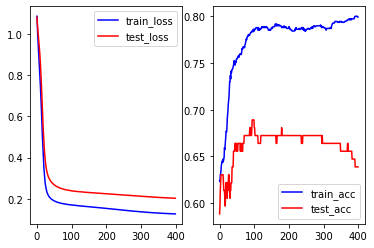

In [80]:
#visualisation
als_grs[0][0].plot()

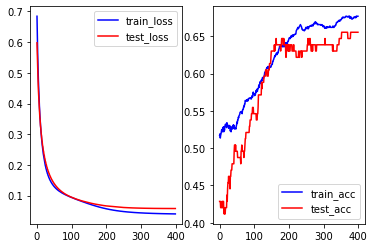

In [81]:
als_ifds[0][0].plot()